<div style="display: flex; background-color: skyblue;" >
<h1 style="margin: auto; padding: 30px; "> P12 -NB1  
    - Détection de faux billets – Projet de modélisation</h1></div>

##### <font color='blue'><u>**SUJET :**</u></font>  
- **Projet 12, dans le cadre de la formation Data Analyst de OpenClassRooms**
- **Enoncé du projet :** https://openclassrooms.com/fr/paths/804/projects/1584
- **Objectifs pédagogiques :**  
      . Utiliser un modèle d'apprentissage supervisé pour réaliser une prédiction d'un phénomène  
      . Entraîner un modèle d'apprentissage non supervisé pour exploiter le modèle

##### <font color='blue'><u>**PRESENTATION RESUMEE :**</u></font>   

<u>**ENTREPRISE :**</u>   
**Nom :** l’Organisation nationale de lutte contre le faux-monnayage (ONCFM)  
**Secteur :** Organisation publique  
**Activité :** Identification des contrefaçons de billets en euros    

<u>**BESOIN :**</u>  
mettre à disposition des équipes un algorithme capable de faire une prédiction sur la nature des billets (vrai billet ou faux billet).  

<u>**Objectif :**</u>  
-	Mettre en place application de machine learning  
-	respectant le cahier des charges fourni, notamment  
-	Entrée : caractéristiques géométriques d’un billet  
-	Sortie : authenticité d’un billet  


##### <font color='blue'><u>**PRESENTATION DETAILLEE :**</u></font>   

<u>**Contexte :**</u>  

Dans le cadre de ses actions de lutte contre la contrefaçon, l’**Organisation nationale de lutte contre le faux-monnayage (ONCFM)** souhaite automatiser la détection des faux billets à partir de caractéristiques géométriques mesurées lors du passage en machine.

L’ONCFM a confié à notre entreprise le développement d’un **prototype de modèle prédictif** permettant de distinguer automatiquement les vrais billets des faux.  
Cette détection repose exclusivement sur des données quantitatives relatives à la forme du billet (longueur, hauteur, marges, diagonale...).

<u>**Objectif de la mission :**</u>  

En tant que **Data Analyst en charge du projet**, ma mission consiste à :

- Réaliser une **analyse exploratoire** des données fournies (1500 billets : 1000 vrais et 500 faux) ;
- Appliquer différents **modèles de machine learning supervisés et non supervisés** (logistic regression, K-means, KNN, random forest) pour évaluer leur capacité de détection ;
- Mettre en place un **prototype d'application fonctionnelle** capable de prédire la nature d’un billet à partir de ses caractéristiques ;
- Documenter les résultats et **justifier le choix du modèle final** retenu, selon sa robustesse, sa performance et sa facilité d'interprétation ;
- Proposer des recommandations métier à l’ONCFM pour l’usage opérationnel de l’outil.

<u>**Données :**</u>  

Le fichier fourni contient les caractéristiques suivantes pour chaque billet :
- `length` : longueur (mm)
- `height_left` : hauteur côté gauche (mm)
- `height_right` : hauteur côté droit (mm)
- `margin_up` : marge supérieure (mm)
- `margin_low` : marge inférieure (mm)
- `diagonal` : diagonale (mm)
- `is_genuine` : étiquette indiquant si le billet est un vrai (1) ou un faux (0)

---

L’approche adoptée sera documentée pas à pas dans ce Notebook, depuis l’analyse initiale jusqu’au choix du modèle final.


**Vérification de l'environnement :**

In [1]:
!where python

D:\Programmes2\Anaconda3\python.exe
C:\Users\matth\AppData\Local\Programs\Python\Python310\python.exe
C:\Users\matth\AppData\Local\Microsoft\WindowsApps\python.exe


<u>**Remarque :**</u>  
Pour des raisons de lisibilité des parties ont été masquées.
Elles peuvent être démasquées directement sur le Notebook .ipynb

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 1 - Import des librairies et chargement des fichiers</h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">1.1 - Désactivation des Warnings déjà lus si nécessaire</h3>
</div>

##### <u>*DESACTIVATIONS DE WARNINGS déjà lu pour LISIBILITE :*</u>

Source :
https://saturncloud.io/blog/how-to-disable-warnings-in-jupyter-notebook/

https://docs.python.org/fr/3/library/warnings.html

default => Show all warnings (even those ignored by default)
ignore => Ignore all warnings
error => Convert all warnings to errors
error::ResourceWarning => Treat ResourceWarning messages as errors
default::DeprecationWarnig => Show DeprecationWarning messages
ignore,default:::mymodule => Only report warnings triggered by "mymodule"
error:::mymodule => Convert warnings to errors in "mymodule"

In [2]:
# import warnings

In [3]:
# Suppress all warnings

#warnings.filterwarnings('ignore')

In [4]:
# Restore the warning behaviour to default : Show all warnings (even those ignored by default)

#warnings.filterwarnings('ignore')

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">1.2 - Import des librairies</h3>
</div>

In [5]:
#Import de la librairie expression régulières
import re

In [6]:
#Import de la librairie Numpy
import numpy as np

In [7]:
#Import de la librairie Pandas
import pandas as pd

In [8]:
#Import de scipy.stats
#import scipy.stats as st

##### **Utilitaire pour le nettoyage:**

In [9]:
#Utilitaire pour le nettoyage :
import gc

#gc.collect()  # force le nettoyage de la mémoire

##### **Pour les Graphiques :**

In [10]:
#Import de la librairie matplotlib.pyplot
import matplotlib.pyplot as plt

In [11]:
#Import de seaborn 
import seaborn as sns

In [12]:
#Import de plotly.express
import plotly.express as px

In [13]:
#PARAMETRAGE GENERAL de SEABORN

sns.set_theme(style='dark', palette='muted')
#plt.rcParams.update({'font.size' : 14,'axes.labelcolor':'firebrick','axes.titlecolor':'firebrick','figure.titlesize':16})
plt.rcParams.update({'font.size' : 12,
                     'axes.labelsize':14,
                     'figure.titlesize':14,
                     'axes.labelcolor':'navy',
                     'axes.titlecolor':'navy'})

**Pour les Statistiques tgraph statistiques :**

In [14]:
from statsmodels.graphics.gofplots import qqplot

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">1.3 - Import de Fonctions personnelles </h3>
</div>

##### FONCTION PERSONNELLE D'ANALYSE DE FICHIERS :

In [15]:
# FONCTION PERSONNELLE D'ANALYSE DE FICHIERS :

#import pandas as pd
#import numpy as np
#import re

def Description_Fichier_Tableau_avc_ValBlanches(Data):
    """
    fonction permettant d'analyser un Dataframe DF.
    Elle prend en entrée le dataframe DF.
    Elle nécessite d'avoir chargé la librairie des expressions regulières : import re
    Et renvoie en sortie un dataframe DF2 avec pour chacune des colonnes de DF, les informations suivantes :
    'Type': type de la colonne
    'Nb lignes' : nbre de lignes total de la colonne
    'Valeurs non-vides' : nbre de valeurs non-vides dans la colonne au sens de la fonction pandas.Series.notna()
    'Valeurs vides' : nbre de valeurs vides dans la colonne au sens de la fonction pandas.Series.isna()
    'Valeurs distinctes' : nbre de valeurs vides dans la colonne au sens de la fonction pandas.Series.unique()
    'Valeurs blanches' : nbre de valeurs blanches dans la colonne au sens de le regular expression r"\A[\s]*$"
    c'est à dire au sens de uniquement une nombres quelconque de caractères blancs y compris aucun ''

    """

    
    re2 = r"\A[\s]*$"
    FICHIER = pd.DataFrame(Data)
    #création d'un DataFrame qui va contenir les colonnes du Fichier en Index, 
    #et la description des lignes dans les colonnes
    Tab_Descriptif = pd.DataFrame(index = FICHIER.columns, 
                                  columns=['Type','Nb lignes',
                                           'Valeurs non-vides','Valeurs vides',
                                           'Valeurs distinctes','Valeurs blanches'])

    #remplissage des lignes
    for elt in FICHIER.columns :
        col_string = (FICHIER[elt]).astype('string')
        Tab_Descriptif.loc[elt,:] = [FICHIER[elt].dtypes, len(FICHIER[elt]) , 
                                     FICHIER[elt].notna().sum() ,FICHIER[elt].isna().sum(),
                                     len(FICHIER[elt].unique()),col_string.str.match(re2).sum() ]

    #print(Tab_Descriptif)
    return Tab_Descriptif
    

<>:8: SyntaxWarning: invalid escape sequence '\A'
<>:8: SyntaxWarning: invalid escape sequence '\A'
C:\Users\matth\AppData\Local\Temp\ipykernel_33004\511367401.py:8: SyntaxWarning: invalid escape sequence '\A'
  """


L'alerte ne vaut que pour le texte de la description de fonction!

##### FONCTION PERSONNELLE D'ANALYSE DE FICHIERS - AMELIORATION EFFICACITE:

In [16]:
# FONCTION PERSONNELLE D'ANALYSE DE FICHIERS-TENTATIVE MAELIORATION :

#import pandas as pd
#import numpy as np
#import re

def Description_Fichier_Tableau_avc_ValBlanches_V2_1(data):
    """
    fonction permettant d'analyser un Dataframe DF.
    Elle prend en entrée le dataframe DF.
    Elle nécessite d'avoir chargé la librairie des expressions regulières : import re
    Et renvoie en sortie un dataframe DF2 avec pour chacune des colonnes de DF, les informations suivantes :
    'Type': type de la colonne
    'Nb lignes' : nbre de lignes total de la colonne
    'Valeurs non-vides' : nbre de valeurs non-vides dans la colonne au sens de la fonction pandas.Series.notna()
    'Valeurs vides' : nbre de valeurs vides dans la colonne au sens de la fonction pandas.Series.isna()
    'Valeurs distinctes' : nbre de valeurs vides dans la colonne au sens de la fonction pandas.Series.unique()
    'Valeurs blanches' : nbre de valeurs blanches dans la colonne au sens de le regular expression r"\A[\s]*$"
    c'est à dire au sens de uniquement une nombres quelconque de caractères blancs y compris aucun ''

    """
    # Normalisation d'entrée : Series -> DataFrame, ndarray -> DataFrame
    if isinstance(data, pd.Series):
        df = data.to_frame(name=data.name if data.name else "col_0")
    elif isinstance(data, np.ndarray):
        if data.ndim == 1:
            df = pd.DataFrame(data, columns=["col_0"])
        else:
            df = pd.DataFrame(data)
    elif isinstance(data, pd.DataFrame):
        df = data
    else:
        raise ValueError("Type de donnée non supporté. Utilisez un DataFrame, Series ou ndarray.")

    regex_blanc = re.compile(r"\A[\s]*$")
    results = []

    for col in df.columns:
        serie = df[col]
        col_type = serie.dtype
        nb_total = len(serie)
        nb_notna = serie.notna().sum()
        nb_na = serie.isna().sum()
        nb_unique = serie.nunique(dropna=True)
        
        # Vérification uniquement sur les chaînes de caractères
        if pd.api.types.is_string_dtype(serie) or pd.api.types.is_object_dtype(serie):
            nb_blancs = serie.apply(lambda x: bool(regex_blanc.match(str(x)))).sum()
        else:
            nb_blancs = np.nan

        results.append([
            col_type, nb_total, nb_notna, nb_na, nb_unique, nb_blancs
        ])

    Tab_Descriptif = pd.DataFrame(
        results,
        index=df.columns,
        columns=[
            "Type",
            "Nb lignes",
            "Valeurs non-vides",
            "Valeurs vides",
            "Valeurs distinctes",
            "Valeurs blanches"
        ]
    )

    return Tab_Descriptif


<>:8: SyntaxWarning: invalid escape sequence '\A'
<>:8: SyntaxWarning: invalid escape sequence '\A'
C:\Users\matth\AppData\Local\Temp\ipykernel_33004\28862795.py:8: SyntaxWarning: invalid escape sequence '\A'
  """


In [17]:
# FONCTION PERSONNELLE DE PREMIERE ANALYSE :

#import pandas as pd
#import numpy as np

def Premieres_Analyses(df_etude):
    """
    fonction regroupant les premières analyses.
    Elle prend en entrée le dataframe DF,
    et applique les instances et méthode intégrées : .shape  .info() .describe()
    et ma méthode personnelle Description_Fichier_Tableau_avc_ValBlanches_V2_1
    Il n'y a pas de sortie, que de l'affichage

    """
    print("\n----","SHAPE","----")
    display(df_etude.shape)
    print("\n----","INFO","----")
    df_etude.info()
    print("\n----","DESCRIBE","----")
    display(df_etude.describe())
    print("\n----","DESCRIPTION","----")
    display(Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_etude))

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">1.4 - Lexique des principales Variables </h3>
</div>

##### <font color='green'><u>**LEXIQUE DES PRINCIPAUX DATAFRAMES et AUTRE VARIABLES:**<u></font>


**ETAPE 1 :**  
`df_billets_original` : **DF**, Fichier original chargé    
`df_billets_analyse_1_1` : **DF**, DataFrame correspondant aux données originales pour l'analyse    
`df_billets_analyse_1_1_Cnum` : **DF**, `df_billets_analyse_1_1` avec la variable `is_genuine` en numérique 1/0 au lieu de False/true  

**ETAPE 3-REGRESSION LINEAIRE pour Complétion de données :**  
`df_billets_analyse_1_2` : **DF**, Fichier complété par les données de la régression linéaire  
`df_billets_analyse_1_2_Cnum` : **DF**, `df_billets_analyse_1_2` avec la variable `is_genuine` en numérique 1/0 au lieu de False/true



<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">1.5 - Chargement des fichiers</h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 1.5.1 - Import du Fichier `billets.csv` les 1500 billets :</h4>
</div>

##### <font color='blue'><u>**a. PREMIERS CHARGEMENTS**</u></font>

In [18]:
#Importation du fichier billets
df_billets_original = pd.read_csv(r"D:\BDD\OCR\P12\billets.csv", sep = ';')

In [19]:
df_billets_original.head(5)

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09
2,True,172.69,104.48,103.50,4.40,2.94,113.16
3,True,171.36,103.91,103.94,3.62,3.01,113.51
4,True,171.73,104.28,103.46,4.04,3.48,112.54


In [20]:
Premieres_Analyses(df_billets_original)


---- SHAPE ----


(1500, 7)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500 entries, 0 to 1499
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   is_genuine    1500 non-null   bool   
 1   diagonal      1500 non-null   float64
 2   height_left   1500 non-null   float64
 3   height_right  1500 non-null   float64
 4   margin_low    1463 non-null   float64
 5   margin_up     1500 non-null   float64
 6   length        1500 non-null   float64
dtypes: bool(1), float64(6)
memory usage: 71.9 KB

---- DESCRIBE ----


,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.000000,1500.000000,1500.000000,1463.000000,1500.000000,1500.00000
mean,171.958440,104.029533,103.920307,4.485967,3.151473,112.67850
std,0.305195,0.299462,0.325627,0.663813,0.231813,0.87273
min,171.040000,103.140000,102.820000,2.980000,2.270000,109.49000
25%,171.750000,103.820000,103.710000,4.015000,2.990000,112.03000
50%,171.960000,104.040000,103.920000,4.310000,3.140000,112.96000
75%,172.170000,104.230000,104.150000,4.870000,3.310000,113.34000
max,173.010000,104.880000,104.950000,6.900000,3.910000,114.44000



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1463,37,285,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


In [21]:
df_billets_original.columns

Index(['is_genuine', 'diagonal', 'height_left', 'height_right', 'margin_low',
       'margin_up', 'length'],
      dtype='object')

In [22]:
df_billets_original['is_genuine'].value_counts()

is_genuine
True     1000
False     500
Name: count, dtype: int64

##### <font color='blue'><u>**b.RECHARGEONS LES DONNEES avec un TYPAGE au chargement :**</u></font>

##### **RECHARGEONS LES FICHIERS**

In [23]:
#SUPPRIMONS LES FICHIERS ET RECHARGEONS LES
import gc

del df_billets_original  # supprime la référence à l'ancien DataFrame

gc.collect()  # force le nettoyage de la mémoire

0

#CHARGEMENT de billets.csv  
Choix de Float64 pour la meilleure gestion des Nan #pas nécessaire float64 est suffisant car ce ne sont pas des nan mais des valeurs vides  et Float 64 sera genant pour certaines méthodes en numpy

In [24]:
#CHARGEMENT de billets.csv

#Pas nécessaire, nous gardons toutes les colonnes
#liste_col_temp = ['is_genuine', 
#                  'diagonal', 'height_left', 'height_right', 'margin_low','margin_up', 'length']

df_billets_original = pd.read_csv(r"D:\BDD\OCR\P12\billets.csv",
                                  sep = ';',
                                  #usecols=liste_col_temp,
                                  dtype={'is_genuine':"bool", 
                                         'diagonal':"float64", 
                                         'height_left':"float64", 
                                         'height_right':"float64", 
                                         'margin_low':"float64",
                                         'margin_up':"float64", 
                                         'length':"float64"
                                         }
                                 )

df_billets_original.head(5)

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09
2,True,172.69,104.48,103.50,4.40,2.94,113.16
3,True,171.36,103.91,103.94,3.62,3.01,113.51
4,True,171.73,104.28,103.46,4.04,3.48,112.54


In [25]:
Premieres_Analyses(df_billets_original)


---- SHAPE ----


(1500, 7)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500 entries, 0 to 1499
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   is_genuine    1500 non-null   bool   
 1   diagonal      1500 non-null   float64
 2   height_left   1500 non-null   float64
 3   height_right  1500 non-null   float64
 4   margin_low    1463 non-null   float64
 5   margin_up     1500 non-null   float64
 6   length        1500 non-null   float64
dtypes: bool(1), float64(6)
memory usage: 71.9 KB

---- DESCRIBE ----


,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.000000,1500.000000,1500.000000,1463.000000,1500.000000,1500.00000
mean,171.958440,104.029533,103.920307,4.485967,3.151473,112.67850
std,0.305195,0.299462,0.325627,0.663813,0.231813,0.87273
min,171.040000,103.140000,102.820000,2.980000,2.270000,109.49000
25%,171.750000,103.820000,103.710000,4.015000,2.990000,112.03000
50%,171.960000,104.040000,103.920000,4.310000,3.140000,112.96000
75%,172.170000,104.230000,104.150000,4.870000,3.310000,113.34000
max,173.010000,104.880000,104.950000,6.900000,3.910000,114.44000



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1463,37,285,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


##### <font color='blue'><u>**c. CREONS UN DF de travail**</u></font>

In [26]:
df_billets_analyse_1_1 = df_billets_original.copy(deep=True)

In [27]:
df_billets_analyse_1_1.head(5)

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09
2,True,172.69,104.48,103.50,4.40,2.94,113.16
3,True,171.36,103.91,103.94,3.62,3.01,113.51
4,True,171.73,104.28,103.46,4.04,3.48,112.54


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 1.5.2 - Import du Fichier `billets_production.csv` le fichier test d'entrée :</h4>
</div>

##### <font color='blue'><u>**a. PREMIERS CHARGEMENTS**</u></font>

In [28]:
#Importation du fichier billets_production
#ATTENTION les séparateur ici est une ","
df_billets_production_original = pd.read_csv(r"D:\BDD\OCR\P12\billets_production.csv", sep = ',')

In [29]:
df_billets_production_original.head(10)

,diagonal,height_left,height_right,margin_low,margin_up,length,id
0,171.76,104.01,103.54,5.21,3.30,111.42,A_1
1,171.87,104.17,104.13,6.00,3.31,112.09,A_2
2,172.00,104.58,104.29,4.99,3.39,111.57,A_3
3,172.49,104.55,104.34,4.44,3.03,113.20,A_4
4,171.65,103.63,103.56,3.77,3.16,113.33,A_5


In [30]:
Premieres_Analyses(df_billets_production_original)


---- SHAPE ----


(5, 7)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5 entries, 0 to 4
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   diagonal      5 non-null      float64
 1   height_left   5 non-null      float64
 2   height_right  5 non-null      float64
 3   margin_low    5 non-null      float64
 4   margin_up     5 non-null      float64
 5   length        5 non-null      float64
 6   id            5 non-null      object 
dtypes: float64(6), object(1)
memory usage: 412.0+ bytes

---- DESCRIBE ----


,diagonal,height_left,height_right,margin_low,margin_up,length
count,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000
mean,171.954000,104.188000,103.972000,4.882000,3.238000,112.322000
std,0.326542,0.396257,0.393027,0.836821,0.142724,0.897201
min,171.650000,103.630000,103.540000,3.770000,3.030000,111.420000
25%,171.760000,104.010000,103.560000,4.440000,3.160000,111.570000
50%,171.870000,104.170000,104.130000,4.990000,3.300000,112.090000
75%,172.000000,104.550000,104.290000,5.210000,3.310000,113.200000
max,172.490000,104.580000,104.340000,6.000000,3.390000,113.330000



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
diagonal,float64,5,5,0,5,NaN
height_left,float64,5,5,0,5,NaN
height_right,float64,5,5,0,5,NaN
margin_low,float64,5,5,0,5,NaN
margin_up,float64,5,5,0,5,NaN
length,float64,5,5,0,5,NaN
id,object,5,5,0,5,0.0


In [31]:
df_billets_production_original.columns

Index(['diagonal', 'height_left', 'height_right', 'margin_low', 'margin_up',
       'length', 'id'],
      dtype='object')

##### <font color='blue'><u>**b.RECHARGEONS LES DONNEES avec un TYPAGE au chargement :**</u></font>

##### **RECHARGEONS LES FICHIERS**

In [32]:
#SUPPRIMONS LES FICHIERS ET RECHARGEONS LES
import gc

del df_billets_production_original  # supprime la référence à l'ancien DataFrame

gc.collect()  # force le nettoyage de la mémoire

0

#CHARGEMENT de billets_production.csv  
Choix de Float64 pour la meilleure gestion des Nan #pas nécessaire float64 est suffisant car ce ne sont pas des nan mais des valeurs vides  et Float 64 sera genant pour certaines méthodes en numpy

In [33]:
#CHARGEMENT de billets_production.csv

#Pas nécessaire, nous gardons toutes les colonnes
#liste_col_temp = ['is_genuine', 
#                  'diagonal', 'height_left', 'height_right', 'margin_low','margin_up', 'length']

df_billets_production_original = pd.read_csv(r"D:\BDD\OCR\P12\billets_production.csv",
                                             sep = ',',
                                             #usecols=liste_col_temp,
                                             dtype={'diagonal':"float64",
                                                    'height_left':"float64",
                                                    'height_right':"float64",
                                                    'margin_low':"float64",
                                                    'margin_up':"float64",
                                                    'length':"float64",
                                                    'id':"string"
                                                    }
                                             )

df_billets_production_original.head(5)

,diagonal,height_left,height_right,margin_low,margin_up,length,id
0,171.76,104.01,103.54,5.21,3.30,111.42,A_1
1,171.87,104.17,104.13,6.00,3.31,112.09,A_2
2,172.00,104.58,104.29,4.99,3.39,111.57,A_3
3,172.49,104.55,104.34,4.44,3.03,113.20,A_4
4,171.65,103.63,103.56,3.77,3.16,113.33,A_5


In [34]:
Premieres_Analyses(df_billets_production_original)


---- SHAPE ----


(5, 7)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5 entries, 0 to 4
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   diagonal      5 non-null      float64
 1   height_left   5 non-null      float64
 2   height_right  5 non-null      float64
 3   margin_low    5 non-null      float64
 4   margin_up     5 non-null      float64
 5   length        5 non-null      float64
 6   id            5 non-null      string 
dtypes: float64(6), string(1)
memory usage: 412.0 bytes

---- DESCRIBE ----


,diagonal,height_left,height_right,margin_low,margin_up,length
count,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000
mean,171.954000,104.188000,103.972000,4.882000,3.238000,112.322000
std,0.326542,0.396257,0.393027,0.836821,0.142724,0.897201
min,171.650000,103.630000,103.540000,3.770000,3.030000,111.420000
25%,171.760000,104.010000,103.560000,4.440000,3.160000,111.570000
50%,171.870000,104.170000,104.130000,4.990000,3.300000,112.090000
75%,172.000000,104.550000,104.290000,5.210000,3.310000,113.200000
max,172.490000,104.580000,104.340000,6.000000,3.390000,113.330000



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
diagonal,float64,5,5,0,5,NaN
height_left,float64,5,5,0,5,NaN
height_right,float64,5,5,0,5,NaN
margin_low,float64,5,5,0,5,NaN
margin_up,float64,5,5,0,5,NaN
length,float64,5,5,0,5,NaN
id,string[python],5,5,0,5,0.0


##### <font color='blue'><u>**c. CREONS UN DF de travail**</u></font>

In [35]:
df_billets_production_analyse_1_1 = df_billets_production_original.copy(deep=True)

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 2 - Analyse descriptive-EDA- du fichier `billets`</h2>
</div>

PALETTE pour l'authenticité(genuine)

In [36]:
#PALETTE pour l'authenticité
#Ordre des continents par ordre alphabétique
Ordre_genuine = sorted(df_billets_analyse_1_1['is_genuine'].unique())
#Ordre_genuine = sorted([True,False])

# Générer une palette 'muted' avec autant de couleurs que de données
couleurs_muted_genuine = sns.color_palette("muted", len(Ordre_genuine))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_genuine = dict(zip(Ordre_genuine, couleurs_muted_genuine))

In [37]:
df_billets_analyse_1_1.head()

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09
2,True,172.69,104.48,103.50,4.40,2.94,113.16
3,True,171.36,103.91,103.94,3.62,3.01,113.51
4,True,171.73,104.28,103.46,4.04,3.48,112.54


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2.1 -EDA-Vue globale  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2.1.1 -Caractéristiques du DF  : </h4>
</div>

In [38]:
df_billets_analyse_1_1.head()

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09
2,True,172.69,104.48,103.50,4.40,2.94,113.16
3,True,171.36,103.91,103.94,3.62,3.01,113.51
4,True,171.73,104.28,103.46,4.04,3.48,112.54


In [39]:
df_billets_analyse_1_1.columns

Index(['is_genuine', 'diagonal', 'height_left', 'height_right', 'margin_low',
       'margin_up', 'length'],
      dtype='object')

In [40]:
df_billets_analyse_1_1.dtypes

is_genuine         bool
diagonal        float64
height_left     float64
height_right    float64
margin_low      float64
margin_up       float64
length          float64
dtype: object

In [41]:
Premieres_Analyses(df_billets_analyse_1_1)


---- SHAPE ----


(1500, 7)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500 entries, 0 to 1499
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   is_genuine    1500 non-null   bool   
 1   diagonal      1500 non-null   float64
 2   height_left   1500 non-null   float64
 3   height_right  1500 non-null   float64
 4   margin_low    1463 non-null   float64
 5   margin_up     1500 non-null   float64
 6   length        1500 non-null   float64
dtypes: bool(1), float64(6)
memory usage: 71.9 KB

---- DESCRIBE ----


,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.000000,1500.000000,1500.000000,1463.000000,1500.000000,1500.00000
mean,171.958440,104.029533,103.920307,4.485967,3.151473,112.67850
std,0.305195,0.299462,0.325627,0.663813,0.231813,0.87273
min,171.040000,103.140000,102.820000,2.980000,2.270000,109.49000
25%,171.750000,103.820000,103.710000,4.015000,2.990000,112.03000
50%,171.960000,104.040000,103.920000,4.310000,3.140000,112.96000
75%,172.170000,104.230000,104.150000,4.870000,3.310000,113.34000
max,173.010000,104.880000,104.950000,6.900000,3.910000,114.44000



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1463,37,285,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


**Valeurs manquantes/doublons :**

In [42]:
# Valeurs manquantes
print("Valeurs manquantes par colonne :\n", df_billets_analyse_1_1.isnull().sum())

print("--------")
# Doublons
print("Nombre de doublons :", df_billets_analyse_1_1.duplicated().sum())


Valeurs manquantes par colonne :
 is_genuine       0
diagonal         0
height_left      0
height_right     0
margin_low      37
margin_up        0
length           0
dtype: int64
--------
Nombre de doublons : 0


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2.1.2 - Visualisation : </h4>
</div>

##### Repartition de la variable `is_genuine`

In [43]:
df_billets_analyse_1_1['is_genuine'].value_counts()

is_genuine
True     1000
False     500
Name: count, dtype: int64

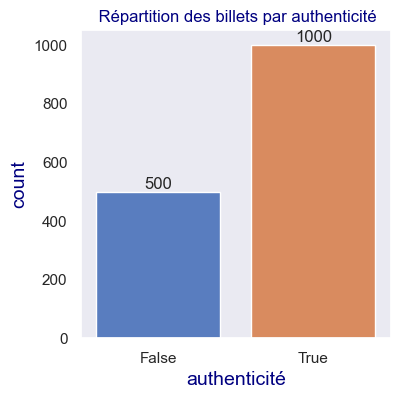

In [44]:
# Répartition des billets par authenticite
plt.figure(figsize=(4, 4))
ax = sns.countplot(data = df_billets_analyse_1_1,
                   x='is_genuine',
                   hue="is_genuine",
                   hue_order=Ordre_genuine,# <-- ordre des couleurs
                   order=Ordre_genuine,# <-- ordre des barres (axe X)
                   palette=palette_fixe_genuine,
                   legend=False)

for x in range(0,len(ax.containers)) :
    ax.bar_label(ax.containers[x], fmt='%.0f')

plt.xlabel("authenticité")
plt.title(" Répartition des billets par authenticité")
plt.show()

In [45]:
df_temp = pd.DataFrame(df_billets_analyse_1_1['is_genuine'].value_counts())
df_temp.sort_index(inplace=True)
display(df_temp)

,count
is_genuine,
False,500
True,1000


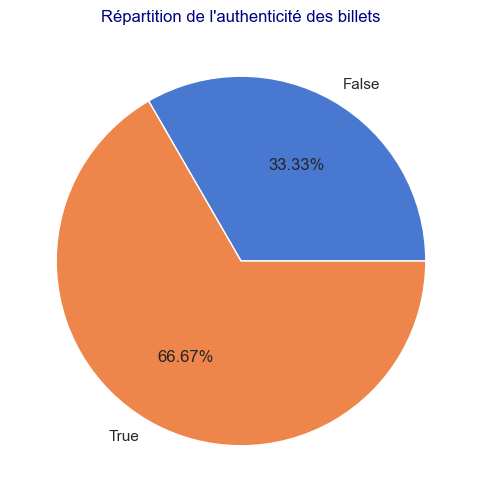

In [46]:
#Presentation sous forme de Camembert : pas de camenbert sous seaborn !!!:(

plt.figure(figsize=(10,6))

df_temp = pd.DataFrame(df_billets_analyse_1_1['is_genuine'].value_counts())
df_temp.sort_index(inplace=True)

plt.pie(x=df_temp['count'],
        labels=df_temp.index,
        #normalize=True,
        autopct='%.2f%%',
        #labeldistance=2.4,
        #pctdistance =2.0,
        #startangle=-10,
        #rotatelabels =True
       )
#plt.legend()
plt.title("Répartition de l'authenticité des billets")
plt.show()

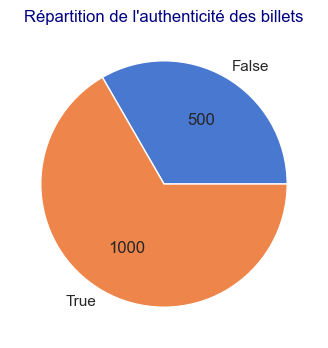

In [47]:
#Presentation sous forme de Camembert : pas de camenbert sous seaborn !!!:(

plt.figure(figsize=(4,4))

df_temp = pd.DataFrame(df_billets_analyse_1_1['is_genuine'].value_counts())
df_temp.sort_index(inplace=True)

plt.pie(x=df_temp['count'],
        labels=df_temp.index,
        #normalize=True,
        autopct=lambda p: f'{int(round(p * df_temp['count'].sum() / 100))}',
        #labeldistance=2.4,
        #pctdistance =2.0,
        #startangle=-10,
        #rotatelabels =True
       )
#plt.legend()
plt.title("Répartition de l'authenticité des billets")
plt.show()

##### Répartitions des `variables quantitatives`

In [48]:
# Liste des variables quantitatives
var_quant = ['diagonal', 
              'height_left', 'height_right', 
              'margin_low','margin_up', 
              'length']

In [49]:
df_billets_analyse_1_1.columns[1:]

Index(['diagonal', 'height_left', 'height_right', 'margin_low', 'margin_up',
       'length'],
      dtype='object')

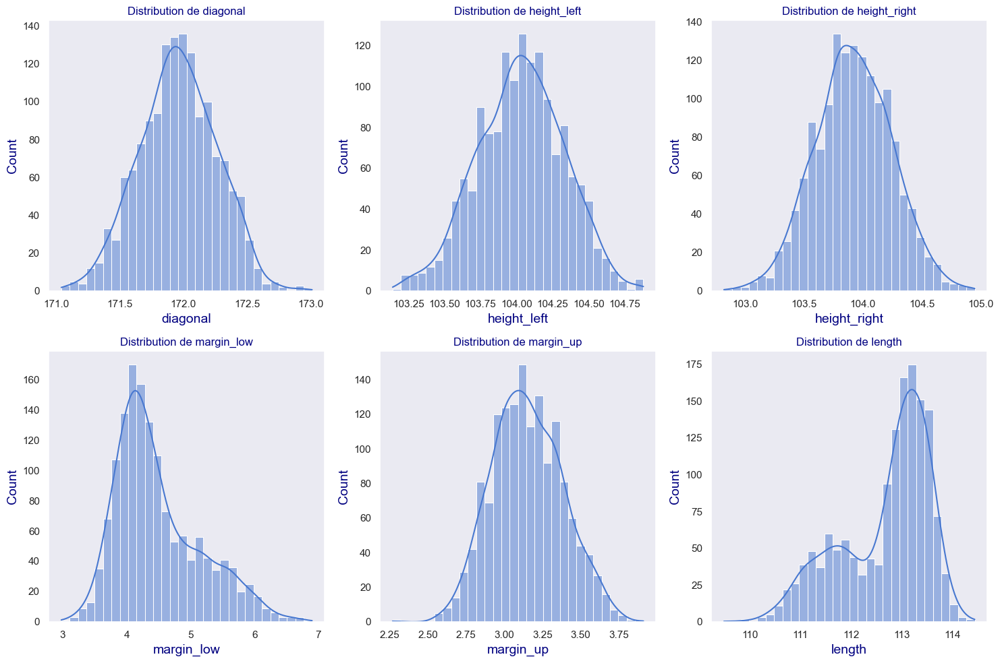

In [50]:
plt.figure(figsize=(15, 10))
for i, col in enumerate(var_quant, start=1):  # Toutes sauf is_genuine
    plt.subplot(2, 3, i)
    sns.histplot(df_billets_analyse_1_1[col], 
                 kde=True, bins=30,
                 #color="blue"
                )
    plt.title(f"Distribution de {col}")
plt.tight_layout()
plt.show()

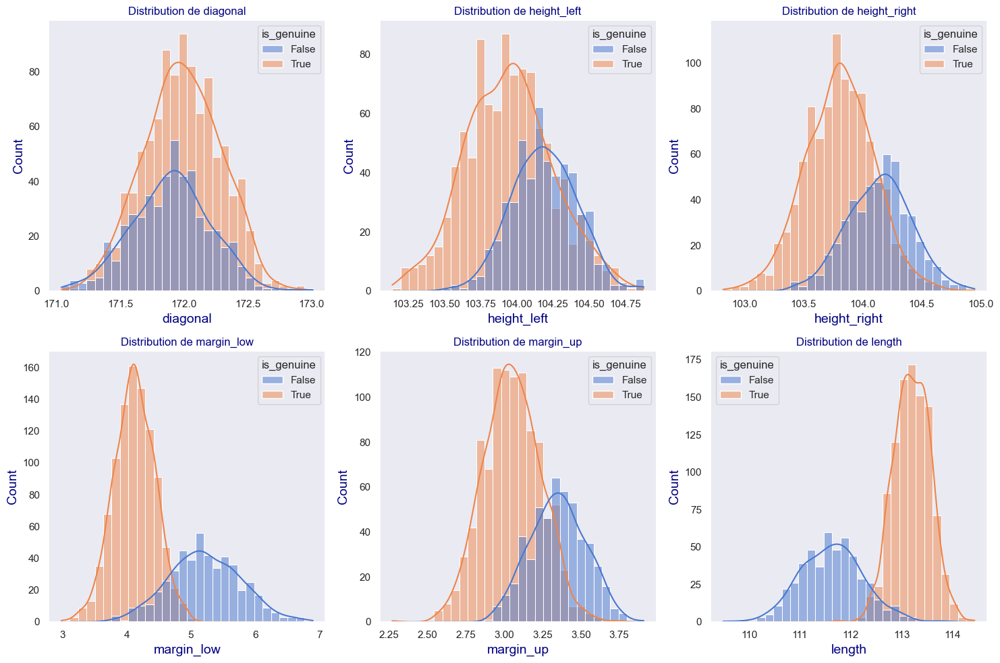

In [51]:
plt.figure(figsize=(15, 10))
for i, col in enumerate(var_quant, start=1):  # Toutes sauf is_genuine
    plt.subplot(2, 3, i)
    sns.histplot(data =df_billets_analyse_1_1,
                 x=col,
                 kde=True, bins=30,
                 hue='is_genuine',
                 hue_order = Ordre_genuine,
                 palette=palette_fixe_genuine
                 #color="blue"
                )
    plt.title(f"Distribution de {col}")
plt.tight_layout()
plt.show()

##### BOXPLOTS  (pas la meilleure visibilité)

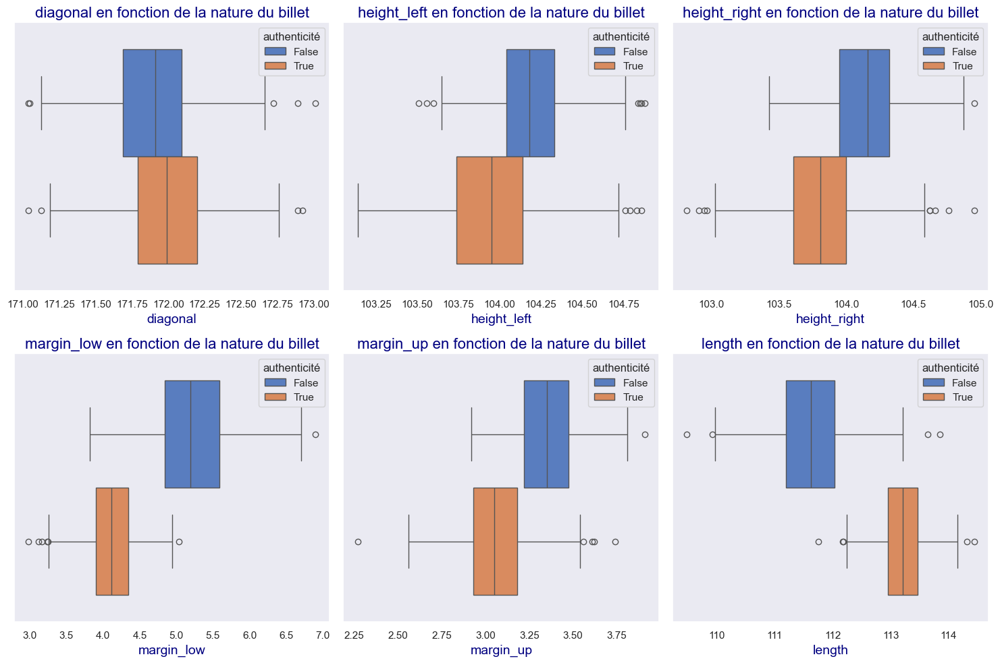

In [52]:
# Boxplots pour comparer vrais vs faux billets
plt.figure(figsize=(15, 10))
for i, col in enumerate(var_quant, start=1):
    plt.subplot(2, 3, i)
    sns.boxplot(data =df_billets_analyse_1_1,
                x=col,
#                y='is_genuine',
                 hue='is_genuine',
                 hue_order = Ordre_genuine,
                 palette=palette_fixe_genuine
                 #color="blue"
               )
    plt.legend(title="authenticité")
    plt.title(f"{col} en fonction de la nature du billet",fontdict={'size':16})

plt.tight_layout()
plt.show()

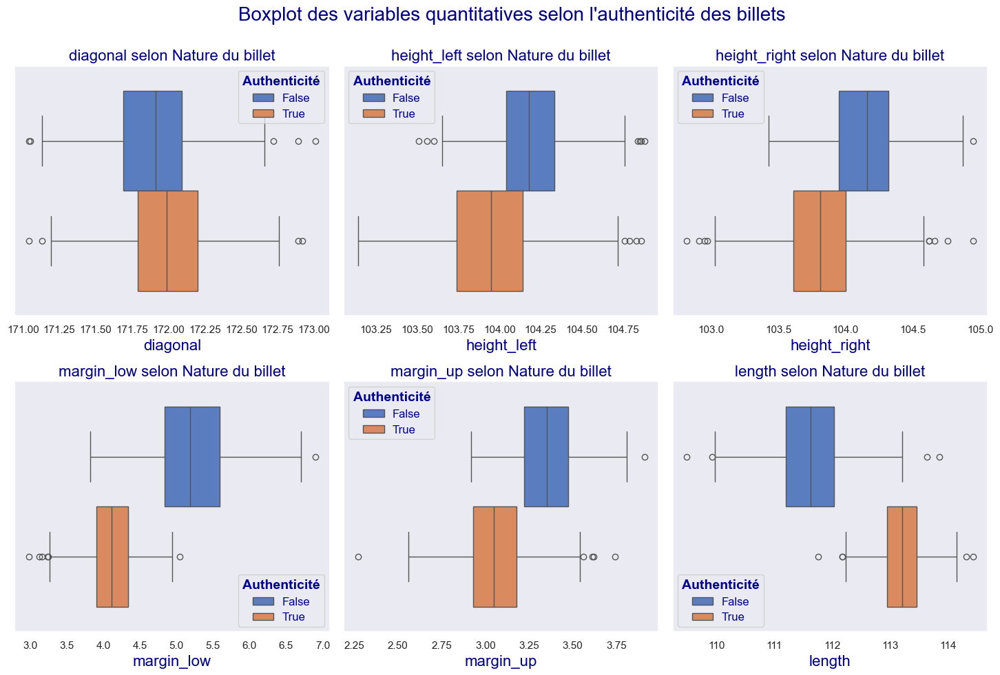

In [53]:
# Boxplots pour comparer vrais vs faux billets / AMELIORATIONS GRAPHIQUES

# Création de la figure principale
fig = plt.figure(figsize=(15, 10))

for i, col in enumerate(var_quant, start=1):
    ax = plt.subplot(2, 3, i)

    sns.boxplot(
        data=df_billets_analyse_1_1,
        x=col,
        hue='is_genuine',
        hue_order=Ordre_genuine,
        palette=palette_fixe_genuine,
        ax=ax
    )

    # Modifier la légende
    leg = ax.legend(title="Authenticité")
    leg.set_title("Authenticité", prop={'size': 14, 'weight': 'bold'})
    leg.get_title().set_color("darkblue")
    for text in leg.get_texts():
        text.set_fontsize(12)
        text.set_color("darkblue")

    # Modifier les labels de l'axe X
    ax.set_xlabel(col, fontsize=16, color='navy')

    # Modifier le titre du subplot
    ax.set_title(f"{col} selon Nature du billet", fontdict={'size':16, 'color':'navy'})

# Titre global de la figure
fig.suptitle("Boxplot des variables quantitatives selon l'authenticité des billets", 
             fontsize=20, color='navy')

# Ajustement pour éviter les chevauchements
plt.tight_layout(rect=[0, 0, 0.98, 0.98])  # pour laisser de l'espace au titre global
plt.show()


##### FIN BOXPLOTS :

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2.1.2 -  : Analyse multivariée </h4>
</div>

##### PAIRPLOT :

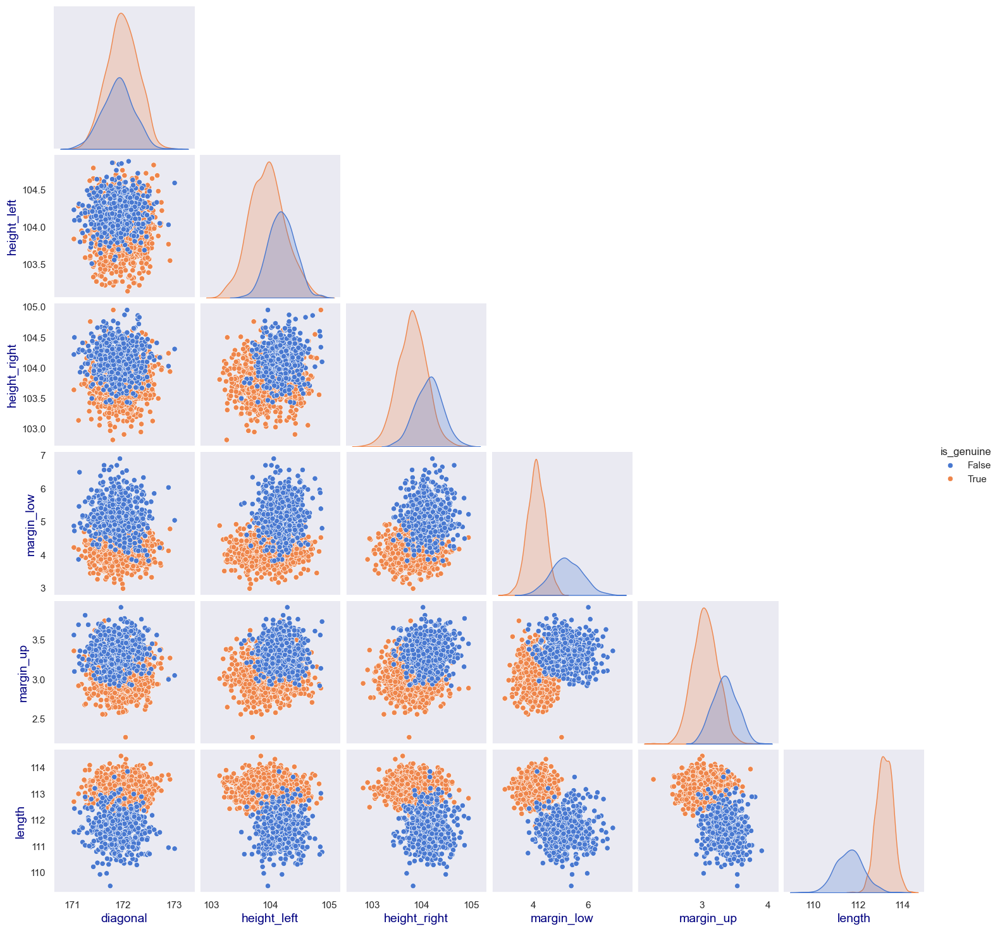

In [54]:
# Pair plot
sns.pairplot(df_billets_analyse_1_1, hue='is_genuine', corner=True)
plt.show()

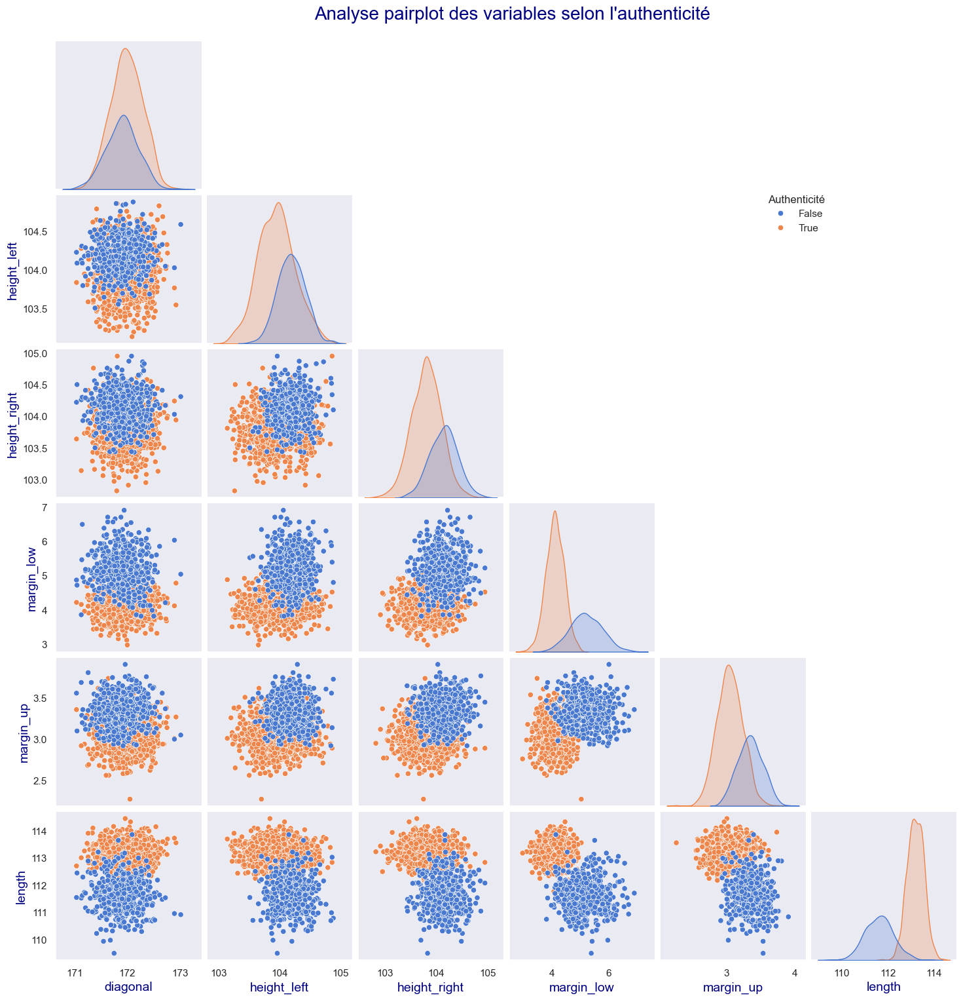

In [55]:
# Créer le pairplot et le stocker
pair_plot = sns.pairplot(df_billets_analyse_1_1, hue='is_genuine', corner=True)

# Ajouter un titre global
pair_plot.fig.suptitle("Analyse pairplot des variables selon l'authenticité", fontsize=20, y=1.02,color='navy')


# Repositionner la légende en haut à droite
pair_plot._legend.set_bbox_to_anchor((0.8, 0.8))
pair_plot._legend.set_title("Authenticité")

# Afficher
plt.show()

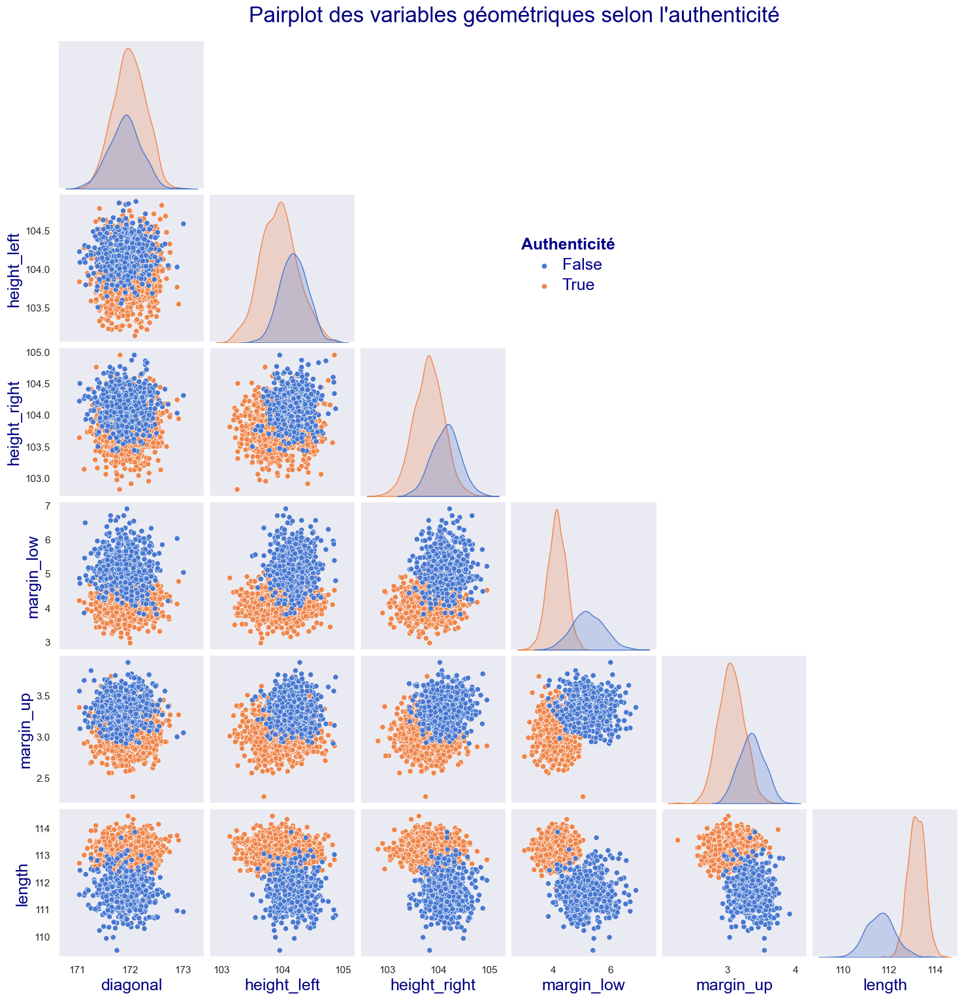

In [56]:
import seaborn as sns
import matplotlib.pyplot as plt

# Créer le pairplot
pair_plot = sns.pairplot(df_billets_analyse_1_1, hue='is_genuine', corner=True)

# Ajouter un titre global
pair_plot.fig.suptitle("Pairplot des variables géométriques selon l'authenticité", 
                       fontsize=24, y=1.02, color='navy')

# Repositionner la légende
pair_plot._legend.set_bbox_to_anchor((0.6, 0.75))

# Appliquer style au titre de la légende
pair_plot._legend.set_title("Authenticité", prop={'size': 18, 'weight': 'bold'})
pair_plot._legend.get_title().set_color('darkblue')

# Personnaliser les étiquettes de la légende
for text in pair_plot._legend.get_texts():
    text.set_fontsize(18)
    text.set_color("darkblue")

# Personnaliser les axes
for ax in pair_plot.axes.flatten():
    if ax is not None:
        ax.set_xlabel(ax.get_xlabel(), fontsize=18)
        ax.set_ylabel(ax.get_ylabel(), fontsize=18)

plt.show()


##### GRAPH CORRELATION

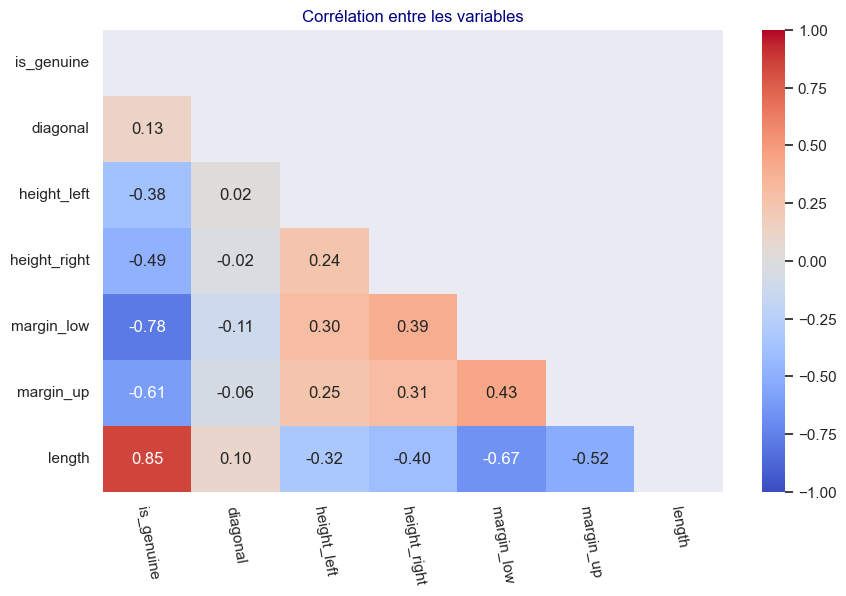

In [57]:
# Visualisation de la Matrice de corrélation

#mask_triangulaire
mask_semi_heatmap = np.triu(np.ones( (df_billets_analyse_1_1.corr(method='pearson')).shape  ))

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(10, 6))
sns.heatmap(df_billets_analyse_1_1.corr(method='pearson'), 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f",
            mask = mask_semi_heatmap
           )
plt.title("Corrélation entre les variables")
plt.xticks(rotation=-80)
plt.grid(visible=False)
plt.show()

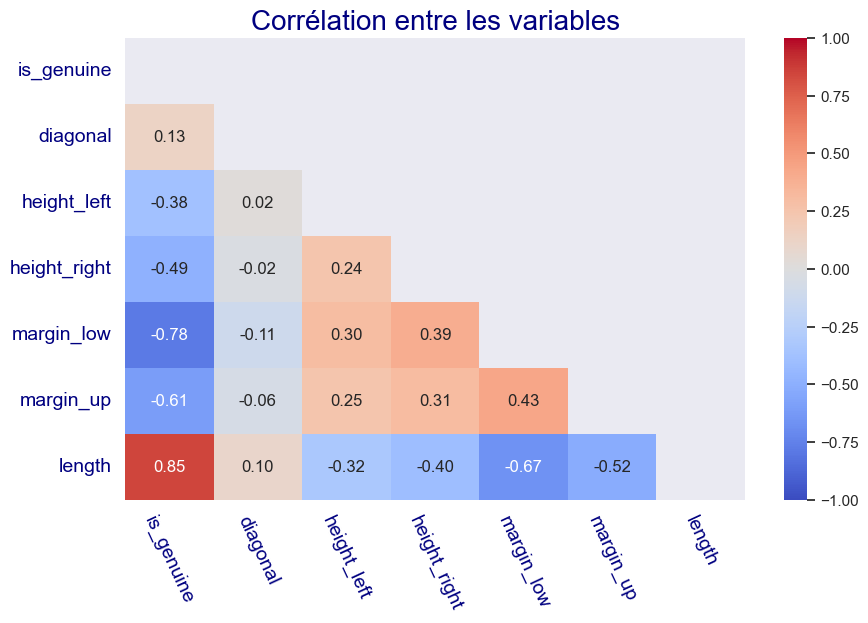

In [58]:
# Visualisation de la Matrice de corrélation (Amélioration graphiques

#mask_triangulaire
mask_semi_heatmap = np.triu(np.ones( (df_billets_analyse_1_1.corr(method='pearson')).shape  ))

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(10, 6))
sns.heatmap(df_billets_analyse_1_1.corr(method='pearson'), 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f",
            mask = mask_semi_heatmap
           )
plt.title("Corrélation entre les variables",fontsize=20)
plt.xticks(rotation=-65,fontsize=14,color='navy')
plt.yticks(fontsize=14,color='navy')
plt.grid(visible=False)
plt.show()

**OBSERVATIONS :**  
L'authenticité `is_genuine` semble assez fortement corrélée avec `length` et `margin_low`

##### GRAPH CORRELATION des variables quantitatives

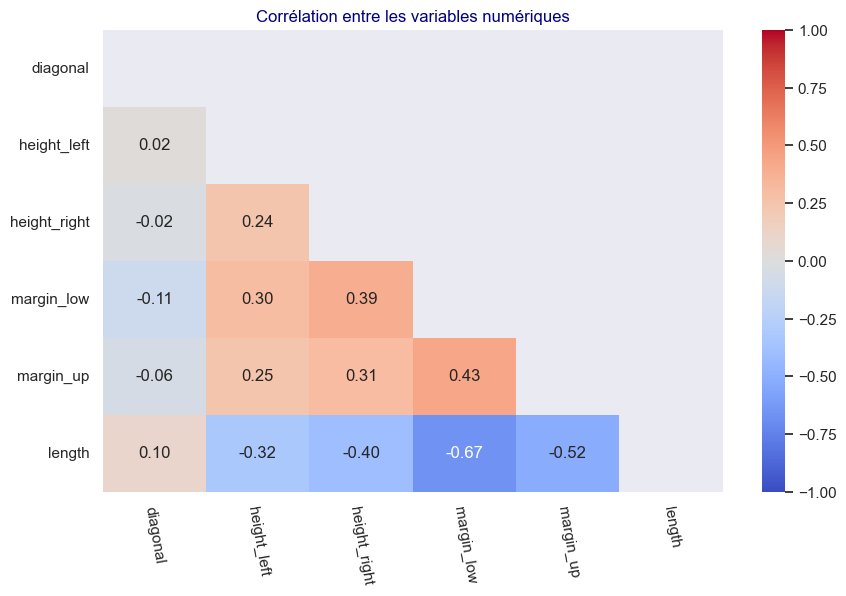

In [59]:
# Visualisation de la Matrice de corrélation

#mask_triangulaire
mask_semi_heatmap = np.triu(np.ones( (df_billets_analyse_1_1[var_quant].corr(method='pearson')).shape  ))

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(10, 6))
sns.heatmap(df_billets_analyse_1_1[var_quant].corr(method='pearson'), 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f",
            mask = mask_semi_heatmap
           )
plt.title("Corrélation entre les variables numériques")
plt.xticks(rotation=-80)
plt.grid(visible=False)
plt.show()

##### GRAPH CORRELATION pour les données restreintes aux vrais billets

In [60]:
df_billets_analyse_1_1['is_genuine']==True

0        True
1        True
2        True
3        True
4        True
        ...  
1495    False
1496    False
1497    False
1498    False
1499    False
Name: is_genuine, Length: 1500, dtype: bool

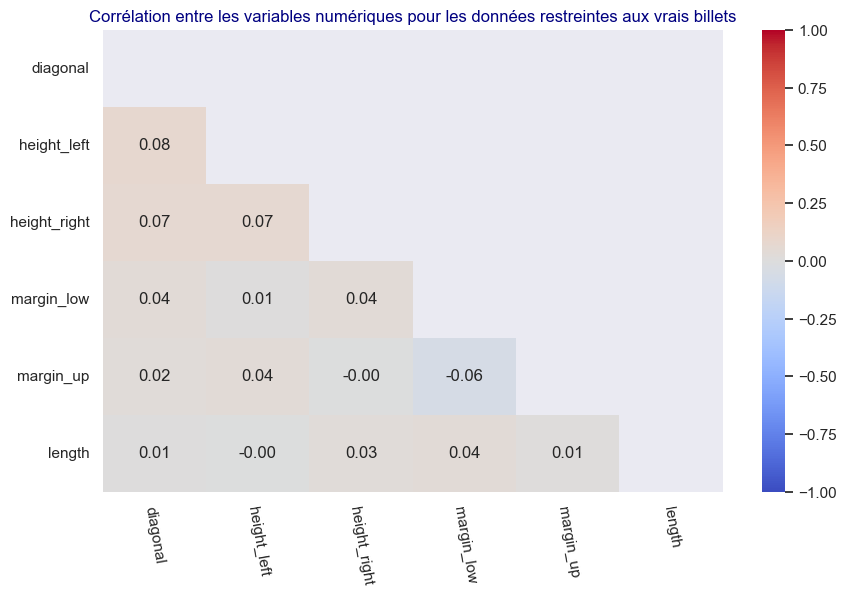

In [61]:
# Visualisation de la Matrice de corrélation pour les données restreintes aux vrais billets

#mask des données restreintes aux vrais billets
mask_temp = (df_billets_analyse_1_1['is_genuine']==True)

df_temp = df_billets_analyse_1_1.loc[mask_temp,var_quant]

#mask_triangulaire
mask_semi_heatmap = np.triu(np.ones( (df_temp.corr(method='pearson')).shape  ))

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(10, 6))
sns.heatmap(df_temp.corr(method='pearson'), 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f",
            mask = mask_semi_heatmap
           )
plt.title("Corrélation entre les variables numériques pour les données restreintes aux vrais billets")
plt.xticks(rotation=-80)
plt.grid(visible=False)
plt.show()

##### GRAPH CORRELATION pour les données restreintes aux faux billets

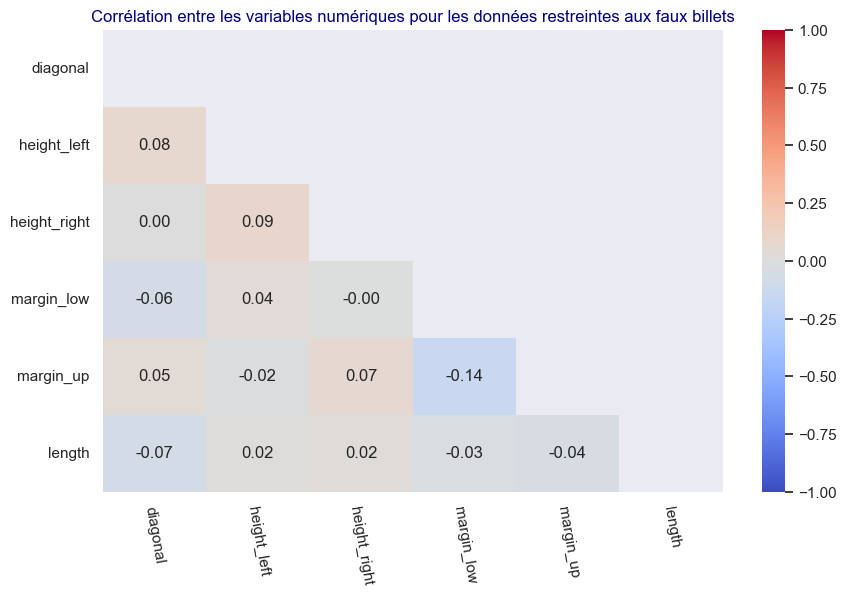

In [62]:
# Visualisation de la Matrice de corrélation pour les données restreintes aux faux billets

#mask des données restreintes aux vrais billets
mask_temp = (df_billets_analyse_1_1['is_genuine']==False)

df_temp = df_billets_analyse_1_1.loc[mask_temp,var_quant]

#mask_triangulaire
mask_semi_heatmap = np.triu(np.ones( (df_temp.corr(method='pearson')).shape  ))

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(10, 6))
sns.heatmap(df_temp.corr(method='pearson'), 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f",
            mask = mask_semi_heatmap
           )
plt.title("Corrélation entre les variables numériques pour les données restreintes aux faux billets")
plt.xticks(rotation=-80)
plt.grid(visible=False)
plt.show()

#####

##### FIN GRAPH CORRELATION

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2.2 - Analyse Univariée des variables quantitatives </h3>
</div>

##### Premières visualisation (pas les meilleures) :


 Analyse de la variable : diagonal
--------------------------------------------------
count    1500.000000
mean      171.958440
std         0.305195
min       171.040000
25%       171.750000
50%       171.960000
75%       172.170000
max       173.010000
Name: diagonal, dtype: float64
 Valeurs manquantes : 0
 Valeurs distinctes : 159


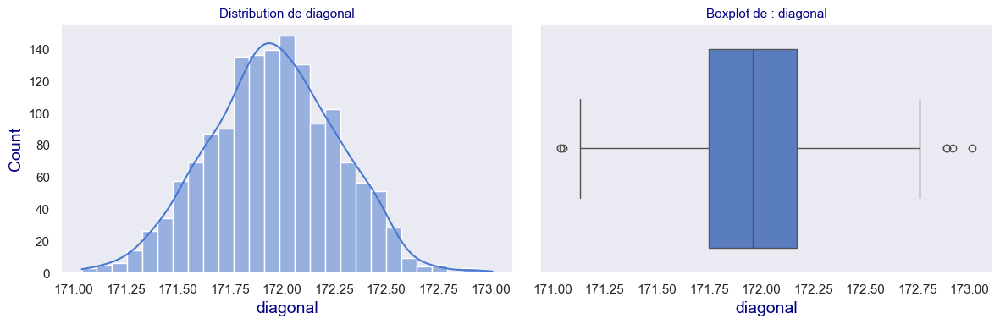


 Analyse de la variable : height_left
--------------------------------------------------
count    1500.000000
mean      104.029533
std         0.299462
min       103.140000
25%       103.820000
50%       104.040000
75%       104.230000
max       104.880000
Name: height_left, dtype: float64
 Valeurs manquantes : 0
 Valeurs distinctes : 155


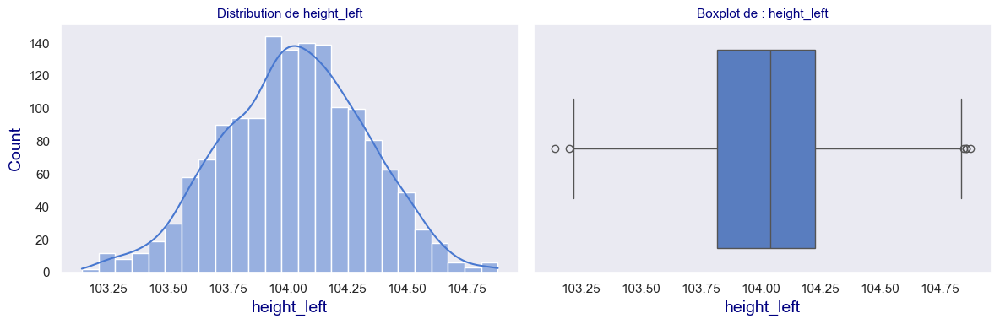


 Analyse de la variable : height_right
--------------------------------------------------
count    1500.000000
mean      103.920307
std         0.325627
min       102.820000
25%       103.710000
50%       103.920000
75%       104.150000
max       104.950000
Name: height_right, dtype: float64
 Valeurs manquantes : 0
 Valeurs distinctes : 170


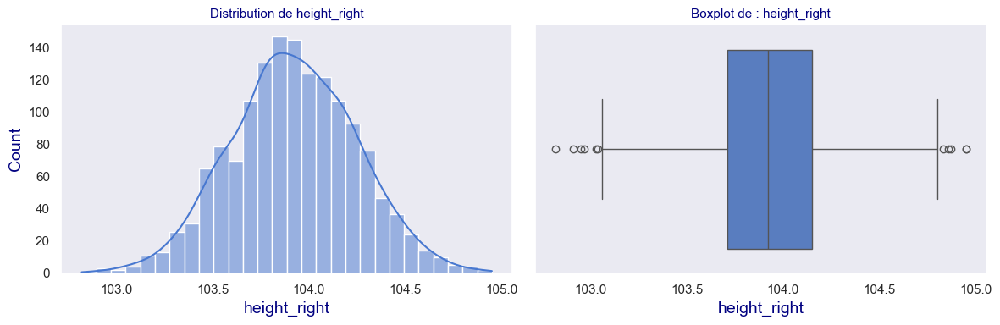


 Analyse de la variable : margin_low
--------------------------------------------------
count    1463.000000
mean        4.485967
std         0.663813
min         2.980000
25%         4.015000
50%         4.310000
75%         4.870000
max         6.900000
Name: margin_low, dtype: float64
 Valeurs manquantes : 37
 Valeurs distinctes : 285


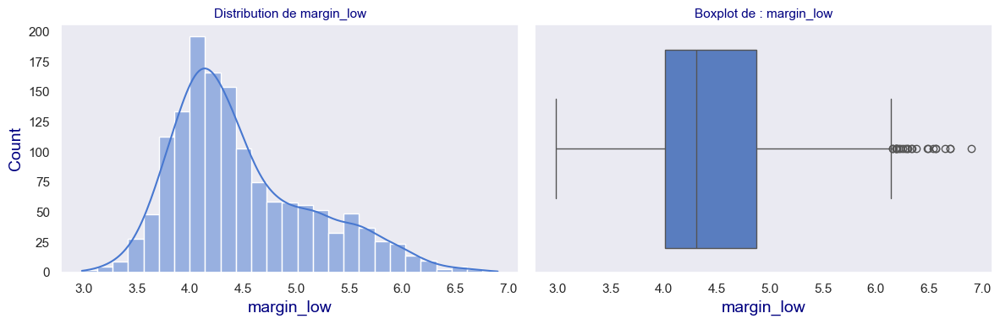


 Analyse de la variable : margin_up
--------------------------------------------------
count    1500.000000
mean        3.151473
std         0.231813
min         2.270000
25%         2.990000
50%         3.140000
75%         3.310000
max         3.910000
Name: margin_up, dtype: float64
 Valeurs manquantes : 0
 Valeurs distinctes : 123


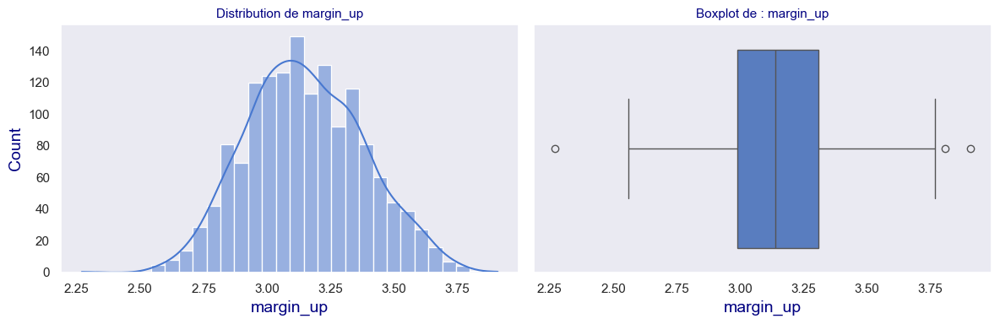


 Analyse de la variable : length
--------------------------------------------------
count    1500.00000
mean      112.67850
std         0.87273
min       109.49000
25%       112.03000
50%       112.96000
75%       113.34000
max       114.44000
Name: length, dtype: float64
 Valeurs manquantes : 0
 Valeurs distinctes : 336


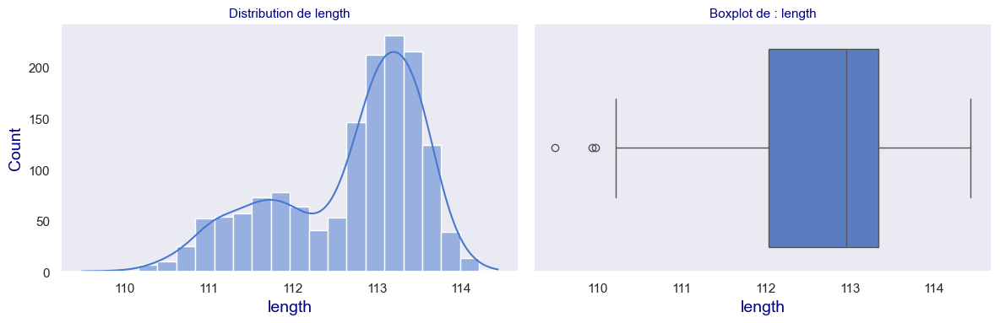

In [63]:
#import pandas as pd
#import matplotlib.pyplot as plt
#import seaborn as sns

# liste de mes 9 Variables numériques à analyser déjà créée précédemment
var_quant 

# Paramètres d'affichage
#sns.set(style="whitegrid")
#plt.style.use('ggplot')

# Boucle sur chaque variable
for var in var_quant:
    print(f"\n Analyse de la variable : {var}")
    print("--------------------------------------------------")
    
    # Statistiques descriptives
    print(df_billets_analyse_1_1[var].describe())
    
    # Valeurs manquantes
    nb_na = df_billets_analyse_1_1[var].isna().sum()
    print(f" Valeurs manquantes : {nb_na}")
    
    # Valeurs uniques
    nb_unique = df_billets_analyse_1_1[var].nunique()
    print(f" Valeurs distinctes : {nb_unique}")
    
    # Création des visualisations
    fig, axes = plt.subplots(1, 2, figsize=(12, 4))
    
    # Histogramme
    sns.histplot(data=df_billets_analyse_1_1, x=var, kde=True, ax=axes[0]#, color='skyblue'
                )
    axes[0].set_title(f'Distribution de {var}', fontsize=11)
    
    # Boxplot
    sns.boxplot(data=df_billets_analyse_1_1, x=var, ax=axes[1]#, color='lightgreen'
               )
    axes[1].set_title(f'Boxplot de : {var}', fontsize=11)
    
    plt.tight_layout()
    plt.show()


 Analyse de la variable : diagonal
--------------------------------------------------
count    1500.000000
mean      171.958440
std         0.305195
min       171.040000
25%       171.750000
50%       171.960000
75%       172.170000
max       173.010000
Name: diagonal, dtype: float64
 Valeurs manquantes : 0
 Valeurs distinctes : 159


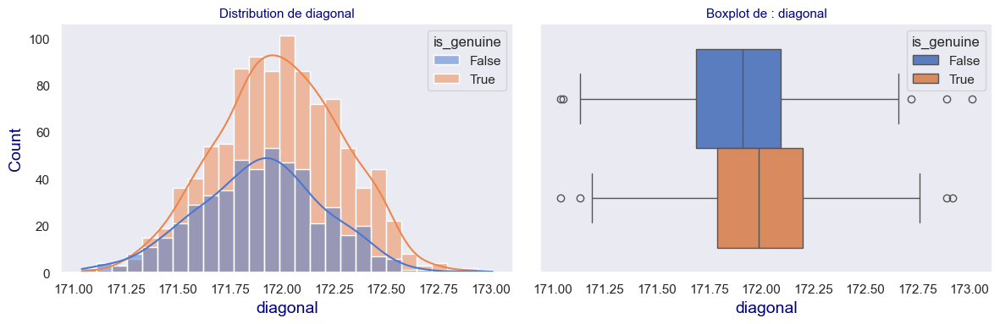


 Analyse de la variable : height_left
--------------------------------------------------
count    1500.000000
mean      104.029533
std         0.299462
min       103.140000
25%       103.820000
50%       104.040000
75%       104.230000
max       104.880000
Name: height_left, dtype: float64
 Valeurs manquantes : 0
 Valeurs distinctes : 155


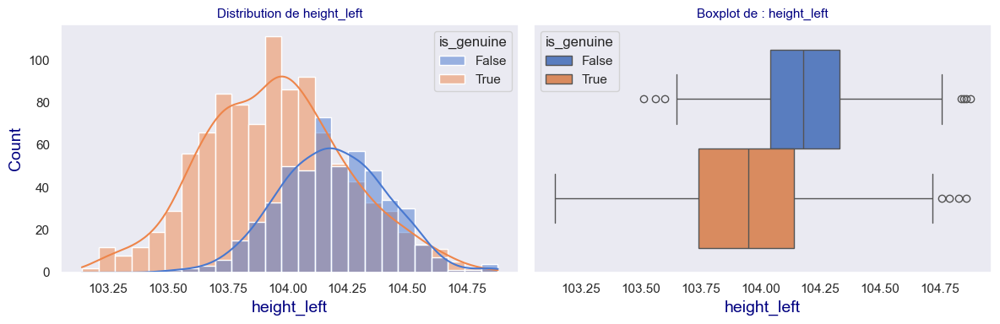


 Analyse de la variable : height_right
--------------------------------------------------
count    1500.000000
mean      103.920307
std         0.325627
min       102.820000
25%       103.710000
50%       103.920000
75%       104.150000
max       104.950000
Name: height_right, dtype: float64
 Valeurs manquantes : 0
 Valeurs distinctes : 170


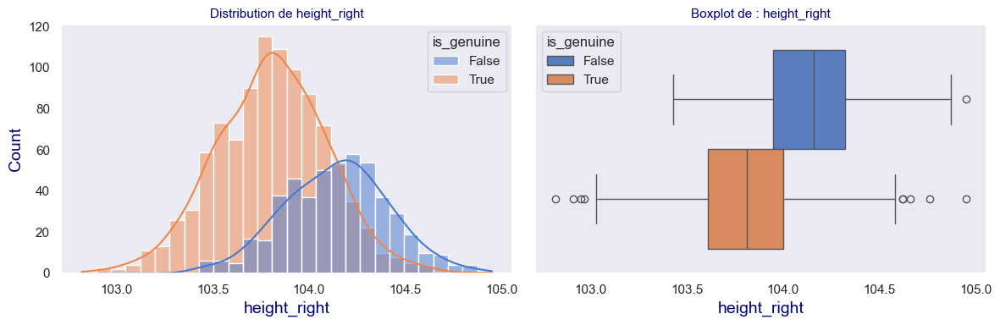


 Analyse de la variable : margin_low
--------------------------------------------------
count    1463.000000
mean        4.485967
std         0.663813
min         2.980000
25%         4.015000
50%         4.310000
75%         4.870000
max         6.900000
Name: margin_low, dtype: float64
 Valeurs manquantes : 37
 Valeurs distinctes : 285


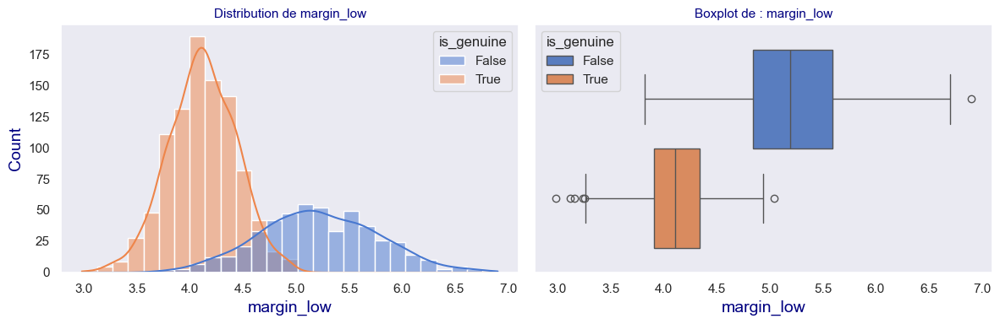


 Analyse de la variable : margin_up
--------------------------------------------------
count    1500.000000
mean        3.151473
std         0.231813
min         2.270000
25%         2.990000
50%         3.140000
75%         3.310000
max         3.910000
Name: margin_up, dtype: float64
 Valeurs manquantes : 0
 Valeurs distinctes : 123


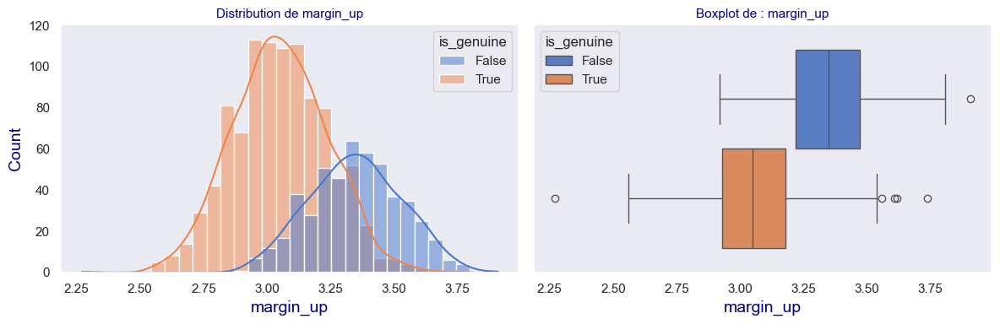


 Analyse de la variable : length
--------------------------------------------------
count    1500.00000
mean      112.67850
std         0.87273
min       109.49000
25%       112.03000
50%       112.96000
75%       113.34000
max       114.44000
Name: length, dtype: float64
 Valeurs manquantes : 0
 Valeurs distinctes : 336


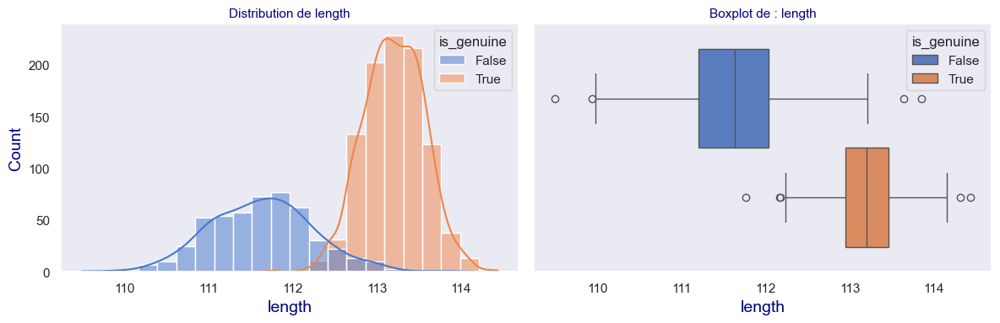

In [64]:
#import pandas as pd
#import matplotlib.pyplot as plt
#import seaborn as sns

# liste de mes 9 Variables numériques à analyser déjà créée précédemment
var_quant 

# Paramètres d'affichage
#sns.set(style="whitegrid")
#plt.style.use('ggplot')

# Boucle sur chaque variable
for var in var_quant:
    print(f"\n Analyse de la variable : {var}")
    print("--------------------------------------------------")
    
    # Statistiques descriptives
    print(df_billets_analyse_1_1[var].describe())
    
    # Valeurs manquantes
    nb_na = df_billets_analyse_1_1[var].isna().sum()
    print(f" Valeurs manquantes : {nb_na}")
    
    # Valeurs uniques
    nb_unique = df_billets_analyse_1_1[var].nunique()
    print(f" Valeurs distinctes : {nb_unique}")
    
    # Création des visualisations
    fig, axes = plt.subplots(1, 2, figsize=(12, 4))
    
    # Histogramme
    sns.histplot(data=df_billets_analyse_1_1, 
                 x=var, 
                 kde=True,
                 hue='is_genuine',
                 hue_order = Ordre_genuine,
                 palette=palette_fixe_genuine,
                 ax=axes[0]#, color='skyblue'
                )
    axes[0].set_title(f'Distribution de {var}', fontsize=11)
    
    # Boxplot
    sns.boxplot(data=df_billets_analyse_1_1, 
                x=var,
                hue='is_genuine',
                hue_order = Ordre_genuine,
                palette=palette_fixe_genuine,
                ax=axes[1]#, color='lightgreen'
               )
    axes[1].set_title(f'Boxplot de : {var}', fontsize=11)
    
    plt.tight_layout()
    plt.show()


 Analyse de la variable : diagonal
--------------------------------------------------
count    1500.000000
mean      171.958440
std         0.305195
min       171.040000
25%       171.750000
50%       171.960000
75%       172.170000
max       173.010000
Name: diagonal, dtype: float64
 Valeurs manquantes : 0
 Valeurs distinctes : 159


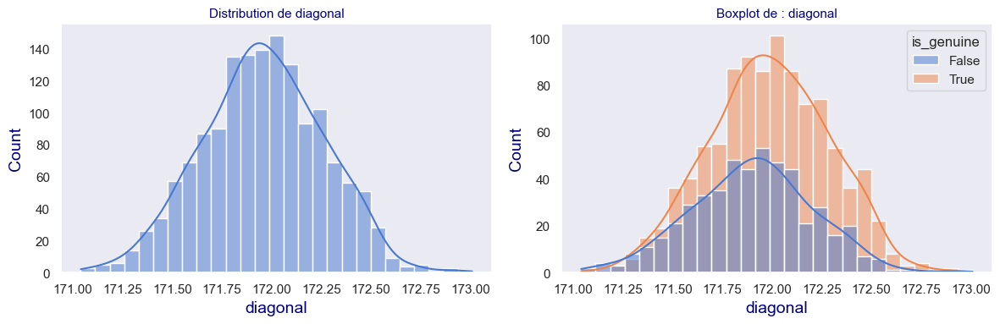


 Analyse de la variable : height_left
--------------------------------------------------
count    1500.000000
mean      104.029533
std         0.299462
min       103.140000
25%       103.820000
50%       104.040000
75%       104.230000
max       104.880000
Name: height_left, dtype: float64
 Valeurs manquantes : 0
 Valeurs distinctes : 155


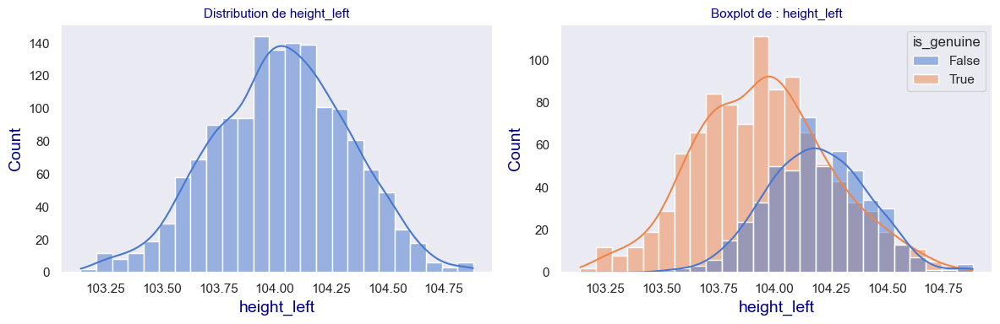


 Analyse de la variable : height_right
--------------------------------------------------
count    1500.000000
mean      103.920307
std         0.325627
min       102.820000
25%       103.710000
50%       103.920000
75%       104.150000
max       104.950000
Name: height_right, dtype: float64
 Valeurs manquantes : 0
 Valeurs distinctes : 170


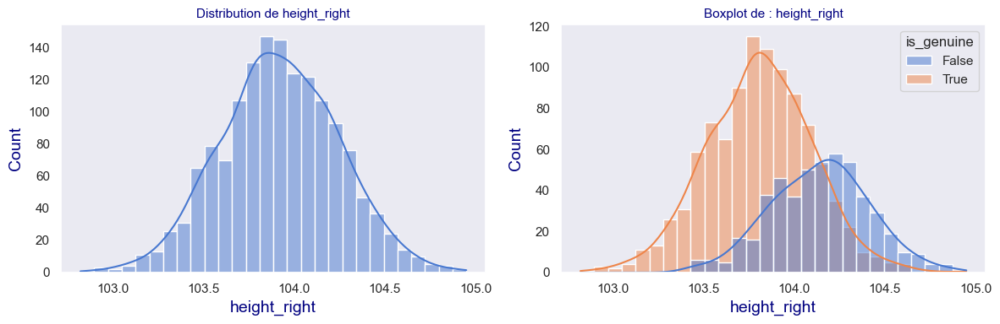


 Analyse de la variable : margin_low
--------------------------------------------------
count    1463.000000
mean        4.485967
std         0.663813
min         2.980000
25%         4.015000
50%         4.310000
75%         4.870000
max         6.900000
Name: margin_low, dtype: float64
 Valeurs manquantes : 37
 Valeurs distinctes : 285


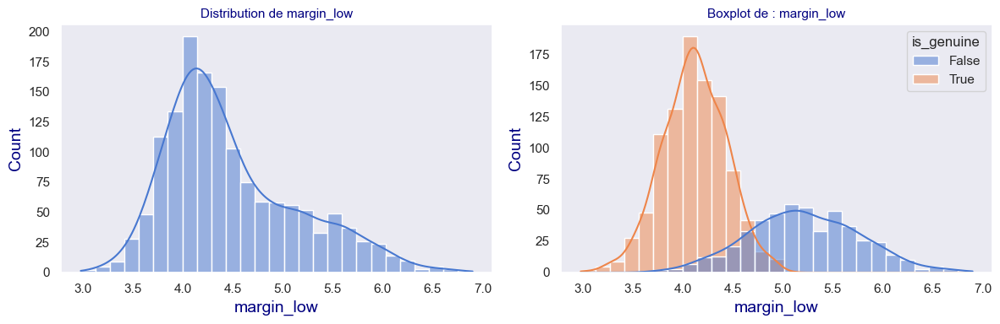


 Analyse de la variable : margin_up
--------------------------------------------------
count    1500.000000
mean        3.151473
std         0.231813
min         2.270000
25%         2.990000
50%         3.140000
75%         3.310000
max         3.910000
Name: margin_up, dtype: float64
 Valeurs manquantes : 0
 Valeurs distinctes : 123


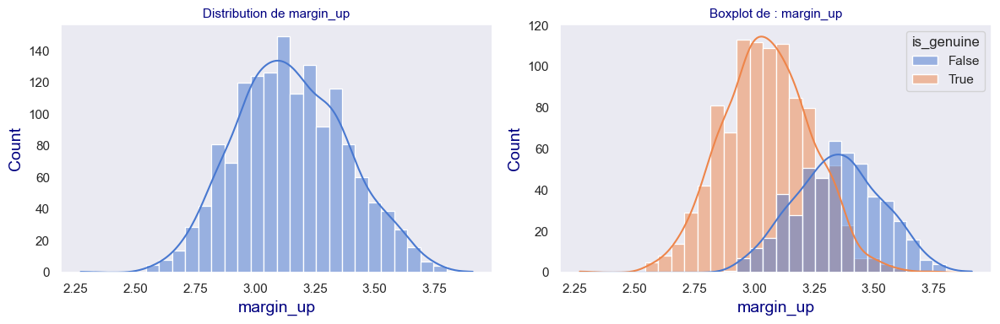


 Analyse de la variable : length
--------------------------------------------------
count    1500.00000
mean      112.67850
std         0.87273
min       109.49000
25%       112.03000
50%       112.96000
75%       113.34000
max       114.44000
Name: length, dtype: float64
 Valeurs manquantes : 0
 Valeurs distinctes : 336


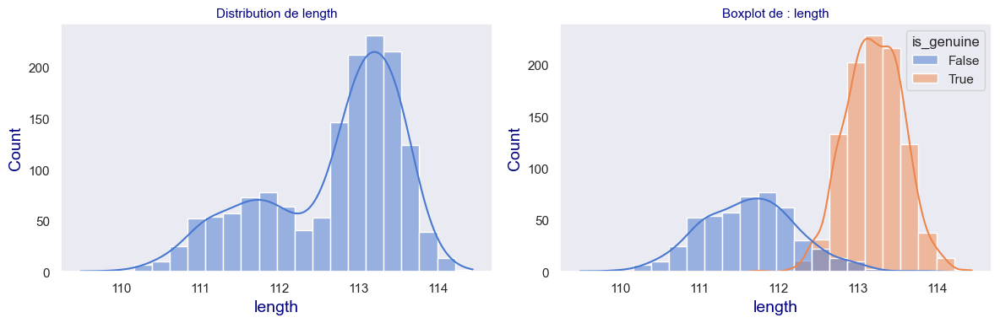

In [65]:
#import pandas as pd
#import matplotlib.pyplot as plt
#import seaborn as sns

# liste de mes 9 Variables numériques à analyser déjà créée précédemment
var_quant 

# Paramètres d'affichage
#sns.set(style="whitegrid")
#plt.style.use('ggplot')

# Boucle sur chaque variable
for var in var_quant:
    print(f"\n Analyse de la variable : {var}")
    print("--------------------------------------------------")
    
    # Statistiques descriptives
    print(df_billets_analyse_1_1[var].describe())
    
    # Valeurs manquantes
    nb_na = df_billets_analyse_1_1[var].isna().sum()
    print(f" Valeurs manquantes : {nb_na}")
    
    # Valeurs uniques
    nb_unique = df_billets_analyse_1_1[var].nunique()
    print(f" Valeurs distinctes : {nb_unique}")
    
    # Création des visualisations
    fig, axes = plt.subplots(1, 2, figsize=(12, 4))
    
    # Histogramme
    sns.histplot(data=df_billets_analyse_1_1, 
                 x=var, 
                 kde=True,
                 ax=axes[0]#, color='skyblue'
                )
    axes[0].set_title(f'Distribution de {var}', fontsize=11)
    
    # Histogramme par Authenticité
    sns.histplot(data=df_billets_analyse_1_1, 
                 x=var, 
                 kde=True,
                 hue='is_genuine',
                 hue_order = Ordre_genuine,
                 palette=palette_fixe_genuine,
                ax=axes[1]#, color='lightgreen'
               )
    axes[1].set_title(f'Boxplot de : {var}', fontsize=11)
    
    plt.tight_layout()
    plt.show()

##### Visualisation qui semble la plus pertinente :


 Analyse de la variable : diagonal
--------------------------------------------------
 Valeurs manquantes : 0


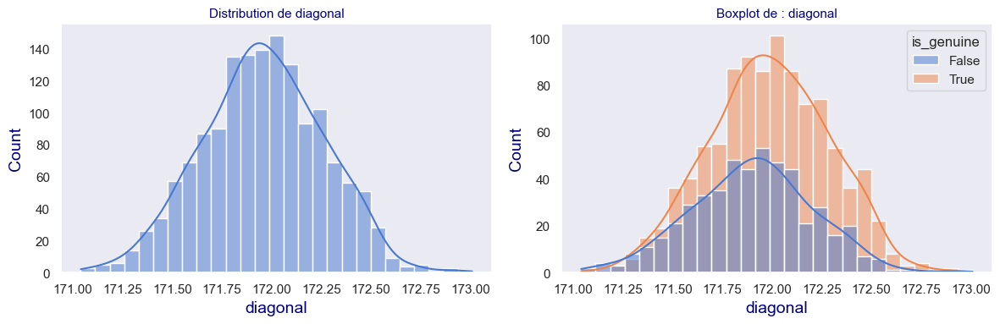


 Analyse de la variable : height_left
--------------------------------------------------
 Valeurs manquantes : 0


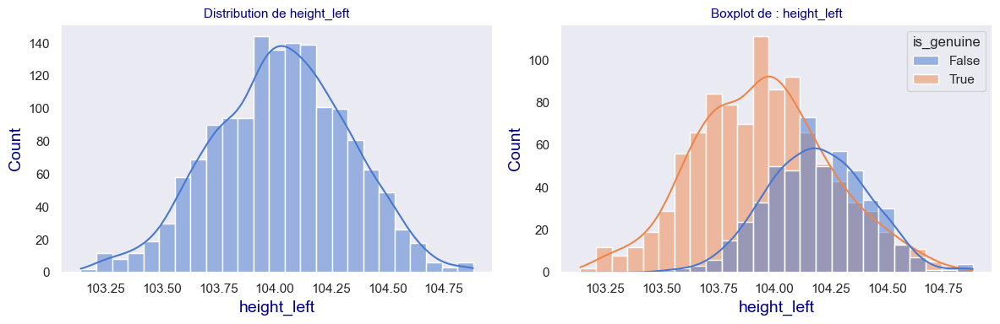


 Analyse de la variable : height_right
--------------------------------------------------
 Valeurs manquantes : 0


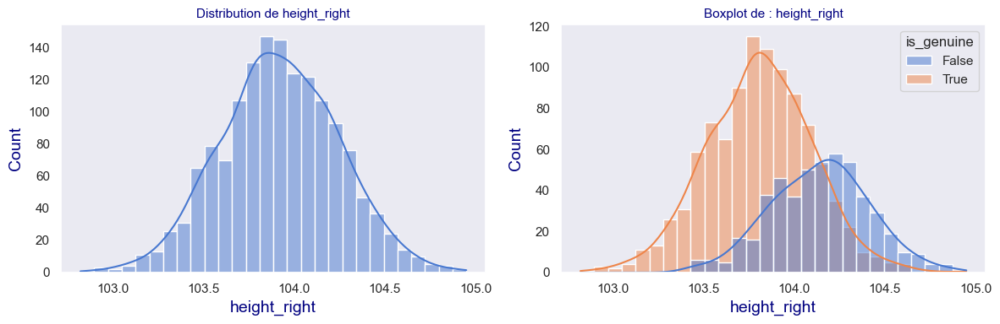


 Analyse de la variable : margin_low
--------------------------------------------------
 Valeurs manquantes : 37


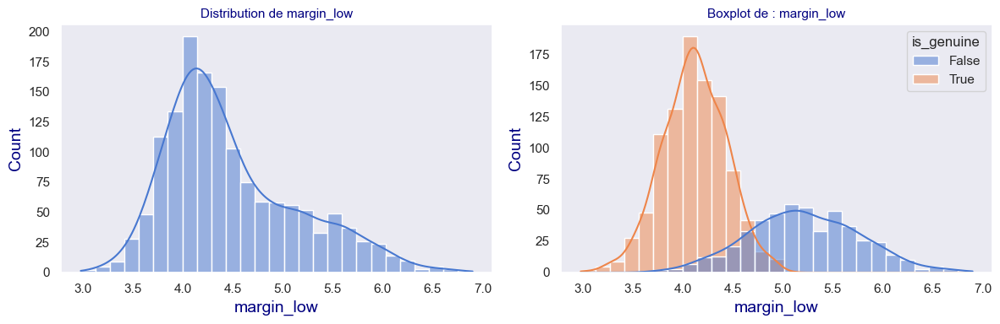


 Analyse de la variable : margin_up
--------------------------------------------------
 Valeurs manquantes : 0


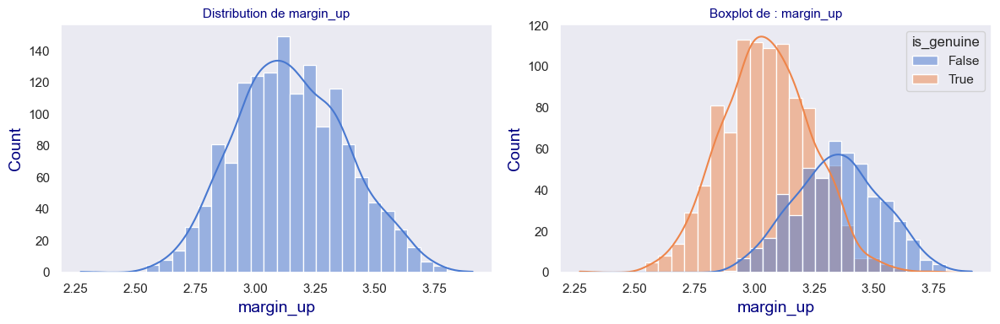


 Analyse de la variable : length
--------------------------------------------------
 Valeurs manquantes : 0


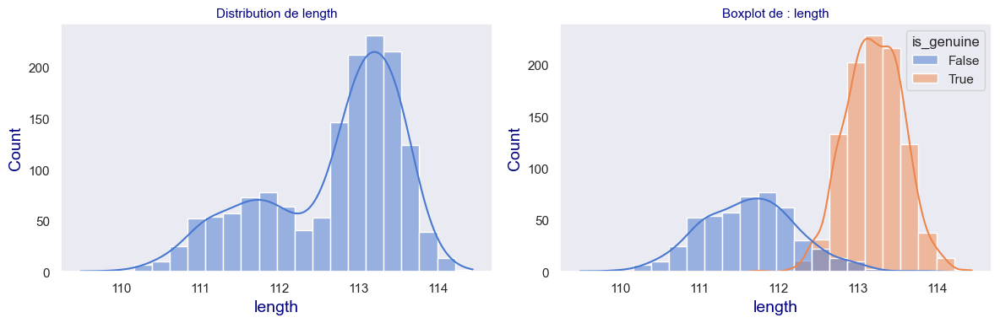

In [66]:
#import pandas as pd
#import matplotlib.pyplot as plt
#import seaborn as sns

# liste de mes 9 Variables numériques à analyser déjà créée précédemment
var_quant 

# Paramètres d'affichage
#sns.set(style="whitegrid")
#plt.style.use('ggplot')

# Boucle sur chaque variable
for var in var_quant:
    print(f"\n Analyse de la variable : {var}")
    print("--------------------------------------------------")
    
    # Valeurs manquantes
    nb_na = df_billets_analyse_1_1[var].isna().sum()
    print(f" Valeurs manquantes : {nb_na}")
        
    # Création des visualisations
    fig, axes = plt.subplots(1, 2, figsize=(12, 4))
    
    # Histogramme
    sns.histplot(data=df_billets_analyse_1_1, 
                 x=var, 
                 kde=True,
                 ax=axes[0]#, color='skyblue'
                )
    axes[0].set_title(f'Distribution de {var}', fontsize=11)
    
    # Histogramme par Authenticité
    sns.histplot(data=df_billets_analyse_1_1, 
                 x=var, 
                 kde=True,
                 hue='is_genuine',
                 hue_order = Ordre_genuine,
                 palette=palette_fixe_genuine,
                ax=axes[1]#, color='lightgreen'
               )
    axes[1].set_title(f'Boxplot de : {var}', fontsize=11)
    
    plt.tight_layout()
    plt.show()

**OBSERVATIONS :**  
On observe un décalage entre les valeurs des Faux et des vrais billets, encore plus net pour les variables :  
`margin_low` , `margin_up`, `length`

In [67]:
var_quant

['diagonal',
 'height_left',
 'height_right',
 'margin_low',
 'margin_up',
 'length']

In [68]:
df_graph = df_billets_analyse_1_1.copy(deep=True)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2.2.1 - Variable `diagonal`   : </h4>
</div>

In [69]:
#copie temporaire de df_billets_analyse_1_1
df_graph.head()

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09
2,True,172.69,104.48,103.50,4.40,2.94,113.16
3,True,171.36,103.91,103.94,3.62,3.01,113.51
4,True,171.73,104.28,103.46,4.04,3.48,112.54


In [70]:
var = 'diagonal'

In [71]:
Premieres_Analyses(df_graph[var])


---- SHAPE ----


(1500,)


---- INFO ----
<class 'pandas.core.series.Series'>
RangeIndex: 1500 entries, 0 to 1499
Series name: diagonal
Non-Null Count  Dtype  
--------------  -----  
1500 non-null   float64
dtypes: float64(1)
memory usage: 11.8 KB

---- DESCRIBE ----


count    1500.000000
mean      171.958440
std         0.305195
min       171.040000
25%       171.750000
50%       171.960000
75%       172.170000
max       173.010000
Name: diagonal, dtype: float64


---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
diagonal,float64,1500,1500,0,159,NaN


##### <font color='blue'><u>**REPARTITION**</u></font>

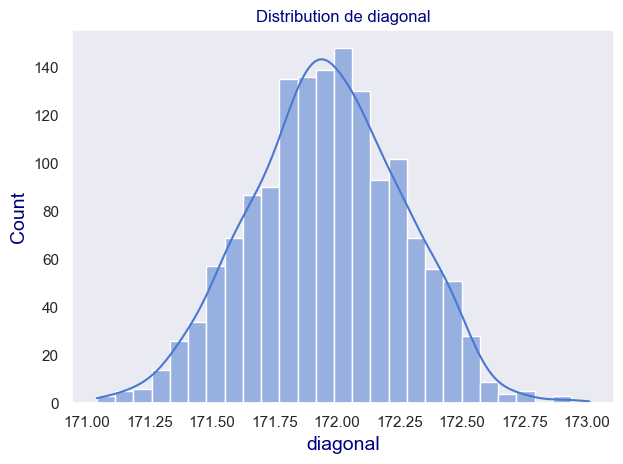

In [72]:
# Histogramme
sns.histplot(data=df_graph, 
             x=var, 
             kde=True #, color='blue'
            )
plt.title(f'Distribution de {var}')
plt.tight_layout()
plt.show()

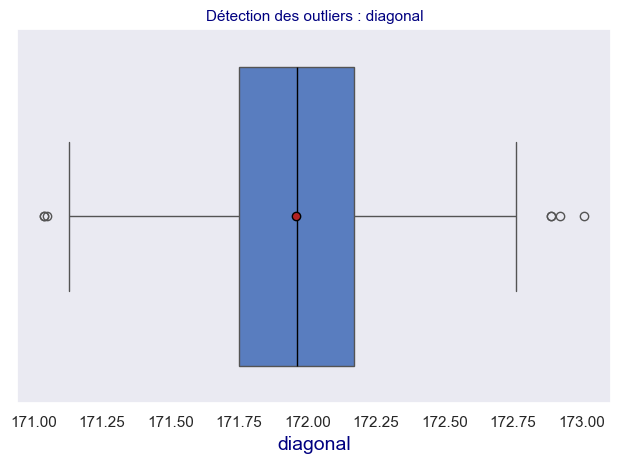

In [73]:
# Boxplot
sns.boxplot(data=df_graph, 
            x=var,
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True #, #c'est ce qui permet de faire apparaitre la moyenne,
            #, color='lightgreen'
           )
plt.title(f'Détection des outliers : {var}', fontsize=11)

plt.tight_layout()
plt.show()

In [74]:
Q1 = (df_graph[var].describe() )['25%']
Q2 = (df_graph[var].describe() )['50%']
Q3 = (df_graph[var].describe() )['75%']
IQ = Q3-Q1
seuil_bas_outlier = Q1-(1.5*IQ)
seuil_haut_outlier = Q3+(1.5*IQ)

print("l'intervalle interquatile IQ vaut : ",round(IQ,2),
      "\nle seuil bas  en deça duquel on est outliers est : ", round(seuil_bas_outlier,2) ,
      "\nle seuil haut au dessus duquel on est outliers est : ", round(seuil_haut_outlier,2)
     )

l'intervalle interquatile IQ vaut :  0.42 
le seuil bas  en deça duquel on est outliers est :  171.12 
le seuil haut au dessus duquel on est outliers est :  172.8


In [75]:
#les outliers :
mask_outlier = (df_graph[var]<seuil_bas_outlier)|(seuil_haut_outlier<df_graph[var])
df_outlier = df_graph.loc[mask_outlier,:]
nb_outlier = len(df_outlier)
prop_outlier = (nb_outlier/len(df_graph))*100

print("Il y a ", nb_outlier , " 'outliers'.",
      "\nCe qui représente ", round(prop_outlier,2) ," % des pays."
     )
print("\nles outliers sont : ")
display(df_outlier[['is_genuine',var]].sort_values(by=var,ascending=False))

Il y a  7  'outliers'. 
Ce qui représente  0.47  % des pays.

les outliers sont : 


,is_genuine,diagonal
1277,False,173.01
828,True,172.92
842,True,172.89
1022,False,172.89
1388,False,171.05
729,True,171.04
1142,False,171.04


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2.2.2 - Variable 'height_left'   : </h4>
</div>

In [76]:
#copie temporaire de df_billets_analyse_1_1
df_graph.head()

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09
2,True,172.69,104.48,103.50,4.40,2.94,113.16
3,True,171.36,103.91,103.94,3.62,3.01,113.51
4,True,171.73,104.28,103.46,4.04,3.48,112.54


In [77]:
var = 'height_left'

In [78]:
Premieres_Analyses(df_graph[var])


---- SHAPE ----


(1500,)


---- INFO ----
<class 'pandas.core.series.Series'>
RangeIndex: 1500 entries, 0 to 1499
Series name: height_left
Non-Null Count  Dtype  
--------------  -----  
1500 non-null   float64
dtypes: float64(1)
memory usage: 11.8 KB

---- DESCRIBE ----


count    1500.000000
mean      104.029533
std         0.299462
min       103.140000
25%       103.820000
50%       104.040000
75%       104.230000
max       104.880000
Name: height_left, dtype: float64


---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
height_left,float64,1500,1500,0,155,NaN


##### <font color='blue'><u>**REPARTITION**</u></font>

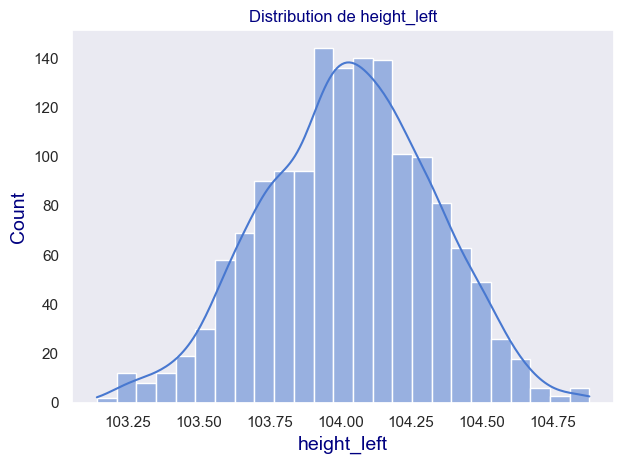

In [79]:
# Histogramme
sns.histplot(data=df_graph, 
             x=var, 
             kde=True #, color='blue'
            )
plt.title(f'Distribution de {var}')
plt.tight_layout()
plt.show()

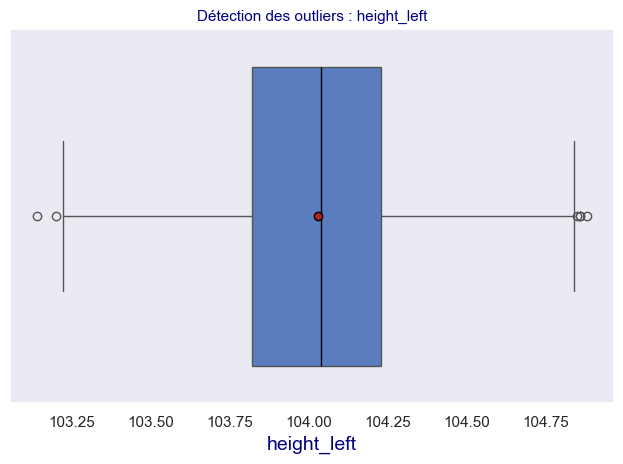

In [80]:
# Boxplot
sns.boxplot(data=df_graph, 
            x=var,
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True #, #c'est ce qui permet de faire apparaitre la moyenne,
            #, color='lightgreen'
           )
plt.title(f'Détection des outliers : {var}', fontsize=11)

plt.tight_layout()
plt.show()

In [81]:
Q1 = (df_graph[var].describe() )['25%']
Q2 = (df_graph[var].describe() )['50%']
Q3 = (df_graph[var].describe() )['75%']
IQ = Q3-Q1
seuil_bas_outlier = Q1-(1.5*IQ)
seuil_haut_outlier = Q3+(1.5*IQ)

print("l'intervalle interquatile IQ vaut : ",round(IQ,2),
      "\nle seuil bas  en deça duquel on est outliers est : ", round(seuil_bas_outlier,2) ,
      "\nle seuil haut au dessus duquel on est outliers est : ", round(seuil_haut_outlier,2)
     )

l'intervalle interquatile IQ vaut :  0.41 
le seuil bas  en deça duquel on est outliers est :  103.2 
le seuil haut au dessus duquel on est outliers est :  104.85


In [82]:
#les outliers :
mask_outlier = (df_graph[var]<seuil_bas_outlier)|(seuil_haut_outlier<df_graph[var])
df_outlier = df_graph.loc[mask_outlier,:]
nb_outlier = len(df_outlier)
prop_outlier = (nb_outlier/len(df_graph))*100

print("Il y a ", nb_outlier , " 'outliers'.",
      "\nCe qui représente ", round(prop_outlier,2) ," % des pays."
     )
print("\nles outliers sont : ")
display(df_outlier[['is_genuine',var]].sort_values(by=var,ascending=False))

Il y a  6  'outliers'. 
Ce qui représente  0.4  % des pays.

les outliers sont : 


,is_genuine,height_left
1090,False,104.88
0,True,104.86
1150,False,104.86
1382,False,104.85
224,True,103.20
292,True,103.14


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2.2.3 - Variable 'height_right'   : </h4>
</div>

In [83]:
#copie temporaire de df_billets_analyse_1_1
df_graph.head()

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09
2,True,172.69,104.48,103.50,4.40,2.94,113.16
3,True,171.36,103.91,103.94,3.62,3.01,113.51
4,True,171.73,104.28,103.46,4.04,3.48,112.54


In [84]:
var = 'height_right'

In [85]:
Premieres_Analyses(df_graph[var])


---- SHAPE ----


(1500,)


---- INFO ----
<class 'pandas.core.series.Series'>
RangeIndex: 1500 entries, 0 to 1499
Series name: height_right
Non-Null Count  Dtype  
--------------  -----  
1500 non-null   float64
dtypes: float64(1)
memory usage: 11.8 KB

---- DESCRIBE ----


count    1500.000000
mean      103.920307
std         0.325627
min       102.820000
25%       103.710000
50%       103.920000
75%       104.150000
max       104.950000
Name: height_right, dtype: float64


---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
height_right,float64,1500,1500,0,170,NaN


##### <font color='blue'><u>**REPARTITION**</u></font>

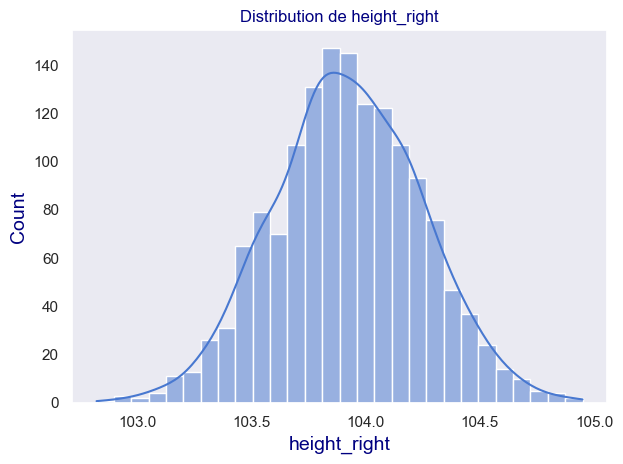

In [86]:
# Histogramme
sns.histplot(data=df_graph, 
             x=var, 
             kde=True #, color='blue'
            )
plt.title(f'Distribution de {var}')
plt.tight_layout()
plt.show()

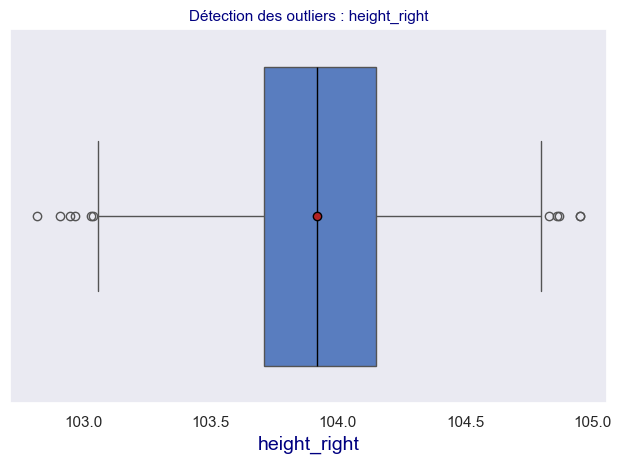

In [87]:
# Boxplot
sns.boxplot(data=df_graph, 
            x=var,
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True #, #c'est ce qui permet de faire apparaitre la moyenne,
            #, color='lightgreen'
           )
plt.title(f'Détection des outliers : {var}', fontsize=11)

plt.tight_layout()
plt.show()

In [88]:
Q1 = (df_graph[var].describe() )['25%']
Q2 = (df_graph[var].describe() )['50%']
Q3 = (df_graph[var].describe() )['75%']
IQ = Q3-Q1
seuil_bas_outlier = Q1-(1.5*IQ)
seuil_haut_outlier = Q3+(1.5*IQ)

print("l'intervalle interquatile IQ vaut : ",round(IQ,2),
      "\nle seuil bas  en deça duquel on est outliers est : ", round(seuil_bas_outlier,2) ,
      "\nle seuil haut au dessus duquel on est outliers est : ", round(seuil_haut_outlier,2)
     )

l'intervalle interquatile IQ vaut :  0.44 
le seuil bas  en deça duquel on est outliers est :  103.05 
le seuil haut au dessus duquel on est outliers est :  104.81


In [89]:
#les outliers :
mask_outlier = (df_graph[var]<seuil_bas_outlier)|(seuil_haut_outlier<df_graph[var])
df_outlier = df_graph.loc[mask_outlier,:]
nb_outlier = len(df_outlier)
prop_outlier = (nb_outlier/len(df_graph))*100

print("Il y a ", nb_outlier , " 'outliers'.",
      "\nCe qui représente ", round(prop_outlier,2) ," % des pays."
     )
print("\nles outliers sont : ")
display(df_outlier[['is_genuine',var]].sort_values(by=var,ascending=False))

Il y a  11  'outliers'. 
Ce qui représente  0.73  % des pays.

les outliers sont : 


,is_genuine,height_right
0,True,104.95
1484,False,104.95
1199,False,104.87
1321,False,104.86
1331,False,104.83
761,True,103.04
77,True,103.03
176,True,102.97
193,True,102.95
522,True,102.91


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2.2.4 - Variable 'margin_low'   : </h4>
</div>

In [90]:
#copie temporaire de df_billets_analyse_1_1
df_graph.head()

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09
2,True,172.69,104.48,103.50,4.40,2.94,113.16
3,True,171.36,103.91,103.94,3.62,3.01,113.51
4,True,171.73,104.28,103.46,4.04,3.48,112.54


In [91]:
var = 'margin_low'

In [92]:
Premieres_Analyses(df_graph[var])


---- SHAPE ----


(1500,)


---- INFO ----
<class 'pandas.core.series.Series'>
RangeIndex: 1500 entries, 0 to 1499
Series name: margin_low
Non-Null Count  Dtype  
--------------  -----  
1463 non-null   float64
dtypes: float64(1)
memory usage: 11.8 KB

---- DESCRIBE ----


count    1463.000000
mean        4.485967
std         0.663813
min         2.980000
25%         4.015000
50%         4.310000
75%         4.870000
max         6.900000
Name: margin_low, dtype: float64


---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
margin_low,float64,1500,1463,37,285,NaN


##### <font color='blue'><u>**REPARTITION**</u></font>

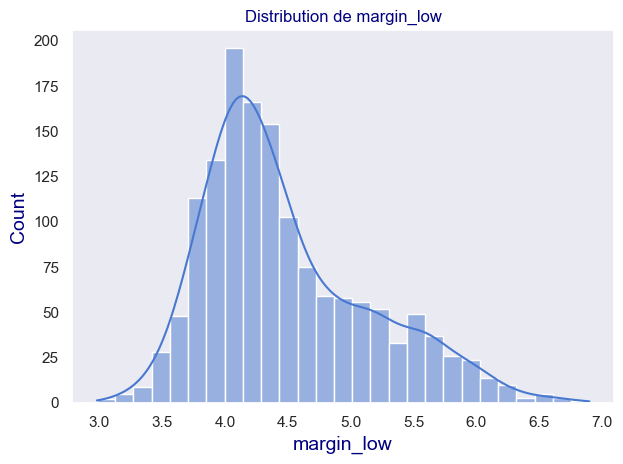

In [93]:
# Histogramme
sns.histplot(data=df_graph, 
             x=var, 
             kde=True #, color='blue'
            )
plt.title(f'Distribution de {var}')
plt.tight_layout()
plt.show()

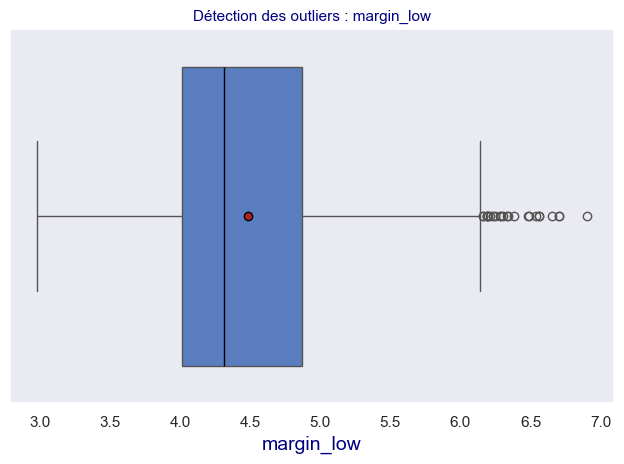

In [94]:
# Boxplot
sns.boxplot(data=df_graph, 
            x=var,
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True #, #c'est ce qui permet de faire apparaitre la moyenne,
            #, color='lightgreen'
           )
plt.title(f'Détection des outliers : {var}', fontsize=11)

plt.tight_layout()
plt.show()

In [95]:
Q1 = (df_graph[var].describe() )['25%']
Q2 = (df_graph[var].describe() )['50%']
Q3 = (df_graph[var].describe() )['75%']
IQ = Q3-Q1
seuil_bas_outlier = Q1-(1.5*IQ)
seuil_haut_outlier = Q3+(1.5*IQ)

print("l'intervalle interquatile IQ vaut : ",round(IQ,2),
      "\nle seuil bas  en deça duquel on est outliers est : ", round(seuil_bas_outlier,2) ,
      "\nle seuil haut au dessus duquel on est outliers est : ", round(seuil_haut_outlier,2)
     )

l'intervalle interquatile IQ vaut :  0.86 
le seuil bas  en deça duquel on est outliers est :  2.73 
le seuil haut au dessus duquel on est outliers est :  6.15


In [96]:
#les outliers :
mask_outlier = (df_graph[var]<seuil_bas_outlier)|(seuil_haut_outlier<df_graph[var])
df_outlier = df_graph.loc[mask_outlier,:]
nb_outlier = len(df_outlier)
prop_outlier = (nb_outlier/len(df_graph))*100

print("Il y a ", nb_outlier , " 'outliers'.",
      "\nCe qui représente ", round(prop_outlier,2) ," % des pays."
     )
print("\nles outliers sont : ")
display(df_outlier[['is_genuine',var]].sort_values(by=var,ascending=False))

Il y a  24  'outliers'. 
Ce qui représente  1.6  % des pays.

les outliers sont : 


,is_genuine,margin_low
1290,False,6.90
1124,False,6.70
1027,False,6.70
1041,False,6.65
1441,False,6.56
1110,False,6.56
1464,False,6.54
1254,False,6.49
1169,False,6.48
1420,False,6.38


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2.2.5 - Variable 'margin_up'   : </h4>
</div>

In [97]:
#copie temporaire de df_billets_analyse_1_1
df_graph.head()

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09
2,True,172.69,104.48,103.50,4.40,2.94,113.16
3,True,171.36,103.91,103.94,3.62,3.01,113.51
4,True,171.73,104.28,103.46,4.04,3.48,112.54


In [98]:
var = 'margin_up'

In [99]:
Premieres_Analyses(df_graph[var])


---- SHAPE ----


(1500,)


---- INFO ----
<class 'pandas.core.series.Series'>
RangeIndex: 1500 entries, 0 to 1499
Series name: margin_up
Non-Null Count  Dtype  
--------------  -----  
1500 non-null   float64
dtypes: float64(1)
memory usage: 11.8 KB

---- DESCRIBE ----


count    1500.000000
mean        3.151473
std         0.231813
min         2.270000
25%         2.990000
50%         3.140000
75%         3.310000
max         3.910000
Name: margin_up, dtype: float64


---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
margin_up,float64,1500,1500,0,123,NaN


##### <font color='blue'><u>**REPARTITION**</u></font>

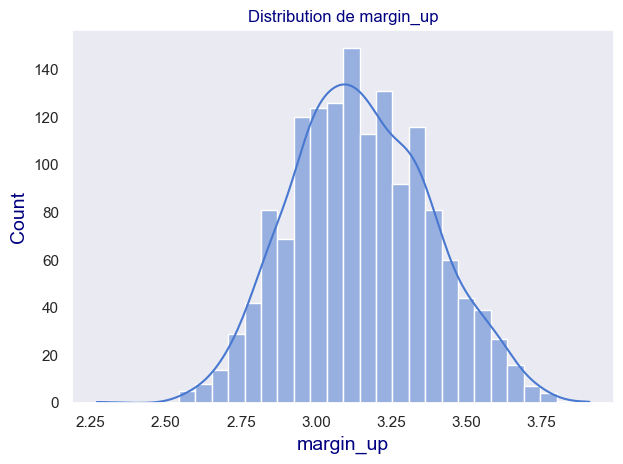

In [100]:
# Histogramme
sns.histplot(data=df_graph, 
             x=var, 
             kde=True #, color='blue'
            )
plt.title(f'Distribution de {var}')
plt.tight_layout()
plt.show()

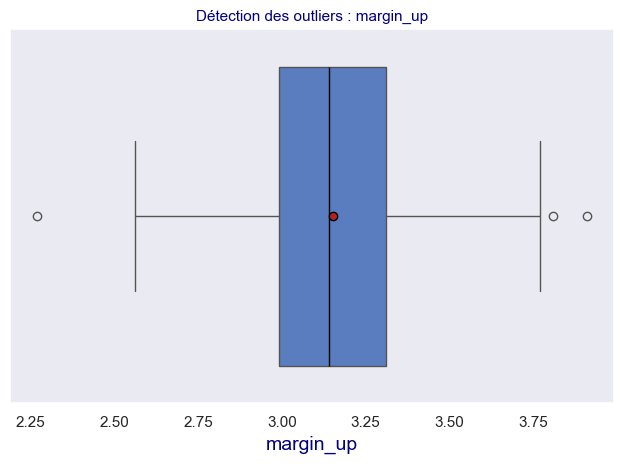

In [101]:
# Boxplot
sns.boxplot(data=df_graph, 
            x=var,
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True #, #c'est ce qui permet de faire apparaitre la moyenne,
            #, color='lightgreen'
           )
plt.title(f'Détection des outliers : {var}', fontsize=11)

plt.tight_layout()
plt.show()

In [102]:
Q1 = (df_graph[var].describe() )['25%']
Q2 = (df_graph[var].describe() )['50%']
Q3 = (df_graph[var].describe() )['75%']
IQ = Q3-Q1
seuil_bas_outlier = Q1-(1.5*IQ)
seuil_haut_outlier = Q3+(1.5*IQ)

print("l'intervalle interquatile IQ vaut : ",round(IQ,2),
      "\nle seuil bas  en deça duquel on est outliers est : ", round(seuil_bas_outlier,2) ,
      "\nle seuil haut au dessus duquel on est outliers est : ", round(seuil_haut_outlier,2)
     )

l'intervalle interquatile IQ vaut :  0.32 
le seuil bas  en deça duquel on est outliers est :  2.51 
le seuil haut au dessus duquel on est outliers est :  3.79


In [103]:
#les outliers :
mask_outlier = (df_graph[var]<seuil_bas_outlier)|(seuil_haut_outlier<df_graph[var])
df_outlier = df_graph.loc[mask_outlier,:]
nb_outlier = len(df_outlier)
prop_outlier = (nb_outlier/len(df_graph))*100

print("Il y a ", nb_outlier , " 'outliers'.",
      "\nCe qui représente ", round(prop_outlier,2) ," % des pays."
     )
print("\nles outliers sont : ")
display(df_outlier[['is_genuine',var]].sort_values(by=var,ascending=False))

Il y a  3  'outliers'. 
Ce qui représente  0.2  % des pays.

les outliers sont : 


,is_genuine,margin_up
1029,False,3.91
1270,False,3.81
664,True,2.27


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2.2.6 - Variable 'length'   : </h4>
</div>

In [104]:
#copie temporaire de df_billets_analyse_1_1
df_graph.head()

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09
2,True,172.69,104.48,103.50,4.40,2.94,113.16
3,True,171.36,103.91,103.94,3.62,3.01,113.51
4,True,171.73,104.28,103.46,4.04,3.48,112.54


In [105]:
var = 'length'

In [106]:
Premieres_Analyses(df_graph[var])


---- SHAPE ----


(1500,)


---- INFO ----
<class 'pandas.core.series.Series'>
RangeIndex: 1500 entries, 0 to 1499
Series name: length
Non-Null Count  Dtype  
--------------  -----  
1500 non-null   float64
dtypes: float64(1)
memory usage: 11.8 KB

---- DESCRIBE ----


count    1500.00000
mean      112.67850
std         0.87273
min       109.49000
25%       112.03000
50%       112.96000
75%       113.34000
max       114.44000
Name: length, dtype: float64


---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
length,float64,1500,1500,0,336,NaN


##### <font color='blue'><u>**REPARTITION**</u></font>

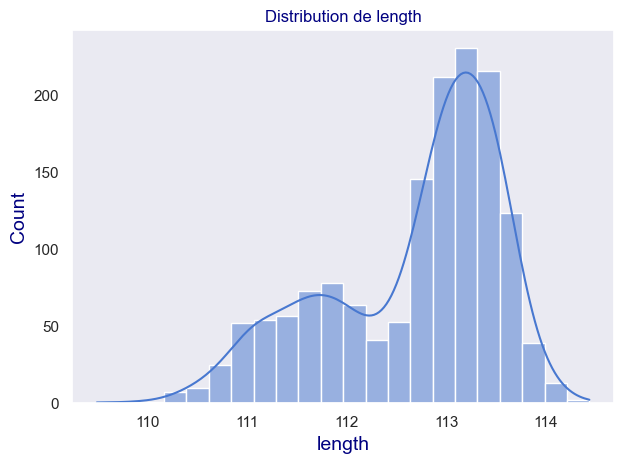

In [107]:
# Histogramme
sns.histplot(data=df_graph, 
             x=var, 
             kde=True #, color='blue'
            )
plt.title(f'Distribution de {var}')
plt.tight_layout()
plt.show()

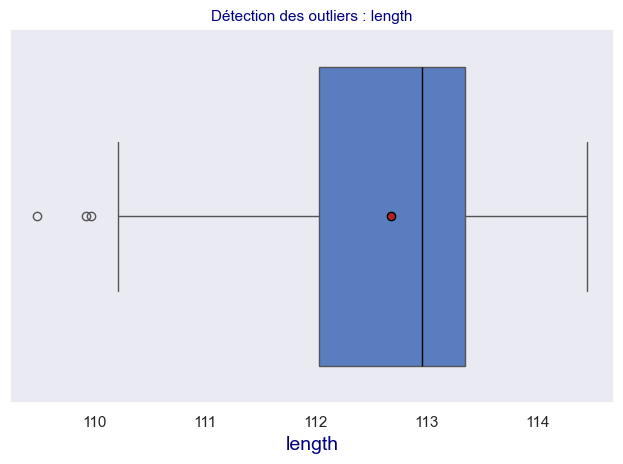

In [108]:
# Boxplot
sns.boxplot(data=df_graph, 
            x=var,
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True #, #c'est ce qui permet de faire apparaitre la moyenne,
            #, color='lightgreen'
           )
plt.title(f'Détection des outliers : {var}', fontsize=11)

plt.tight_layout()
plt.show()

In [109]:
Q1 = (df_graph[var].describe() )['25%']
Q2 = (df_graph[var].describe() )['50%']
Q3 = (df_graph[var].describe() )['75%']
IQ = Q3-Q1
seuil_bas_outlier = Q1-(1.5*IQ)
seuil_haut_outlier = Q3+(1.5*IQ)

print("l'intervalle interquatile IQ vaut : ",round(IQ,2),
      "\nle seuil bas  en deça duquel on est outliers est : ", round(seuil_bas_outlier,2) ,
      "\nle seuil haut au dessus duquel on est outliers est : ", round(seuil_haut_outlier,2)
     )

l'intervalle interquatile IQ vaut :  1.31 
le seuil bas  en deça duquel on est outliers est :  110.06 
le seuil haut au dessus duquel on est outliers est :  115.3


In [110]:
#les outliers :
mask_outlier = (df_graph[var]<seuil_bas_outlier)|(seuil_haut_outlier<df_graph[var])
df_outlier = df_graph.loc[mask_outlier,:]
nb_outlier = len(df_outlier)
prop_outlier = (nb_outlier/len(df_graph))*100

print("Il y a ", nb_outlier , " 'outliers'.",
      "\nCe qui représente ", round(prop_outlier,2) ," % des pays."
     )
print("\nles outliers sont : ")
display(df_outlier[['is_genuine',var]].sort_values(by=var,ascending=False))

Il y a  3  'outliers'. 
Ce qui représente  0.2  % des pays.

les outliers sont : 


,is_genuine,length
1355,False,109.97
1453,False,109.93
1082,False,109.49


<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 3A - Traitement des données manquantes -Regression Linéaire : modèle A</h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3.1 - Conditions préalables à la régression linéaire </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.1.1 - présence de données manquantes : </h4>
</div>

In [111]:
df_billets_analyse_1_1.columns

Index(['is_genuine', 'diagonal', 'height_left', 'height_right', 'margin_low',
       'margin_up', 'length'],
      dtype='object')

In [112]:
df_billets_analyse_1_1.shape

(1500, 7)

In [113]:
df_billets_analyse_1_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500 entries, 0 to 1499
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   is_genuine    1500 non-null   bool   
 1   diagonal      1500 non-null   float64
 2   height_left   1500 non-null   float64
 3   height_right  1500 non-null   float64
 4   margin_low    1463 non-null   float64
 5   margin_up     1500 non-null   float64
 6   length        1500 non-null   float64
dtypes: bool(1), float64(6)
memory usage: 71.9 KB


In [114]:
df_billets_analyse_1_1.isna().sum()

is_genuine       0
diagonal         0
height_left      0
height_right     0
margin_low      37
margin_up        0
length           0
dtype: int64

In [115]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_billets_analyse_1_1)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1463,37,285,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


**OBSERVATION :**  
Sur les 1500 billets nous avons 37 valeurs manquantes, toutes sur la seule variable `margin_low`.   
Tel que demandé par Marie, complétons ces valeurs par régression linéaire.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.1.2 - Quantité suffisante de données connues  : </h4>
</div>

In [116]:
#le nombre de données non nulles pour margin_low
(~df_billets_analyse_1_1.isna()).sum()['margin_low']

1463

In [117]:
#le nombres de lignes complètes :
(df_billets_analyse_1_1.dropna(axis=0,how='any') ).shape[0]

1463

**OBSERVATION :**  
1463 lignes complètes ➜ suffisant pour entraîner un modèle.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.1.3 - Variables numériques continues : </h4>
</div>

In [118]:
df_billets_analyse_1_1.dtypes

is_genuine         bool
diagonal        float64
height_left     float64
height_right    float64
margin_low      float64
margin_up       float64
length          float64
dtype: object

**OBSERVATION :**  
Toutes les variables géométriques sont numériques continues, ce qui convient à une régression linéaire.  
**PRESELECTION-1 DE VARIABLES PREDICTIVES :**  
'diagonal', 'height_left', 'height_right', 'margin_low',  'margin_up', 'length'

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.1.4 - Absence de données aberrantes : </h4>
</div>

##### **Analyse des valeurs extrêmes à partir des ratios IQR :**  

méthode pour détecter les valeurs aberrantes en utilisant des ratios basés sur l’écart interquartile (IQ) :  

Formule :  
IQ = Q3-Q1  
'min-Q1/IQ' = (Q1-min)/IQ  
'Q3-max/IQ' = (max-Q3)/IQ  

Ces rapports permettent de détecter des valeurs potentiellement aberrantes (outliers) selon les **règles de Tukey** .

**Règle de Tukey (règle des 1.5 * IQ)**
Selon cette règle classique :

Un point est considéré comme un outlier modéré s’il est en dehors de l’intervalle :
[Q1-1,5IQR , Q3+1,5IQR]

Autrement dit :
- Si (Q1-min)/IQ  >1.5 ou (max-Q3)/IQ  >1.5 => il peut y avoir des outliers modérés.
- Si le ratio dépasse 3, on considère plutôt des outliers sévères.

In [119]:
df_billets_analyse_1_1.describe()

,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.000000,1500.000000,1500.000000,1463.000000,1500.000000,1500.00000
mean,171.958440,104.029533,103.920307,4.485967,3.151473,112.67850
std,0.305195,0.299462,0.325627,0.663813,0.231813,0.87273
min,171.040000,103.140000,102.820000,2.980000,2.270000,109.49000
25%,171.750000,103.820000,103.710000,4.015000,2.990000,112.03000
50%,171.960000,104.040000,103.920000,4.310000,3.140000,112.96000
75%,172.170000,104.230000,104.150000,4.870000,3.310000,113.34000
max,173.010000,104.880000,104.950000,6.900000,3.910000,114.44000


In [120]:
df_temp= df_billets_analyse_1_1.describe().T
display(df_temp)

,count,mean,std,min,25%,50%,75%,max
diagonal,1500.0,171.958440,0.305195,171.04,171.750,171.96,172.17,173.01
height_left,1500.0,104.029533,0.299462,103.14,103.820,104.04,104.23,104.88
height_right,1500.0,103.920307,0.325627,102.82,103.710,103.92,104.15,104.95
margin_low,1463.0,4.485967,0.663813,2.98,4.015,4.31,4.87,6.90
margin_up,1500.0,3.151473,0.231813,2.27,2.990,3.14,3.31,3.91
length,1500.0,112.678500,0.872730,109.49,112.030,112.96,113.34,114.44


In [121]:
df_temp['IQ']=df_temp['75%']-df_temp['25%']
df_temp['min-Q1/IQ']= (df_temp['25%'] -df_temp['min'])/df_temp['IQ']
df_temp['Q3-max/IQ']= (df_temp['max'] -df_temp['75%'])/df_temp['IQ']
display(df_temp)

,count,mean,std,min,25%,50%,75%,max,IQ,min-Q1/IQ,Q3-max/IQ
diagonal,1500.0,171.958440,0.305195,171.04,171.750,171.96,172.17,173.01,0.420,1.690476,2.000000
height_left,1500.0,104.029533,0.299462,103.14,103.820,104.04,104.23,104.88,0.410,1.658537,1.585366
height_right,1500.0,103.920307,0.325627,102.82,103.710,103.92,104.15,104.95,0.440,2.022727,1.818182
margin_low,1463.0,4.485967,0.663813,2.98,4.015,4.31,4.87,6.90,0.855,1.210526,2.374269
margin_up,1500.0,3.151473,0.231813,2.27,2.990,3.14,3.31,3.91,0.320,2.250000,1.875000
length,1500.0,112.678500,0.872730,109.49,112.030,112.96,113.34,114.44,1.310,1.938931,0.839695


**CONCLUSION :**  
**Les valeurs sont raisonnables :**  
- En terme de métrique :  
Nos ratios sont tous < 2.5 (<3), ce qui indique seulement des outliers modérés.  

- En terme de sens :  
les valeurs max se trouvent à quelques mm du Q3,  
les valeurs min se trouvent à quelques mm du Q1,
Pour un faux billet inexact, ce sont des valeurs qui paraissent tout à fait possibles et non absurde.  

**=> Il n’y a aucune raison immédiate d’exclure ces données.**

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3.2 -  Choix de Scaler(Non Néc) et des variables pour prédire `margin_low`</h3>
</div>

##### **Remarque : Avons-nous besoin de standardiser les données ?** 

**Remarque : Avons-nous besoin de standardiser les données ?**  

La standardisation (centrer-réduire les variables) est surtout importante dans certains contextes, notamment :  
- Régression avec analyse des coefficients (importance relative des coeffs) /RECOMMANDE
- Modèles basés sur la distance (KNN, SVM...)  /NECESSAIRE  
- Réduction de dimension (PCA...)  /NECESSAIRE  
- Variables avec unités très différentes /Souvent nécessaire

Lors d'une régression linéaire pour prédiction uniquement => Standardistation non obligatoire.  

Dans notre cas précis :
- Nous faisons une régression linéaire pour imputer une variable manquante (margin_low) à partir des autres mesures géométriques.  
- Les variables ont des ordres de grandeur proches, de l'ordre de centimètres à millimètres (valeurs entre ~2 et 115).  
- Le modèle n’est pas sensible aux échelles si nous n’interprètons pas directement les coefficients.  
- Les modèles de LinearRegression() de scikit-learn gèrent bien les différences d’échelle modérées.  

**CONCLUSION : => Standardisation NON NECESSAIRE.**

##### **CONCLUSION : => Standardisation NON NECESSAIRE.**

Nous allons prédire margin_low. Il faut donc choisir des variables corrélées avec celle-ci.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.2.1 - Calculer les corrélations : </h4>
</div>

In [122]:
var_quant

['diagonal',
 'height_left',
 'height_right',
 'margin_low',
 'margin_up',
 'length']

In [123]:
df_billets_analyse_1_1[var_quant].corr()

,diagonal,height_left,height_right,margin_low,margin_up,length
diagonal,1.000000,0.019472,-0.024492,-0.111534,-0.055649,0.097587
height_left,0.019472,1.000000,0.242279,0.302643,0.246522,-0.320863
height_right,-0.024492,0.242279,1.000000,0.391085,0.307005,-0.401751
margin_low,-0.111534,0.302643,0.391085,1.000000,0.431606,-0.666753
margin_up,-0.055649,0.246522,0.307005,0.431606,1.000000,-0.520575
length,0.097587,-0.320863,-0.401751,-0.666753,-0.520575,1.000000


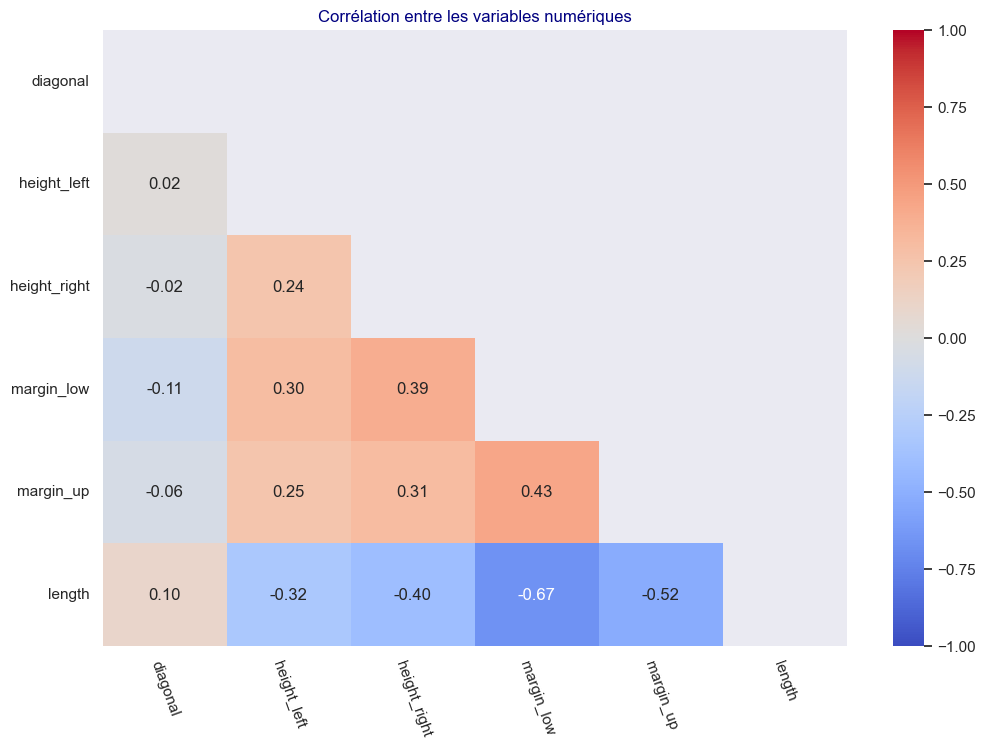

In [124]:
# Visualisation de la Matrice de corrélation

#mask_triangulaire
mask_semi_heatmap = np.triu(np.ones( (df_billets_analyse_1_1[var_quant].corr(method='pearson')).shape  ))

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(12, 8))
sns.heatmap(df_billets_analyse_1_1[var_quant].corr(), 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f",
            mask = mask_semi_heatmap
           )
plt.title("Corrélation entre les variables numériques")
plt.xticks(rotation=-70)
plt.yticks(rotation=0)
plt.grid(visible=False)
plt.show()

In [125]:
df_billets_analyse_1_1[var_quant].corr()['margin_low'].sort_values(ascending=False)

margin_low      1.000000
margin_up       0.431606
height_right    0.391085
height_left     0.302643
diagonal       -0.111534
length         -0.666753
Name: margin_low, dtype: float64

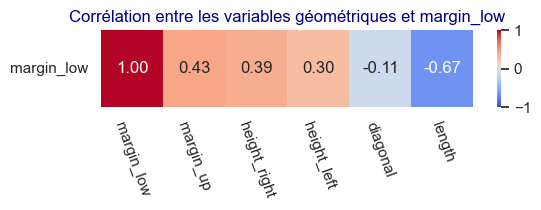

In [126]:
df_graph = pd.DataFrame(df_billets_analyse_1_1[var_quant].corr()['margin_low'].sort_values(ascending=False)).T

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(6, 1))
sns.heatmap(df_graph, 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f"
           )
plt.title("Corrélation entre les variables géométriques et margin_low")
plt.xticks(rotation=-70)
plt.yticks(rotation=0)
plt.grid(visible=False)
plt.show()

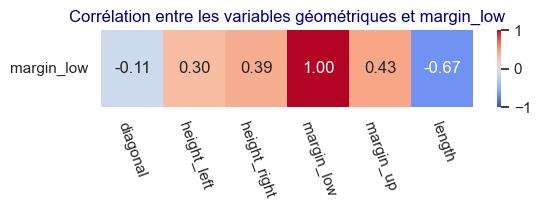

In [127]:
#version sans tri ascendant 
df_graph = pd.DataFrame(df_billets_analyse_1_1[var_quant].corr()['margin_low']).T

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(6, 1))
sns.heatmap(df_graph, 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f"
           )
plt.title("Corrélation entre les variables géométriques et margin_low")
plt.xticks(rotation=-70)
plt.yticks(rotation=0)
plt.grid(visible=False)
plt.show()

##### <u>**CHOIX DES VARIABLES :**</u>  

<u>**CRITERES :**</u>  

- Les variables avec |corr| > 0.3 : sont potentiellement utiles.
- Les variables fortement corrélées entre elles (<-0.8 ou >0.8): à éviter ensemble dans le modèle à cause de colinéarité (on testera ça en étape 5).
- sens des variables non redondants

<u>**ANALYSE :**</u>  

**Les variables avec |corr| > 0.3 : sont potentiellement utiles.**  
- Les candidats sont 'height_left','height_right', 'margin_up', 'length'
- **=> Exclusion de 'diagonal'** (pas assez corrélées à 'margin_low' -0.11)

**Exclusion des variables fortement corrélées entre elles (|corr|>0.8) :**  
- pas de variables avec de fortes corrélations entre elles

**Cohérence du point de vue sens géométrique des billets**  
- redondance possible de 'height_left','height_right'
- height_right est plus corrélée à la cible que height_left qui est limite (+0.39 vs +0.30)
- il n'y a pas de forte redondance entre height_right et les autres variables,
- il n'y a pas de forte redondance entre height_left et les autres variables,

*Conservons height_right :*  
- Il est plus corrélé à la cible que height_left.
- Il n’est pas redondant avec d’autres variables retenues (length, margin_up).

*Ecartons provisoirement height_left :*
- Pour éviter de trop complexifier le modèle initial.
- Sa corrélation avec la cible est limite (0.30).
-  souvent pertinent dans une première modélisation d’éviter d’avoir deux variables très similaires sémantiquement (height_left et height_right) sauf si on suspecte une asymétrie importante sur les billets.  
**=>Exclusion de 'height_left'**


##### <u>**CONCLUSION :**</u>  
**=> Conservons 'height_right', 'margin_up', 'length'**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.2.2 - Visualisation des corrélations : </h4>
</div>

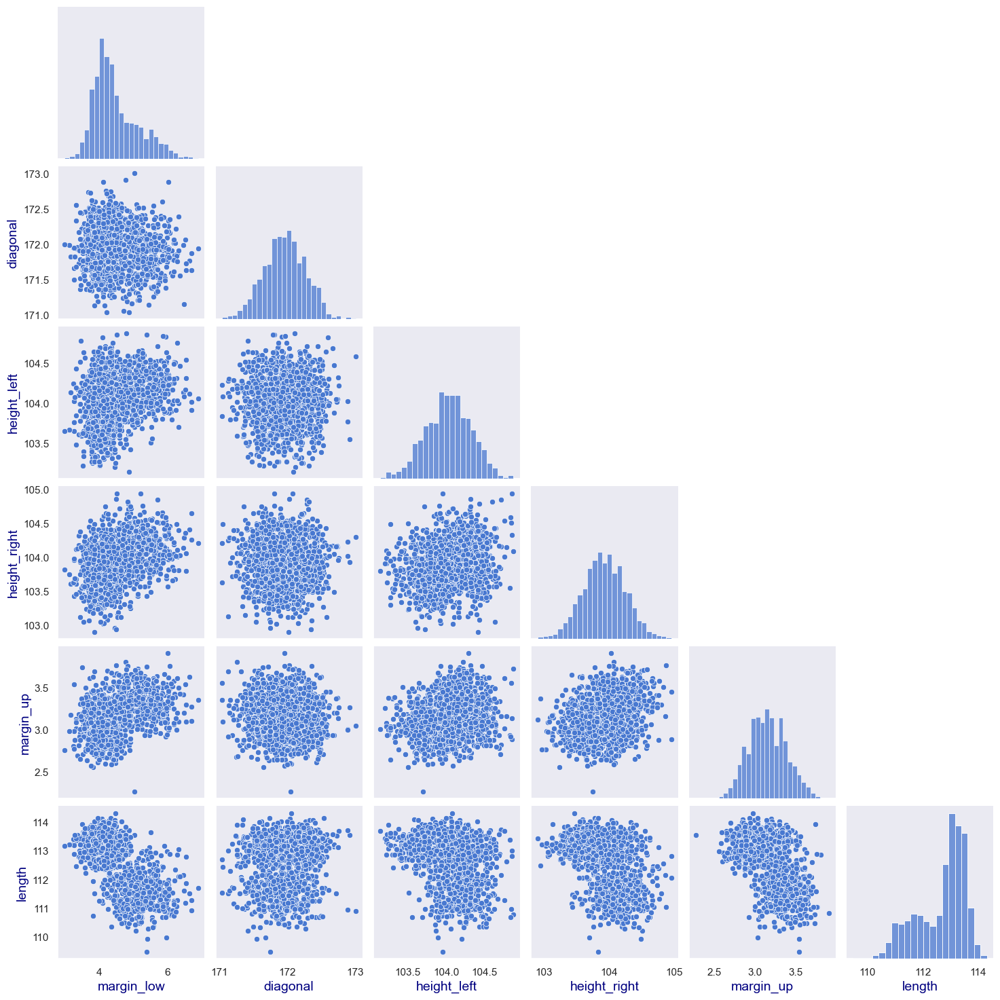

In [128]:
sns.pairplot(df_billets_analyse_1_1.dropna(), vars=['margin_low', 'diagonal', 'height_left', 'height_right', 'margin_up', 'length'],corner=True)


##### TEST GRAPH REGPLOT :

In [129]:
var_quant

['diagonal',
 'height_left',
 'height_right',
 'margin_low',
 'margin_up',
 'length']

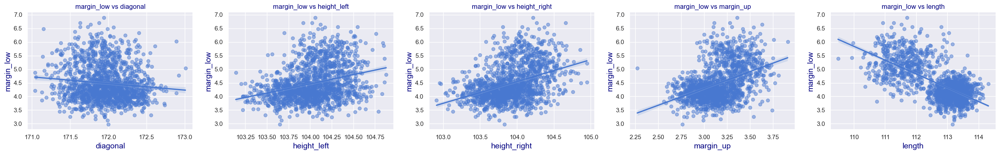

In [130]:
import seaborn as sns
import matplotlib.pyplot as plt

# Variables à tester comme prédicteurs
variables = ['diagonal',
             'height_left',
             'height_right',
             'margin_up',
             'length']  

# Dimensions du graph
fig, axes = plt.subplots(1, len(variables), figsize=(5 * len(variables), 4))

# Pour éviter les valeurs manquantes (important pour margin_low)
df_temp = df_billets_analyse_1_1.dropna(subset=['margin_low'])

# Création des regplots
for i, var in enumerate(variables):
    sns.regplot(x=var, y='margin_low', data=df_temp, ax=axes[i], scatter_kws={'alpha':0.5})
    axes[i].set_title(f"margin_low vs {var}")
    axes[i].set_xlabel(var)
    axes[i].set_ylabel("margin_low")
    axes[i].grid(True)

plt.tight_layout()
plt.show()

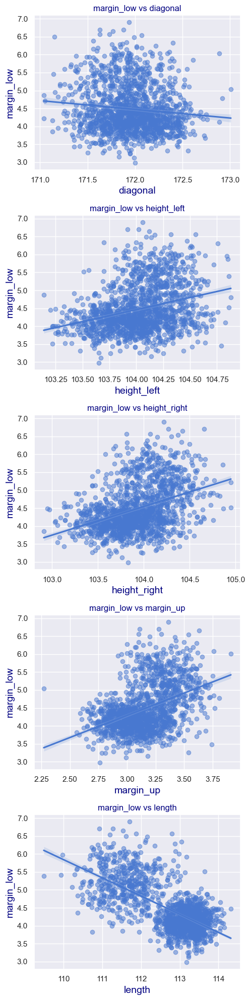

In [131]:
#import seaborn as sns
#import matplotlib.pyplot as plt

# Variables à tester comme prédicteurs
variables = ['diagonal',
             'height_left',
             'height_right',
             'margin_up',
             'length']  

# Dimensions du graph
fig, axes = plt.subplots(len(variables),1, figsize=(5, 4*len(variables)))

# Pour éviter les valeurs manquantes (important pour margin_low)
df_temp = df_billets_analyse_1_1.dropna(subset=['margin_low'])

# Création des regplots
for i, var in enumerate(variables):
    sns.regplot(x=var, y='margin_low', data=df_temp, ax=axes[i], scatter_kws={'alpha':0.5})
    axes[i].set_title(f"margin_low vs {var}")
    axes[i].set_xlabel(var)
    axes[i].set_ylabel("margin_low")
    axes[i].grid(True)

plt.tight_layout()
plt.show()

##### FIN TEST GRAPH REGPLOT :

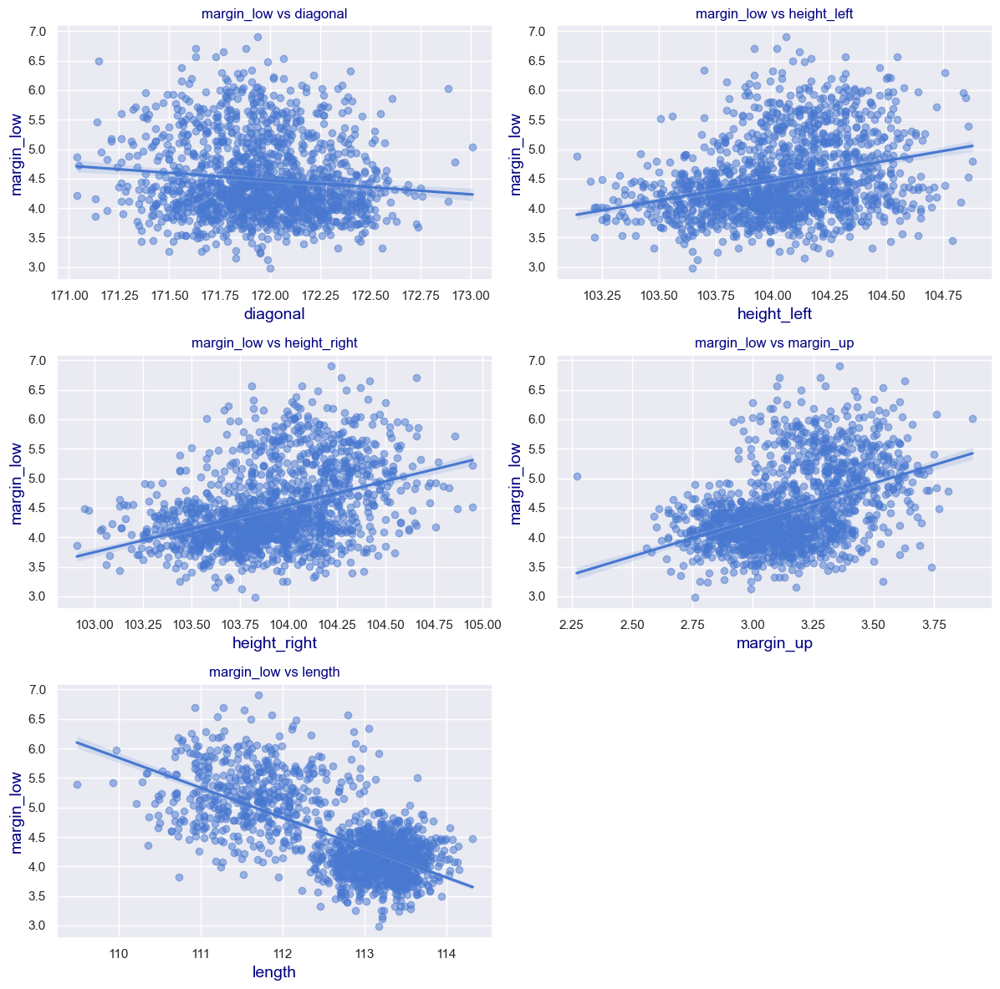

In [132]:
import seaborn as sns
import matplotlib.pyplot as plt

# Variables à tester comme prédicteurs
variables = ['diagonal',
             'height_left',
             'height_right',
             'margin_up',
             'length']  

n_vars = len(variables)
n_cols = 2
n_rows = (n_vars + 1) // n_cols  # arrondi supérieur

# Création de la grille
fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, 4 * n_rows))

# Aplatir la grille d'axes pour itérer facilement
axes = axes.flatten()

# Nettoyage des données
df_temp = df_billets_analyse_1_1.dropna(subset=['margin_low'])

# Création des regplots
for i, var in enumerate(variables):
    sns.regplot(x=var, y='margin_low', data=df_temp, ax=axes[i], scatter_kws={'alpha': 0.5})
    axes[i].set_title(f"margin_low vs {var}")
    axes[i].set_xlabel(var)
    axes[i].set_ylabel("margin_low")
    axes[i].grid(True)

# Si case vide à la fin (dans ce cas précis, 5 graphiques pour 6 cases)
for j in range(len(variables), len(axes)):
    fig.delaxes(axes[j])  # supprimer les axes vides

plt.tight_layout()
plt.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.2.3 - Bilan du Choix de Variable : </h4>
</div>

##### <u>**BILAN :**</u>  
**=> Conservons dans notre premier modèle A :'height_right', 'margin_up', 'length'**

In [133]:
var_pred_A = ['length', 'margin_up', 'height_right'] #dans l'ordre de corrélation

Nous verrons s'il est utile de tester un second modèle B : 'length', 'margin_up', 'height_right', 'height_left'

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3.3 - Effectuons la régression linéaire </h3>
</div>

In [134]:
df_billets_analyse_1_1.head(2)

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09


In [135]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_billets_analyse_1_1)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1463,37,285,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


In [136]:
#les variables quantitatives
var_quant

['diagonal',
 'height_left',
 'height_right',
 'margin_low',
 'margin_up',
 'length']

In [137]:
#variable cible :
var_cible = 'margin_low'

In [138]:
#Choix des variables prédictives
var_pred_A

['length', 'margin_up', 'height_right']

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.3.1 - Préparation des données : </h4>
</div>

**Séparer les données connues et manquantes**

In [139]:
df_known = df_billets_analyse_1_1[df_billets_analyse_1_1['margin_low'].notna()]
df_missing = df_billets_analyse_1_1[df_billets_analyse_1_1['margin_low'].isna()]

In [140]:
df_known.shape

(1463, 7)

In [141]:
df_missing.shape

(37, 7)

**Définir X et y avec nos variables predictives et cible :**

In [142]:
# Variables predictives et cible
X_A = df_known[var_pred_A]
y_A = df_known ['margin_low']  

In [143]:
X_A.shape

(1463, 3)

In [144]:
y_A.shape

(1463,)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.3.2 - Entraînement du modèle : </h4>
</div>

In [145]:
from sklearn.linear_model import LinearRegression

In [146]:
reg_A = LinearRegression()
reg_A.fit(X_A, y_A)

,fit_intercept,True
,copy_X,True
,tol,1e-06
,n_jobs,None
,positive,False


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.3.3 - Affichage des coefficients : </h4>
</div>

In [147]:
# Affichage sous forme lisible
for var, coef in zip(var_pred_A, reg_A.coef_):
    print(f"Coef. {var} : {round(coef, 4)}")

print(f"Intercept : {round(reg_A.intercept_, 4)}")

Coef. length : -0.4269
Coef. margin_up : 0.2805
Coef. height_right : 0.2745
Intercept : 23.1826


In [148]:
# Affichage sous forme lisible
print("y = ")
for var, coef in zip(var_pred_A, reg_A.coef_):
    print(f" {round(coef, 2)} * {var} +")

print(f"{round(reg_A.intercept_, 2)}")

y = 
 -0.43 * length +
 0.28 * margin_up +
 0.27 * height_right +
23.18


**OBSERVATION :**  
Les signes sont cohérents avec les corrélations :  
- length était négativement corrélée → coefficient négatif  
- margin_up et height_right étaient positivement corrélées → coefficients positifs

**INTERPRETATION :**  
Coef. length : -0.4269  À chaque mm supplémentaire de longueur, la marge basse diminue en moyenne de 0.4269 mm, toutes choses égales par ailleurs.  


Coef. margin_up : 0.2805  
Une augmentation de 1 mm de la marge haute entraîne en moyenne une augmentation de 0.2805 mm de la marge basse.  

Coef. height_right : 0.2457  
Chaque mm supplémentaire sur la hauteur droite augmente la marge basse d’environ 0.2745 mm.  5
Intercept : 23826.1  
Valeur estimée de margin_low quand toutes les variables explicatives sont nulles (ce qui n’a pas forcément de sens physique, mais sert de base mathématique). 26

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.3.4 - Calcul du R² (qualité du modèle) : </h4>
</div>

In [149]:
r2_A = reg_A.score(X_A, y_A)
print(f"R²  : {round(r2_A, 4)}")

R²  : 0.4691


<u>Qu’est-ce que le R² (coefficient de détermination) </u>    
R² = proportion de la variance expliquée par le modèle.  
Il varie entre 0 (aucune explication) et 1 (modèle parfait).
Un R² de 0.85, par exemple, signifie que 85 % de la variabilité de margin_low est expliquée par les variables choisies.

Un R² > 0.7 est souvent considéré comme bon, mais cela dépend du domaine.

**OBSERVATION :**  
R²  : 0.4691  
Le modèle explique environ 47% de la variance de margin_low. C’est modéré, mais assez courant pour des données physiques.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.3.5 -Prédictions et résidus : </h4>
</div>

In [150]:
# Prédictions
y_pred_A = reg_A.predict(X_A)

# Calcul des résidus
residus_A = y_A - y_pred_A

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.3.5 -Prédictions et résidus sur les valeurs connues : </h4>
</div>

In [151]:
df_resultats_A = pd.DataFrame({
    'y_obs': y_A,
    'y_pred': y_pred_A,
    'residu': residus_A
})
df_resultats_A.head()

,y_obs,y_pred,residu
0,4.52,4.628183,-0.108183
1,3.77,4.191185,-0.421185
2,4.40,4.103363,0.296637
3,3.62,4.094337,-0.474337
4,4.04,4.508541,-0.468541


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.3.6 - méthode de scoring : </h4>
</div>

In [152]:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import root_mean_squared_error
from sklearn.metrics import mean_absolute_percentage_error

In [153]:
print(f"MSE: {mean_squared_error(y_A, y_pred_A)}")
print(f"RMSE: {root_mean_squared_error(y_A, y_pred_A)}")
print(f"MAPE: {mean_absolute_percentage_error(y_A, y_pred_A)}")

MSE: 0.2337893407777293
RMSE: 0.48351767369738335
MAPE: 0.08304113648648997


Pour ces 3 métriques, un score plus petit correspond à un meilleur modèle.  
Cependant MSE, et RMSE ne sont pas contraints en valeur donc meilleur pour une coparaison de modèle qu'une interprétation sur un seul modèle.  

**MAPE est compris entre 0 et 1.  
ICI une valeur de MAPE de 0.08 proche de 0 indique un bon score de performance.**

**OBSERVATION :**  
MSE: 0.2337893407777293  
Moyenne des carrés des écarts entre valeurs observées et prédites. Plus il est bas, mieux c’est.  

RMSE: 0.4835176736973833  
Erreur absolue moyenne exprimée dans l’unité de la variable cible. Ici, une erreur typique de prédiction est d’environ 0.48 mm, ce qui est relativement faible (à juger selon le contexte métier). Ici ca fait environ 10% d'une valeur moyenne de marge aux alentours de 4mm, c'est non négligeable mais raisonnable.  
5
MAPE: 0.083041136486489  
L’erreur relative moyenne est de 8.3 %, ce qui est très raisonnable dans de nombreux contextes industriels.  97

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.3.6 - Prédire les valeurs manquantes : </h4>
</div>

In [154]:
# Variables predictives pour les valeurs manquantes
X_missing_A = df_missing[var_pred_A]
y_missing_pred_A = reg_A.predict(X_missing_A)

#si on choisit de remplir df_billets_analyse_1_1 avec les valeurs calculées
#df_billets_analyse_1_1.loc[df_missing.index, 'margin_low'] = reg.predict(X_missing_A)
#ou idem :
##df_billets_analyse_1_1.loc[df_missing.index, 'margin_low'] = y_missing_pred_A

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3.4 - Vérification des hypothèses </h3>
</div>

Nous allons vérifier 3 hypothèses fondamentales poru pouvoir appliquer la régression linéaire :  
- Colinéarité entre les variables explicatives
- Normalité des résidus :
- Homoscédasticité des résidus


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.4.1 - Colinéarité entre les variables explicatives : </h4>
</div>

But : Vérifier qu’il n’y a pas de forte redondance entre les variables prédictives.

**Théorie : VIF (Variance Inflation Factor)**  
Le VIF (ou Facteur d’Inflation de la Variance) est un indicateur utilisé pour détecter la colinéarité entre variables explicatives dans une régression linéaire multiple.  

Pourquoi c’est important :  
- Si deux variables prédictives sont fortement corrélées entre elles (colinéarité), cela :  
rend les coefficients instables (petit changement dans les données → gros changement dans les coefficients),    
- complique l’interprétation individuelle des effets,    
- nuit à la fiabilité du modèle.  

Formule du VIF :    
Pour une variable X𝑖, on fait une régression de 𝑋𝑖, sur toutes les autres variables 𝑋𝑗, puis :    
VIF(𝑋𝑖)=1/(1-𝑅𝑖^2)    
où 𝑅𝑖^2 est le R² obtenu en régressant 𝑋𝑖 sur les autres 𝑋𝑗  

Interprétation des valeurs :  
VIF	Interprétation  
. ≈ 1	Aucune colinéarité  
. 1 – 5	Faible colinéarité (acceptable)  
. > 5	Colinéarité modérée à forte  
. > 10	Très forte colinéarité à éviter  

In [155]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
import statsmodels.api as sm

# Création de la matrice X avec constante
X_const_A = sm.add_constant(X_A)

# Calcul du VIF
vif_A = pd.DataFrame()
vif_A["variables"] = X_A.columns
vif_A["VIF"] = [variance_inflation_factor(X_const_A.values, i + 1) for i in range(len(X_A.columns))]

print(vif_A)

      variables       VIF
0        length  1.509435
1     margin_up  1.394010
2  height_right  1.213794


**OBSERVATIONS :**  
Pour toutes les variables la colinéarité avec les autres variables est faible.  
**=>pas de forte redondance entre les variables prédictives : OK**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.4.2 - Normalité des résidus : </h4>
</div>

But : Vérifier que les erreurs suivent une loi normale (hypothèse importante pour les intervalles de confiance et tests statistiques).  

In [156]:
import scipy.stats as stats

Conditions pour effectuer le Test de Schapiro : (effectifs <2000 voire 5000 ok)

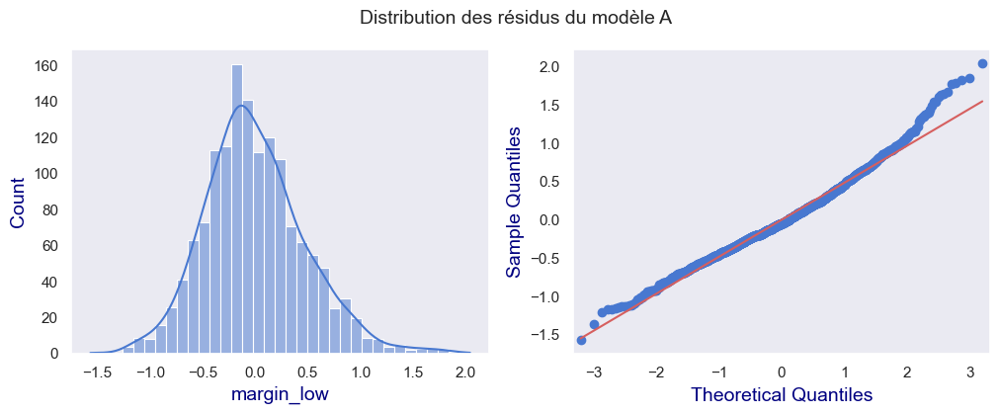

Statistique Shapiro : 0.9843 | p-value : 0.0


In [157]:
#Histogramme + courbe KDE +QQPLot

fig, (a,b) = plt.subplots(nrows=1, ncols=2, figsize=(12, 4))
plt.suptitle("Distribution des résidus du modèle A")

sns.histplot(x=residus_A, kde=True, ax=a)
qqplot(residus_A, line='s', ax=b)

plt.show()

# Test de Shapiro-Wilk
stat, pvalue = stats.shapiro(residus_A)
print(f"Statistique Shapiro : {round(stat, 4)} | p-value : {round(pvalue, 4)}")

Interprétation :  
p-value > 0.05 → H₀ non rejetée → les résidus sont compatibles avec une distribution normale.
p-value < 0.05 → H₀ rejetée → les résidus ne suivent pas une distribution normale.

Le test est sensible à la taille de l’échantillon : avec un grand n, une légère déviation de la normalité peut déjà donner une p-value faible. D’où l’intérêt aussi du graphique KDE.

**OBSERVATION :**  
visuellement la distribution pourrait suivre une loie Normale,  
mais statistiquement ce n'est pas le cas avec p-value <<0.05 .  
**=>les résidus ne suivent pas une loi normale**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.4.3 - Homoscédasticité des résidus
 </h4>
</div>

But : Vérifier que la variance des erreurs reste constante quelle que soit la valeur prédite.

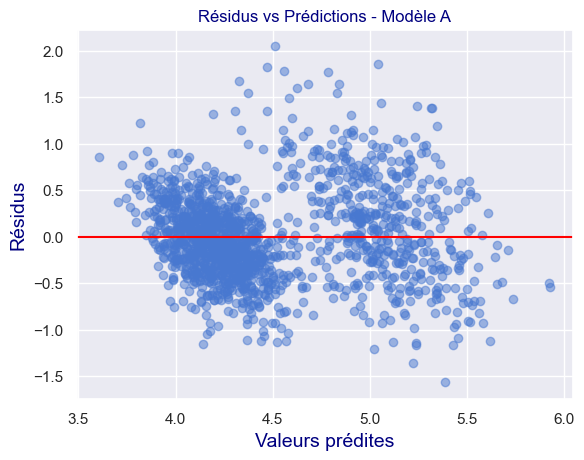

In [158]:
plt.scatter(y_pred_A, residus_A, alpha=0.5)
plt.axhline(0, color='red')
plt.xlabel("Valeurs prédites")
plt.ylabel("Résidus")
plt.title("Résidus vs Prédictions - Modèle A")
plt.grid(True)
plt.show()

**Interprétation :**  
Si les résidus sont répartis de manière homogène autour de 0   
Si on observe un entonnoir (variance croissante/décroissante) ou un motif → il y a hétéroscédasticité, ce qui peut biaiser les intervalles de confiance et tests.  

Ici on a une répartition de part et d'autre cela semblerait ok.  
Cependant on a tout de m^mee de forme détachée avec une pente.

**OBSERVATION :**  
Les Résidus sont plutôt répartis de manière homogène autour de zéro.  
**=> Homoscédasticité des résidus**

<u>**MESURE DE L'HOMOSCEDASTICITE DES RESIDUS :**</u>  
Tester si : Les résidus du modèle ont une variance constante quelle que soit la valeur des prédicteurs.  
H₀ (hypothèse nulle) : Homoscédasticité (variance constante des résidus)  
H₁ (hypothèse alternative) : Hétéroscédasticité (variance non constante)  

1. Test de Breusch-Pagan (le plus courant)  
2. Test de White (plus général, robuste)

Conditions d'application :
1. Modèle linéaire correctement spécifié =>OK  
2. Résidus du modèle bien calculés =>OK  
3. Pas trop de multicolinéarité entre les variables explicatives =>OK  
4. Données numériques et sans valeurs manquantes =>OK  
5. Nombre d’observations suffisant (>30) =>OK  

Remarque :  la normalité des résidus n’est pas une condition préalable
Le test de Breusch-Pagan ne suppose pas que les résidus soient normalement distribués.
Ce n’est pas une condition obligatoire, mais si les résidus sont fortement asymétriques ou présentent des outliers extrêmes, cela peut affecter les performances du test.  
(ce n'est pas le cas ici)

**1. Test de Breusch-Pagan (le plus courant)**

In [159]:
#Test de Breusch-Pagan (le plus courant)
from statsmodels.stats.diagnostic import het_breuschpagan
#import statsmodels.api as sm

# Ajout de la constante à X
X_const_A = sm.add_constant(X_A)

# Calcul des résidus
#residus_A = y_A - reg_A.predict(X_A)=>déjà fait

# Test de Breusch-Pagan
bp_test = het_breuschpagan(residus_A, X_const_A)

# Résultat du test
bp_labels = ['Statistique', 'p-value', 'f-stat', 'f p-value']
for name, value in zip(bp_labels, bp_test):
    print(f"{name} : {value:.4f}")

Statistique : 73.9698
p-value : 0.0000
f-stat : 25.8986
f p-value : 0.0000


**Interprétation :**  
- Si la p-value < 0.05, on rejette l’hypothèse H₀ : les résidus ne sont pas homoscédastiques (donc problème d’hétéroscédasticité).  
- Si la p-value > 0.05, on ne rejette pas H₀ : les résidus peuvent être considérés comme homoscédastiques (ce qu’on veut).

**OBSERVATION :**  
p-value proche de 0 
Rejet de H₀ → Présence d’hétéroscédasticité dans le modèle.  
Autrement dit, les résidus n'ont pas une variance constante, ce qui viole une des hypothèses fondamentales de la régression linéaire.  
**homoscédastiques KO : la variance des erreurs n'est pas constante ici**

**2. Test de White (plus général, robuste)**

In [160]:
#MESURE DE L'HOMOSCEDASTICITE DES RESIDUS : Test de White (plus général, robuste)
from statsmodels.stats.diagnostic import het_white

# Ajout de la constante à X
X_const_A = sm.add_constant(X_A)

white_test = het_white(residus_A, X_const_A)

labels_white = ['Statistique LM', 'p-value', 'Stat F', 'p-value F']
for name, val in zip(labels_white, white_test):
    print(f"{name} : {val}")

Statistique LM : 89.03986422053327
p-value : 2.5365117364343136e-15
Stat F : 10.462451593864943
p-value F : 8.308290698606462e-16


**Interprétation :**  
Statistique LM : Statistique de Lagrange multiplier  
p-value (associée à LM) : si elle est < 0.05, on rejette H₀  
Statistique F : test F auxiliaire  
p-value F : interprétation identique
  
- Si la p-value < 0.05, on rejette l’hypothèse H₀ : les résidus ne sont pas homoscédastiques (donc problème d’hétéroscédasticité).  
- Si la p-value > 0.05, on ne rejette pas H₀ : les résidus peuvent être considérés comme homoscédastiques (ce qu’on veut).

**OBSERVATION :**  
p-value proche de 0 
Rejet de H₀ → Présence d’hétéroscédasticité dans le modèle.  
Autrement dit, les résidus n'ont pas une variance constante, ce qui viole une des hypothèses fondamentales de la régression linéaire.  
**homoscédastiques KO : la variance des erreurs n'est pas constante ici**

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 3B - Traitement des données manquantes -Regression Linéaire : modèle B</h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3B.1 - Conditions préalables à la régression linéaire </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.1.1 - présence de données manquantes : </h4>
</div>

In [161]:
df_billets_analyse_1_1.columns

Index(['is_genuine', 'diagonal', 'height_left', 'height_right', 'margin_low',
       'margin_up', 'length'],
      dtype='object')

In [162]:
df_billets_analyse_1_1.shape

(1500, 7)

In [163]:
df_billets_analyse_1_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500 entries, 0 to 1499
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   is_genuine    1500 non-null   bool   
 1   diagonal      1500 non-null   float64
 2   height_left   1500 non-null   float64
 3   height_right  1500 non-null   float64
 4   margin_low    1463 non-null   float64
 5   margin_up     1500 non-null   float64
 6   length        1500 non-null   float64
dtypes: bool(1), float64(6)
memory usage: 71.9 KB


In [164]:
df_billets_analyse_1_1.isna().sum()

is_genuine       0
diagonal         0
height_left      0
height_right     0
margin_low      37
margin_up        0
length           0
dtype: int64

In [165]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_billets_analyse_1_1)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1463,37,285,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


**OBSERVATION :**  
Sur les 1500 billets nous avons 37 valeurs manquantes, toutes sur la seule variable `margin_low`.   
Tel que demandé par Marie, complétons ces valeurs par régression linéaire.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.1.2 - Quantité suffisante de données connues  : </h4>
</div>

In [166]:
#le nombre de données non nulles pour margin_low
(~df_billets_analyse_1_1.isna()).sum()['margin_low']

1463

In [167]:
#le nombres de lignes complètes :
(df_billets_analyse_1_1.dropna(axis=0,how='any') ).shape[0]

1463

**OBSERVATION :**  
1463 lignes complètes ➜ suffisant pour entraîner un modèle.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.1.3 - Variables numériques continues : </h4>
</div>

In [168]:
df_billets_analyse_1_1.dtypes

is_genuine         bool
diagonal        float64
height_left     float64
height_right    float64
margin_low      float64
margin_up       float64
length          float64
dtype: object

**OBSERVATION :**  
Toutes les variables géométriques sont numériques continues, ce qui convient à une régression linéaire.  
**PRESELECTION-1 DE VARIABLES PREDICTIVES :**  
'diagonal', 'height_left', 'height_right', 'margin_low',  'margin_up', 'length'

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.1.4 - Absence de données aberrantes : </h4>
</div>

##### **Analyse des valeurs extrêmes à partir des ratios IQR :**  

méthode pour détecter les valeurs aberrantes en utilisant des ratios basés sur l’écart interquartile (IQ) :  

Formule :  
IQ = Q3-Q1  
'min-Q1/IQ' = (Q1-min)/IQ  
'Q3-max/IQ' = (max-Q3)/IQ  

Ces rapports permettent de détecter des valeurs potentiellement aberrantes (outliers) selon les **règles de Tukey** .

**Règle de Tukey (règle des 1.5 * IQ)**
Selon cette règle classique :

Un point est considéré comme un outlier modéré s’il est en dehors de l’intervalle :
[Q1-1,5IQR , Q3+1,5IQR]

Autrement dit :
- Si (Q1-min)/IQ  >1.5 ou (max-Q3)/IQ  >1.5 => il peut y avoir des outliers modérés.
- Si le ratio dépasse 3, on considère plutôt des outliers sévères.

In [169]:
df_billets_analyse_1_1.describe()

,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.000000,1500.000000,1500.000000,1463.000000,1500.000000,1500.00000
mean,171.958440,104.029533,103.920307,4.485967,3.151473,112.67850
std,0.305195,0.299462,0.325627,0.663813,0.231813,0.87273
min,171.040000,103.140000,102.820000,2.980000,2.270000,109.49000
25%,171.750000,103.820000,103.710000,4.015000,2.990000,112.03000
50%,171.960000,104.040000,103.920000,4.310000,3.140000,112.96000
75%,172.170000,104.230000,104.150000,4.870000,3.310000,113.34000
max,173.010000,104.880000,104.950000,6.900000,3.910000,114.44000


In [170]:
df_temp= df_billets_analyse_1_1.describe().T
display(df_temp)

,count,mean,std,min,25%,50%,75%,max
diagonal,1500.0,171.958440,0.305195,171.04,171.750,171.96,172.17,173.01
height_left,1500.0,104.029533,0.299462,103.14,103.820,104.04,104.23,104.88
height_right,1500.0,103.920307,0.325627,102.82,103.710,103.92,104.15,104.95
margin_low,1463.0,4.485967,0.663813,2.98,4.015,4.31,4.87,6.90
margin_up,1500.0,3.151473,0.231813,2.27,2.990,3.14,3.31,3.91
length,1500.0,112.678500,0.872730,109.49,112.030,112.96,113.34,114.44


In [171]:
df_temp['IQ']=df_temp['75%']-df_temp['25%']
df_temp['min-Q1/IQ']= (df_temp['25%'] -df_temp['min'])/df_temp['IQ']
df_temp['Q3-max/IQ']= (df_temp['max'] -df_temp['75%'])/df_temp['IQ']
display(df_temp)

,count,mean,std,min,25%,50%,75%,max,IQ,min-Q1/IQ,Q3-max/IQ
diagonal,1500.0,171.958440,0.305195,171.04,171.750,171.96,172.17,173.01,0.420,1.690476,2.000000
height_left,1500.0,104.029533,0.299462,103.14,103.820,104.04,104.23,104.88,0.410,1.658537,1.585366
height_right,1500.0,103.920307,0.325627,102.82,103.710,103.92,104.15,104.95,0.440,2.022727,1.818182
margin_low,1463.0,4.485967,0.663813,2.98,4.015,4.31,4.87,6.90,0.855,1.210526,2.374269
margin_up,1500.0,3.151473,0.231813,2.27,2.990,3.14,3.31,3.91,0.320,2.250000,1.875000
length,1500.0,112.678500,0.872730,109.49,112.030,112.96,113.34,114.44,1.310,1.938931,0.839695


**CONCLUSION :**  
**Les valeurs sont raisonnables :**
- Nos ratios sont tous < 2.5 (<3), ce qui indique seulement des outliers modérés.  
**=> Il n’y a aucune raison immédiate d’exclure ces données.**

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3B.2 -  Choix de Scaler(Non Néc) et des variables pour prédire `margin_low`</h3>
</div>

##### **Remarque : Avons-nous besoin de standardiser les données ?** 

**Remarque : Avons-nous besoin de standardiser les données ?**  

La standardisation (centrer-réduire les variables) est surtout importante dans certains contextes, notamment :  
- Régression avec analyse des coefficients (importance relative des coeffs) /RECOMMANDE
- Modèles basés sur la distance (KNN, SVM...)  /NECESSAIRE  
- Réduction de dimension (PCA...)  /NECESSAIRE  
- Variables avec unités très différentes /Souvent nécessaire

Lors d'une régression linéaire pour prédiction uniquement => Standardistation non obligatoire.  

Dans notre cas précis :
- Nous faisons une régression linéaire pour imputer une variable manquante (margin_low) à partir des autres mesures géométriques.  
- Les variables ont des ordres de grandeur proches, de l'ordre de centimètres à millimètres (valeurs entre ~2 et 115).  
- Le modèle n’est pas sensible aux échelles si nous n’interprètons pas directement les coefficients.  
- Les modèles de LinearRegression() de scikit-learn gèrent bien les différences d’échelle modérées.  

**CONCLUSION : => Standardisation NON NECESSAIRE.**

##### **CONCLUSION : => Standardisation NON NECESSAIRE.**

Nous allons prédire margin_low. Il faut donc choisir des variables corrélées avec celle-ci.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.2.1 - Calculer les corrélations : </h4>
</div>

In [172]:
var_quant

['diagonal',
 'height_left',
 'height_right',
 'margin_low',
 'margin_up',
 'length']

In [173]:
df_billets_analyse_1_1[var_quant].corr()

,diagonal,height_left,height_right,margin_low,margin_up,length
diagonal,1.000000,0.019472,-0.024492,-0.111534,-0.055649,0.097587
height_left,0.019472,1.000000,0.242279,0.302643,0.246522,-0.320863
height_right,-0.024492,0.242279,1.000000,0.391085,0.307005,-0.401751
margin_low,-0.111534,0.302643,0.391085,1.000000,0.431606,-0.666753
margin_up,-0.055649,0.246522,0.307005,0.431606,1.000000,-0.520575
length,0.097587,-0.320863,-0.401751,-0.666753,-0.520575,1.000000


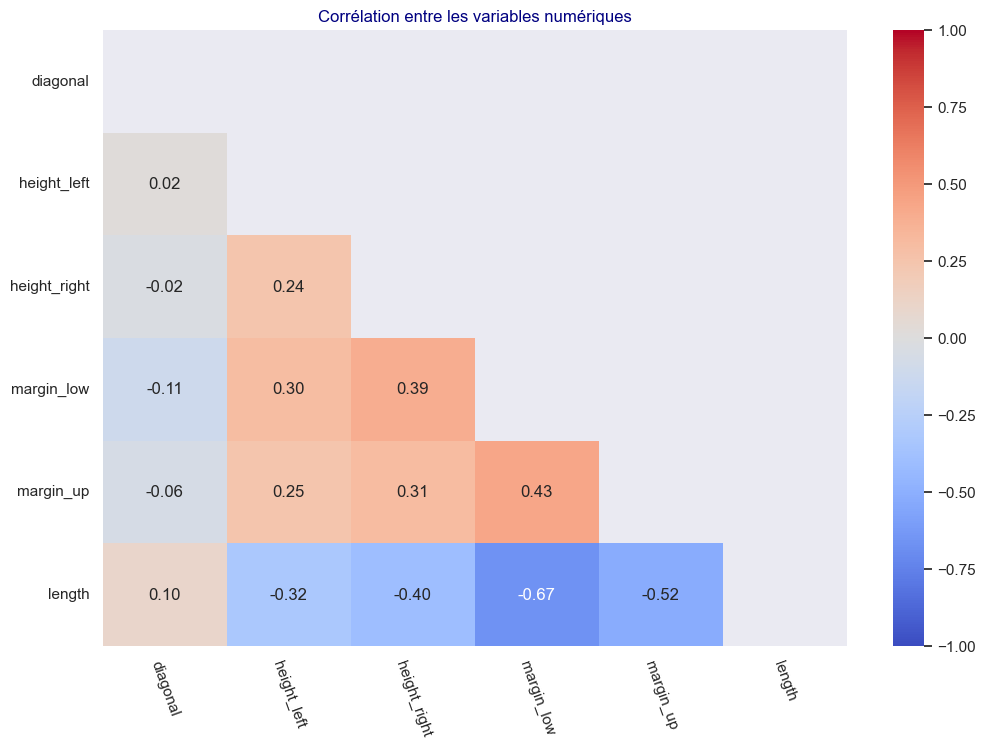

In [174]:
# Visualisation de la Matrice de corrélation

#mask_triangulaire
mask_semi_heatmap = np.triu(np.ones( (df_billets_analyse_1_1[var_quant].corr(method='pearson')).shape  ))

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(12, 8))
sns.heatmap(df_billets_analyse_1_1[var_quant].corr(), 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f",
            mask = mask_semi_heatmap
           )
plt.title("Corrélation entre les variables numériques")
plt.xticks(rotation=-70)
plt.yticks(rotation=0)
plt.grid(visible=False)
plt.show()

In [175]:
df_billets_analyse_1_1[var_quant].corr()['margin_low'].sort_values(ascending=False)

margin_low      1.000000
margin_up       0.431606
height_right    0.391085
height_left     0.302643
diagonal       -0.111534
length         -0.666753
Name: margin_low, dtype: float64

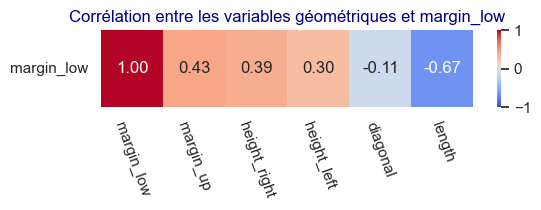

In [176]:
df_graph = pd.DataFrame(df_billets_analyse_1_1[var_quant].corr()['margin_low'].sort_values(ascending=False)).T

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(6, 1))
sns.heatmap(df_graph, 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f"
           )
plt.title("Corrélation entre les variables géométriques et margin_low")
plt.xticks(rotation=-70)
plt.yticks(rotation=0)
plt.grid(visible=False)
plt.show()

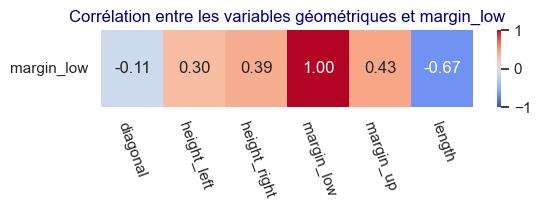

In [177]:
#version sans tri ascendant 
df_graph = pd.DataFrame(df_billets_analyse_1_1[var_quant].corr()['margin_low']).T

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(6, 1))
sns.heatmap(df_graph, 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f"
           )
plt.title("Corrélation entre les variables géométriques et margin_low")
plt.xticks(rotation=-70)
plt.yticks(rotation=0)
plt.grid(visible=False)
plt.show()

##### <u>**CHOIX DES VARIABLES :**</u>  

<u>**CRITERES :**</u>  

- Les variables avec |corr| > 0.3 : sont potentiellement utiles.
- Les variables fortement corrélées entre elles (<-0.8 ou >0.8): à éviter ensemble dans le modèle à cause de colinéarité (on testera ça en étape 5).
- sens des variables non redondants

<u>**ANALYSE :**</u>  

**Les variables avec |corr| > 0.3 : sont potentiellement utiles.**  
- Les candidats sont 'height_left','height_right', 'margin_up', 'length'
- **=> Exclusion de 'diagonal'** (pas assez corrélées à 'margin_low' -0.11)

**Exclusion des variables fortement corrélées entre elles (|corr|>0.8) :**  
- pas de variables avec de fortes corrélations entre elles

**Cohérence du point de vue sens géométrique des billets**  
- redondance possible de 'height_left','height_right'
- height_right est plus corrélée à la cible que height_left qui est limite (+0.39 vs +0.30)
- il n'y a pas de forte redondance entre height_right et les autres variables,
- il n'y a pas de forte redondance entre height_left et les autres variables,

*Conservons height_right :*  
- Il est plus corrélé à la cible que height_left.
- Il n’est pas redondant avec d’autres variables retenues (length, margin_up).

<font color='orange'>**CETTE FOIS CI N'EXCLUONS PAS height_left**</font>

*N'Ecartons PAS provisoirement height_left :*
- Pour éviter de trop complexifier le modèle initial.
- Sa corrélation avec la cible est limite (0.30).
-  souvent pertinent dans une première modélisation d’éviter d’avoir deux variables très similaires sémantiquement (height_left et height_right) sauf si on suspecte une asymétrie importante sur les billets.  
**=>PAS DE Exclusion de 'height_left'**


##### <u>**CONCLUSION :**</u>  
**=> Conservons 'height_right','height_left' 'margin_up', 'length'**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.2.2 - Visualisation des corrélations : </h4>
</div>

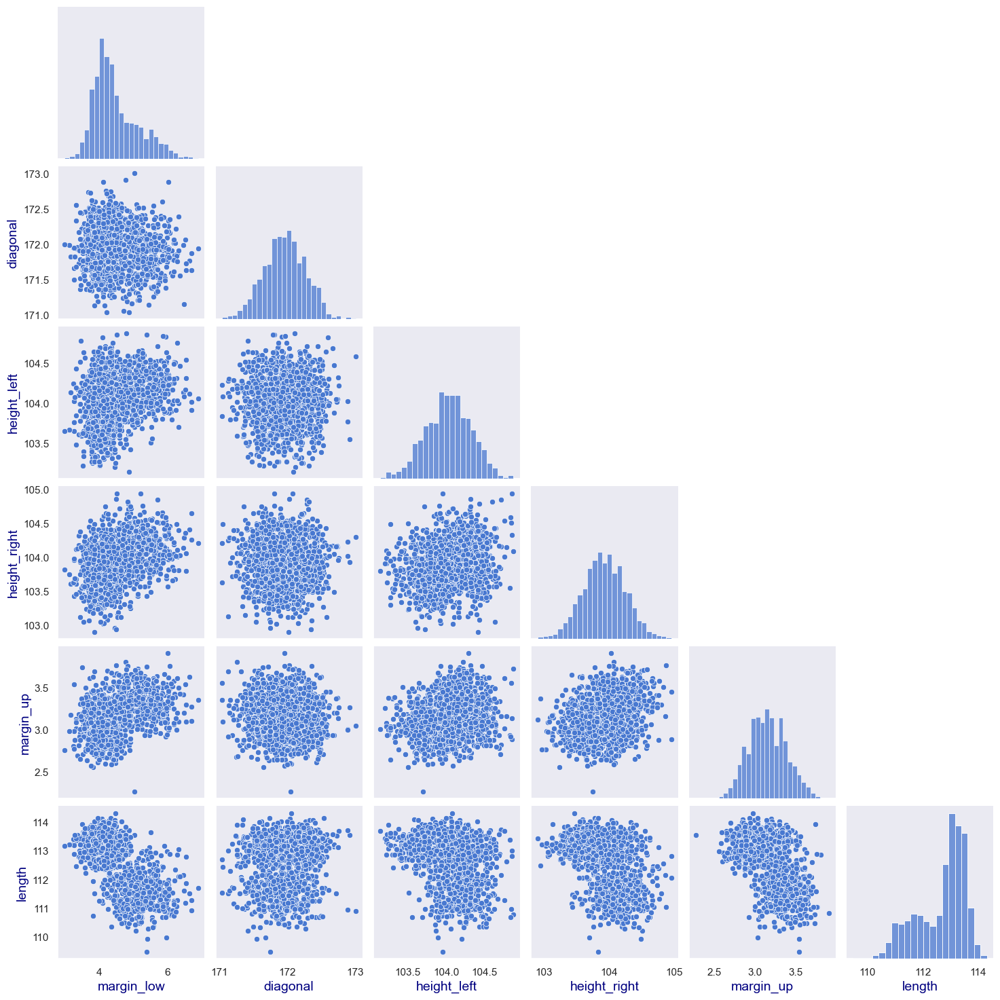

In [178]:
sns.pairplot(df_billets_analyse_1_1.dropna(), vars=['margin_low', 'diagonal', 'height_left', 'height_right', 'margin_up', 'length'],corner=True)


##### TEST GRAPH REGPLOT :

In [179]:
var_quant

['diagonal',
 'height_left',
 'height_right',
 'margin_low',
 'margin_up',
 'length']

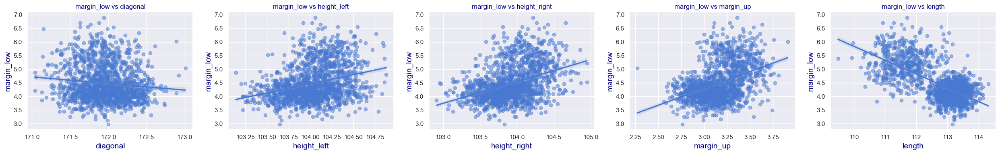

In [180]:
import seaborn as sns
import matplotlib.pyplot as plt

# Variables à tester comme prédicteurs
variables = ['diagonal',
             'height_left',
             'height_right',
             'margin_up',
             'length']  

# Dimensions du graph
fig, axes = plt.subplots(1, len(variables), figsize=(5 * len(variables), 4))

# Pour éviter les valeurs manquantes (important pour margin_low)
df_temp = df_billets_analyse_1_1.dropna(subset=['margin_low'])

# Création des regplots
for i, var in enumerate(variables):
    sns.regplot(x=var, y='margin_low', data=df_temp, ax=axes[i], scatter_kws={'alpha':0.5})
    axes[i].set_title(f"margin_low vs {var}")
    axes[i].set_xlabel(var)
    axes[i].set_ylabel("margin_low")
    axes[i].grid(True)

plt.tight_layout()
plt.show()

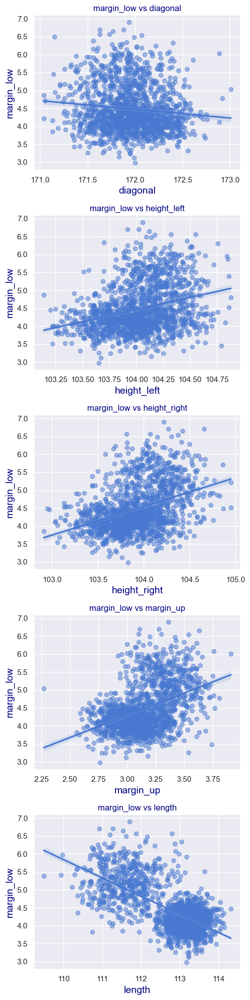

In [181]:
#import seaborn as sns
#import matplotlib.pyplot as plt

# Variables à tester comme prédicteurs
variables = ['diagonal',
             'height_left',
             'height_right',
             'margin_up',
             'length']  

# Dimensions du graph
fig, axes = plt.subplots(len(variables),1, figsize=(5, 4*len(variables)))

# Pour éviter les valeurs manquantes (important pour margin_low)
df_temp = df_billets_analyse_1_1.dropna(subset=['margin_low'])

# Création des regplots
for i, var in enumerate(variables):
    sns.regplot(x=var, y='margin_low', data=df_temp, ax=axes[i], scatter_kws={'alpha':0.5})
    axes[i].set_title(f"margin_low vs {var}")
    axes[i].set_xlabel(var)
    axes[i].set_ylabel("margin_low")
    axes[i].grid(True)

plt.tight_layout()
plt.show()

##### FIN TEST GRAPH REGPLOT :

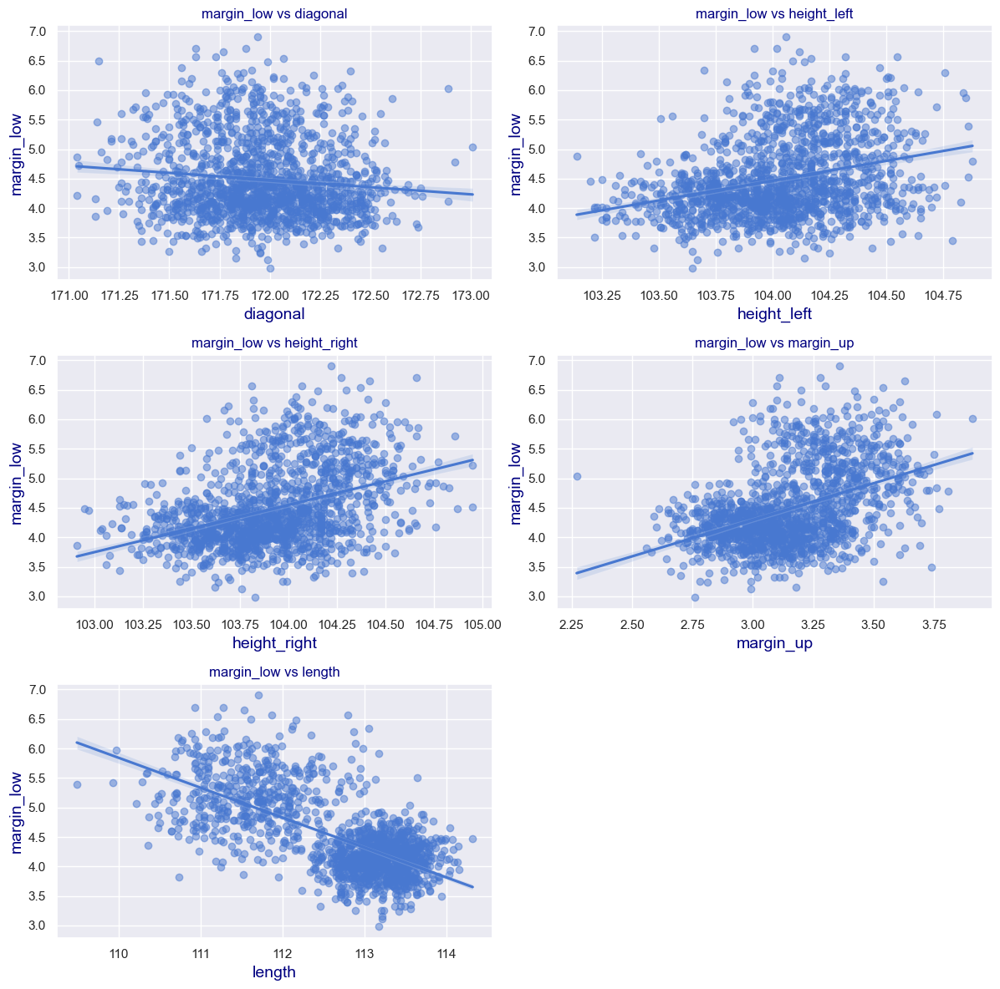

In [182]:
import seaborn as sns
import matplotlib.pyplot as plt

# Variables à tester comme prédicteurs
variables = ['diagonal',
             'height_left',
             'height_right',
             'margin_up',
             'length']  

n_vars = len(variables)
n_cols = 2
n_rows = (n_vars + 1) // n_cols  # arrondi supérieur

# Création de la grille
fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, 4 * n_rows))

# Aplatir la grille d'axes pour itérer facilement
axes = axes.flatten()

# Nettoyage des données
df_temp = df_billets_analyse_1_1.dropna(subset=['margin_low'])

# Création des regplots
for i, var in enumerate(variables):
    sns.regplot(x=var, y='margin_low', data=df_temp, ax=axes[i], scatter_kws={'alpha': 0.5})
    axes[i].set_title(f"margin_low vs {var}")
    axes[i].set_xlabel(var)
    axes[i].set_ylabel("margin_low")
    axes[i].grid(True)

# Si case vide à la fin (dans ce cas précis, 5 graphiques pour 6 cases)
for j in range(len(variables), len(axes)):
    fig.delaxes(axes[j])  # supprimer les axes vides

plt.tight_layout()
plt.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.2.3 - Bilan du Choix de Variable : </h4>
</div>

##### <u>**BILAN :**</u>  
**=> Conservons dans notre  modèle B :'height_right','height_left', 'margin_up', 'length'**

In [183]:
var_pred_B = ['length', 'margin_up', 'height_right','height_left'] #dans l'ordre de corrélation

Nous verrons s'il est utile de tester un second modèle B : 'length', 'margin_up', 'height_right', 'height_left'

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3B.3 - Effectuons la régression linéaire </h3>
</div>

In [184]:
df_billets_analyse_1_1.head(2)

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09


In [185]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_billets_analyse_1_1)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1463,37,285,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


In [186]:
#les variables quantitatives
var_quant

['diagonal',
 'height_left',
 'height_right',
 'margin_low',
 'margin_up',
 'length']

In [187]:
#variable cible :
var_cible = 'margin_low'

In [188]:
#Choix des variables prédictives
var_pred_B

['length', 'margin_up', 'height_right', 'height_left']

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.3.1 - Préparation des données : </h4>
</div>

**Séparer les données connues et manquantes**

In [189]:
df_known = df_billets_analyse_1_1[df_billets_analyse_1_1['margin_low'].notna()]
df_missing = df_billets_analyse_1_1[df_billets_analyse_1_1['margin_low'].isna()]

In [190]:
df_known.shape

(1463, 7)

In [191]:
df_missing.shape

(37, 7)

**Définir X et y avec nos variables predictives et cible :**

In [192]:
# Variables predictives et cible
X_B = df_known[var_pred_B]
y_B = df_known ['margin_low']  

In [193]:
X_B.shape

(1463, 4)

In [194]:
y_B.shape

(1463,)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.3.2 - Entraînement du modèle : </h4>
</div>

In [195]:
from sklearn.linear_model import LinearRegression

In [196]:
reg_B = LinearRegression()
reg_B.fit(X_B, y_B)

,fit_intercept,True
,copy_X,True
,tol,1e-06
,n_jobs,None
,positive,False


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.3.3 - Affichage des coefficients : </h4>
</div>

In [197]:
# Affichage sous forme lisible
for var, coef in zip(var_pred_B, reg_B.coef_):
    print(f"Coef. {var} : {round(coef, 4)}")

print(f"Intercept : {round(reg_B.intercept_, 4)}")

Coef. length : -0.4136
Coef. margin_up : 0.2588
Coef. height_right : 0.255
Coef. height_left : 0.1779
Intercept : 5.2656


In [198]:
# Affichage sous forme lisible
print("y = ")
for var, coef in zip(var_pred_B, reg_B.coef_):
    print(f" {round(coef, 2)} * {var} +")

print(f"{round(reg_B.intercept_, 2)}")

y = 
 -0.41 * length +
 0.26 * margin_up +
 0.25 * height_right +
 0.18 * height_left +
5.27


**OBSERVATION :**  
Les signes sont cohérents avec les corrélations :  
- length était négativement corrélée → coefficient négatif  
- margin_up et height_right étaient positivement corrélées → coefficients positifs

**INTERPRETATION :**  
Coef. length : -0.4136  À chaque mm supplémentaire de longueur, la marge basse diminue en moyenne de 0.4136 mm, toutes choses égales par ailleurs.  


Coef. margin_up : 0.2588
Une augmentation de 1 mm de la marge haute entraîne en moyenne une augmentation de 0.2588 mm de la marge basse.  

Coef. height_right : 0.255 
Chaque mm supplémentaire sur la hauteur droite augmente la marge basse d’environ 0.2555 mm.   
Coef. height_left  :  0.1779
Chaque mm supplémentaire sur la hauteur droite augmente la marge basse d’environ  0.1779 mm.   

5
Intercept 5.27.1  
Valeur estimée de margin_low quand toutes les variables explicatives sont nulles (ce qui n’a pas forcément de sens physique, mais sert de base mathématique).26

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.3.4 - Calcul du R² (qualité du modèle) : </h4>
</div>

In [199]:
r2_B = reg_B.score(X_B, y_B)
print(f"R²  : {round(r2_B, 4)}")

R²  : 0.4748


<u>Qu’est-ce que le R² (coefficient de détermination) </u>    
R² = proportion de la variance expliquée par le modèle.  
Il varie entre 0 (aucune explication) et 1 (modèle parfait).
Un R² de 0.85, par exemple, signifie que 85 % de la variabilité de margin_low est expliquée par les variables choisies.

Un R² > 0.7 est souvent considéré comme bon, mais cela dépend du domaine.

**OBSERVATION :**  
R²  : 0.4748
Le modèle explique environ 47% de la variance de margin_low. C’est modéré, mais assez courant pour des données physiques.  

<font color='orange'><u>**PAS D'AMELIORATION**</u></font>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.3.5 -Prédictions et résidus : </h4>
</div>

In [200]:
# Prédictions
y_pred_B = reg_B.predict(X_B)

# Calcul des résidus
residus_B = y_B - y_pred_B

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.3.5 -Prédictions et résidus sur les valeurs connues : </h4>
</div>

In [201]:
df_resultats_B = pd.DataFrame({
    'y_obs': y_B,
    'y_pred': y_pred_B,
    'residu': residus_B
})
df_resultats_B.head()

,y_obs,y_pred,residu
0,4.52,4.763395,-0.243395
1,3.77,4.085862,-0.315862
2,4.40,4.202468,0.197532
3,3.62,4.086577,-0.466577
4,4.04,4.552889,-0.512889


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.3.6 - méthode de scoring : </h4>
</div>

In [202]:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import root_mean_squared_error
from sklearn.metrics import mean_absolute_percentage_error

In [203]:
print(f"MSE: {mean_squared_error(y_B, y_pred_B)}")
print(f"RMSE: {root_mean_squared_error(y_B, y_pred_B)}")
print(f"MAPE: {mean_absolute_percentage_error(y_B, y_pred_B)}")

MSE: 0.23128730458734376
RMSE: 0.48092338744060237
MAPE: 0.08252047707134823


**MODELE A :**
Pour ces 3 métriques, un score plus petit correspond à un meilleur modèle.  
Cependant MSE, et RMSE ne sont pas contraints en valeur donc meilleur pour une coparaison de modèle qu'une interprétation sur un seul modèle.  

**MAPE est compris entre 0 et 1.  
ICI une valeur de MAPE de 0.08 proche de 0 indique un bon score de performance.**

**OBSERVATION MODELE A:**  
MSE: 0.2337893407777293  
Moyenne des carrés des écarts entre valeurs observées et prédites. Plus il est bas, mieux c’est.  

RMSE: 0.4835176736973833  
Erreur absolue moyenne exprimée dans l’unité de la variable cible. Ici, une erreur typique de prédiction est d’environ 0.48 mm, ce qui est relativement faible (à juger selon le contexte métier). Ici ca fait environ 10% d'une valeur moyenne de marge aux alentours de 4mm, c'est non négligeable mais raisonnable.  
5
MAPE: 0.083041136486489  
L’erreur relative moyenne est de 8.3 %, ce qui est très raisonnable dans de nombreux contextes industriels.  97

<font color='orange'><u>**PAS D'AMELIORATION AVEC MODELE B**</u></font>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.3.6 - Prédire les valeurs manquantes : </h4>
</div>

In [204]:
# Variables predictives pour les valeurs manquantes
X_missing_B = df_missing[var_pred_B]
y_missing_pred_B = reg_B.predict(X_missing_B)

#si on choisit de remplir df_billets_analyse_1_1 avec les valeurs calculées
#df_billets_analyse_1_1.loc[df_missing.index, 'margin_low'] = reg.predict(X_missing_B)
#ou idem :
##df_billets_analyse_1_1.loc[df_missing.index, 'margin_low'] = y_missing_pred_B

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3B.4 - Vérification des hypothèses </h3>
</div>

Nous allons vérifier 3 hypothèses fondamentales poru pouvoir appliquer la régression linéaire :  
- Colinéarité entre les variables explicatives
- Normalité des résidus :
- Homoscédasticité des résidus


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.4.1 - Colinéarité entre les variables explicatives : </h4>
</div>

But : Vérifier qu’il n’y a pas de forte redondance entre les variables prédictives.

**Théorie : VIF (Variance Inflation Factor)**  
Le VIF (ou Facteur d’Inflation de la Variance) est un indicateur utilisé pour détecter la colinéarité entre variables explicatives dans une régression linéaire multiple.  

Pourquoi c’est important :  
- Si deux variables prédictives sont fortement corrélées entre elles (colinéarité), cela :  
rend les coefficients instables (petit changement dans les données → gros changement dans les coefficients),    
- complique l’interprétation individuelle des effets,    
- nuit à la fiabilité du modèle.  

Formule du VIF :    
Pour une variable X𝑖, on fait une régression de 𝑋𝑖, sur toutes les autres variables 𝑋𝑗, puis :    
VIF(𝑋𝑖)=1/(1-𝑅𝑖^2)    
où 𝑅𝑖^2 est le R² obtenu en régressant 𝑋𝑖 sur les autres 𝑋𝑗  

Interprétation des valeurs :  
VIF	Interprétation  
. ≈ 1	Aucune colinéarité  
. 1 – 5	Faible colinéarité (acceptable)  
. > 5	Colinéarité modérée à forte  
. > 10	Très forte colinéarité à éviter  

In [205]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
import statsmodels.api as sm

# Création de la matrice X avec constante
X_const_B = sm.add_constant(X_B)

# Calcul du VIF
vif_B = pd.DataFrame()
vif_B["variables"] = X_B.columns
vif_B["VIF"] = [variance_inflation_factor(X_const_B.values, i + 1) for i in range(len(X_B.columns))]

print(vif_B)

      variables       VIF
0        length  1.563099
1     margin_up  1.404082
2  height_right  1.229690
3   height_left  1.135245


**OBSERVATIONS :**  
Pour toutes les variables la colinéarité avec les autres variables est faible.  
**=>pas de forte redondance entre les variables prédictives : OK**

<font color='orange'><u>**STABILITE AVEC MODELE B**</u></font>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.4.2 - Normalité des résidus : </h4>
</div>

But : Vérifier que les erreurs suivent une loi normale (hypothèse importante pour les intervalles de confiance et tests statistiques).  

In [206]:
import scipy.stats as stats

Conditions pour effectuer le Test de Schapiro : (effectifs <2000 voire 5000 ok)

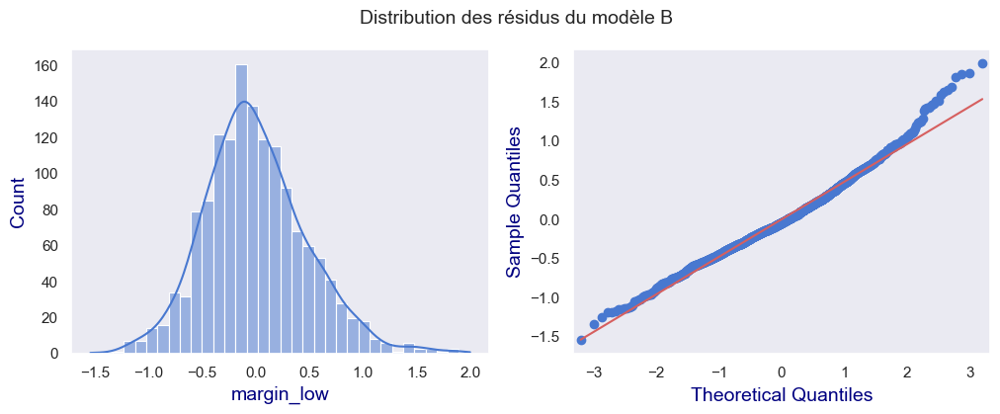

Statistique Shapiro : 0.9855 | p-value : 0.0


In [207]:
# Histogramme + courbe KDE +QQPLot

fig, (a,b) = plt.subplots(nrows=1, ncols=2, figsize=(12, 4))
plt.suptitle("Distribution des résidus du modèle B")

sns.histplot(x=residus_B, kde=True, ax=a)
qqplot(residus_B, line='s', ax=b)

plt.show()

# Test de Shapiro-Wilk
stat, pvalue = stats.shapiro(residus_B)
print(f"Statistique Shapiro : {round(stat, 4)} | p-value : {round(pvalue, 4)}")

Interprétation :  
p-value > 0.05 → H₀ non rejetée → les résidus sont compatibles avec une distribution normale.
p-value < 0.05 → H₀ rejetée → les résidus ne suivent pas une distribution normale.

Le test est sensible à la taille de l’échantillon : avec un grand n, une légère déviation de la normalité peut déjà donner une p-value faible. D’où l’intérêt aussi du graphique KDE.

**OBSERVATION :**  
visuellement la distribution pourrait suivre une loie Normale,  
mais statistiquement ce n'est pas le cas avec p-value <<0.05 .  
**=>les résidus ne suivent pas une loi normale**

<font color='orange'><u>**PAS D'AMELIORATION AVEC MODELE B**</u></font>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3B.4.3 - Homoscédasticité des résidus : </h4>
</div>

But : Vérifier que la variance des erreurs reste constante quelle que soit la valeur prédite.

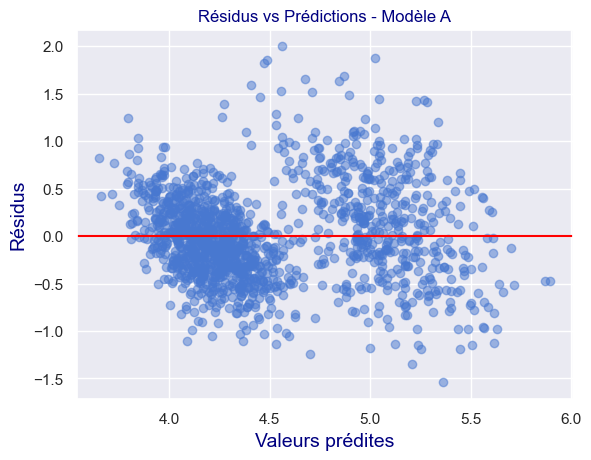

In [208]:
plt.scatter(y_pred_B, residus_B, alpha=0.5)
plt.axhline(0, color='red')
plt.xlabel("Valeurs prédites")
plt.ylabel("Résidus")
plt.title("Résidus vs Prédictions - Modèle A")
plt.grid(True)
plt.show()

**Interprétation :**  
Si les résidus sont répartis de manière homogène autour de 0   
Si on observe un entonnoir (variance croissante/décroissante) ou un motif → il y a hétéroscédasticité, ce qui peut biaiser les intervalles de confiance et tests.  

Ici on a une répartition de part et d'autre cela semblerait ok.  
Cependant on a tout de m^mee de forme détachée avec une pente.

**OBSERVATION :**  
Les Résidus sont plutôt répartis de manière homogène autour de zéro.  
**=> Homoscédasticité des résidus**

<font color='orange'><u>**STABILITE AVEC MODELE B**</u></font>

<u>**MESURE DE L'HOMOSCEDASTICITE DES RESIDUS :**</u>  
Tester si : Les résidus du modèle ont une variance constante quelle que soit la valeur des prédicteurs.  
H₀ (hypothèse nulle) : Homoscédasticité (variance constante des résidus)  
H₁ (hypothèse alternative) : Hétéroscédasticité (variance non constante)  

1. Test de Breusch-Pagan (le plus courant)  
2. Test de White (plus général, robuste)

Conditions d'application :
1. Modèle linéaire correctement spécifié =>OK  
2. Résidus du modèle bien calculés =>OK  
3. Pas trop de multicolinéarité entre les variables explicatives =>OK  
4. Données numériques et sans valeurs manquantes =>OK  
5. Nombre d’observations suffisant (>30) =>OK  

Remarque :  la normalité des résidus n’est pas une condition préalable
Le test de Breusch-Pagan ne suppose pas que les résidus soient normalement distribués.
Ce n’est pas une condition obligatoire, mais si les résidus sont fortement asymétriques ou présentent des outliers extrêmes, cela peut affecter les performances du test.  
(ce n'est pas le cas ici)

**1. Test de Breusch-Pagan (le plus courant)**

In [209]:
#Test de Breusch-Pagan (le plus courant)
from statsmodels.stats.diagnostic import het_breuschpagan
#import statsmodels.api as sm

# Ajout de la constante à X
X_const_B = sm.add_constant(X_B)

# Calcul des résidus
#residus_B = y_B - reg_B.predict(X_B)=>déjà fait

# Test de Breusch-Pagan
bp_test = het_breuschpagan(residus_B, X_const_B)

# Résultat du test
bp_labels = ['Statistique', 'p-value', 'f-stat', 'f p-value']
for name, value in zip(bp_labels, bp_test):
    print(f"{name} : {value:.4f}")

Statistique : 80.4505
p-value : 0.0000
f-stat : 21.2102
f p-value : 0.0000


**Interprétation :**  
- Si la p-value < 0.05, on rejette l’hypothèse H₀ : les résidus ne sont pas homoscédastiques (donc problème d’hétéroscédasticité).  
- Si la p-value > 0.05, on ne rejette pas H₀ : les résidus peuvent être considérés comme homoscédastiques (ce qu’on veut).

**OBSERVATION :**  
p-value proche de 0 
Rejet de H₀ → Présence d’hétéroscédasticité dans le modèle.  
Autrement dit, les résidus n'ont pas une variance constante, ce qui viole une des hypothèses fondamentales de la régression linéaire.  
**homoscédastiques KO : la variance des erreurs n'est pas constante ici**

<font color='orange'><u>**PAS D'AMELIORATION AVEC MODELE B**</u></font>

**2. Test de White (plus général, robuste)**

In [210]:
#MESURE DE L'HOMOSCEDASTICITE DES RESIDUS : Test de White (plus général, robuste)
from statsmodels.stats.diagnostic import het_white

# Ajout de la constante à X
X_const_B = sm.add_constant(X_B)

white_test = het_white(residus_B, X_const_B)

labels_white = ['Statistique LM', 'p-value', 'Stat F', 'p-value F']
for name, val in zip(labels_white, white_test):
    print(f"{name} : {val}")

Statistique LM : 98.54285020938703
p-value : 9.015755454820823e-15
Stat F : 7.4697444498133665
p-value F : 2.5686919525655733e-15


**Interprétation :**  
Statistique LM : Statistique de Lagrange multiplier  
p-value (associée à LM) : si elle est < 0.05, on rejette H₀  
Statistique F : test F auxiliaire  
p-value F : interprétation identique
  
- Si la p-value < 0.05, on rejette l’hypothèse H₀ : les résidus ne sont pas homoscédastiques (donc problème d’hétéroscédasticité).  
- Si la p-value > 0.05, on ne rejette pas H₀ : les résidus peuvent être considérés comme homoscédastiques (ce qu’on veut).

**OBSERVATION :**  
p-value proche de 0 
Rejet de H₀ → Présence d’hétéroscédasticité dans le modèle.  
Autrement dit, les résidus n'ont pas une variance constante, ce qui viole une des hypothèses fondamentales de la régression linéaire.  
**homoscédastiques KO : la variance des erreurs n'est pas constante ici**

<font color='orange'><u>**PAS D'AMELIORATION AVEC MODELE B**</u></font>

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 3C - Traitement des données manquantes -Regression Linéaire : modèle C</h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3C.1 - Conditions préalables à la régression linéaire </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.1.1 - présence de données manquantes : </h4>
</div>

In [211]:
df_billets_analyse_1_1.columns

Index(['is_genuine', 'diagonal', 'height_left', 'height_right', 'margin_low',
       'margin_up', 'length'],
      dtype='object')

In [212]:
df_billets_analyse_1_1.shape

(1500, 7)

In [213]:
df_billets_analyse_1_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500 entries, 0 to 1499
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   is_genuine    1500 non-null   bool   
 1   diagonal      1500 non-null   float64
 2   height_left   1500 non-null   float64
 3   height_right  1500 non-null   float64
 4   margin_low    1463 non-null   float64
 5   margin_up     1500 non-null   float64
 6   length        1500 non-null   float64
dtypes: bool(1), float64(6)
memory usage: 71.9 KB


In [214]:
df_billets_analyse_1_1.isna().sum()

is_genuine       0
diagonal         0
height_left      0
height_right     0
margin_low      37
margin_up        0
length           0
dtype: int64

In [215]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_billets_analyse_1_1)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1463,37,285,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


**OBSERVATION :**  
Sur les 1500 billets nous avons 37 valeurs manquantes, toutes sur la seule variable `margin_low`.   
Tel que demandé par Marie, complétons ces valeurs par régression linéaire.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.1.2 - Quantité suffisante de données connues  : </h4>
</div>

In [216]:
#le nombre de données non nulles pour margin_low
(~df_billets_analyse_1_1.isna()).sum()['margin_low']

1463

In [217]:
#le nombres de lignes complètes :
(df_billets_analyse_1_1.dropna(axis=0,how='any') ).shape[0]

1463

**OBSERVATION :**  
1463 lignes complètes ➜ suffisant pour entraîner un modèle.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.1.3 - Variables numériques continues : </h4>
</div>

In [218]:
df_billets_analyse_1_1.dtypes

is_genuine         bool
diagonal        float64
height_left     float64
height_right    float64
margin_low      float64
margin_up       float64
length          float64
dtype: object

**OBSERVATION :**  
Toutes les variables géométriques sont numériques continues, ce qui convient à une régression linéaire.  
**PRESELECTION-1 DE VARIABLES PREDICTIVES :**  
'diagonal', 'height_left', 'height_right', 'margin_low',  'margin_up', 'length'

<font color='orange'><u>**OBSERVATION COMPLEMENTAIRE :**</u></font>  
La variable booléenne 'is-genuine' peut-être vue comme variable numérique 0 1.  
Les varablse prédictives n'ont pas besoin d'être continue, seulement numérique.  
Seule la variable cible, doit être numérique ET CONTINUE !

<font color='orange'><u>**Convertissons les True/false en 0 et 1 dans df_billets_analyse_1_1_Cnum :**</u></font> 

In [219]:
#Convertissons les True/false en 0 et 1 dans df_billets_analyse_1_1_Cnum
df_billets_analyse_1_1_Cnum = df_billets_analyse_1_1.copy(deep=True)
df_billets_analyse_1_1_Cnum["is_genuine"] = df_billets_analyse_1_1_Cnum["is_genuine"].astype(int)

In [220]:
df_billets_analyse_1_1_Cnum.head()

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,1,171.81,104.86,104.95,4.52,2.89,112.83
1,1,171.46,103.36,103.66,3.77,2.99,113.09
2,1,172.69,104.48,103.50,4.40,2.94,113.16
3,1,171.36,103.91,103.94,3.62,3.01,113.51
4,1,171.73,104.28,103.46,4.04,3.48,112.54


In [221]:
df_billets_analyse_1_1_Cnum['is_genuine'].value_counts()

is_genuine
1    1000
0     500
Name: count, dtype: int64

In [222]:
Premieres_Analyses(df_billets_analyse_1_1_Cnum)


---- SHAPE ----


(1500, 7)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500 entries, 0 to 1499
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   is_genuine    1500 non-null   int32  
 1   diagonal      1500 non-null   float64
 2   height_left   1500 non-null   float64
 3   height_right  1500 non-null   float64
 4   margin_low    1463 non-null   float64
 5   margin_up     1500 non-null   float64
 6   length        1500 non-null   float64
dtypes: float64(6), int32(1)
memory usage: 76.3 KB

---- DESCRIBE ----


,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.000000,1500.000000,1500.000000,1500.000000,1463.000000,1500.000000,1500.00000
mean,0.666667,171.958440,104.029533,103.920307,4.485967,3.151473,112.67850
std,0.471562,0.305195,0.299462,0.325627,0.663813,0.231813,0.87273
min,0.000000,171.040000,103.140000,102.820000,2.980000,2.270000,109.49000
25%,0.000000,171.750000,103.820000,103.710000,4.015000,2.990000,112.03000
50%,1.000000,171.960000,104.040000,103.920000,4.310000,3.140000,112.96000
75%,1.000000,172.170000,104.230000,104.150000,4.870000,3.310000,113.34000
max,1.000000,173.010000,104.880000,104.950000,6.900000,3.910000,114.44000



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,int32,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1463,37,285,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.1.4 - Absence de données aberrantes : PAS BESOIN DE REEANALYSER 'is_genuine ne prend que les valeurs 0 ou 1</h4>
</div>

##### **Analyse des valeurs extrêmes à partir des ratios IQR :**  

méthode pour détecter les valeurs aberrantes en utilisant des ratios basés sur l’écart interquartile (IQ) :  

Formule :  
IQ = Q3-Q1  
'min-Q1/IQ' = (Q1-min)/IQ  
'Q3-max/IQ' = (max-Q3)/IQ  

Ces rapports permettent de détecter des valeurs potentiellement aberrantes (outliers) selon les **règles de Tukey** .

**Règle de Tukey (règle des 1.5 * IQ)**
Selon cette règle classique :

Un point est considéré comme un outlier modéré s’il est en dehors de l’intervalle :
[Q1-1,5IQR , Q3+1,5IQR]

Autrement dit :
- Si (Q1-min)/IQ  >1.5 ou (max-Q3)/IQ  >1.5 => il peut y avoir des outliers modérés.
- Si le ratio dépasse 3, on considère plutôt des outliers sévères.

In [223]:
df_billets_analyse_1_1_Cnum.describe()

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.000000,1500.000000,1500.000000,1500.000000,1463.000000,1500.000000,1500.00000
mean,0.666667,171.958440,104.029533,103.920307,4.485967,3.151473,112.67850
std,0.471562,0.305195,0.299462,0.325627,0.663813,0.231813,0.87273
min,0.000000,171.040000,103.140000,102.820000,2.980000,2.270000,109.49000
25%,0.000000,171.750000,103.820000,103.710000,4.015000,2.990000,112.03000
50%,1.000000,171.960000,104.040000,103.920000,4.310000,3.140000,112.96000
75%,1.000000,172.170000,104.230000,104.150000,4.870000,3.310000,113.34000
max,1.000000,173.010000,104.880000,104.950000,6.900000,3.910000,114.44000


In [224]:
df_temp= df_billets_analyse_1_1_Cnum.describe().T
display(df_temp)

,count,mean,std,min,25%,50%,75%,max
is_genuine,1500.0,0.666667,0.471562,0.00,0.000,1.00,1.00,1.00
diagonal,1500.0,171.958440,0.305195,171.04,171.750,171.96,172.17,173.01
height_left,1500.0,104.029533,0.299462,103.14,103.820,104.04,104.23,104.88
height_right,1500.0,103.920307,0.325627,102.82,103.710,103.92,104.15,104.95
margin_low,1463.0,4.485967,0.663813,2.98,4.015,4.31,4.87,6.90
margin_up,1500.0,3.151473,0.231813,2.27,2.990,3.14,3.31,3.91
length,1500.0,112.678500,0.872730,109.49,112.030,112.96,113.34,114.44


In [225]:
df_temp['IQ']=df_temp['75%']-df_temp['25%']
df_temp['min-Q1/IQ']= (df_temp['25%'] -df_temp['min'])/df_temp['IQ']
df_temp['Q3-max/IQ']= (df_temp['max'] -df_temp['75%'])/df_temp['IQ']
display(df_temp)

,count,mean,std,min,25%,50%,75%,max,IQ,min-Q1/IQ,Q3-max/IQ
is_genuine,1500.0,0.666667,0.471562,0.00,0.000,1.00,1.00,1.00,1.000,0.000000,0.000000
diagonal,1500.0,171.958440,0.305195,171.04,171.750,171.96,172.17,173.01,0.420,1.690476,2.000000
height_left,1500.0,104.029533,0.299462,103.14,103.820,104.04,104.23,104.88,0.410,1.658537,1.585366
height_right,1500.0,103.920307,0.325627,102.82,103.710,103.92,104.15,104.95,0.440,2.022727,1.818182
margin_low,1463.0,4.485967,0.663813,2.98,4.015,4.31,4.87,6.90,0.855,1.210526,2.374269
margin_up,1500.0,3.151473,0.231813,2.27,2.990,3.14,3.31,3.91,0.320,2.250000,1.875000
length,1500.0,112.678500,0.872730,109.49,112.030,112.96,113.34,114.44,1.310,1.938931,0.839695


**CONCLUSION :**  
**Les valeurs sont raisonnables :**
- Nos ratios sont tous < 2.5 (<3), ce qui indique seulement des outliers modérés.  
**=> Il n’y a aucune raison immédiate d’exclure ces données.**

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3C.2 -  Choix de Scaler(Non Néc) et des variables pour prédire `margin_low`</h3>
</div>

##### **Remarque : Avons-nous besoin de standardiser les données ?** 

**Remarque : Avons-nous besoin de standardiser les données ?**  

La standardisation (centrer-réduire les variables) est surtout importante dans certains contextes, notamment :  
- Régression avec analyse des coefficients (importance relative des coeffs) /RECOMMANDE
- Modèles basés sur la distance (KNN, SVM...)  /NECESSAIRE  
- Réduction de dimension (PCA...)  /NECESSAIRE  
- Variables avec unités très différentes /Souvent nécessaire

Lors d'une régression linéaire pour prédiction uniquement => Standardistation non obligatoire.  

Dans notre cas précis :
- Nous faisons une régression linéaire pour imputer une variable manquante (margin_low) à partir des autres mesures géométriques.  
- Les variables ont des ordres de grandeur proches, de l'ordre de centimètres à millimètres (valeurs entre ~2 et 115).  
- Le modèle n’est pas sensible aux échelles si nous n’interprètons pas directement les coefficients.  
- Les modèles de LinearRegression() de scikit-learn gèrent bien les différences d’échelle modérées.  

**CONCLUSION : => Standardisation NON NECESSAIRE.**

##### **CONCLUSION : => Standardisation NON NECESSAIRE.**

Nous allons prédire margin_low. Il faut donc choisir des variables corrélées avec celle-ci.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.2.1 - Calculer les corrélations : </h4>
</div>

In [226]:
var_quant

['diagonal',
 'height_left',
 'height_right',
 'margin_low',
 'margin_up',
 'length']

In [227]:
var_quant_C =df_billets_analyse_1_1_Cnum.columns
var_quant_C

Index(['is_genuine', 'diagonal', 'height_left', 'height_right', 'margin_low',
       'margin_up', 'length'],
      dtype='object')

In [228]:
df_billets_analyse_1_1_Cnum[var_quant_C].corr()

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
is_genuine,1.000000,0.132756,-0.379833,-0.485092,-0.783032,-0.606262,0.849285
diagonal,0.132756,1.000000,0.019472,-0.024492,-0.111534,-0.055649,0.097587
height_left,-0.379833,0.019472,1.000000,0.242279,0.302643,0.246522,-0.320863
height_right,-0.485092,-0.024492,0.242279,1.000000,0.391085,0.307005,-0.401751
margin_low,-0.783032,-0.111534,0.302643,0.391085,1.000000,0.431606,-0.666753
margin_up,-0.606262,-0.055649,0.246522,0.307005,0.431606,1.000000,-0.520575
length,0.849285,0.097587,-0.320863,-0.401751,-0.666753,-0.520575,1.000000


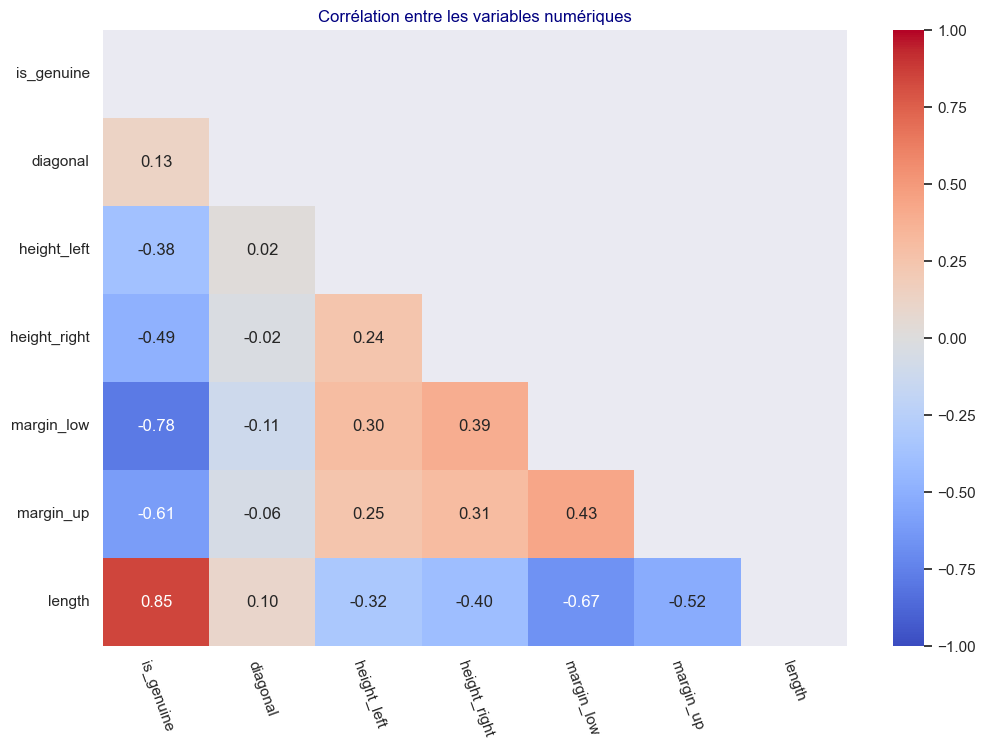

In [229]:
# Visualisation de la Matrice de corrélation

#mask_triangulaire
mask_semi_heatmap = np.triu(np.ones( (df_billets_analyse_1_1_Cnum[var_quant_C].corr(method='pearson')).shape  ))

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(12, 8))
sns.heatmap(df_billets_analyse_1_1_Cnum[var_quant_C].corr(), 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f",
            mask = mask_semi_heatmap
           )
plt.title("Corrélation entre les variables numériques")
plt.xticks(rotation=-70)
plt.yticks(rotation=0)
plt.grid(visible=False)
plt.show()

In [230]:
var_quant_C

Index(['is_genuine', 'diagonal', 'height_left', 'height_right', 'margin_low',
       'margin_up', 'length'],
      dtype='object')

In [231]:
var_quant_C_hors_m_l = ['is_genuine', 'diagonal', 
                        'height_left', 'height_right', 
                        'margin_up', 'length']

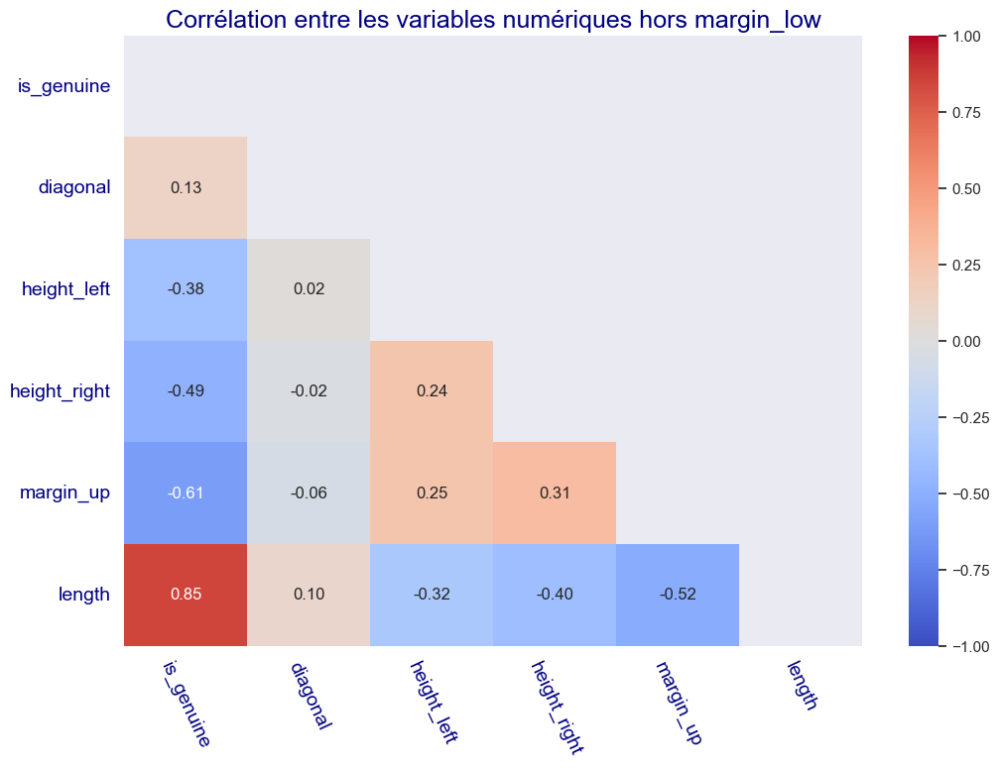

In [232]:
# Visualisation de la Matrice de corrélation hors margin_low

#mask_triangulaire
mask_semi_heatmap = np.triu(np.ones( (df_billets_analyse_1_1_Cnum[var_quant_C_hors_m_l].corr(method='pearson')).shape  ))

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(12, 8))
sns.heatmap(df_billets_analyse_1_1_Cnum[var_quant_C_hors_m_l].corr(), 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f",
            mask = mask_semi_heatmap
           )
plt.title("Corrélation entre les variables numériques hors margin_low",size=18)
plt.xticks(rotation=-65,size=14,color='navy')
plt.yticks(rotation=0,size=14,color='navy')
plt.grid(visible=False)
plt.show()

In [233]:
df_billets_analyse_1_1_Cnum[var_quant_C].corr()['margin_low'].sort_values(ascending=False)

margin_low      1.000000
margin_up       0.431606
height_right    0.391085
height_left     0.302643
diagonal       -0.111534
length         -0.666753
is_genuine     -0.783032
Name: margin_low, dtype: float64

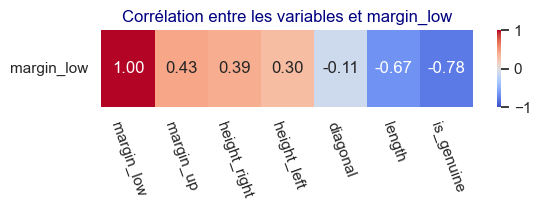

In [234]:
df_graph = pd.DataFrame(df_billets_analyse_1_1_Cnum[var_quant_C].corr()['margin_low'].sort_values(ascending=False)).T

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(6, 1))
sns.heatmap(df_graph, 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f"
           )
plt.title("Corrélation entre les variables et margin_low")
plt.xticks(rotation=-70)
plt.yticks(rotation=0)
plt.grid(visible=False)
plt.show()

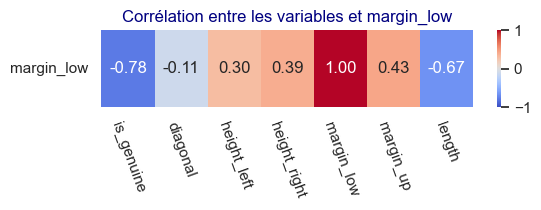

In [235]:
#version sans tri ascendant 
df_graph = pd.DataFrame(df_billets_analyse_1_1_Cnum[var_quant_C].corr()['margin_low']).T

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(6, 1))
sns.heatmap(df_graph, 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f"
           )
plt.title("Corrélation entre les variables et margin_low")
plt.xticks(rotation=-70)
plt.yticks(rotation=0)
plt.grid(visible=False)
plt.show()

##### <u>**CHOIX DES VARIABLES :**</u>  

<u>**CRITERES :**</u>  

- Les variables avec |corr| > 0.3 : sont potentiellement utiles.
- Les variables fortement corrélées entre elles (<-0.8 ou >0.8): à éviter ensemble dans le modèle à cause de colinéarité (on testera ça en étape 5).
- sens des variables non redondants

<u>**ANALYSE :**</u>  

**Les variables avec |corr| > 0.3 : sont potentiellement utiles.**  
- Les candidats sont 'height_left','height_right', 'margin_up', 'length'
- **=> Exclusion de 'diagonal'** (pas assez corrélées à 'margin_low' -0.11)

**Exclusion des variables fortement corrélées entre elles (|corr|>0.8) :**  
- pas de variables avec de fortes corrélations entre elles  
<font color='orange'>**CETTE FOIS CI length et is-genuine sont fortement corrélées entre elles**</font>

<font color='orange'>**=> EXCLUONS length**</font>
  
**Cohérence du point de vue sens géométrique des billets**  
- redondance possible de 'height_left','height_right'
- height_right est plus corrélée à la cible que height_left qui est limite (+0.39 vs +0.30)
- il n'y a pas de forte redondance entre height_right et les autres variables,
- il n'y a pas de forte redondance entre height_left et les autres variables,

*Conservons height_right :*  
- Il est plus corrélé à la cible que height_left.
- Il n’est pas redondant avec d’autres variables retenues (length, margin_up).


**Ecartons provisoirement height_left :**
- Pour éviter de trop complexifier le modèle initial.
- Sa corrélation avec la cible est limite (0.30).
-  souvent pertinent dans une première modélisation d’éviter d’avoir deux variables très similaires sémantiquement (height_left et height_right) sauf si on suspecte une asymétrie importante sur les billets.  
**=> Exclusion de 'height_left'**


##### <u>**CONCLUSION :**</u>  
**=> Conservons 'is_genuine','height_right', 'margin_up'**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.2.2 - Visualisation des corrélations : </h4>
</div>

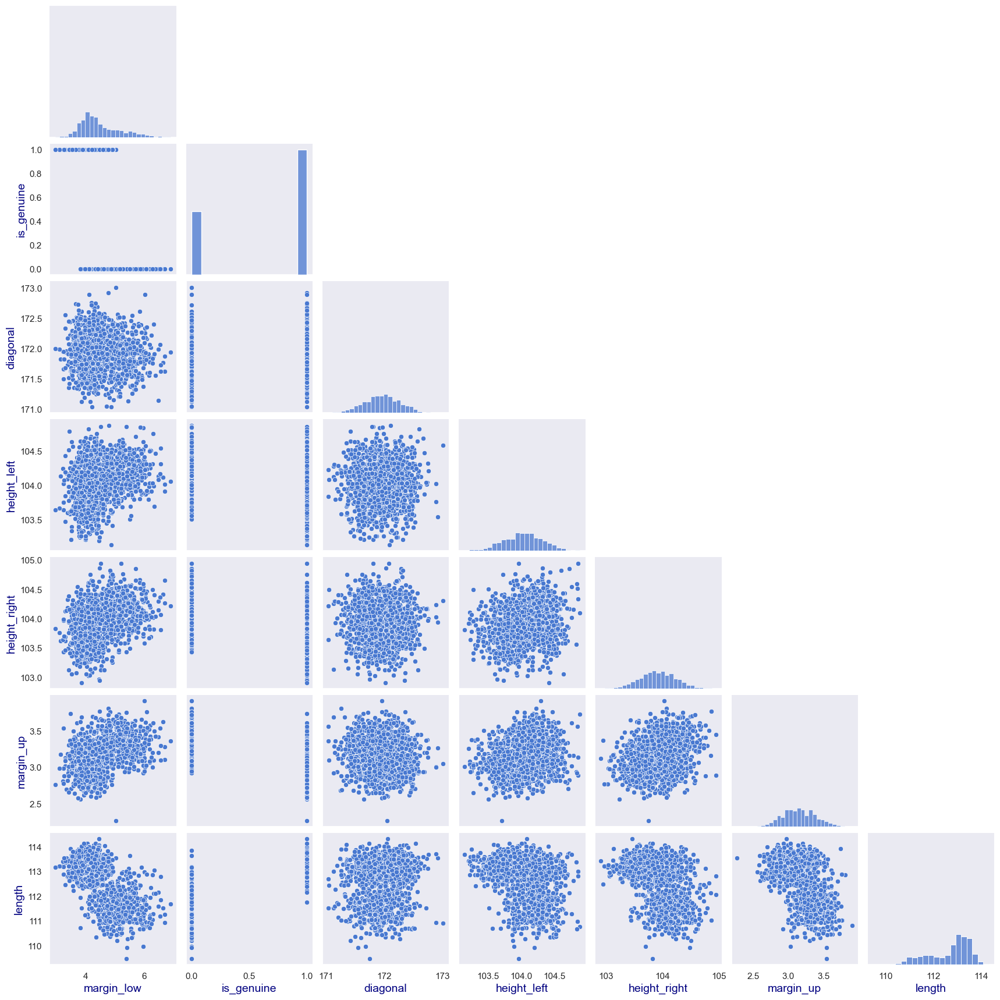

In [236]:
sns.pairplot(df_billets_analyse_1_1_Cnum.dropna(), vars=['margin_low', 'is_genuine','diagonal', 'height_left', 'height_right', 'margin_up', 'length'],corner=True)


##### TEST GRAPH REGPLOT :

In [237]:
var_quant_C

Index(['is_genuine', 'diagonal', 'height_left', 'height_right', 'margin_low',
       'margin_up', 'length'],
      dtype='object')

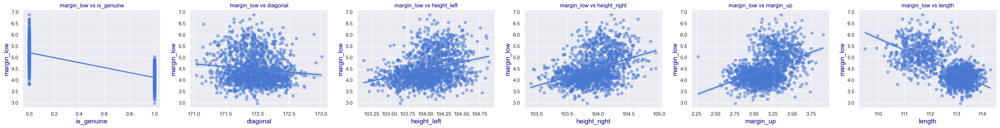

In [238]:
import seaborn as sns
import matplotlib.pyplot as plt

# Variables à tester comme prédicteurs
variables = ['is_genuine',
             'diagonal',
             'height_left',
             'height_right',
             'margin_up',
             'length']  

# Dimensions du graph
fig, axes = plt.subplots(1, len(variables), figsize=(5 * len(variables), 4))

# Pour éviter les valeurs manquantes (important pour margin_low)
df_temp = df_billets_analyse_1_1_Cnum.dropna(subset=['margin_low'])

# Création des regplots
for i, var in enumerate(variables):
    sns.regplot(x=var, y='margin_low', data=df_temp, ax=axes[i], scatter_kws={'alpha':0.5})
    axes[i].set_title(f"margin_low vs {var}")
    axes[i].set_xlabel(var)
    axes[i].set_ylabel("margin_low")
    axes[i].grid(True)

plt.tight_layout()
plt.show()

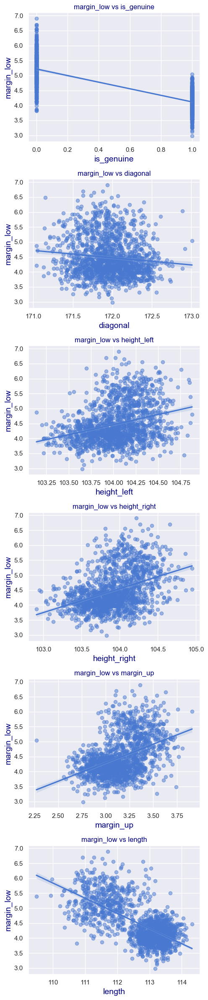

In [239]:
#import seaborn as sns
#import matplotlib.pyplot as plt

# Variables à tester comme prédicteurs
variables = ['is_genuine',
             'diagonal',
             'height_left',
             'height_right',
             'margin_up',
             'length']  

# Dimensions du graph
fig, axes = plt.subplots(len(variables),1, figsize=(5, 4*len(variables)))

# Pour éviter les valeurs manquantes (important pour margin_low)
df_temp = df_billets_analyse_1_1_Cnum.dropna(subset=['margin_low'])

# Création des regplots
for i, var in enumerate(variables):
    sns.regplot(x=var, y='margin_low', data=df_temp, ax=axes[i], scatter_kws={'alpha':0.5})
    axes[i].set_title(f"margin_low vs {var}")
    axes[i].set_xlabel(var)
    axes[i].set_ylabel("margin_low")
    axes[i].grid(True)

plt.tight_layout()
plt.show()

##### FIN TEST GRAPH REGPLOT :

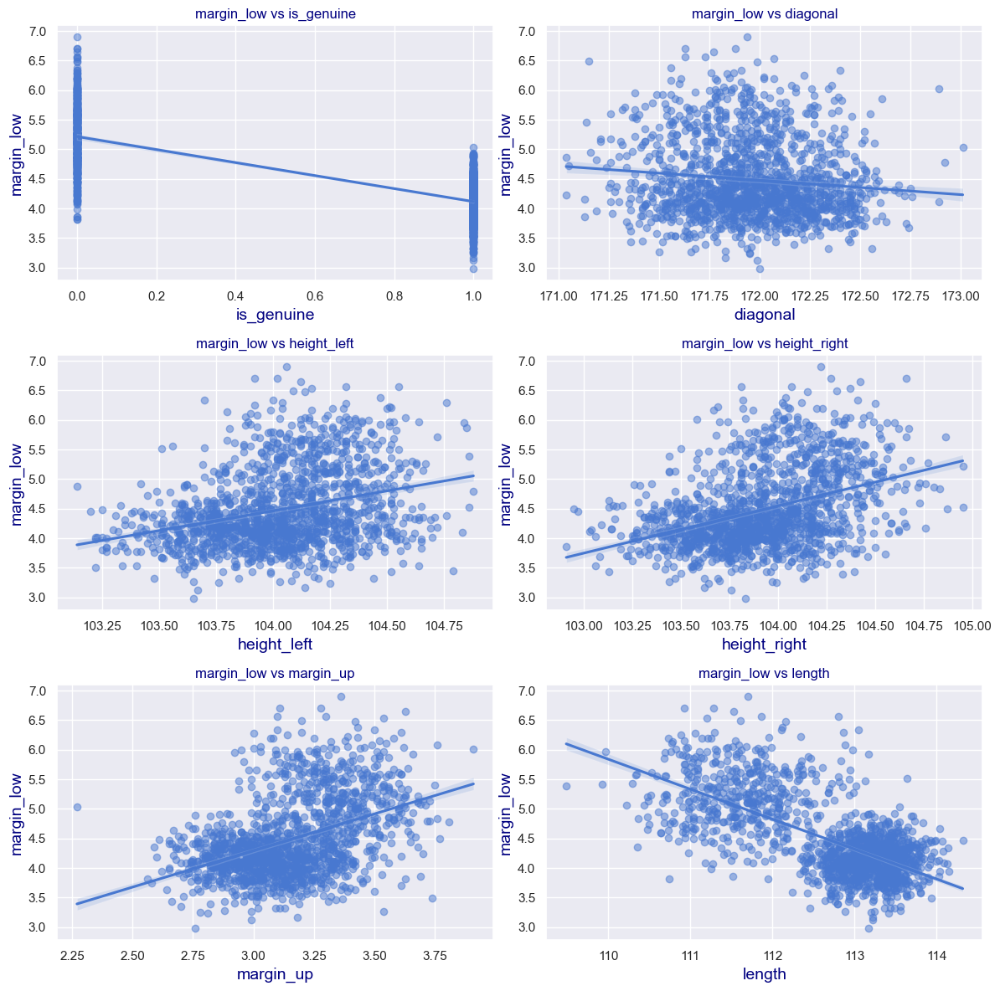

In [240]:
import seaborn as sns
import matplotlib.pyplot as plt

# Variables à tester comme prédicteurs
variables = ['is_genuine',
             'diagonal',
             'height_left',
             'height_right',
             'margin_up',
             'length']  

n_vars = len(variables)
n_cols = 2
n_rows = (n_vars + 1) // n_cols  # arrondi supérieur

# Création de la grille
fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, 4 * n_rows))

# Aplatir la grille d'axes pour itérer facilement
axes = axes.flatten()

# Nettoyage des données
df_temp = df_billets_analyse_1_1_Cnum.dropna(subset=['margin_low'])

# Création des regplots
for i, var in enumerate(variables):
    sns.regplot(x=var, y='margin_low', data=df_temp, ax=axes[i], scatter_kws={'alpha': 0.5})
    axes[i].set_title(f"margin_low vs {var}")
    axes[i].set_xlabel(var)
    axes[i].set_ylabel("margin_low")
    axes[i].grid(True)

# Si case vide à la fin (dans ce cas précis, 5 graphiques pour 6 cases)
for j in range(len(variables), len(axes)):
    fig.delaxes(axes[j])  # supprimer les axes vides

plt.tight_layout()
plt.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.2.3 - Bilan du Choix de Variable : </h4>
</div>

##### <u>**BILAN :**</u>  
**=> Conservons dans notre  modèle c :'is_genuine','height_right','height_left', 'margin_up'**

In [241]:
var_pred_C = ['is_genuine', 'margin_up', 'height_right'] #dans l'ordre de corrélation

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3C.3 - Effectuons la régression linéaire </h3>
</div>

In [242]:
df_billets_analyse_1_1_Cnum.head(2)

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,1,171.81,104.86,104.95,4.52,2.89,112.83
1,1,171.46,103.36,103.66,3.77,2.99,113.09


In [243]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_billets_analyse_1_1_Cnum)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,int32,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1463,37,285,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


In [244]:
#les variables quantitatives
var_quant_C

Index(['is_genuine', 'diagonal', 'height_left', 'height_right', 'margin_low',
       'margin_up', 'length'],
      dtype='object')

In [245]:
#variable cible :
var_cible = 'margin_low'

In [246]:
#Choix des variables prédictives
var_pred_C

['is_genuine', 'margin_up', 'height_right']

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.3.1 - Préparation des données : </h4>
</div>

**Séparer les données connues et manquantes**

In [247]:
df_known = df_billets_analyse_1_1_Cnum[df_billets_analyse_1_1_Cnum['margin_low'].notna()]
df_missing = df_billets_analyse_1_1_Cnum[df_billets_analyse_1_1_Cnum['margin_low'].isna()]

In [248]:
df_known.shape

(1463, 7)

In [249]:
df_missing.shape

(37, 7)

**Définir X et y avec nos variables predictives et cible :**

In [250]:
# Variables predictives et cible
X_C = df_known[var_pred_C]
y_C = df_known ['margin_low']  

In [251]:
X_C.shape

(1463, 3)

In [252]:
y_C.shape

(1463,)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.3.2 - Entraînement du modèle : </h4>
</div>

In [253]:
from sklearn.linear_model import LinearRegression

In [254]:
reg_C = LinearRegression()
reg_C.fit(X_C, y_C)

,fit_intercept,True
,copy_X,True
,tol,1e-06
,n_jobs,None
,positive,False


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.3.3 - Affichage des coefficients : </h4>
</div>

In [255]:
# Affichage sous forme lisible
for var, coef in zip(var_pred_C, reg_C.coef_):
    print(f"Coef. {var} : {round(coef, 4)}")

print(f"Intercept : {round(reg_C.intercept_, 4)}")

Coef. is_genuine : -1.1541
Coef. margin_up : -0.2125
Coef. height_right : 0.0277
Intercept : 3.0446


In [256]:
# Affichage sous forme lisible
print("y = ")
for var, coef in zip(var_pred_C, reg_C.coef_):
    print(f" {round(coef, 2)} * {var} +")

print(f"{round(reg_C.intercept_, 2)}")

y = 
 -1.15 * is_genuine +
 -0.21 * margin_up +
 0.03 * height_right +
3.04


**OBSERVATION :**  
Les signes sont cohérents avec les corrélations :  
- length était négativement corrélée → coefficient négatif  
- margin_up et height_right étaient positivement corrélées → coefficients positifs

**INTERPRETATION :**  
Coef. length : -0.4136  À chaque mm supplémentaire de longueur, la marge basse diminue en moyenne de 0.4136 mm, toutes choses égales par ailleurs.  


Coef. margin_up : 0.2588
Une augmentation de 1 mm de la marge haute entraîne en moyenne une augmentation de 0.2588 mm de la marge basse.  

Coef. height_right : 0.255 
Chaque mm supplémentaire sur la hauteur droite augmente la marge basse d’environ 0.2555 mm.   
Coef. height_left  :  0.1779
Chaque mm supplémentaire sur la hauteur droite augmente la marge basse d’environ  0.1779 mm.   

5
Intercept 5.27.1  
Valeur estimée de margin_low quand toutes les variables explicatives sont nulles (ce qui n’a pas forcément de sens physique, mais sert de base mathématique).26

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.3.4 - Calcul du R² (qualité du modèle) : </h4>
</div>

In [257]:
r2_C = reg_C.score(X_C, y_C)
print(f"R²  : {round(r2_C, 4)}")

R²  : 0.6167


<u>Qu’est-ce que le R² (coefficient de détermination) </u>    
R² = proportion de la variance expliquée par le modèle.  
Il varie entre 0 (aucune explication) et 1 (modèle parfait).
Un R² de 0.85, par exemple, signifie que 85 % de la variabilité de margin_low est expliquée par les variables choisies.

Un R² > 0.7 est souvent considéré comme bon, mais cela dépend du domaine.

**OBSERVATION MODELE A:**  
R²  : 0.4748  
Le modèle explique environ 47% de la variance de margin_low. C’est modéré, mais assez courant pour des données physiques.  

<font color='orange'><u>**AMELIORATION NOTABLE**</u></font>   
**OBSERVATION MODELE C:**  
**R²  : 0.6168**
Le modèle explique environ 62% de la variance de margin_low. C’est modéré, mais assez courant pour des données physiques.  

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.3.5 -Prédictions et résidus : </h4>
</div>

In [258]:
# Prédictions
y_pred_C = reg_C.predict(X_C)

# Calcul des résidus
residus_C = y_C - y_pred_C

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.3.5 -Prédictions et résidus sur les valeurs connues : </h4>
</div>

In [259]:
df_resultats_C = pd.DataFrame({
    'y_obs': y_C,
    'y_pred': y_pred_C,
    'residu': residus_C
})
df_resultats_C.head()

,y_obs,y_pred,residu
0,4.52,4.182232,0.337768
1,3.77,4.125261,-0.355261
2,4.40,4.131457,0.268543
3,3.62,4.128763,-0.508763
4,4.04,4.015585,0.024415


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.3.6 - méthode de scoring : </h4>
</div>

In [260]:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import root_mean_squared_error
from sklearn.metrics import mean_absolute_percentage_error

In [261]:
print(f"MSE: {mean_squared_error(y_C, y_pred_C)}")
print(f"RMSE: {root_mean_squared_error(y_C, y_pred_C)}")
print(f"MAPE: {mean_absolute_percentage_error(y_C, y_pred_C)}")

MSE: 0.1687822985411719
RMSE: 0.41083122878034956
MAPE: 0.07025544616199464


**MODELE A :**
Pour ces 3 métriques, un score plus petit correspond à un meilleur modèle.  
Cependant MSE, et RMSE ne sont pas contraints en valeur donc meilleur pour une coparaison de modèle qu'une interprétation sur un seul modèle.  

**MAPE est compris entre 0 et 1.  
ICI une valeur de MAPE de 0.08 proche de 0 indique un bon score de performance.**

**OBSERVATION MODELE A:**  
MSE: 0.2337893407777293  
Moyenne des carrés des écarts entre valeurs observées et prédites. Plus il est bas, mieux c’est.  

RMSE: 0.4835176736973833  
Erreur absolue moyenne exprimée dans l’unité de la variable cible. Ici, une erreur typique de prédiction est d’environ 0.48 mm, ce qui est relativement faible (à juger selon le contexte métier). Ici ca fait environ 10% d'une valeur moyenne de marge aux alentours de 4mm, c'est non négligeable mais raisonnable.  

MAPE: 0.083041136486489  
L’erreur relative moyenne est de 8.3 %, ce qui est très raisonnable dans de nombreux contextes industriels.  

<font color='orange'><u>**LEGERE AMELIORATION AVEC LE MODELE C :**</u></font>  
MSE: 0.16872525611505393  
RMSE: 0.4107617997271094  
MAPE: 0.0702458509475284 

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.3.6 - Prédire les valeurs manquantes : </h4>
</div>

In [262]:
# Variables predictives pour les valeurs manquantes
X_missing_C = df_missing[var_pred_C]
y_missing_pred_C = reg_C.predict(X_missing_C)

#si on choisit de remplir df_billets_analyse_1_1_Cnum avec les valeurs calculées
#df_billets_analyse_1_1_Cnum.loc[df_missing.index, 'margin_low'] = reg.predict(X_missing_C)
#ou idem :
##df_billets_analyse_1_1_Cnum.loc[df_missing.index, 'margin_low'] = y_missing_pred_C

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3C.4 - Vérification des hypothèses </h3>
</div>

Nous allons vérifier 3 hypothèses fondamentales poru pouvoir appliquer la régression linéaire :  
- Colinéarité entre les variables explicatives
- Normalité des résidus :
- Homoscédasticité des résidus


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3.4.1 - Colinéarité entre les variables explicatives : </h4>
</div>

But : Vérifier qu’il n’y a pas de forte redondance entre les variables prédictives.

**Théorie : VIF (Variance Inflation Factor)**  
Le VIF (ou Facteur d’Inflation de la Variance) est un indicateur utilisé pour détecter la colinéarité entre variables explicatives dans une régression linéaire multiple.  

Pourquoi c’est important :  
- Si deux variables prédictives sont fortement corrélées entre elles (colinéarité), cela :  
rend les coefficients instables (petit changement dans les données → gros changement dans les coefficients),    
- complique l’interprétation individuelle des effets,    
- nuit à la fiabilité du modèle.  

Formule du VIF :    
Pour une variable X𝑖, on fait une régression de 𝑋𝑖, sur toutes les autres variables 𝑋𝑗, puis :    
VIF(𝑋𝑖)=1/(1-𝑅𝑖^2)    
où 𝑅𝑖^2 est le R² obtenu en régressant 𝑋𝑖 sur les autres 𝑋𝑗  

Interprétation des valeurs :  
VIF	Interprétation  
. ≈ 1	Aucune colinéarité  
. 1 – 5	Faible colinéarité (acceptable)  
. > 5	Colinéarité modérée à forte  
. > 10	Très forte colinéarité à éviter  

In [263]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
import statsmodels.api as sm

# Création de la matrice X avec constante
X_const_C = sm.add_constant(X_C)

# Calcul du VIF
vif_C = pd.DataFrame()
vif_C["variables"] = X_C.columns
vif_C["VIF"] = [variance_inflation_factor(X_const_C.values, i + 1) for i in range(len(X_C.columns))]

print(vif_C)

      variables       VIF
0    is_genuine  1.893463
1     margin_up  1.594185
2  height_right  1.311450


**OBSERVATIONS :**  
Pour toutes les variables la colinéarité avec les autres variables est faible.  
**=>pas de forte redondance entre les variables prédictives : OK**

<font color='orange'><u>**STABILITE AVEC MODELE C**</u></font>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.4.2 - Normalité des résidus : </h4>
</div>

But : Vérifier que les erreurs suivent une loi normale (hypothèse importante pour les intervalles de confiance et tests statistiques).  

In [264]:
import scipy.stats as stats

Conditions pour effectuer le Test de Schapiro : (effectifs <2000 voire 5000 ok)

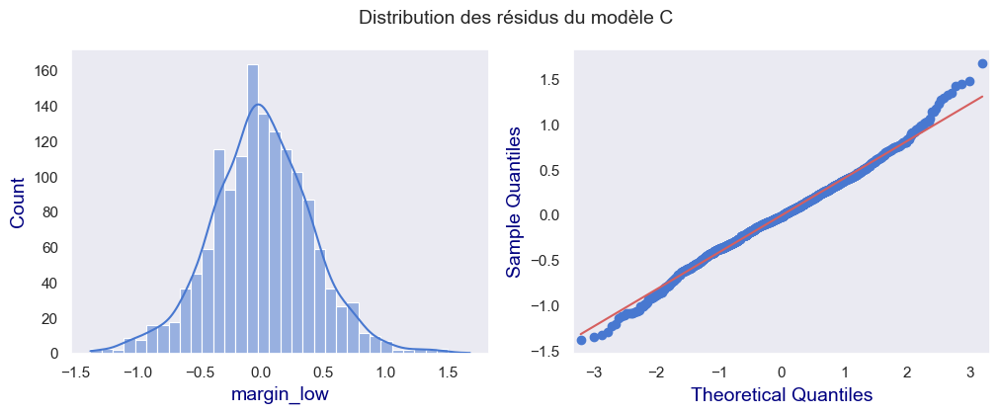

Statistique Shapiro : 0.9937 | p-value : 0.0


In [265]:
# Histogramme + courbe KDE +QQPLot

fig, (a,b) = plt.subplots(nrows=1, ncols=2, figsize=(12, 4))
plt.suptitle("Distribution des résidus du modèle C")

sns.histplot(x=residus_C, kde=True, ax=a)
qqplot(residus_C, line='s', ax=b)

plt.show()

# Test de Shapiro-Wilk
stat, pvalue = stats.shapiro(residus_C)
print(f"Statistique Shapiro : {round(stat, 4)} | p-value : {round(pvalue, 4)}")

Interprétation :  
p-value > 0.05 → H₀ non rejetée → les résidus sont compatibles avec une distribution normale.  
p-value < 0.05 → H₀ rejetée → les résidus ne suivent pas une distribution normale.

Le test est sensible à la taille de l’échantillon : avec un grand n, une légère déviation de la normalité peut déjà donner une p-value faible. D’où l’intérêt aussi du graphique KDE.

**OBSERVATION :**  
visuellement la distribution pourrait suivre une loie Normale,  
mais statistiquement ce n'est pas le cas avec p-value <<0.05 .  
**=>les résidus ne suivent pas une loi normale**

<font color='orange'><u>**PAS D'AMELIORATION AVEC MODELE C**</u></font>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 3C.4.3 - Homoscédasticité des résidus </h4>
</div>

But : Vérifier que la variance des erreurs reste constante quelle que soit la valeur prédite.

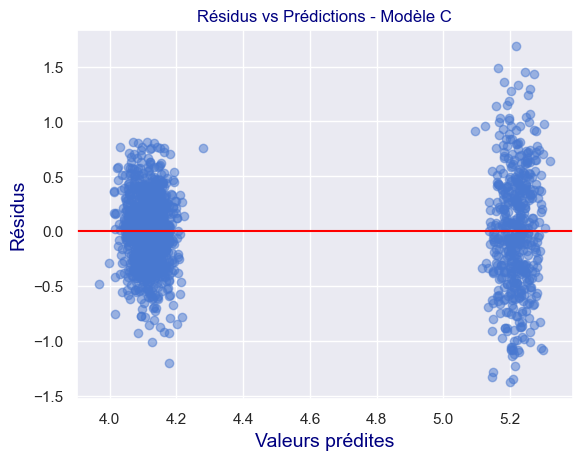

In [266]:
plt.scatter(y_pred_C, residus_C, alpha=0.5)
plt.axhline(0, color='red')
plt.xlabel("Valeurs prédites")
plt.ylabel("Résidus")
plt.title("Résidus vs Prédictions - Modèle C")
plt.grid(True)
plt.show()

**Interprétation :**  
Si les résidus sont répartis de manière homogène autour de 0   
Si on observe un entonnoir (variance croissante/décroissante) ou un motif → il y a hétéroscédasticité, ce qui peut biaiser les intervalles de confiance et tests.  

Ici on a une répartition de part et d'autre cela semblerait ok.  
Cependant on a tout de m^mee de forme détachée avec une pente.

**OBSERVATION :**  
Les Résidus sont plutôt répartis de manière homogène autour de zéro.  
**=> Homoscédasticité des résidus**

<font color='orange'><u>**VARIATION AVEC MODELE C**</u></font>  
Les résidus sont autour de zéro, mais on voit qu'on a2 types de valeurs pour les y_pred_C , et que ce qui différencie les 2 doit être le fait d'être faux ou non.

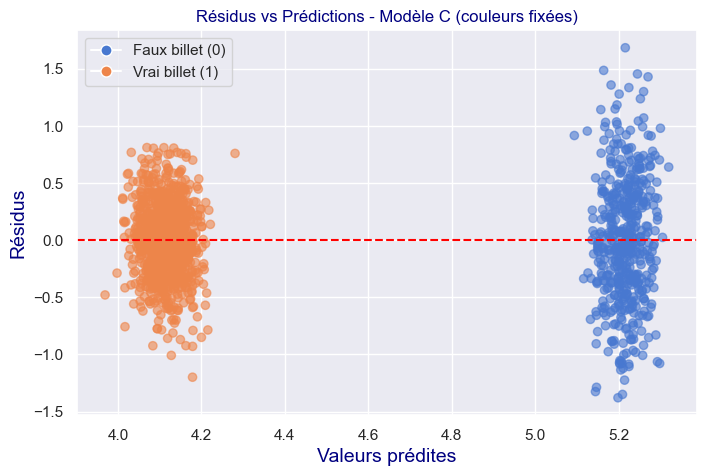

In [267]:
# Récupération de la variable is_genuine pour les mêmes index que y_pred_C
is_genuine_C = df_known.loc[X_C.index, 'is_genuine']

# Appliquer la palette aux points
colors = [palette_fixe_genuine[val] for val in is_genuine_C]

# Tracer le graphe
plt.figure(figsize=(8, 5))
plt.scatter(y_pred_C, residus_C, c=colors, alpha=0.6)

plt.axhline(0, color='red', linestyle='--')
plt.xlabel("Valeurs prédites")
plt.ylabel("Résidus")
plt.title("Résidus vs Prédictions - Modèle C (couleurs fixées)")
plt.grid(True)

# Légende
from matplotlib.lines import Line2D
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='Faux billet (0)',
           markerfacecolor=palette_fixe_genuine[0], markersize=8),
    Line2D([0], [0], marker='o', color='w', label='Vrai billet (1)',
           markerfacecolor=palette_fixe_genuine[1], markersize=8)
]
plt.legend(handles=legend_elements)

plt.show()

<u>**MESURE DE L'HOMOSCEDASTICITE DES RESIDUS :**</u>  
Tester si : Les résidus du modèle ont une variance constante quelle que soit la valeur des prédicteurs.  
H₀ (hypothèse nulle) : Homoscédasticité (variance constante des résidus)  
H₁ (hypothèse alternative) : Hétéroscédasticité (variance non constante)  

1. Test de Breusch-Pagan (le plus courant)  
2. Test de White (plus général, robuste)

Conditions d'application :
1. Modèle linéaire correctement spécifié =>OK  
2. Résidus du modèle bien calculés =>OK  
3. Pas trop de multicolinéarité entre les variables explicatives =>OK  
4. Données numériques et sans valeurs manquantes =>OK  
5. Nombre d’observations suffisant (>30) =>OK  

Remarque :  la normalité des résidus n’est pas une condition préalable
Le test de Breusch-Pagan ne suppose pas que les résidus soient normalement distribués.
Ce n’est pas une condition obligatoire, mais si les résidus sont fortement asymétriques ou présentent des outliers extrêmes, cela peut affecter les performances du test.  
(ce n'est pas le cas ici)

**1. Test de Breusch-Pagan (le plus courant)**

In [268]:
#Test de Breusch-Pagan (le plus courant)
from statsmodels.stats.diagnostic import het_breuschpagan
#import statsmodels.api as sm

# Ajout de la constante à X
X_const_C = sm.add_constant(X_C)

# Calcul des résidus
#residus_C = y_C - reg_C.predict(X_C)=>déjà fait

# Test de Breusch-Pagan
bp_test = het_breuschpagan(residus_C, X_const_C)

# Résultat du test
bp_labels = ['Statistique', 'p-value', 'f-stat', 'f p-value']
for name, value in zip(bp_labels, bp_test):
    print(f"{name} : {value:.4f}")

Statistique : 164.2462
p-value : 0.0000
f-stat : 61.5039
f p-value : 0.0000


**Interprétation :**  
- Si la p-value < 0.05, on rejette l’hypothèse H₀ : les résidus ne sont pas homoscédastiques (donc problème d’hétéroscédasticité).  
- Si la p-value > 0.05, on ne rejette pas H₀ : les résidus peuvent être considérés comme homoscédastiques (ce qu’on veut).

**OBSERVATION :**  
p-value proche de 0 
Rejet de H₀ → Présence d’hétéroscédasticité dans le modèle.  
Autrement dit, les résidus n'ont pas une variance constante, ce qui viole une des hypothèses fondamentales de la régression linéaire.  
**homoscédastiques KO : la variance des erreurs n'est pas constante ici**

<font color='orange'><u>**PAS D'AMELIORATION AVEC MODELE C**</u></font>

**2. Test de White (plus général, robuste)**

In [269]:
#MESURE DE L'HOMOSCEDASTICITE DES RESIDUS : Test de White (plus général, robuste)
from statsmodels.stats.diagnostic import het_white

# Ajout de la constante à X
X_const_C = sm.add_constant(X_C)

white_test = het_white(residus_C, X_const_C)

labels_white = ['Statistique LM', 'p-value', 'Stat F', 'p-value F']
for name, val in zip(labels_white, white_test):
    print(f"{name} : {val}")

Statistique LM : 168.1379538682902
p-value : 3.1670214737765936e-32
Stat F : 23.600253947402635
p-value F : 2.877456749888857e-34


**Interprétation :**  
Statistique LM : Statistique de Lagrange multiplier  
p-value (associée à LM) : si elle est < 0.05, on rejette H₀  
Statistique F : test F auxiliaire  
p-value F : interprétation identique
  
- Si la p-value < 0.05, on rejette l’hypothèse H₀ : les résidus ne sont pas homoscédastiques (donc problème d’hétéroscédasticité).  
- Si la p-value > 0.05, on ne rejette pas H₀ : les résidus peuvent être considérés comme homoscédastiques (ce qu’on veut).

**OBSERVATION :**  
p-value proche de 0 
Rejet de H₀ → Présence d’hétéroscédasticité dans le modèle.  
Autrement dit, les résidus n'ont pas une variance constante, ce qui viole une des hypothèses fondamentales de la régression linéaire.  
**homoscédastiques KO : la variance des erreurs n'est pas constante ici**

<font color='orange'><u>**PAS D'AMELIORATION AVEC MODELE C**</u></font>

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 3ABC - BILAN  </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3ABC.1 - SCORE de Performance  </h3>
</div>

<u>**INTERPRETATIONS**</u>

<u>**1. Amélioration du R²**</u>  
Nous passons de :  
R² = 0.47 (modèle A)  
à R² = 0.62 (modèle C)  
=> +15 points de pourcentage => meilleure part de variance expliquée.

Cela signifie que l'ajout de la variable is_genuine permet de capturer une information structurante pour prédire margin_low.  

<u>**2. Baisse des erreurs**</u>  
Nous avons aussi :  
RMSE réduit de 0.48 => 0.41  
MAPE réduit de 8.3% => 7%  
=> Les prédictions sont plus précises, en valeur absolue et relative.


**SYNTHESE :**  
La variable is_genuine, bien que binaire, apporte une valeur explicative significative.  
Cela valide le choix d’inclure une variable qualitative dans un modèle de régression linéaire, à condition qu’elle soit encodée numériquement (0/1).  
Le fait que le modèle soit plus performant indique que l’authenticité du billet joue un rôle direct sur la marge basse (margin_low).  

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3ABC.1 - Pas de vérification de certaines hypothèses  </h3>
</div>

<u>**INTERPRETATIONS**</u>

**Colinéarité :**  
VIF<5 =>OK pas de colinéarité des var predictives  

**Normalité des résidus :**  
Shapiro p < 0.0 => Pas de Normalité des résidus (malgré une apprence Normale)  

**Homoscédasticité :**  
Breusch-Pagan p < 0.05   
White p < 0.05  
=> Hétéroscédasticité confirmée


**Interprétation**  
Ces tests sont là pour valider les conditions d’inférence statistique :
- Intervalle de confiance sur les coefficients  
- Tests de significativité des variables  

Ce qui n'est pas ce qui nous intéresse réllement ici.

Si nous utilisonss notre modèle à des fins prédictives uniquement ( pour estimer margin_low sur des données manquantes), nous pouvons continuer à l’utiliser tel quel, car les performances sont bonnes.

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3ABC.3 - Synthèse</h3>
</div>

Dans notre cas nous utilisonss notre modèle à des fins prédictives uniquement (pour estimer margin_low sur des données manquantes).  
Compte tenu des bons scores de performance, nous pouvons utiliser notre modèle C car les performances sont bonnes :  
R² = 0.62 (modèle C)  
MAPE réduit de 8.3% => 7%  

In [270]:
#si on choisit de remplir df_billets_analyse_1_1_Cnum avec les valeurs calculées
#df_billets_analyse_1_1_Cnum.loc[df_missing.index, 'margin_low'] = reg.predict(X_missing_C)
#ou idem :
##df_billets_analyse_1_1_Cnum.loc[df_missing.index, 'margin_low'] = y_missing_pred_C

In [271]:
df_billets_analyse_1_2 = df_billets_analyse_1_1.copy(deep=True)

In [272]:
Premieres_Analyses(df_billets_analyse_1_2)


---- SHAPE ----


(1500, 7)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500 entries, 0 to 1499
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   is_genuine    1500 non-null   bool   
 1   diagonal      1500 non-null   float64
 2   height_left   1500 non-null   float64
 3   height_right  1500 non-null   float64
 4   margin_low    1463 non-null   float64
 5   margin_up     1500 non-null   float64
 6   length        1500 non-null   float64
dtypes: bool(1), float64(6)
memory usage: 71.9 KB

---- DESCRIBE ----


,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.000000,1500.000000,1500.000000,1463.000000,1500.000000,1500.00000
mean,171.958440,104.029533,103.920307,4.485967,3.151473,112.67850
std,0.305195,0.299462,0.325627,0.663813,0.231813,0.87273
min,171.040000,103.140000,102.820000,2.980000,2.270000,109.49000
25%,171.750000,103.820000,103.710000,4.015000,2.990000,112.03000
50%,171.960000,104.040000,103.920000,4.310000,3.140000,112.96000
75%,172.170000,104.230000,104.150000,4.870000,3.310000,113.34000
max,173.010000,104.880000,104.950000,6.900000,3.910000,114.44000



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1463,37,285,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


<font color='orange'><u>**Remplaçons les valeurs manquantes de margin_low avec la Regression linéaire basée sur notre modèle C :**</u></font>  
var_pred_C = ['is_genuine', 'margin_up', 'height_right']

In [273]:
#Remplaçons les valeurs manquantes de margin_low avec la Regression linéaire basée sur notre modèle C
df_billets_analyse_1_2.loc[df_missing.index, 'margin_low'] = reg_C.predict(X_missing_C)

In [274]:
Premieres_Analyses(df_billets_analyse_1_2)


---- SHAPE ----


(1500, 7)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500 entries, 0 to 1499
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   is_genuine    1500 non-null   bool   
 1   diagonal      1500 non-null   float64
 2   height_left   1500 non-null   float64
 3   height_right  1500 non-null   float64
 4   margin_low    1500 non-null   float64
 5   margin_up     1500 non-null   float64
 6   length        1500 non-null   float64
dtypes: bool(1), float64(6)
memory usage: 71.9 KB

---- DESCRIBE ----


,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.00000
mean,171.958440,104.029533,103.920307,4.482858,3.151473,112.67850
std,0.305195,0.299462,0.325627,0.659857,0.231813,0.87273
min,171.040000,103.140000,102.820000,2.980000,2.270000,109.49000
25%,171.750000,103.820000,103.710000,4.027500,2.990000,112.03000
50%,171.960000,104.040000,103.920000,4.310000,3.140000,112.96000
75%,172.170000,104.230000,104.150000,4.870000,3.310000,113.34000
max,173.010000,104.880000,104.950000,6.900000,3.910000,114.44000



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1500,0,322,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">3ABC.4 - Vérification des outliers</h3>
</div>

##### **Analyse des valeurs extrêmes à partir des ratios IQR :**  

méthode pour détecter les valeurs aberrantes en utilisant des ratios basés sur l’écart interquartile (IQ) :  

Formule :  
IQ = Q3-Q1  
'min-Q1/IQ' = (Q1-min)/IQ  
'Q3-max/IQ' = (max-Q3)/IQ  

Ces rapports permettent de détecter des valeurs potentiellement aberrantes (outliers) selon les **règles de Tukey** .

**Règle de Tukey (règle des 1.5 * IQ)**
Selon cette règle classique :

Un point est considéré comme un outlier modéré s’il est en dehors de l’intervalle :
[Q1-1,5IQR , Q3+1,5IQR]

Autrement dit :
- Si (Q1-min)/IQ  >1.5 ou (max-Q3)/IQ  >1.5 => il peut y avoir des outliers modérés.
- Si le ratio dépasse 3, on considère plutôt des outliers sévères.

In [275]:
df_billets_analyse_1_2.describe()

,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.00000
mean,171.958440,104.029533,103.920307,4.482858,3.151473,112.67850
std,0.305195,0.299462,0.325627,0.659857,0.231813,0.87273
min,171.040000,103.140000,102.820000,2.980000,2.270000,109.49000
25%,171.750000,103.820000,103.710000,4.027500,2.990000,112.03000
50%,171.960000,104.040000,103.920000,4.310000,3.140000,112.96000
75%,172.170000,104.230000,104.150000,4.870000,3.310000,113.34000
max,173.010000,104.880000,104.950000,6.900000,3.910000,114.44000


In [276]:
df_temp= df_billets_analyse_1_2.describe().T
display(df_temp)

,count,mean,std,min,25%,50%,75%,max
diagonal,1500.0,171.958440,0.305195,171.04,171.7500,171.96,172.17,173.01
height_left,1500.0,104.029533,0.299462,103.14,103.8200,104.04,104.23,104.88
height_right,1500.0,103.920307,0.325627,102.82,103.7100,103.92,104.15,104.95
margin_low,1500.0,4.482858,0.659857,2.98,4.0275,4.31,4.87,6.90
margin_up,1500.0,3.151473,0.231813,2.27,2.9900,3.14,3.31,3.91
length,1500.0,112.678500,0.872730,109.49,112.0300,112.96,113.34,114.44


In [277]:
df_temp['IQ']=df_temp['75%']-df_temp['25%']
df_temp['min-Q1/IQ']= (df_temp['25%'] -df_temp['min'])/df_temp['IQ']
df_temp['Q3-max/IQ']= (df_temp['max'] -df_temp['75%'])/df_temp['IQ']
display(df_temp)

,count,mean,std,min,25%,50%,75%,max,IQ,min-Q1/IQ,Q3-max/IQ
diagonal,1500.0,171.958440,0.305195,171.04,171.7500,171.96,172.17,173.01,0.4200,1.690476,2.000000
height_left,1500.0,104.029533,0.299462,103.14,103.8200,104.04,104.23,104.88,0.4100,1.658537,1.585366
height_right,1500.0,103.920307,0.325627,102.82,103.7100,103.92,104.15,104.95,0.4400,2.022727,1.818182
margin_low,1500.0,4.482858,0.659857,2.98,4.0275,4.31,4.87,6.90,0.8425,1.243323,2.409496
margin_up,1500.0,3.151473,0.231813,2.27,2.9900,3.14,3.31,3.91,0.3200,2.250000,1.875000
length,1500.0,112.678500,0.872730,109.49,112.0300,112.96,113.34,114.44,1.3100,1.938931,0.839695


**CONCLUSION :**  
**Les valeurs sont raisonnables :**
- Nos ratios sont tous < 2.5 (<3), ce qui indique seulement des outliers modérés.  
**=> Il n’y a aucune raison immédiate d’exclure ces données.**

In [278]:
#le même dataframe avec la colonne isgenuine en numérique
#Convertissons les True/false en 0 et 1 dans df_billets_analyse_1_2_Cnum
df_billets_analyse_1_2_Cnum = df_billets_analyse_1_2.copy(deep=True)
df_billets_analyse_1_2_Cnum["is_genuine"] = df_billets_analyse_1_2_Cnum["is_genuine"].astype(int)

In [279]:
df_billets_analyse_1_2_Cnum.head()

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,1,171.81,104.86,104.95,4.52,2.89,112.83
1,1,171.46,103.36,103.66,3.77,2.99,113.09
2,1,172.69,104.48,103.50,4.40,2.94,113.16
3,1,171.36,103.91,103.94,3.62,3.01,113.51
4,1,171.73,104.28,103.46,4.04,3.48,112.54


<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 4base -ACP-  Analyse en Composante Principale  </h2>
</div>

In [280]:
df_billets_analyse_1_2.head(2)

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">4base.1-ACP- Préparation </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4base.1.1-ACP-Imports  : </h4>
</div>

**IMPORTS**

In [281]:
#IMPORT DES LIBRAIRIES GRAPHIQUES :

#import matplotlib.pyplot as plt #DEJA IMPORTE
from matplotlib.collections import LineCollection
#import seaborn as sns #DEJA IMPORTE
#import plotly.express as px #

In [282]:
#IMPORT DES LIBRAIRIES TECHNIQUES et STATISTIQUES

#import pandas as pd #DEJA IMPORTE
#import numpy as np #DEJA IMPORTE
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4base.1.2-ACP-Fonction pour ACP  : </h4>
</div>

In [283]:
#Pour le graphe des correlations : 

def correlation_graph(pca, 
                      x_y, 
                      features) : 
    """Affiche le cercle des correlations projetées sur les 2 composantes choisies,  
    c'est à dire la projection des vecteurs originaux, dans le plan constitué des 2 Axes principaux choisis

    Positional arguments : 
    -----------------------------------
    pca : sklearn.decomposition.PCA : notre objet PCA qui a été fit
    x_y : list ou tuple : le couple x,y des plans à afficher, exemple [0,1] pour F1, F2
    features : list ou tuple : la liste des features (ie des dimensions) à représenter
    """

    # Extrait x et y 
    x,y=x_y

    # Taille de l'image (en inches)
    fig, ax = plt.subplots(figsize=(8, 7))

    # Pour chaque composante : 
    for i in range(0, pca.components_.shape[1]):

        # Les flèches
        ax.arrow(0,0, 
                pca.components_[x, i],  
                pca.components_[y, i],  
                head_width=0.07,
                head_length=0.07, 
                width=0.02, )

        # Les labels
        plt.text(pca.components_[x, i] + 0.05,
                pca.components_[y, i] + 0.05,
                features[i])
        
    # Affichage des lignes horizontales et verticales
    plt.plot([-1, 1], [0, 0], color='grey', ls='--')
    plt.plot([0, 0], [-1, 1], color='grey', ls='--')

    # Nom des axes, avec le pourcentage d'inertie expliqué
    plt.xlabel('F{} ({}%)'.format(x+1, round(100*pca.explained_variance_ratio_[x],1)))
    plt.ylabel('F{} ({}%)'.format(y+1, round(100*pca.explained_variance_ratio_[y],1)))

    # Titre
    plt.title("Cercle des corrélations (F{} et F{})".format(x+1, y+1))

    # Le cercle 
    an = np.linspace(0, 2 * np.pi, 100)
    plt.plot(np.cos(an), np.sin(an))  # Add a unit circle for scale

    # Axes et display
    plt.axis('equal')
    plt.show(block=False)

In [284]:
#Pour les plans factoriels : 

def display_factorial_planes(   X_projected, 
                                x_y, 
                                pca=None, 
                                labels = None,
                                clusters=None, 
                                alpha=1,
                                figsize=[10,8], 
                                marker="." ):
    """
    Affiche la projection des individus

    Positional arguments : 
    -------------------------------------
    X_projected : np.array, pd.DataFrame, list of list : la matrice des points projetés
    x_y : list ou tuple : le couple x,y des plans à afficher, exemple [0,1] pour F1, F2

    Optional arguments : 
    -------------------------------------
    pca : sklearn.decomposition.PCA : un objet PCA qui a été fit, cela nous permettra d'afficher la variance de chaque composante, default = None
    labels : list ou tuple : les labels des individus à projeter, default = None
    clusters : list ou tuple : la liste des clusters auquel appartient chaque individu, default = None
    alpha : float in [0,1] : paramètre de transparence, 0=100% transparent, 1=0% transparent, default = 1
    figsize : list ou tuple : couple width, height qui définit la taille de la figure en inches, default = [10,8] 
    marker : str : le type de marker utilisé pour représenter les individus, points croix etc etc, default = "."
    """

    # Transforme X_projected en np.array
    X_ = np.array(X_projected)

    # On définit la forme de la figure si elle n'a pas été donnée
    if not figsize: 
        figsize = (7,6)

    # On gère les labels
    if  labels is None : 
        labels = []
    try : 
        len(labels)
    except Exception as e : 
        raise e

    # On vérifie la variable axis 
    if not len(x_y) ==2 : 
        raise AttributeError("2 axes sont demandées")   
    if max(x_y )>= X_.shape[1] : 
        raise AttributeError("la variable axis n'est pas bonne")   

    # on définit x et y 
    x, y = x_y

    # Initialisation de la figure       
    fig, ax = plt.subplots(1, 1, figsize=figsize)

    # On vérifie s'il y a des clusters ou non / sera utilisé poru faire un hue couleur sur le graphique
    c = None if clusters is None else clusters
 
    # Les points    
    # plt.scatter(   X_[:, x], X_[:, y], alpha=alpha, 
    #                     c=c, cmap="Set1", marker=marker)
    sns.scatterplot(data=None, x=X_[:, x], y=X_[:, y], hue=c)

    # Si la variable pca a été fournie, on peut calculer le % de variance de chaque axe 
    if pca : 
        v1 = " ("+ str(round(100*pca.explained_variance_ratio_[x]))  + " %)"
        v2 = " ("+ str(round(100*pca.explained_variance_ratio_[y]))  + " %)"
    else : 
        v1=v2= ''

    # Nom des axes, avec le pourcentage d'inertie expliqué
    ax.set_xlabel(f'F{x+1} {v1}')
    ax.set_ylabel(f'F{y+1} {v2}')

    # Valeur x max et y max
    x_max = np.abs(X_[:, x]).max() *1.1
    y_max = np.abs(X_[:, y]).max() *1.1

    # On borne x et y 
    ax.set_xlim(left=-x_max, right=x_max)
    ax.set_ylim(bottom= -y_max, top=y_max)

    # Affichage des lignes horizontales et verticales
    plt.plot([-x_max, x_max], [0, 0], color='grey', alpha=0.8)
    plt.plot([0,0], [-y_max, y_max], color='grey', alpha=0.8)

    # Affichage des labels des points
    if len(labels) : 
        for i,(_x,_y) in enumerate(X_[:,[x,y]]):
            plt.text(_x, _y+0.05, labels[i], fontsize='14', ha='center',va='center') 

    # Titre et display
    plt.title(f"Projection des individus (sur F{x+1} et F{y+1})")
    plt.axis('equal') #oblige les axes à avoir la même dimension
    plt.show()



<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">4base.2-ACP- DataPréparation </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4base.2.1-ACP-Revue des données  : </h4>
</div>

In [285]:
df_billets_analyse_1_2.head(3)

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09
2,True,172.69,104.48,103.50,4.40,2.94,113.16


In [286]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1( df_billets_analyse_1_2 )

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1500,0,322,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


In [287]:
Premieres_Analyses(df_billets_analyse_1_2)


---- SHAPE ----


(1500, 7)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500 entries, 0 to 1499
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   is_genuine    1500 non-null   bool   
 1   diagonal      1500 non-null   float64
 2   height_left   1500 non-null   float64
 3   height_right  1500 non-null   float64
 4   margin_low    1500 non-null   float64
 5   margin_up     1500 non-null   float64
 6   length        1500 non-null   float64
dtypes: bool(1), float64(6)
memory usage: 71.9 KB

---- DESCRIBE ----


,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.00000
mean,171.958440,104.029533,103.920307,4.482858,3.151473,112.67850
std,0.305195,0.299462,0.325627,0.659857,0.231813,0.87273
min,171.040000,103.140000,102.820000,2.980000,2.270000,109.49000
25%,171.750000,103.820000,103.710000,4.027500,2.990000,112.03000
50%,171.960000,104.040000,103.920000,4.310000,3.140000,112.96000
75%,172.170000,104.230000,104.150000,4.870000,3.310000,113.34000
max,173.010000,104.880000,104.950000,6.900000,3.910000,114.44000



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1500,0,322,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


In [288]:
df_billets_analyse_1_2.columns

Index(['is_genuine', 'diagonal', 'height_left', 'height_right', 'margin_low',
       'margin_up', 'length'],
      dtype='object')

##### Tour complémentaire :

Quel est le % de valeurs manquantes par colonne ? 

In [289]:
df_billets_analyse_1_2.isna().mean()

is_genuine      0.0
diagonal        0.0
height_left     0.0
height_right    0.0
margin_low      0.0
margin_up       0.0
length          0.0
dtype: float64

Y a-t-il des lignes en double ? 

In [290]:
df_billets_analyse_1_2.duplicated().sum()

0

Combien y a-t-il de valeurs différentes par colonne ? 

In [291]:
df_billets_analyse_1_2.nunique()

is_genuine        2
diagonal        159
height_left     155
height_right    170
margin_low      322
margin_up       123
length          336
dtype: int64

##### Fin-Tour complémentaire :

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.2.2 - Data Selection (variables quantitatives) : </h4>
</div>

In [292]:
df_billets_analyse_1_2.head(2)

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09


In [293]:
df_billets_analyse_1_2.shape

(1500, 7)

In [294]:
df_billets_analyse_1_2.dtypes

is_genuine         bool
diagonal        float64
height_left     float64
height_right    float64
margin_low      float64
margin_up       float64
length          float64
dtype: object

In [295]:
#Rappel :
# Liste des variables quantitatives
print(var_quant) 

['diagonal', 'height_left', 'height_right', 'margin_low', 'margin_up', 'length']


In [296]:
quant_vars = var_quant

In [297]:
df_base_quant = (df_billets_analyse_1_2[quant_vars] ).copy(deep=True)
df_base_quant.head()

,diagonal,height_left,height_right,margin_low,margin_up,length
0,171.81,104.86,104.95,4.52,2.89,112.83
1,171.46,103.36,103.66,3.77,2.99,113.09
2,172.69,104.48,103.50,4.40,2.94,113.16
3,171.36,103.91,103.94,3.62,3.01,113.51
4,171.73,104.28,103.46,4.04,3.48,112.54


In [298]:
df_base_quant.shape

(1500, 6)

In [299]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_base_quant)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1500,0,322,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


In [300]:
Premieres_Analyses(df_base_quant)


---- SHAPE ----


(1500, 6)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500 entries, 0 to 1499
Data columns (total 6 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   diagonal      1500 non-null   float64
 1   height_left   1500 non-null   float64
 2   height_right  1500 non-null   float64
 3   margin_low    1500 non-null   float64
 4   margin_up     1500 non-null   float64
 5   length        1500 non-null   float64
dtypes: float64(6)
memory usage: 70.4 KB

---- DESCRIBE ----


,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.00000
mean,171.958440,104.029533,103.920307,4.482858,3.151473,112.67850
std,0.305195,0.299462,0.325627,0.659857,0.231813,0.87273
min,171.040000,103.140000,102.820000,2.980000,2.270000,109.49000
25%,171.750000,103.820000,103.710000,4.027500,2.990000,112.03000
50%,171.960000,104.040000,103.920000,4.310000,3.140000,112.96000
75%,172.170000,104.230000,104.150000,4.870000,3.310000,113.34000
max,173.010000,104.880000,104.950000,6.900000,3.910000,114.44000



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1500,0,322,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


In [301]:
df_base_quant.describe().round(2)

,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.00,1500.00,1500.00,1500.00,1500.00,1500.00
mean,171.96,104.03,103.92,4.48,3.15,112.68
std,0.31,0.30,0.33,0.66,0.23,0.87
min,171.04,103.14,102.82,2.98,2.27,109.49
25%,171.75,103.82,103.71,4.03,2.99,112.03
50%,171.96,104.04,103.92,4.31,3.14,112.96
75%,172.17,104.23,104.15,4.87,3.31,113.34
max,173.01,104.88,104.95,6.90,3.91,114.44


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4base.2.3 - Cleaning non nécessaire : données déjà propres </h4>
</div>

##### **PAS DE VALEURS MANQUANTES =>PAS DE TRAITEMENT :**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4base.2.4 - Data Split : </h4>
</div>

Nous allons ensuite séparer nos données. D'un coté `X_base` la matrice des données : 

In [302]:
#X_base récupère les valeurs de df_base_quant dans un np.array
X_base = df_base_quant.values
#X_base[:5]
pd.DataFrame(X_base).head()

,0,1,2,3,4,5
0,171.81,104.86,104.95,4.52,2.89,112.83
1,171.46,103.36,103.66,3.77,2.99,113.09
2,172.69,104.48,103.50,4.40,2.94,113.16
3,171.36,103.91,103.94,3.62,3.01,113.51
4,171.73,104.28,103.46,4.04,3.48,112.54


In [303]:
X_base.shape

(1500, 6)

Nous enregistrons les index de nos billets dans une variable `names_base` : 

In [304]:
names_base = df_base_quant.index
names_base

RangeIndex(start=0, stop=1500, step=1)

In [305]:
names_base.shape

(1500,)

et nos colonnes, nos features_base, dans une variable `features_base` : 

In [306]:
features_base = df_base_quant.columns
features_base

Index(['diagonal', 'height_left', 'height_right', 'margin_low', 'margin_up',
       'length'],
      dtype='object')

In [307]:
features_base.shape

(6,)

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">4base.3 - PCA </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.3.1 - Scaling : </h4>
</div>

Nous allons scaler (centrer-réduire) notre np.array brut de données X_base :

In [308]:
#instanciation d'un fonction de centrage-reduction notée scaler
scaler_base = StandardScaler()
scaler_base

,copy,True
,with_mean,True
,with_std,True


In [309]:
#préparation de la fonction pour s'adapter au format de nos données X_base (Fitage) :
scaler_base.fit(X_base)

,copy,True
,with_mean,True
,with_std,True


In [310]:
#Centrage -réduction de X_base dans le np.array X_base_scaled :
X_base_scaled = scaler_base.transform(X_base)
pd.DataFrame(X_base_scaled).head(5) #visualisation de X_base_scaled

,0,1,2,3,4,5
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750


##### VISUALISATION de `X_base_scaled` :

In [311]:
type(X_base_scaled)

numpy.ndarray

In [312]:
#Visualisation de X_base_scaled les données centrées réduites
df_X_base_scaled = pd.DataFrame(X_base_scaled) #les données centrées réduites
df_X_base_scaled.columns = features_base
df_X_base_scaled.index = names_base
df_X_base_scaled.head() #les données centrées réduites

,diagonal,height_left,height_right,margin_low,margin_up,length
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750


In [313]:
#(Attention pour std ddf=1 dans describe
df_X_base_scaled.describe().round(2)

,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.00,1500.00,1500.00,1500.00,1500.00,1500.00
mean,-0.00,0.00,-0.00,-0.00,-0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00
min,-3.01,-2.97,-3.38,-2.28,-3.80,-3.65
25%,-0.68,-0.70,-0.65,-0.69,-0.70,-0.74
50%,0.01,0.03,-0.00,-0.26,-0.05,0.32
75%,0.69,0.67,0.71,0.59,0.68,0.76
max,3.45,2.84,3.16,3.66,3.27,2.02


In [314]:
df_X_base_scaled.std(ddof=1).round(2)

diagonal        1.0
height_left     1.0
height_right    1.0
margin_low      1.0
margin_up       1.0
length          1.0
dtype: float64

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4base.3.2 - PCA : </h4>
</div>

Dans un premier temps,  
Nous allons travailler sur 6 composantes principales (pour récupérer toutes les informations des 6 variables initiales) 

In [315]:
#Choix du nombre de composantes principales, sur lesquelles on va projeter :
nb_components_base = 6

On "l'entraine" sur les données scalées : 

In [316]:
#On instancie notre fonction PCA avec le nombre de composantes principales souhaités
pca_base = PCA(n_components=nb_components_base)

In [317]:
#On génère les Axes principaux avec notre jeux de données centré sans réduction: 
#("entrainer" sur les données scalées)
pca_base.fit(X_base_scaled)

,n_components,6
,copy,True
,whiten,False
,svd_solver,'auto'
,tol,0.0
,iterated_power,'auto'
,n_oversamples,10
,power_iteration_normalizer,'auto'
,random_state,None


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.3.3 - Explication de la variance et du scree plot : </h4>
</div>

Intéressons nous maintenant à la variance *captée* par chaque nouvelle composante. Grace à `scikit-learn` on peut utiliser l'attribut `explained_variance_ratio_` : 

In [318]:
pca_base.explained_variance_ratio_

array([0.432084  , 0.16957129, 0.13019859, 0.1182425 , 0.09664199,
       0.05326162])

Ici la 1ère composante *capte* 43% de la variance de nos données initiales, la 2ème 17%, la 3ème 1%, la 4ème 11%, etc...  

<u>**Critère de Kaiser :**</u>  
IL est coutume de s'intéresser aux Composantes principales qui récupère plus de 100%/6 = 16,7% de la variance des données initiales.  
Soit ici les Composantes pricipales F1, et F2.

Enregistrons cela dans une variable : 

In [319]:
scree_base = (pca_base.explained_variance_ratio_*100).round(2)
scree_base

array([43.21, 16.96, 13.02, 11.82,  9.66,  5.33])

Et pour faire une somme cumulée `numpy`dispose de la fonction `cumsum` : 

In [320]:
scree_base_cum = scree_base.cumsum().round(2)
scree_base_cum

array([ 43.21,  60.17,  73.19,  85.01,  94.67, 100.  ])

Définisions ensuite une variable avec la liste de nos 9 composantes : 

In [321]:
x_list_num_axes_tot = range(1, nb_components_base+1)
list(x_list_num_axes_tot)

[1, 2, 3, 4, 5, 6]

In [322]:
list_Fi_tot = [f"F{i}" for i in x_list_num_axes_tot]

In [323]:
list_Fi_tot

['F1', 'F2', 'F3', 'F4', 'F5', 'F6']

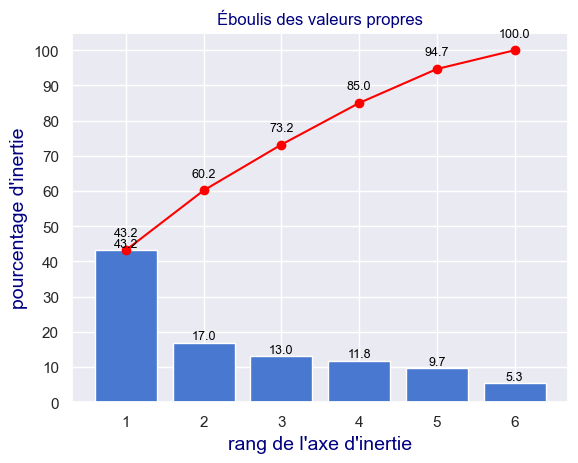

In [324]:
#EBOULIS DES VALEURS PROPRES
#  Affichage des barres
plt.bar(x_list_num_axes_tot, scree_base)

# ➕ Affichage des valeurs sur les barres
for i, val in enumerate(scree_base):
    plt.text(x_list_num_axes_tot[i], val + 0.0, 
             f"{val:.1f}", 
             ha='center', va='bottom', fontsize=9, color='black')

# ➕ Affichage de la courbe
plt.plot(x_list_num_axes_tot, scree_base_cum, c="red", marker='o')

# ➕ Affichage des valeurs sur la courbe
for i, val in enumerate(scree_base_cum):
    plt.text(x_list_num_axes_tot[i], val + 3.0,   # Décalage un peu plus haut que les barres
             f"{val:.1f}", 
             ha='center', va='bottom', fontsize=9, color='black')

# Paramétrage des axes et du titre
plt.xlabel("rang de l'axe d'inertie")
plt.xticks(x_list_num_axes_tot)
plt.yticks(range(0, 105, 10))
plt.ylabel("pourcentage d'inertie")
plt.title("Éboulis des valeurs propres")
plt.grid()
plt.show(block=False)

On a en bleu la variance de chaque nouvelle composante, et en rouge la variance cumulée.

On voit ici que 73% de la variance est prise dans les 3 premières composantes. (85% dans les 4)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 2base.3.4 - Components : </h4>
</div>

Intéressons nous maintenant à nos fameuses composantes. 
Les Composantes principales nous sont donnée par l'attribut `components_`. Cette variable est généralement nommée `pcs` : 

In [325]:
#les vecteurs Axes principaux enf contion des vecteurs originaux
#sur la première ligne on a ce qui compose l'axe F1, en fonction des variables d'origine
#sur la seconde ligne la décomposition de l'axe F2 en fonction des variables d'origine
#PM j'ai l'impression que ça se lit plutôt colonne par colonne
#PM et qu'on a sur la 1ère colonne la décomposition de la variable d'originie sur les axes principaux
#PM et qu'on a sur la 2ème colonne la décomposition de la variable d'originie sur les axes principaux
pcs_base = pca_base.components_
pcs_base

array([[ 0.08485056, -0.33131964, -0.39381947, -0.5066293 , -0.43928124,
         0.52753449],
       [ 0.94131839,  0.3072506 ,  0.10853142, -0.07313375, -0.00440887,
         0.0486795 ],
       [-0.28695617,  0.88480527, -0.1661695 , -0.10684623, -0.27081536,
         0.14968772],
       [-0.10271222, -0.04732994,  0.8664121 , -0.0903465 , -0.4437879 ,
         0.17728494],
       [-0.11732481,  0.10327766,  0.23415241, -0.57093701,  0.70989732,
         0.30136024],
       [ 0.00782988,  0.00613176,  0.00419163,  0.62644275,  0.18102402,
         0.75807869]])

In [326]:
features_base

Index(['diagonal', 'height_left', 'height_right', 'margin_low', 'margin_up',
       'length'],
      dtype='object')

In [327]:
#CALRIFIONS LE RESULTAT/ TRANSFORMONS pcs_base en DF
pcs_base = pd.DataFrame(pcs_base)
pcs_base.columns = features_base
pcs_base.index = list_Fi_tot
pcs_base.round(2)

,diagonal,height_left,height_right,margin_low,margin_up,length
F1,0.08,-0.33,-0.39,-0.51,-0.44,0.53
F2,0.94,0.31,0.11,-0.07,-0.00,0.05
F3,-0.29,0.88,-0.17,-0.11,-0.27,0.15
F4,-0.10,-0.05,0.87,-0.09,-0.44,0.18
F5,-0.12,0.10,0.23,-0.57,0.71,0.30
F6,0.01,0.01,0.00,0.63,0.18,0.76


-- **ATTENTION** -- : Nous avons arrondi les résultats pour simplifier l'analyse

**<u>INTERPRETATIONS des Composantes:</u>**  

`F1` =
-0.53 * length    
+0,51 * margin_low    
+0.44 * margin_up  
+0.39 * height_right  
+0.33 * height_left

**F1 => Vue global hors diagonal (43% de la variance)**  

F2 =  
+0,94 * diagonal  
+0,31 * height_left

**F2 => diagonal (17% de la variance)**


F3 =
0.88 *height_left  

**F3 => height_left  (13% de la variance)**    

F4 =  
...  
**F4 => height_right - margin_up**    

F5 =  
...  
**F5 => margin_up et low**  

F6 =  
...  
**F6 => length**  


Les axes les plus pertinents semblent être F1, et F2.

pour une représentation plus *visuelle*

(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5]),
 [Text(0, 0.5, 'F1'),
  Text(0, 1.5, 'F2'),
  Text(0, 2.5, 'F3'),
  Text(0, 3.5, 'F4'),
  Text(0, 4.5, 'F5'),
  Text(0, 5.5, 'F6')])

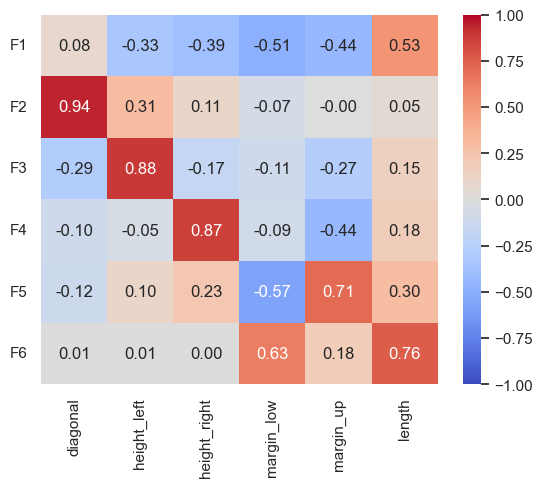

In [328]:
#fig, ax = plt.subplots(figsize=(20, 6))
sns.heatmap(pcs_base, vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f")
plt.yticks(rotation=0)

In [329]:
#Autre visualisation :
pcs_base.T

,F1,F2,F3,F4,F5,F6
diagonal,0.084851,0.941318,-0.286956,-0.102712,-0.117325,0.007830
height_left,-0.331320,0.307251,0.884805,-0.047330,0.103278,0.006132
height_right,-0.393819,0.108531,-0.166170,0.866412,0.234152,0.004192
margin_low,-0.506629,-0.073134,-0.106846,-0.090347,-0.570937,0.626443
margin_up,-0.439281,-0.004409,-0.270815,-0.443788,0.709897,0.181024
length,0.527534,0.048680,0.149688,0.177285,0.301360,0.758079


Text(0.5, 1.0, "Composition des Axes Principaux de l'ACP")

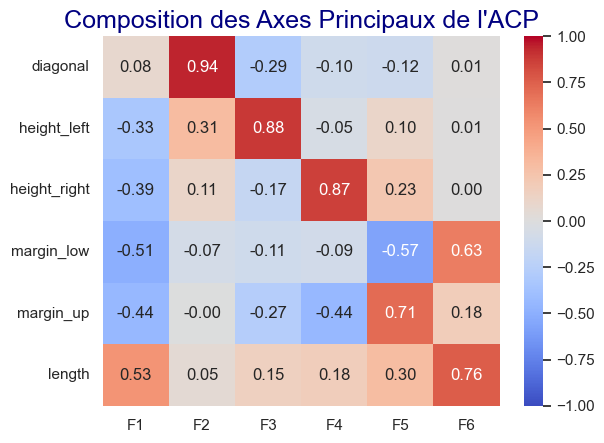

In [330]:
#fig, ax = plt.subplots(figsize=(20, 6))
sns.heatmap(pcs_base.T, vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f")
plt.title("Composition des Axes Principaux de l'ACP",size=18)

##### **Pour Rappel : Corrélation des variables d'origines entre elles :**

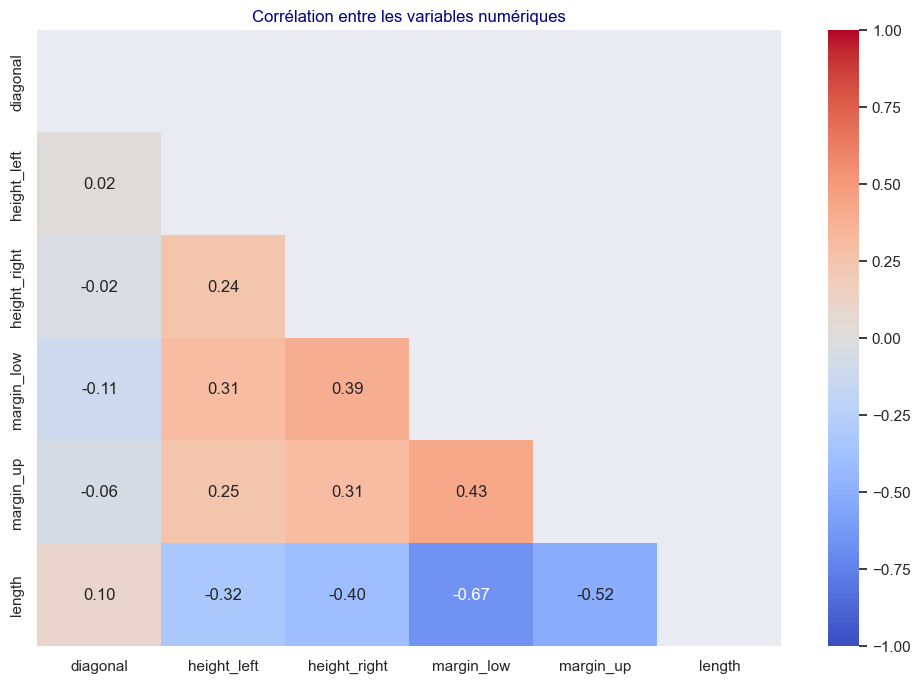

In [331]:
# Visualisation de la Matrice de corrélation

#mask_triangulaire
mask_semi_heatmap = np.triu(np.ones( (df_billets_analyse_1_2[quant_vars].corr(method='pearson')).shape  ))

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(12, 8))
sns.heatmap(df_billets_analyse_1_2[quant_vars].corr(), 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f",
            mask = mask_semi_heatmap
           )
plt.title("Corrélation entre les variables numériques")
plt.grid(visible=False)
plt.show()

Pas de trop grosse corrélation

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4base.3.5 - Graphique de Corrélation : </h4>
</div>

Définissons nos axes x et y. Nous allons utiliser les 2 premières composantes. Comme - en code - on commence à compter à partir de 0, cela nous donne : 

In [332]:
#pour F1 et F2
x,y=0,1

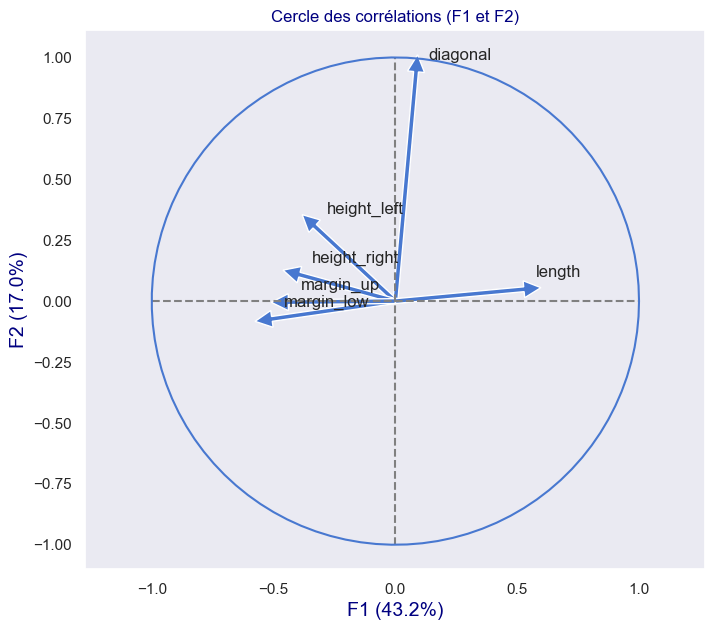

In [333]:
correlation_graph(pca_base, (0,1) , features=df_base_quant.columns)

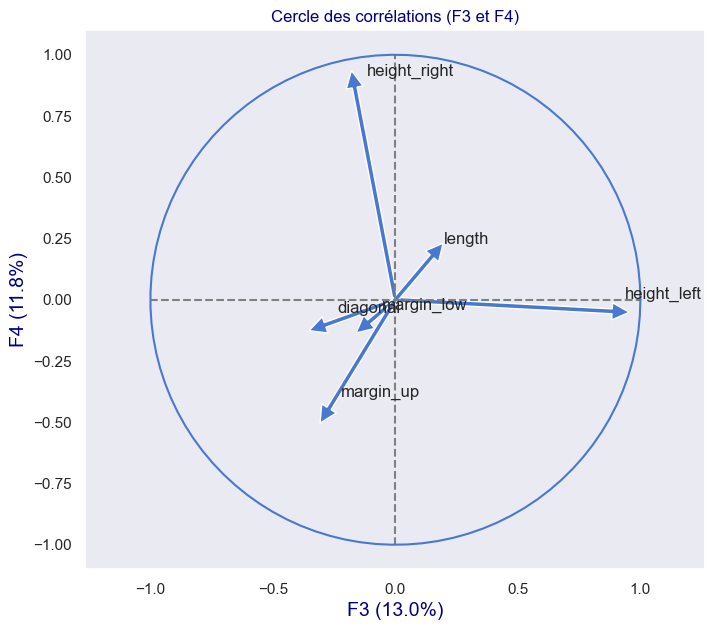

In [334]:
#pour F3 et F4
correlation_graph(pca_base, (2,3) , features=df_base_quant.columns)

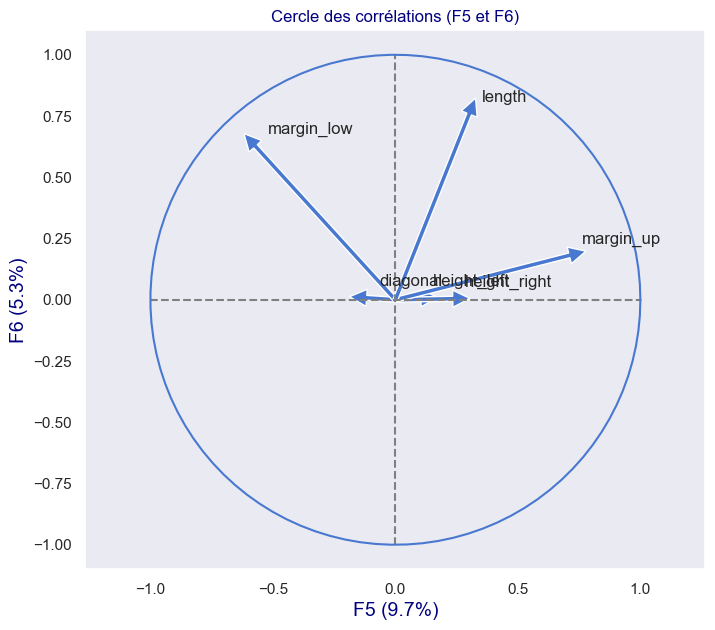

In [335]:
#pour F5 et F6
correlation_graph(pca_base, (4,5) , features=df_base_quant.columns)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4base.3.6 - Projection : </h4>
</div>

Travaillons maintenant sur la projection de nos dimensions. Tout d'abord calculons les coordonnées de nos individus dans le nouvel espace : 

In [336]:
#Visualisation de X_base_scaled les données centrées réduites
df_temp = pd.DataFrame(X_base_scaled) #les données centrées réduites
df_temp.columns = features_base
df_temp.index = names_base
df_temp.head() #les données centrées réduites

,diagonal,height_left,height_right,margin_low,margin_up,length
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750


In [337]:
X_base_scaled.shape

(1500, 6)

In [338]:
#maintenant qu'on a fitté notre méthode pca_base avec 6 axes pricnipaux
#on projette nos données centrés réduites X_base_scaled sur nos 6 axes principaux
X_base_proj = pca_base.transform(X_base_scaled)

In [339]:
#Visualisation de X_base_proj les données projetées sur nos axes principaux
df_temp = pd.DataFrame(X_base_proj) #les données centrées réduites
df_temp.columns = list_Fi_tot
df_temp.index = names_base
df_temp.head() #les données centrées réduites

,F1,F2,F3,F4,F5,F6
0,-1.647418,0.746983,2.394085,3.185780,0.303458,-0.010880
1,2.019727,-2.206758,-1.002436,0.071304,0.037936,-0.475421
2,0.969055,2.619394,1.201073,-0.922033,-0.838040,0.197089
3,1.375705,-1.817760,0.647272,0.830861,0.803723,-0.224999
4,-0.150219,-0.566099,0.854165,-1.784499,1.185021,-0.290944


In [340]:
#Visualisation dans un DF de X_base_proj les données centrées réduites projetées sur nos axes principaux
df_X_base_proj = pd.DataFrame(X_base_proj) #les données centrées réduites projetées sur nos axes principaux
df_X_base_proj.columns = list_Fi_tot
df_X_base_proj.index = names_base
df_X_base_proj.head()

,F1,F2,F3,F4,F5,F6
0,-1.647418,0.746983,2.394085,3.185780,0.303458,-0.010880
1,2.019727,-2.206758,-1.002436,0.071304,0.037936,-0.475421
2,0.969055,2.619394,1.201073,-0.922033,-0.838040,0.197089
3,1.375705,-1.817760,0.647272,0.830861,0.803723,-0.224999
4,-0.150219,-0.566099,0.854165,-1.784499,1.185021,-0.290944


In [341]:
df_X_base_proj.describe().round(2)

,F1,F2,F3,F4,F5,F6
count,1500.00,1500.00,1500.00,1500.00,1500.00,1500.00
mean,0.00,0.00,-0.00,0.00,0.00,0.00
std,1.61,1.01,0.88,0.84,0.76,0.57
min,-4.50,-3.10,-2.60,-3.12,-3.15,-2.05
25%,-1.51,-0.70,-0.58,-0.56,-0.50,-0.35
50%,0.56,0.01,-0.01,-0.00,0.02,0.01
75%,1.24,0.71,0.54,0.55,0.49,0.36
max,3.14,3.79,2.96,3.19,3.17,2.36


In [342]:
#Création d'une palette pour quant_vars
Ordre_qvars = quant_vars.copy()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_qvars = sns.color_palette("muted", len(Ordre_qvars))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_qvars = dict(zip(Ordre_qvars, couleurs_muted_qvars))

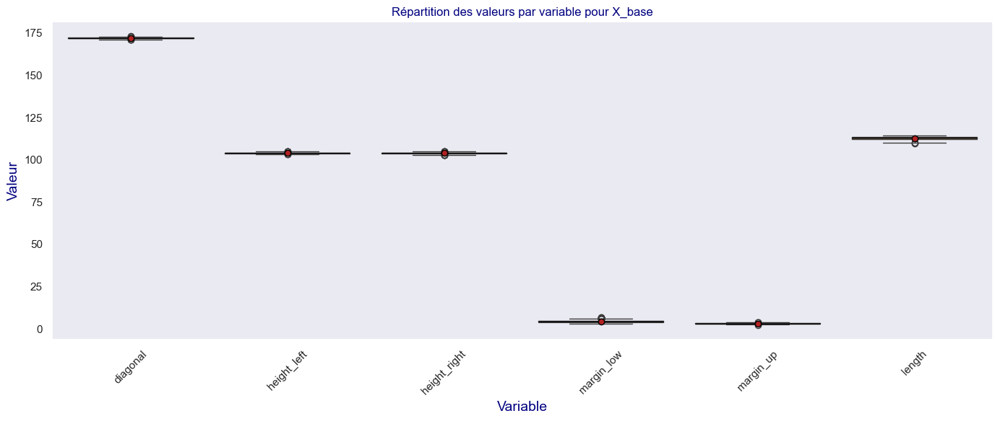

In [343]:
#boxplot de X_base
#import pandas as pd
#import seaborn as sns
#import matplotlib.pyplot as plt

# Reconstruction de X_base en DataFrame à partir des valeurs, index et colonnes
df_temp = pd.DataFrame(X_base, index=names_base, columns=features_base)

# Mise en format long pour seaborn
df_melted = df_temp.reset_index().melt(id_vars='index', var_name='Variable', value_name='Valeur')

# Renommer proprement l'ancienne index (souvent iso3)
#df_melted.rename(columns={'index': 'iso3'}, inplace=True)

# Tracer le boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_melted, 
            x='Variable', 
            y='Valeur',
            hue='Variable',
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
            palette = palette_fixe_qvars,
            hue_order = Ordre_qvars
           )

plt.xticks(rotation=45)
plt.title("Répartition des valeurs par variable pour X_base")
plt.tight_layout()
plt.show()

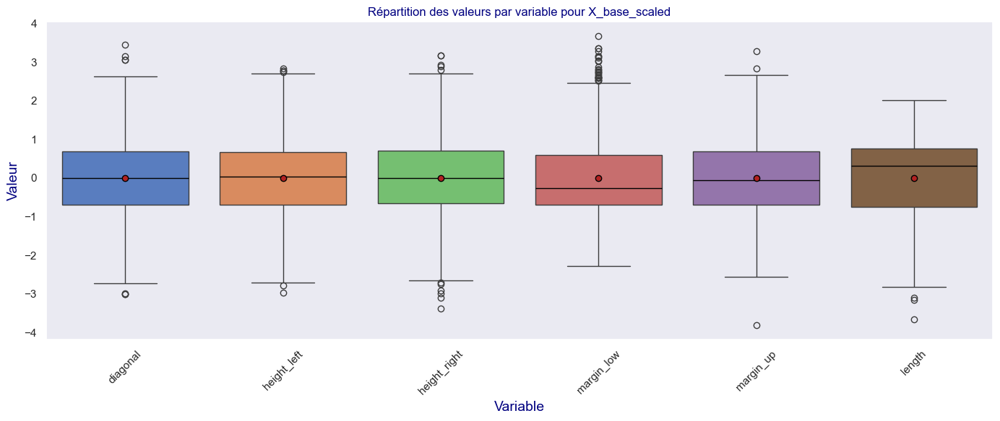

In [344]:
#boxplot de X_base_scaled 
#import pandas as pd
#import seaborn as sns
#import matplotlib.pyplot as plt

# Reconstruction de X_base en DataFrame à partir des valeurs, index et colonnes
df_temp = pd.DataFrame(X_base_scaled, index=names_base, columns=features_base)

# Mise en format long pour seaborn
df_melted = df_temp.reset_index().melt(id_vars='index', var_name='Variable', value_name='Valeur')

# Renommer proprement l'ancienne index (souvent iso3)
#df_melted.rename(columns={'index': 'iso3'}, inplace=True)

# Tracer le boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_melted, 
            x='Variable', 
            y='Valeur',
            hue='Variable',
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
            palette = palette_fixe_qvars,
            hue_order = Ordre_qvars
           )

plt.xticks(rotation=45)
plt.title("Répartition des valeurs par variable pour X_base_scaled")
plt.tight_layout()
plt.show()


In [345]:
#Création d'une palette pour list_Fi_tot
Ordre_Fi = list_Fi_tot.copy()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_Fi = sns.color_palette("muted", len(Ordre_Fi))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_Fi = dict(zip(Ordre_Fi, couleurs_muted_Fi))

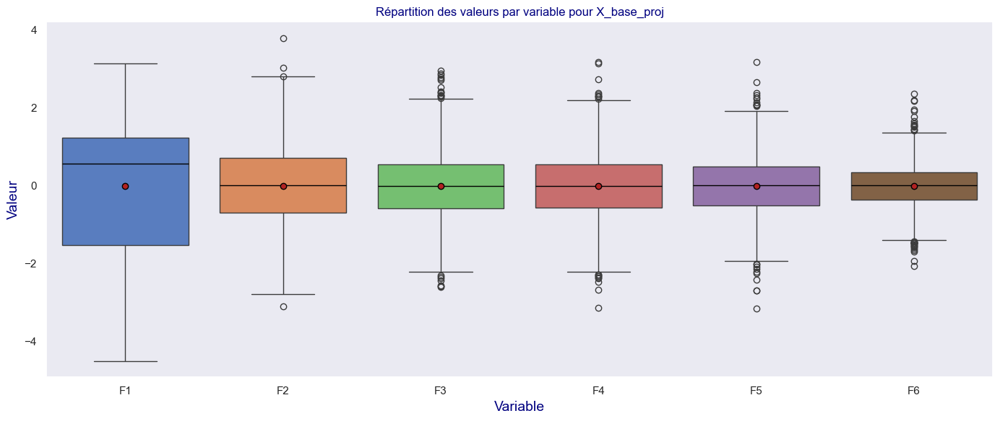

In [346]:
#boxplot de X_base_proj 
#import pandas as pd
#import seaborn as sns
#import matplotlib.pyplot as plt

# Reconstruction de X_base en DataFrame à partir des valeurs, index et colonnes
df_temp = pd.DataFrame(X_base_proj, index=names_base, columns=list_Fi_tot)

# Mise en format long pour seaborn
df_melted = df_temp.reset_index().melt(id_vars='index', var_name='Variable', value_name='Valeur')

# Renommer proprement l'ancienne index (souvent iso3)
#df_melted.rename(columns={'index': 'iso3'}, inplace=True)

# Tracer le boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_melted, 
            x='Variable', 
            y='Valeur',
            hue='Variable',
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
            palette = palette_fixe_Fi,
            hue_order = Ordre_Fi
           )

#plt.xticks(rotation=45)
plt.title("Répartition des valeurs par variable pour X_base_proj")
plt.tight_layout()
plt.show()


##### <font color='blue'>**PROJECTIONS 2D sur les AXES PRINCIPAUX :**</font>

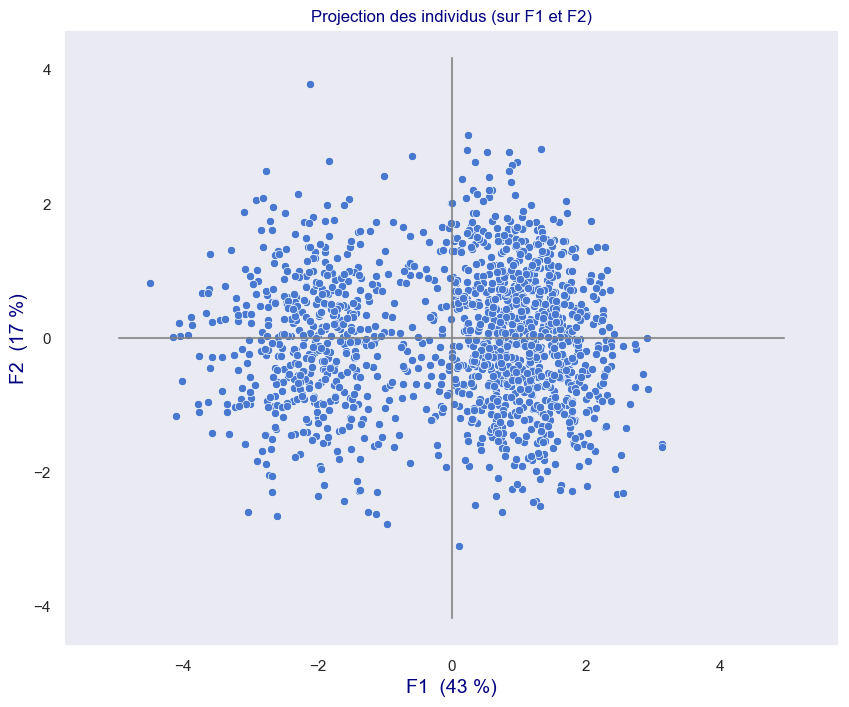

In [347]:
x_y = [0,1] #pour F1 et F2 :
display_factorial_planes(X_base_proj, x_y, pca=pca_base)

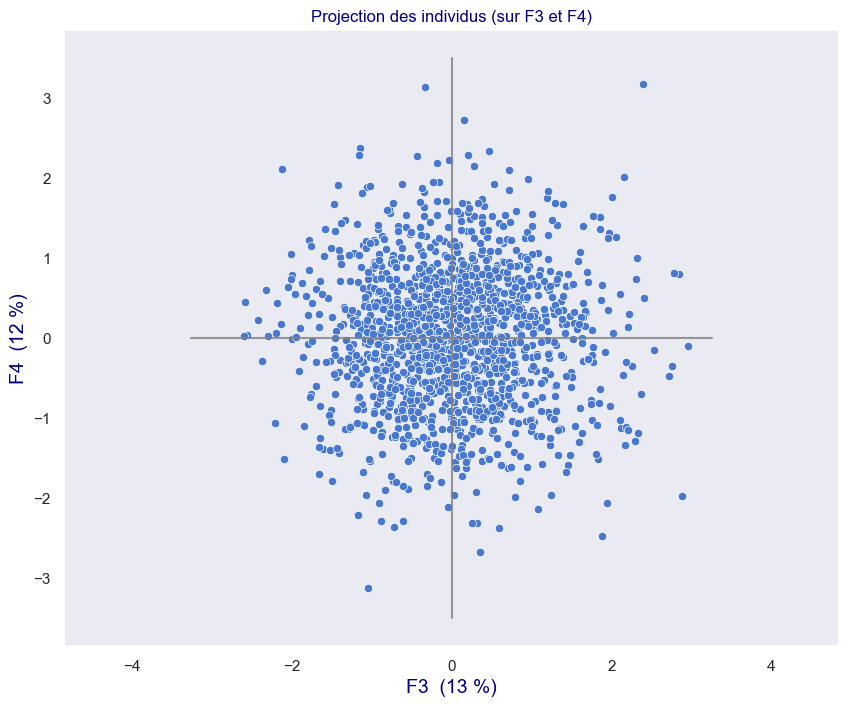

In [348]:
x_y = [2,3] #pour F3 et F4 :
display_factorial_planes(X_base_proj, x_y, pca=pca_base)

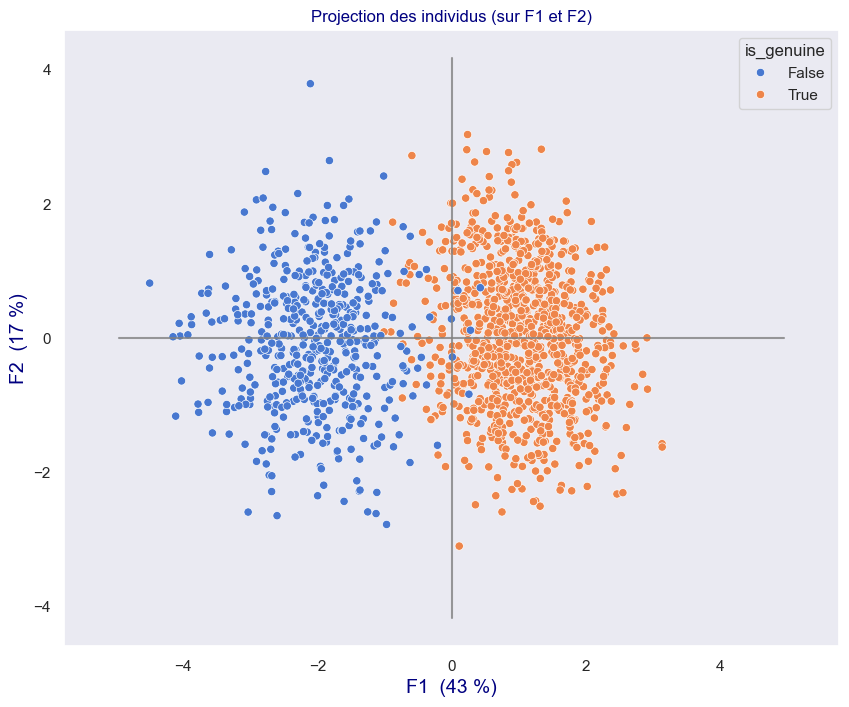

In [349]:
x_y = [0,1] #pour F1 et F2 :
display_factorial_planes(X_base_proj, x_y, pca=pca_base,clusters=df_billets_analyse_1_2['is_genuine'])

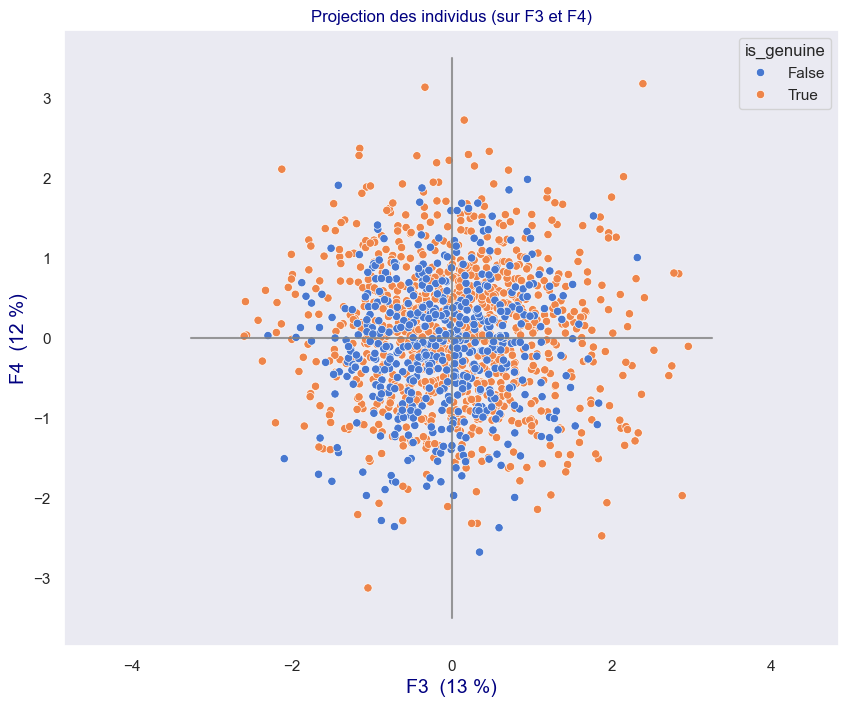

In [350]:
x_y = [2,3] #pour F3 et F4 :
display_factorial_planes(X_base_proj, x_y, pca=pca_base,clusters=df_billets_analyse_1_2['is_genuine'])

**OBSERVATION :**  
On s'apperçoit que l'axe F1 à lui tout seul permet globalement de distinguer les vrais et faux billets !!!

##### <font color='blue'>**PROJECTIONS 3D sur les AXES PRINCIPAUX :**</font>

In [351]:
#Visualisation de X_base_proj les données projetées sur nos axes principaux
df_temp = pd.DataFrame(X_base_proj) #les données centrées réduites
df_temp.columns = list_Fi_tot
df_temp.index = names_base
df_temp.head() #les données centrées réduites

,F1,F2,F3,F4,F5,F6
0,-1.647418,0.746983,2.394085,3.185780,0.303458,-0.010880
1,2.019727,-2.206758,-1.002436,0.071304,0.037936,-0.475421
2,0.969055,2.619394,1.201073,-0.922033,-0.838040,0.197089
3,1.375705,-1.817760,0.647272,0.830861,0.803723,-0.224999
4,-0.150219,-0.566099,0.854165,-1.784499,1.185021,-0.290944


Text(0.5, 0, 'F3')

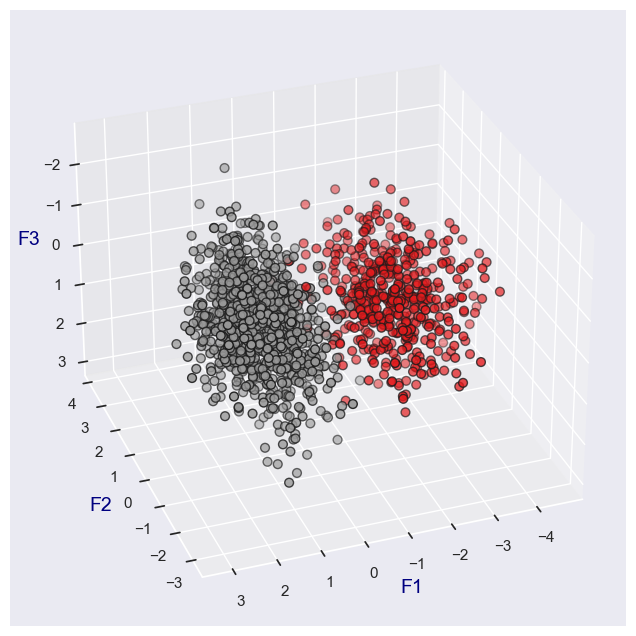

In [352]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(10, 8))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

# On affiche nos points : 
ax.scatter(
    df_temp.iloc[:, 0],
    df_temp.iloc[:, 1],
    df_temp.iloc[:, 2],
    c=df_billets_analyse_1_2['is_genuine'], cmap="Set1", edgecolor="k", s=40)

# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

In [353]:
# Conversion des labels en couleurs
couleurs_points = df_billets_analyse_1_2['is_genuine'].map(palette_fixe_genuine)

In [354]:
from matplotlib.patches import Patch

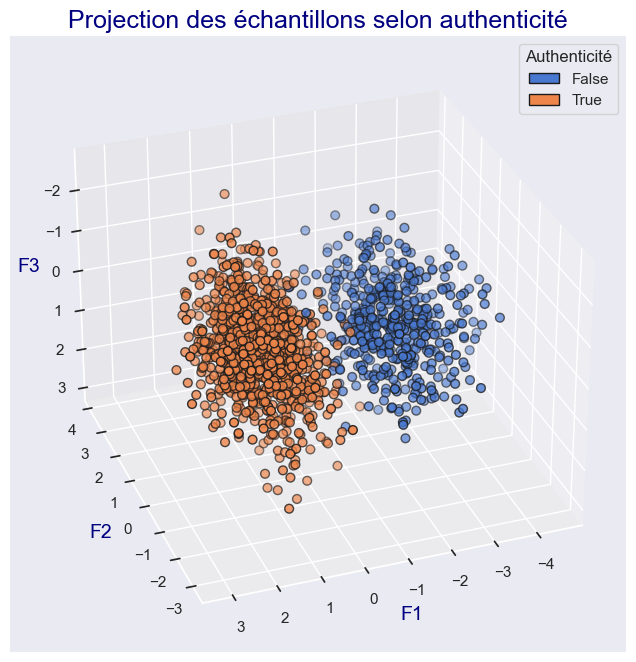

In [355]:
from matplotlib.patches import Patch

# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(10, 8))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

# On affiche nos points : 
ax.scatter(
    df_temp.iloc[:, 0],
    df_temp.iloc[:, 1],
    df_temp.iloc[:, 2],
    c=couleurs_points, 
    edgecolor="k", 
    s=40)

# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

# Légende
legend_elements = [
    Patch(facecolor=palette_fixe_genuine[val], edgecolor='k', label=str(val))
    for val in Ordre_genuine
]
ax.legend(handles=legend_elements, title="Authenticité", loc='upper right')
plt.title("Projection des échantillons selon authenticité",color='navy',size=18)
plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">4base.4 - Réduction de l'Etude aux 3 premières composantes F1, F2, F3 (73% de la variance)</h3>
</div>

##### **BILAN CHOIX DES AXES PRINCIPAUX :**
Selon le Critère de Kaiser, seul F1 et F2 sont suffisamment représentatifs.  

Selon la Variance totale portée, il faut aller jusqu'à F4 poru avoir 85% de la variance.  

Selon les observations, F1 seul semble déjà expliqué une séparation entre les Faux et Vrai billets !

En allant jusqu'à F3, nous avons 73% de la variance expliquée, ce qui est déjà une quantité raisonnable. 

**=> Conservons les axes F1, F2, F3 qui portent 73% de la variance**

In [356]:
df_X_base_proj.head()

,F1,F2,F3,F4,F5,F6
0,-1.647418,0.746983,2.394085,3.185780,0.303458,-0.010880
1,2.019727,-2.206758,-1.002436,0.071304,0.037936,-0.475421
2,0.969055,2.619394,1.201073,-0.922033,-0.838040,0.197089
3,1.375705,-1.817760,0.647272,0.830861,0.803723,-0.224999
4,-0.150219,-0.566099,0.854165,-1.784499,1.185021,-0.290944


In [357]:
df_X_base_proj.shape

(1500, 6)

<u>**SELECTIONS DE COMPONENTS :**</u>  
Pour la suite ne gardons que F1, F2, F3 

In [358]:
nb_components_base_selec =3

In [359]:
x_list_num_axes_tot

range(1, 7)

In [360]:
x_list_num_axes_base_selec = range(1,nb_components_base_selec+1)
print(x_list_num_axes_base_selec)

range(1, 4)


In [361]:
for i in x_list_num_axes_base_selec :
    print(i)

1
2
3


In [362]:
list_Fi_tot

['F1', 'F2', 'F3', 'F4', 'F5', 'F6']

In [363]:
list_Fi_base_selec = list_Fi_tot[:nb_components_base_selec]
list_Fi_base_selec

['F1', 'F2', 'F3']

In [364]:
df_X_base_proj_selec_PCA = df_X_base_proj.loc[:,list_Fi_base_selec].copy(deep=True)
df_X_base_proj_selec_PCA

,F1,F2,F3
0,-1.647418,0.746983,2.394085
1,2.019727,-2.206758,-1.002436
2,0.969055,2.619394,1.201073
3,1.375705,-1.817760,0.647272
4,-0.150219,-0.566099,0.854165
...,...,...,...
1495,-1.428753,-0.270050,0.946514
1496,-3.280778,1.317247,0.615665
1497,-1.888713,-0.600805,-0.545709
1498,-1.789664,0.511028,0.028079


In [365]:
df_X_base_proj_selec_PCA.shape

(1500, 3)

In [366]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_X_base_proj_selec_PCA)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
F1,float64,1500,1500,0,1500,NaN
F2,float64,1500,1500,0,1500,NaN
F3,float64,1500,1500,0,1500,NaN


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">4base.5 - Etude des outliers</h3>
</div>

##### **Recherches des Outliers :**  
On peut rechercher les outliers sur les données d'origine centrées réduites  
ou sur les données projetées F1 à F3( à partir du moment ou les axes sélectionnées représente,t une ceraines quantité de variance.)  
Nos 5 axes portent 73 % de la variance, ce qui permet raisonnablement d'étudier sur les données projetées.  

**Travaillons sur une copie temporaire de `df_X_base_proj_selec_PCA`**

In [367]:
df_temp_etude = df_X_base_proj_selec_PCA.copy()

##### **LES DISTANCES :**

**La `distance euclidienne`** : la distance classique dans un espace vectoriel orthonormé.  

**La `distance de Mahalanobis`** :  
La distance de Mahalanobis mesure la distance entre un point et un groupe (ou une distribution) en tenant compte de la corrélation entre les variables.    
Avantage par rapport à la distance euclidienne :  
Elle corrige les effets d’échelle et de corrélation entre les variables.  
Ainsi, un point qui semble proche selon la distance euclidienne peut être un vrai outlier selon Mahalanobis s’il dévie dans une direction atypique

<u>Quand appliquer la `distance de Mahalanobis` dans un processus de PCA ?</u>  
<u>1. Option 1 : appliquer sur les données brutes (après centrage-réduction)</u>  
✅ Avantage : permet de détecter des outliers avant la réduction de dimension (avec toute l'information).  
⚠️ Inconvénient : les données peuvent être bruitées ou difficiles à interpréter dans un grand espace.  

<u>2. Option 2 : appliquer sur les données projetées sur les premières composantes principales</u>  
✅ Avantage : Travailler dans un espace plus compact, avec les dimensions les plus informatives.  
Cela peut réduire le bruit et faciliter la détection des observations aberrantes.  
⚠️ Inconvénient : Perte de l'information des composantes écartées.  
Mais si 95% de la variance a été conservé, ce risque est limité.  

**=>Nos 3 axes portent 73 % de la variance, ce qui permet raisonnablement d'étudier sur les données projetées.**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4base.5.1 - Outliers : Etude sur les 3 Composantes Principales : : </h4>
</div>

##### <font color ='blue'> **a.CALCUL DES DISTANCES :**</font>

La distance euclidienne

La distance de Mahalanobis

In [368]:
#distance de Mahalanobis
import scipy.spatial.distance as distance

mean = df_temp_etude.mean().values
cov = np.cov(df_temp_etude.values, rowvar=False)
inv_covmat = np.linalg.inv(cov)

# Calcul de la distance de Mahalanobis pour chaque pays
df_temp_etude["mahalanobis"] = df_temp_etude.apply(
    lambda row: distance.mahalanobis(row.values, mean, inv_covmat),
    axis=1
)

# Visualiser les plus extrêmes
df_temp_etude.sort_values("mahalanobis", ascending=False).head(10)


,F1,F2,F3,mahalanobis
1277,-2.104212,3.791073,0.193473,3.983876
491,0.847511,2.766477,2.375907,3.874970
828,0.848391,2.494569,-2.368895,3.683522
636,1.317580,-2.500981,2.295773,3.681738
802,0.677045,-1.320088,2.962049,3.621059
751,0.237526,3.033911,1.581799,3.501920
375,1.175054,-0.837715,2.885889,3.446086
982,1.082782,-1.220484,2.718140,3.371414
401,0.560346,2.408025,2.059553,3.353018
842,1.336176,2.815435,-1.403663,3.315775


In [369]:
df_temp_etude[['mahalanobis']].describe()

,mahalanobis
count,1500.000000
mean,1.620632
std,0.609754
min,0.183721
25%,1.196658
50%,1.550333
75%,1.998337
max,3.983876


<u>Calcul du Seuil  pour êter un outlier selon Mahalanobis :</u>  
La distance de Mahalanobis suit une loi du χ² (chi carré) avec p degrés de liberté, 
où p est le nombre de dimensions

In [370]:
from scipy.stats import chi2
import numpy as np

In [371]:
#Calcul du Seuil  pour êter un outlier :

#from scipy.stats import chi2
#import numpy as np

# p : nombre de dimensions (ex : 4 si tu as F1 à F4)
p = nb_components_base_selec

# Seuil à 97.5% (soit 2.5% de chances d’être un outlier)
threshold = np.sqrt(chi2.ppf(0.975, df=p))
print(f"Seuil de Mahalanobis à 97.5% pour p={p} : {threshold:.2f}")

Seuil de Mahalanobis à 97.5% pour p=3 : 3.06


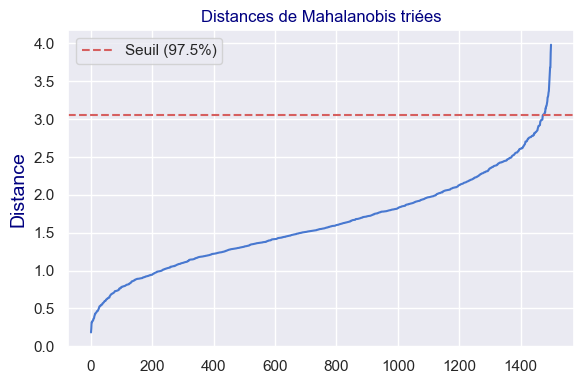

In [372]:
plt.figure(figsize=(6, 4))
plt.plot(df_temp_etude["mahalanobis"].sort_values().values)
plt.axhline(y=threshold, color='r', linestyle='--', label='Seuil (97.5%)')
plt.title("Distances de Mahalanobis triées")
plt.ylabel("Distance")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

PM : si je comprends bien, LA distance est calculée sur les données , en connaissant le nombre de dimensions, de telle sorte que les données soient étalées selon une loi deu chi2, ce qui permet de prévoir à partir de quelle distance on a X% d'individus au delà.  
Il faut donc les étudier car il ya aura toujours X% au delà du seuil fourni, ce qui ne veut pas dire que toutes les valeurs sont des outliers ou qu'il n'y en a pas plus.

In [373]:
df_outliers_base = df_temp_etude[df_temp_etude["mahalanobis"] > threshold]

In [374]:
display(df_outliers_base.sort_values(by=["mahalanobis"],ascending=False))

,F1,F2,F3,mahalanobis
1277,-2.104212,3.791073,0.193473,3.983876
491,0.847511,2.766477,2.375907,3.874970
828,0.848391,2.494569,-2.368895,3.683522
636,1.317580,-2.500981,2.295773,3.681738
802,0.677045,-1.320088,2.962049,3.621059
751,0.237526,3.033911,1.581799,3.501920
375,1.175054,-0.837715,2.885889,3.446086
982,1.082782,-1.220484,2.718140,3.371414
401,0.560346,2.408025,2.059553,3.353018
842,1.336176,2.815435,-1.403663,3.315775


##### Recherche classique de seuil

In [375]:
(df_temp_etude['mahalanobis'].describe())

count    1500.000000
mean        1.620632
std         0.609754
min         0.183721
25%         1.196658
50%         1.550333
75%         1.998337
max         3.983876
Name: mahalanobis, dtype: float64

In [376]:
Q1 = (df_temp_etude['mahalanobis'].describe() )['25%']
Q2 = (df_temp_etude['mahalanobis'].describe() )['50%']
Q3 = (df_temp_etude['mahalanobis'].describe() )['75%']
IQ = Q3-Q1
seuil_bas_outlier = Q1-(1.5*IQ)
seuil_haut_outlier = Q3+(1.5*IQ)

print("l'intervalle interquatile IQ vaut : ",IQ,
      "\nle seuil bas de dsitance en deça duquel on est outliers est : ", round(seuil_bas_outlier,2) ,
      "\nle seuil haut de distance au dessus duquel on est outliers est : ", round(seuil_haut_outlier,2) 
     )

l'intervalle interquatile IQ vaut :  0.8016792507734065 
le seuil bas de dsitance en deça duquel on est outliers est :  -0.01 
le seuil haut de distance au dessus duquel on est outliers est :  3.2


In [377]:
#les outliers :
mask_outlier_mahalanobis = (df_temp_etude['mahalanobis']<seuil_bas_outlier)|(seuil_haut_outlier<df_temp_etude['mahalanobis'])
df_outlier_mahalanobis = df_temp_etude.loc[mask_outlier_mahalanobis,:]
nb_outlier_mahalanobis = len(df_outlier_mahalanobis)
prop_outlier_mahalanobis = (nb_outlier_mahalanobis/len(df_temp_etude))*100

print("Il y a ", nb_outlier_mahalanobis , "billets 'outliers'.",
      "\nCe qui représente ", round(prop_outlier_mahalanobis,2) ," % des billets."
     )

Il y a  14 billets 'outliers'. 
Ce qui représente  0.93  % des billets.


In [378]:
df_outlier_mahalanobis.sort_values(by='mahalanobis',ascending=False)

,F1,F2,F3,mahalanobis
1277,-2.104212,3.791073,0.193473,3.983876
491,0.847511,2.766477,2.375907,3.874970
828,0.848391,2.494569,-2.368895,3.683522
636,1.317580,-2.500981,2.295773,3.681738
802,0.677045,-1.320088,2.962049,3.621059
751,0.237526,3.033911,1.581799,3.501920
375,1.175054,-0.837715,2.885889,3.446086
982,1.082782,-1.220484,2.718140,3.371414
401,0.560346,2.408025,2.059553,3.353018
842,1.336176,2.815435,-1.403663,3.315775


##### Fin Recherche classique de seuil

In [379]:
liste_iso3_outliers_base = list(df_outliers_base.index)
liste_iso3_outliers_base

[45,
 135,
 209,
 230,
 267,
 375,
 401,
 491,
 636,
 665,
 729,
 751,
 802,
 828,
 842,
 965,
 982,
 1022,
 1085,
 1142,
 1254,
 1258,
 1277,
 1310,
 1382,
 1435]

##### **Données des outliers avec les variables originales :**

In [380]:
#**Données avec les variables originales :**
#liste_iso3_outliers_base = list((df_temp_etude.sort_values("mahalanobis", ascending=False).head(10)).index)
mask_temp = df_billets_analyse_1_2.index.isin(liste_iso3_outliers_base)

df_billets_analyse_1_2.loc[mask_temp,:]

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
45,True,171.42,104.65,103.63,3.990000,3.05,113.08
135,True,171.87,104.71,103.85,4.360000,2.71,113.71
209,True,172.23,103.25,103.97,4.010000,3.38,113.90
230,True,172.32,103.22,104.00,4.010000,3.08,112.87
267,True,171.48,103.27,103.42,3.840000,3.04,113.56
375,True,171.54,104.64,103.06,3.540000,3.09,112.82
401,True,172.45,104.72,104.17,4.180000,2.83,113.75
491,True,172.60,104.83,103.56,4.100000,2.94,113.38
636,True,171.13,104.28,103.14,4.160000,2.92,113.00
665,True,172.57,104.65,104.44,4.540000,2.99,113.16


##### **Données des outliers centrées réduites avec les variables originales :**

In [381]:
#**Données centrées réduites avec les variables originales :**
#Attention X_base_scaled est un np.Array

#Visualisation dans un DF de X_base_scaled les données centrées réduites
df_temp_sc = pd.DataFrame(X_base_scaled) #les données centrées réduites
df_temp_sc.columns = features_base
df_temp_sc.index = names_base

#liste_iso3_outliers_base = list((df_temp_etude.sort_values("mahalanobis", ascending=False).head(10)).index)
mask_temp = (df_temp_sc.index).isin(liste_iso3_outliers_base)

df_comp_Outliers_base = df_temp_sc.loc[mask_temp,:]
display(df_comp_Outliers_base)

,diagonal,height_left,height_right,margin_low,margin_up,length
45,-1.764837,2.072631,-0.891828,-0.747166,-0.437884,0.460204
135,-0.289878,2.273057,-0.215984,-0.186252,-1.905072,1.182318
209,0.890088,-2.603984,0.152659,-0.716846,0.986152,1.400098
230,1.185080,-2.704197,0.244820,-0.716846,-0.308426,0.219500
267,-1.568176,-2.537175,-1.536953,-0.974564,-0.481036,1.010386
375,-1.371515,2.039227,-2.642881,-1.429360,-0.265273,0.162189
401,1.611179,2.306462,0.767063,-0.459129,-1.387241,1.228166
491,2.102832,2.673910,-1.106870,-0.580408,-0.912562,0.804068
636,-2.715365,0.836669,-2.397119,-0.489449,-0.998867,0.368507
665,2.004501,2.072631,1.596509,0.086626,-0.696799,0.551901


In [382]:
(df_comp_Outliers_base > 1.0).sum(axis=1)

45      1
135     2
209     1
230     1
267     1
375     1
401     3
491     2
636     0
665     3
729     0
751     3
802     1
828     1
842     2
965     1
982     1
1022    2
1085    2
1142    1
1254    2
1258    3
1277    3
1310    3
1382    4
1435    5
dtype: int64

In [383]:
df_temp_2 = df_comp_Outliers_base.copy(deep=True)

Je vais choisir un seuil arbitrairement 4.0 ,  
qui représente donc des données éloigné de plus de 3 écart type par rappor tà la moyenne.  
pour décider des outliers hors norme.

In [384]:
# Nombres de scores supérieurs à 3
#valeur_selec = round(seuil2,2)
valeur_selec = 3

df_temp_2[f"Nb Score >{valeur_selec} ou <-{valeur_selec}"] = ((df_temp_2[quant_vars] > valeur_selec).sum(axis=1) +
                                          (df_temp_2[quant_vars] < (-1* valeur_selec)).sum(axis=1) )

#df_temp[f"Nb Score >{valeur_selec}"]
display(df_temp_2)

,diagonal,height_left,height_right,margin_low,margin_up,length,Nb Score >3 ou <-3
45,-1.764837,2.072631,-0.891828,-0.747166,-0.437884,0.460204,0
135,-0.289878,2.273057,-0.215984,-0.186252,-1.905072,1.182318,0
209,0.890088,-2.603984,0.152659,-0.716846,0.986152,1.400098,0
230,1.185080,-2.704197,0.244820,-0.716846,-0.308426,0.219500,0
267,-1.568176,-2.537175,-1.536953,-0.974564,-0.481036,1.010386,0
375,-1.371515,2.039227,-2.642881,-1.429360,-0.265273,0.162189,0
401,1.611179,2.306462,0.767063,-0.459129,-1.387241,1.228166,0
491,2.102832,2.673910,-1.106870,-0.580408,-0.912562,0.804068,0
636,-2.715365,0.836669,-2.397119,-0.489449,-0.998867,0.368507,0
665,2.004501,2.072631,1.596509,0.086626,-0.696799,0.551901,0


In [385]:
# Nombres de scores supérieurs à 4
#valeur_selec = round(seuil2,2)
valeur_selec = 4

df_temp_2[f"Nb Score >{valeur_selec} ou <-{valeur_selec}"] = ((df_temp_2[quant_vars] > valeur_selec).sum(axis=1) +
                                          (df_temp_2[quant_vars] < (-1* valeur_selec)).sum(axis=1) )

#df_temp[f"Nb Score >{valeur_selec}"]
display(df_temp_2)

,diagonal,height_left,height_right,margin_low,margin_up,length,Nb Score >3 ou <-3,Nb Score >4 ou <-4
45,-1.764837,2.072631,-0.891828,-0.747166,-0.437884,0.460204,0,0
135,-0.289878,2.273057,-0.215984,-0.186252,-1.905072,1.182318,0,0
209,0.890088,-2.603984,0.152659,-0.716846,0.986152,1.400098,0,0
230,1.185080,-2.704197,0.244820,-0.716846,-0.308426,0.219500,0,0
267,-1.568176,-2.537175,-1.536953,-0.974564,-0.481036,1.010386,0,0
375,-1.371515,2.039227,-2.642881,-1.429360,-0.265273,0.162189,0,0
401,1.611179,2.306462,0.767063,-0.459129,-1.387241,1.228166,0,0
491,2.102832,2.673910,-1.106870,-0.580408,-0.912562,0.804068,0,0
636,-2.715365,0.836669,-2.397119,-0.489449,-0.998867,0.368507,0,0
665,2.004501,2.072631,1.596509,0.086626,-0.696799,0.551901,0,0


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4base.5.2 - Outliers : Etude sur les 6 Composantes Principales : : </h4>
</div>

##### <font color='blue'>**Données sur les 6 Composantes Principales :**</font>

In [386]:
#Visualisation dans un DF de X_bis_proj les données centrées réduites projetées sur nos axes principaux
df_temp_etude_6 = pd.DataFrame(X_base_proj).copy() #les données centrées réduites projetées sur nos axes principaux
df_temp_etude_6.columns = list_Fi_tot
df_temp_etude_6.index = names_base
df_temp_etude_6.head()

,F1,F2,F3,F4,F5,F6
0,-1.647418,0.746983,2.394085,3.185780,0.303458,-0.010880
1,2.019727,-2.206758,-1.002436,0.071304,0.037936,-0.475421
2,0.969055,2.619394,1.201073,-0.922033,-0.838040,0.197089
3,1.375705,-1.817760,0.647272,0.830861,0.803723,-0.224999
4,-0.150219,-0.566099,0.854165,-1.784499,1.185021,-0.290944


In [387]:
#distance de Mahalanobis
import scipy.spatial.distance as distance

mean = df_temp_etude_6.mean().values
cov = np.cov(df_temp_etude_6.values, rowvar=False)
inv_covmat = np.linalg.inv(cov)

# Calcul de la distance de Mahalanobis pour chaque pays
df_temp_etude_6["mahalanobis"] = df_temp_etude_6.apply(
    lambda row: distance.mahalanobis(row.values, mean, inv_covmat),
    axis=1
)

# Visualiser les plus extrêmes
df_temp_etude_6.sort_values("mahalanobis", ascending=False).head(10)


,F1,F2,F3,F4,F5,F6,mahalanobis
1134,-2.103603,-0.516205,-1.822775,0.525474,-0.154230,2.357060,4.901140
1478,-2.126893,0.986515,-1.646115,-1.248475,0.423399,2.185200,4.858274
1329,-1.209881,1.598538,-1.066856,-1.968013,1.024461,-1.928074,4.839368
0,-1.647418,0.746983,2.394085,3.185780,0.303458,-0.010880,4.835446
664,2.366207,-0.108878,0.116245,1.356841,-3.152887,0.591199,4.796400
1022,-1.820449,2.646142,-1.300947,-0.294791,-2.679355,-0.125636,4.781656
1277,-2.104212,3.791073,0.193473,0.353243,-1.334666,-1.043360,4.745653
1355,-2.206138,-1.389441,-0.601694,-0.992017,-2.694401,-1.048893,4.644756
1089,-1.995522,-2.345482,0.175506,-0.014258,2.386238,-1.192308,4.608369
52,0.324380,-0.705576,0.505344,-1.024762,3.171430,0.606085,4.562713


In [388]:
#Calcul du Seuil  pour êter un outlier :

#from scipy.stats import chi2
#import numpy as np

# p : nombre de dimensions (ex : 4 si tu as F1 à F4)
p = nb_components_base

# Seuil à 97.5% (soit 2.5% de chances d’être un outlier)
threshold = np.sqrt(chi2.ppf(0.975, df=p))
print(f"Seuil de Mahalanobis à 97.5% pour p={p} : {threshold:.2f}")

Seuil de Mahalanobis à 97.5% pour p=6 : 3.80


In [389]:
df_outliers_base_6 = df_temp_etude_6[df_temp_etude_6["mahalanobis"] > threshold]

In [390]:
display(df_outliers_base_6.sort_values(by=["mahalanobis"],ascending=False))

,F1,F2,F3,F4,F5,F6,mahalanobis
1134,-2.103603,-0.516205,-1.822775,0.525474,-0.154230,2.357060,4.901140
1478,-2.126893,0.986515,-1.646115,-1.248475,0.423399,2.185200,4.858274
1329,-1.209881,1.598538,-1.066856,-1.968013,1.024461,-1.928074,4.839368
0,-1.647418,0.746983,2.394085,3.185780,0.303458,-0.010880,4.835446
664,2.366207,-0.108878,0.116245,1.356841,-3.152887,0.591199,4.796400
1022,-1.820449,2.646142,-1.300947,-0.294791,-2.679355,-0.125636,4.781656
1277,-2.104212,3.791073,0.193473,0.353243,-1.334666,-1.043360,4.745653
1355,-2.206138,-1.389441,-0.601694,-0.992017,-2.694401,-1.048893,4.644756
1089,-1.995522,-2.345482,0.175506,-0.014258,2.386238,-1.192308,4.608369
52,0.324380,-0.705576,0.505344,-1.024762,3.171430,0.606085,4.562713


In [391]:
liste_iso3_outliers_base_6 = list(df_outliers_base_6.index)
liste_iso3_outliers_base_6

[0,
 52,
 193,
 251,
 375,
 491,
 522,
 636,
 664,
 828,
 905,
 921,
 924,
 965,
 1022,
 1027,
 1031,
 1074,
 1075,
 1082,
 1085,
 1089,
 1090,
 1094,
 1110,
 1124,
 1134,
 1164,
 1191,
 1199,
 1254,
 1270,
 1277,
 1290,
 1310,
 1321,
 1329,
 1355,
 1361,
 1413,
 1441,
 1473,
 1478]

In [392]:
liste_iso3_outliers_suppl= [iso for iso in liste_iso3_outliers_base_6 if iso not in liste_iso3_outliers_base]
liste_iso3_outliers_suppl

[0,
 52,
 193,
 251,
 522,
 664,
 905,
 921,
 924,
 1027,
 1031,
 1074,
 1075,
 1082,
 1089,
 1090,
 1094,
 1110,
 1124,
 1134,
 1164,
 1191,
 1199,
 1270,
 1290,
 1321,
 1329,
 1355,
 1361,
 1413,
 1441,
 1473,
 1478]

**Données avec les variables originales :**

In [393]:
#**Données avec les variables originales :**

mask_temp = df_billets_analyse_1_2.index.isin(liste_iso3_outliers_suppl)

df_billets_analyse_1_2.loc[mask_temp,:]

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.520000,2.89,112.83
52,True,171.64,104.18,103.78,3.490000,3.74,113.94
193,True,172.35,103.73,102.95,4.490000,3.37,112.49
251,True,171.80,103.26,102.82,4.110504,2.95,113.22
522,True,172.02,104.42,102.91,3.860000,3.12,113.43
664,True,172.05,103.70,103.75,5.040000,2.27,113.55
905,True,171.99,104.76,104.55,4.390000,3.02,113.70
921,True,171.36,103.72,104.76,4.170000,2.88,113.14
924,True,172.45,103.99,104.39,3.430000,2.66,112.93
1027,False,171.63,104.02,104.66,6.700000,3.28,111.28


**Données centrées réduites avec les variables originales :**

In [394]:
#**Données centrées réduites avec les variables originales :**
#Attention X_base_scaled est un np.Array

#Visualisation dans un DF de X_base_scaled les données centrées réduites
df_temp_sc = pd.DataFrame(X_base_scaled) #les données centrées réduites
df_temp_sc.columns = features_base
df_temp_sc.index = names_base

#liste_iso3_outliers_suppl = list((df_temp_etude_9.sort_values("mahalanobis", ascending=False).head(10)).index)
mask_temp = (df_temp_sc.index).isin(liste_iso3_outliers_suppl)

df_comp_suppl = df_temp_sc.loc[mask_temp,:]
display(df_comp_suppl)

,diagonal,height_left,height_right,margin_low,margin_up,length
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651
52,-1.043746,0.502625,-0.431025,-1.505159,2.539645,1.445947
193,1.283410,-1.000573,-2.980803,0.010827,0.942999,-0.216061
251,-0.519316,-2.570579,-3.380166,-0.564484,-0.869409,0.620674
522,0.201774,1.304330,-3.103684,-0.944244,-0.135816,0.861378
664,0.300105,-1.100786,-0.523186,0.844619,-3.803785,0.998924
905,0.103444,2.440079,1.934432,-0.140772,-0.567341,1.170856
921,-1.961498,-1.033977,2.579556,-0.474289,-1.171478,0.528977
924,1.611179,-0.132059,1.442908,-1.596118,-2.120834,0.288272
1027,-1.076523,-0.031846,2.272354,3.361155,0.554626,-1.602978


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4base.5.3 - Outliers : Vérification simplifiée sur les 3 Composantes Principales : : </h4>
</div>

##### **Analyse des valeurs extrêmes à partir des ratios IQR :**  

méthode pour détecter les valeurs aberrantes en utilisant des ratios basés sur l’écart interquartile (IQ) :  

Formule :  
IQ = Q3-Q1  
'min-Q1/IQ' = (Q1-min)/IQ  
'Q3-max/IQ' = (max-Q3)/IQ  

Ces rapports permettent de détecter des valeurs potentiellement aberrantes (outliers) selon les **règles de Tukey** .

**Règle de Tukey (règle des 1.5 * IQ)**
Selon cette règle classique :

Un point est considéré comme un outlier modéré s’il est en dehors de l’intervalle :
[Q1-1,5IQR , Q3+1,5IQR]

Autrement dit :
- Si (Q1-min)/IQ  >1.5 ou (max-Q3)/IQ  >1.5 => il peut y avoir des outliers modérés.
- Si le ratio dépasse 3, on considère plutôt des outliers sévères.

In [395]:
df_temp_etude = df_X_base_proj_selec_PCA.copy()

In [396]:
df_temp_etude.describe()

,F1,F2,F3
count,1.500000e+03,1.500000e+03,1.500000e+03
mean,1.515825e-16,1.894781e-17,-9.473903e-18
std,1.610662e+00,1.009013e+00,8.841452e-01
min,-4.497179e+00,-3.095314e+00,-2.596072e+00
25%,-1.514368e+00,-6.972862e-01,-5.831548e-01
50%,5.644575e-01,1.089826e-02,-7.810789e-03
75%,1.241025e+00,7.076296e-01,5.415297e-01
max,3.135946e+00,3.791073e+00,2.962049e+00


In [397]:
df_temp= df_temp_etude.describe().T
display(df_temp)

,count,mean,std,min,25%,50%,75%,max
F1,1500.0,1.515825e-16,1.610662,-4.497179,-1.514368,0.564457,1.241025,3.135946
F2,1500.0,1.894781e-17,1.009013,-3.095314,-0.697286,0.010898,0.707630,3.791073
F3,1500.0,-9.473903e-18,0.884145,-2.596072,-0.583155,-0.007811,0.541530,2.962049


In [398]:
df_temp['IQ']=df_temp['75%']-df_temp['25%']
df_temp['min-Q1/IQ']= (df_temp['25%'] -df_temp['min'])/df_temp['IQ']
df_temp['Q3-max/IQ']= (df_temp['max'] -df_temp['75%'])/df_temp['IQ']
display(df_temp)

,count,mean,std,min,25%,50%,75%,max,IQ,min-Q1/IQ,Q3-max/IQ
F1,1500.0,1.515825e-16,1.610662,-4.497179,-1.514368,0.564457,1.241025,3.135946,2.755393,1.082536,0.687714
F2,1500.0,1.894781e-17,1.009013,-3.095314,-0.697286,0.010898,0.707630,3.791073,1.404916,1.706884,2.194753
F3,1500.0,-9.473903e-18,0.884145,-2.596072,-0.583155,-0.007811,0.541530,2.962049,1.124685,1.789761,2.152176


**CONCLUSION :**  
**Les valeurs sont raisonnables :**
- Nos ratios sont tous < 2.5 (<3), ce qui indique seulement des outliers modérés.  
**=> Il n’y a aucune raison immédiate d’exclure ces données.**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 4base.5.4 - Outliers : Vérification simplifiée sur les 6 Composantes Principales : : </h4>
</div>

##### **Analyse des valeurs extrêmes à partir des ratios IQR :**  

méthode pour détecter les valeurs aberrantes en utilisant des ratios basés sur l’écart interquartile (IQ) :  

Formule :  
IQ = Q3-Q1  
'min-Q1/IQ' = (Q1-min)/IQ  
'Q3-max/IQ' = (max-Q3)/IQ  

Ces rapports permettent de détecter des valeurs potentiellement aberrantes (outliers) selon les **règles de Tukey** .

**Règle de Tukey (règle des 1.5 * IQ)**
Selon cette règle classique :

Un point est considéré comme un outlier modéré s’il est en dehors de l’intervalle :
[Q1-1,5IQR , Q3+1,5IQR]

Autrement dit :
- Si (Q1-min)/IQ  >1.5 ou (max-Q3)/IQ  >1.5 => il peut y avoir des outliers modérés.
- Si le ratio dépasse 3, on considère plutôt des outliers sévères.

In [399]:
#Visualisation dans un DF de X_base_proj les données centrées réduites projetées sur nos axes principaux
df_temp_etude_6 = df_X_base_proj.copy()

In [400]:
df_temp_etude_6.describe()

,F1,F2,F3,F4,F5,F6
count,1.500000e+03,1.500000e+03,1.500000e+03,1.500000e+03,1.500000e+03,1.500000e+03
mean,1.515825e-16,1.894781e-17,-9.473903e-18,2.842171e-17,4.263256e-17,4.736952e-18
std,1.610662e+00,1.009013e+00,8.841452e-01,8.425724e-01,7.617340e-01,5.654935e-01
min,-4.497179e+00,-3.095314e+00,-2.596072e+00,-3.124843e+00,-3.152887e+00,-2.050084e+00
25%,-1.514368e+00,-6.972862e-01,-5.831548e-01,-5.569653e-01,-4.980334e-01,-3.503884e-01
50%,5.644575e-01,1.089826e-02,-7.810789e-03,-3.463907e-03,2.010215e-02,5.505794e-03
75%,1.241025e+00,7.076296e-01,5.415297e-01,5.465511e-01,4.857825e-01,3.556309e-01
max,3.135946e+00,3.791073e+00,2.962049e+00,3.185780e+00,3.171430e+00,2.357060e+00


In [401]:
df_temp = df_temp_etude_6.describe().T
display(df_temp)

,count,mean,std,min,25%,50%,75%,max
F1,1500.0,1.515825e-16,1.610662,-4.497179,-1.514368,0.564457,1.241025,3.135946
F2,1500.0,1.894781e-17,1.009013,-3.095314,-0.697286,0.010898,0.707630,3.791073
F3,1500.0,-9.473903e-18,0.884145,-2.596072,-0.583155,-0.007811,0.541530,2.962049
F4,1500.0,2.842171e-17,0.842572,-3.124843,-0.556965,-0.003464,0.546551,3.185780
F5,1500.0,4.263256e-17,0.761734,-3.152887,-0.498033,0.020102,0.485782,3.171430
F6,1500.0,4.736952e-18,0.565494,-2.050084,-0.350388,0.005506,0.355631,2.357060


In [402]:
df_temp['IQ']=df_temp['75%']-df_temp['25%']
df_temp['min-Q1/IQ']= (df_temp['25%'] -df_temp['min'])/df_temp['IQ']
df_temp['Q3-max/IQ']= (df_temp['max'] -df_temp['75%'])/df_temp['IQ']
display(df_temp)

,count,mean,std,min,25%,50%,75%,max,IQ,min-Q1/IQ,Q3-max/IQ
F1,1500.0,1.515825e-16,1.610662,-4.497179,-1.514368,0.564457,1.241025,3.135946,2.755393,1.082536,0.687714
F2,1500.0,1.894781e-17,1.009013,-3.095314,-0.697286,0.010898,0.707630,3.791073,1.404916,1.706884,2.194753
F3,1500.0,-9.473903e-18,0.884145,-2.596072,-0.583155,-0.007811,0.541530,2.962049,1.124685,1.789761,2.152176
F4,1500.0,2.842171e-17,0.842572,-3.124843,-0.556965,-0.003464,0.546551,3.185780,1.103516,2.326995,2.391653
F5,1500.0,4.263256e-17,0.761734,-3.152887,-0.498033,0.020102,0.485782,3.171430,0.983816,2.698526,2.729828
F6,1500.0,4.736952e-18,0.565494,-2.050084,-0.350388,0.005506,0.355631,2.357060,0.706019,2.407435,2.834808


**CONCLUSION :**  
**Les valeurs sont raisonnables :**
- Nos ratios sont tous < 2.9 (<3), ce qui indique seulement des outliers modérés.  
**=> Il n’y a aucune raison immédiate d’exclure ces données.**

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">4base.6 - BILAN FICHIER FINAL APRES PROJECTION sur F1, F2, F3</h3>
</div>

In [403]:
df_X_base_proj_selec_PCA.head()

,F1,F2,F3
0,-1.647418,0.746983,2.394085
1,2.019727,-2.206758,-1.002436
2,0.969055,2.619394,1.201073
3,1.375705,-1.817760,0.647272
4,-0.150219,-0.566099,0.854165


In [404]:
Premieres_Analyses(df_X_base_proj_selec_PCA)


---- SHAPE ----


(1500, 3)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500 entries, 0 to 1499
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   F1      1500 non-null   float64
 1   F2      1500 non-null   float64
 2   F3      1500 non-null   float64
dtypes: float64(3)
memory usage: 35.3 KB

---- DESCRIBE ----


,F1,F2,F3
count,1.500000e+03,1.500000e+03,1.500000e+03
mean,1.515825e-16,1.894781e-17,-9.473903e-18
std,1.610662e+00,1.009013e+00,8.841452e-01
min,-4.497179e+00,-3.095314e+00,-2.596072e+00
25%,-1.514368e+00,-6.972862e-01,-5.831548e-01
50%,5.644575e-01,1.089826e-02,-7.810789e-03
75%,1.241025e+00,7.076296e-01,5.415297e-01
max,3.135946e+00,3.791073e+00,2.962049e+00



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
F1,float64,1500,1500,0,1500,NaN
F2,float64,1500,1500,0,1500,NaN
F3,float64,1500,1500,0,1500,NaN


In [405]:
#NETTOYAGE DE MEMOIRE

gc.collect()  # force le nettoyage de la mémoire

78266

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 5bis - Clustering sur données post ACP </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">5bis.2 - K-means  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5bis.2.1 - Préliminaire  : </h4>
</div>

##### IMPORTS

In [406]:
#import pandas as pd
#import numpy as np

#import matplotlib.pyplot as plt
#import seaborn as sns

from sklearn import datasets
from sklearn.cluster import KMeans

In [407]:
##### DATA :

In [408]:
df_X_bis_proj_selec_PCA = df_X_base_proj_selec_PCA.copy(deep=True)

In [409]:
df_X_bis_proj_selec_PCA.head()

,F1,F2,F3
0,-1.647418,0.746983,2.394085
1,2.019727,-2.206758,-1.002436
2,0.969055,2.619394,1.201073
3,1.375705,-1.817760,0.647272
4,-0.150219,-0.566099,0.854165


In [410]:
df_X_bis_proj_KM=df_X_bis_proj_selec_PCA.copy(deep=True)
df_X_bis_proj_KM.head()

,F1,F2,F3
0,-1.647418,0.746983,2.394085
1,2.019727,-2.206758,-1.002436
2,0.969055,2.619394,1.201073
3,1.375705,-1.817760,0.647272
4,-0.150219,-0.566099,0.854165


In [411]:
df_X_bis_proj_KM.shape

(1500, 3)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5bis.2.2 - Test avc nb predefini de cluster  : </h4>
</div>

Testons tout d'abord avec un nombre défini de clusters.

On instancie notre estimateur:

In [412]:
n_clusters=6

In [413]:
kmeans = KMeans(n_clusters=n_clusters)

On l'entraine : 

In [414]:
kmeans.fit(df_X_bis_proj_KM)

,n_clusters,6
,init,'k-means++'
,n_init,'auto'
,max_iter,300
,tol,0.0001
,verbose,0
,random_state,None
,copy_x,True
,algorithm,'lloyd'


On peut calculer son inertie : (PM l'inertie totale somme des inertie des groupes)

In [415]:
kmeans.inertia_

1799.6529838414003

C'est l'inertie intraclasse.  
Plus l’inertia est faible, plus les points sont proches de leur centroïde → les clusters sont compacts.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5bis.2.3 - Méthode du coude (elbow method)  : </h4>
</div>

Passons à la méthode du coude.

Text(0.5, 1.0, 'Méthode du coude- Inertie intra-classe')

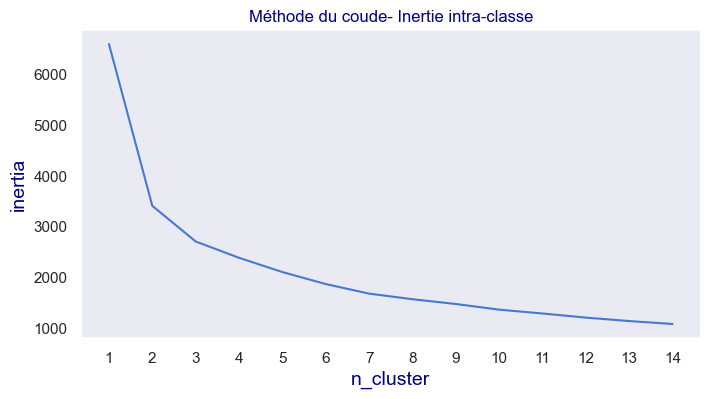

In [416]:
#On défini d'abord une liste vide pour sotcker nos inerties: 
inertia = []

#On défini ensuite la liste du nombre de clusters que l'on veut tester:
k_list = range(1, 15)
list(k_list)

#on effecture k K-Means et on relève l'inertie dans la liste d'inertie
for i in k_list :
  kmeans = KMeans(n_clusters=i)
  kmeans.fit(df_X_bis_proj_KM) 
  inertia.append(kmeans.inertia_)

#Nous obtenons une liste d'inerties intracluster que nous souhaitons minimale sans avroi trop de groupes : inertia

#Affichage du résultat :
fig, ax = plt.subplots(1,1,figsize=(8,4))

ax.set_ylabel("inertia")
ax.set_xlabel("n_cluster")
ax = plt.plot(k_list, inertia)
plt.xticks(k_list)
plt.title("Méthode du coude- Inertie intra-classe")

ATTENTION :  
LE Résultat n'est pas toujours le même sachant que le K-means n'est pas déterministe.  
Le résultat est relativement variable : 2, 3? 4, 5, 6...  
**coude récurrent : 2**  
coude variable 3, 4...

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5bis.2.3bis - Methode de la silhouette sur le K-means </h4>
</div>

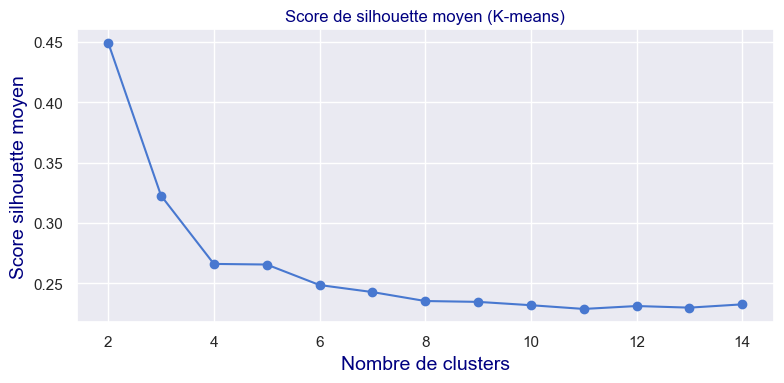

In [417]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Données déjà transformées (par exemple PCA)
X_temp = df_X_bis_proj_KM.copy()

# Liste pour stocker les scores
silhouette_scores = []

# Plage du nombre de clusters à tester
range_nb_clust = range(2, 15)

# Boucle pour calculer les scores
for nb_clust in range_nb_clust:
    kmeans = KMeans(n_clusters=nb_clust, random_state=42)
    labels = kmeans.fit_predict(X_temp)
    score = silhouette_score(X_temp, labels)
    silhouette_scores.append(score)

# Affichage de la courbe
plt.figure(figsize=(8, 4))
plt.plot(list(range_nb_clust), silhouette_scores, marker='o')
plt.title("Score de silhouette moyen (K-means)")
plt.xlabel("Nombre de clusters")
plt.ylabel("Score silhouette moyen")
plt.grid(True)
plt.tight_layout()
plt.show()


Moyenne des scores de silhouette (silhouette_avg)

C’est le score moyen sur tous les points → une mesure globale de la cohérence des clusters.

▸ Interprétation :  
Valeur	Qualité du clustering  

'> 0.7	Très bon  
0.5 – 0.7	Correct  
0.25 – 0.5	Moyennement structuré  
< 0.25	Faible ou non structuré  

Plus le score moyen est élevé, meilleur est le regroupement.

Le résultat est plus stable.  
**2 est clairement le nombre de cluster le meilleur, avec un score de silhouette de 0.45**  
cohérent avec le K-means

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">5bis.2one - K-means Test à 2 clusters /random_state=42 </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5bis.2one.1 - K-means </h4>
</div>

Regardons maintenant les clusters que nous avons obtenus.

Nous devons d'abord ré-entrainer un estimateur:

In [418]:
n_clusters=2

In [419]:
df_X_bis_proj_KM_N_temp =df_X_bis_proj_KM.copy()

In [420]:
kmeans = KMeans(n_clusters=n_clusters,random_state=42
               )
kmeans.fit(df_X_bis_proj_KM_N_temp  )

,n_clusters,2
,init,'k-means++'
,n_init,'auto'
,max_iter,300
,tol,0.0001
,verbose,0
,random_state,42
,copy_x,True
,algorithm,'lloyd'


Voici les clusters : 

In [421]:
kmeans.labels_

array([1, 0, 0, ..., 1, 1, 1])

In [422]:
pd.Series(kmeans.labels_).value_counts()

0    1001
1     499
Name: count, dtype: int64

Ajoutons nos labels à `df_X_bis_proj_KM_N_temp  `

In [423]:
df_X_bis_proj_KM_N_temp  ["labels"] = kmeans.labels_
df_X_bis_proj_KM_N_temp  

,F1,F2,F3,labels
0,-1.647418,0.746983,2.394085,1
1,2.019727,-2.206758,-1.002436,0
2,0.969055,2.619394,1.201073,0
3,1.375705,-1.817760,0.647272,0
4,-0.150219,-0.566099,0.854165,0
...,...,...,...,...
1495,-1.428753,-0.270050,0.946514,1
1496,-3.280778,1.317247,0.615665,1
1497,-1.888713,-0.600805,-0.545709,1
1498,-1.789664,0.511028,0.028079,1


Affichons cela de façon graphique :

In [424]:
#Création d'une palette pour les labelles des clusters
Ordre_cluster_labels = (df_X_bis_proj_KM_N_temp  ["labels"].sort_values()).unique()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_cluster_labels = sns.color_palette("deep", len(Ordre_cluster_labels))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_cluster_labels = dict(zip(Ordre_cluster_labels, couleurs_muted_cluster_labels))

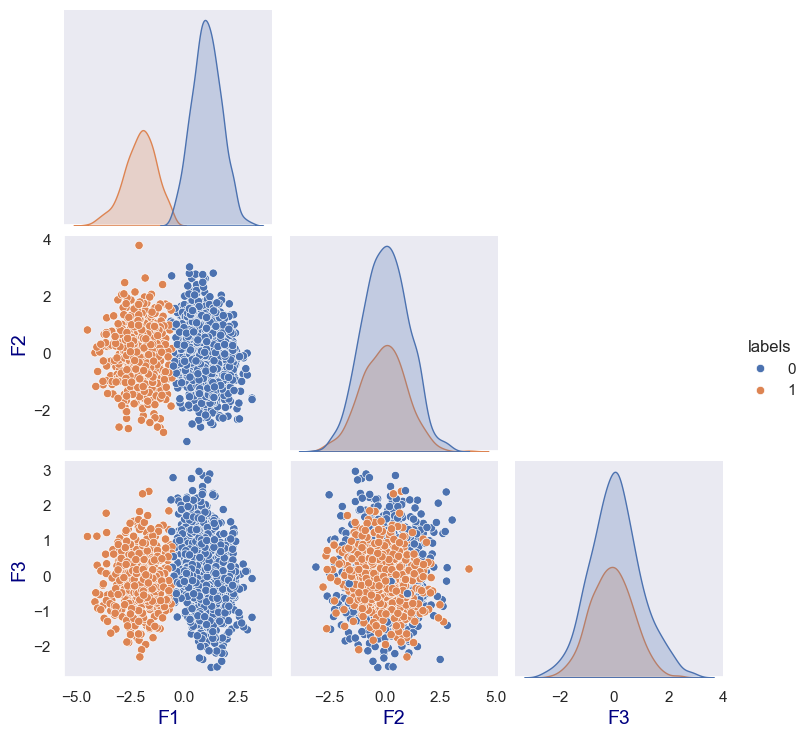

In [425]:
sns.pairplot(df_X_bis_proj_KM_N_temp  , 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5bis.2one.2 - Interprétation: </h4>
</div>

In [426]:
df_X_bis_proj_KM_N_temp.head(2)

,F1,F2,F3,labels
0,-1.647418,0.746983,2.394085,1
1,2.019727,-2.206758,-1.002436,0


CENTRE DE GRAVITE :

In [427]:
df_X_bis_proj_KM_N_temp_grouped = (df_X_bis_proj_KM_N_temp.groupby(by=['labels'])).mean()
df_X_bis_proj_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_bis_proj_KM_N_temp_grouped)

,F1,F2,F3
cluster,,,
0,1.026165,0.034815,0.046065
1,-2.058500,-0.069840,-0.092408


LES CENTROIDES :

In [428]:
# On peut stocker nos centroids dans une variable : 
centroids = kmeans.cluster_centers_
centroids

array([[ 1.02616542,  0.03481529,  0.04606541],
       [-2.05850017, -0.06983989, -0.09240776]])

**CENTROIDES du K-means= BARYCENTRE**  
les centroides calculés par le K-means sont bien les centre de gravité despoints du cluster

Nous pouvons passer à la partie visualisation. Pour ce faire, nous allons réaliser une ACP.

ATTENTION ICI : 
Mes données d'origine sont déjà des données projetées.  
Car j'ai choisie de prendre les données aprs PCA

In [429]:
df_temp = df_X_bis_proj_KM_N_temp  .copy()
df_temp.head()

,F1,F2,F3,labels
0,-1.647418,0.746983,2.394085,1
1,2.019727,-2.206758,-1.002436,0
2,0.969055,2.619394,1.201073,0
3,1.375705,-1.817760,0.647272,0
4,-0.150219,-0.566099,0.854165,0


In [430]:
df_temp_grouped =df_X_bis_proj_KM_N_temp_grouped.copy()
df_temp_grouped.head()

,F1,F2,F3
cluster,,,
0,1.026165,0.034815,0.046065
1,-2.058500,-0.069840,-0.092408


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5bis.2one.3- Visualisation  : </h4>
</div>

**Liste des billets**

In [431]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " , ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
1  , 2  , 3  , 4  , 5  , 6  , 7  , 8  , 9  , 10  , 11  , 12  , 13  , 14  , 15  , 16  , 17  , 18  , 19  , 20  , 21  , 22  , 23  , 24  , 25  , 26  , 27  , 28  , 29  , 30  , 31  , 32  , 33  , 34  , 35  , 36  , 37  , 38  , 39  , 40  , 41  , 42  , 43  , 44  , 45  , 46  , 47  , 48  , 49  , 50  , 51  , 52  , 53  , 54  , 55  , 56  , 57  , 58  , 59  , 60  , 61  , 62  , 63  , 64  , 65  , 66  , 67  , 68  , 69  , 70  , 71  , 72  , 73  , 74  , 75  , 76  , 77  , 78  , 79  , 80  , 81  , 82  , 83  , 84  , 85  , 86  , 87  , 88  , 89  , 90  , 91  , 92  , 93  , 94  , 95  , 96  , 97  , 98  , 99  , 100  , 101  , 102  , 103  , 104  , 105  , 106  , 107  , 108  , 109  , 110  , 111  , 112  , 113  , 114  , 115  , 116  , 117  , 118  , 119  , 120  , 121  , 122  , 123  , 124  , 125  , 126  , 127  , 128  , 129  , 130  , 131  , 132  , 133  , 134  , 135  , 136  , 137  , 138  , 139  , 140  , 141  , 142  , 143  , 144  , 145  , 146  , 147  , 148  , 149  , 150  , 151  , 152  , 153  , 154  , 155  , 156  , 157 

**HEATMAP**

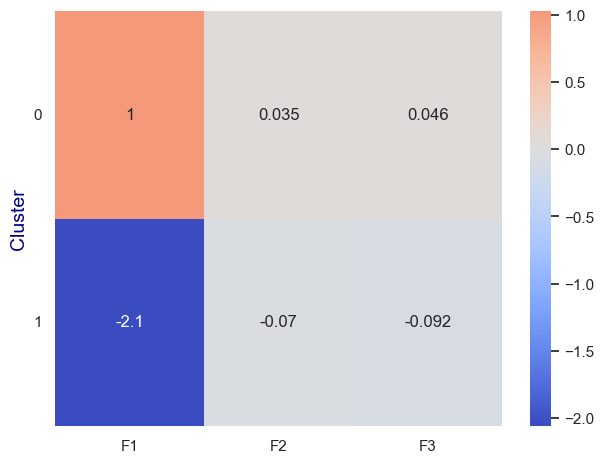

In [432]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap='coolwarm',
            center =0 
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

**RADAR**

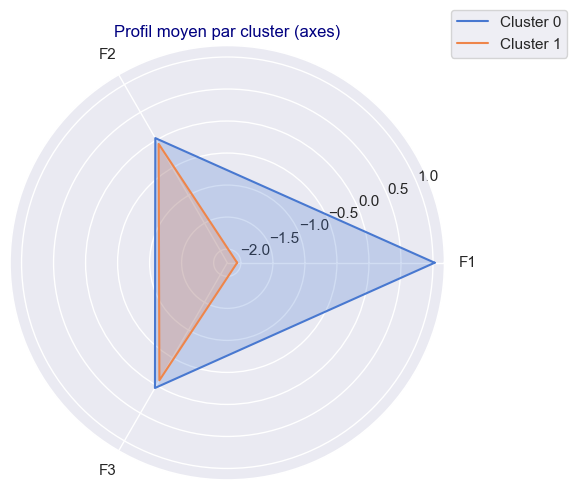

In [433]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

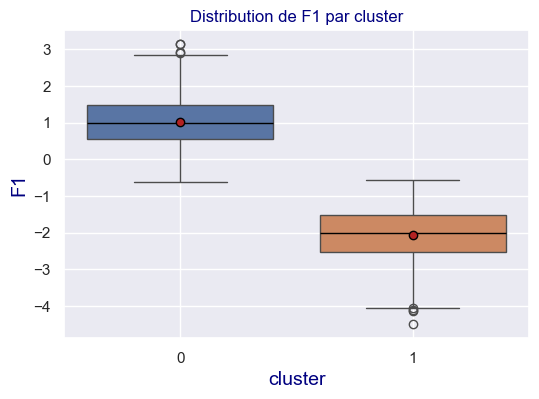

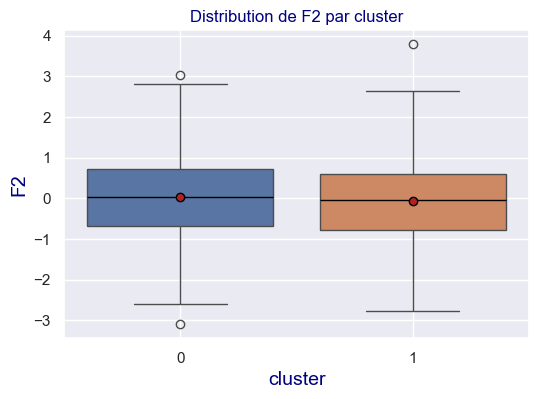

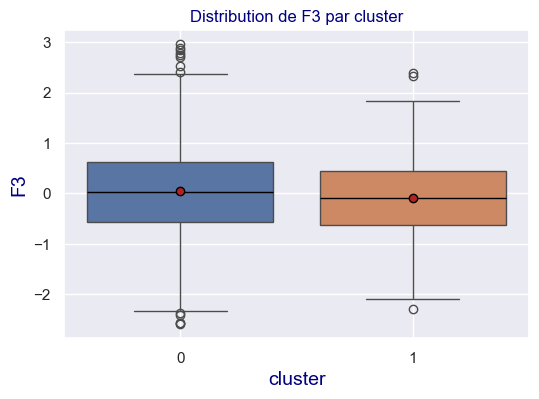

In [434]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

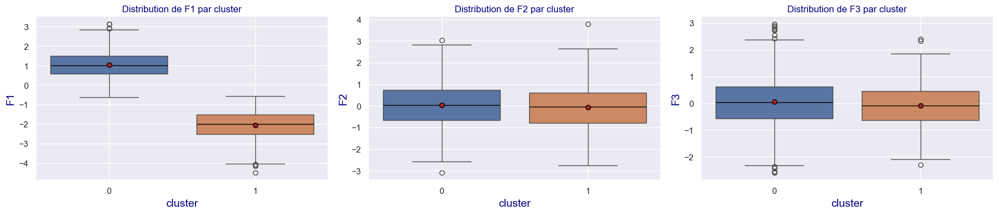

In [435]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Liste des variables à afficher (hors "labels")
variables = df_temp.columns.drop("labels", errors='ignore')
n = len(variables)

# Définir le nombre de lignes et de colonnes
n_cols = 3
n_rows = math.ceil(n / n_cols)

# Créer la figure
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 4))
axes = axes.flatten()  # pour indexer facilement

for i, col in enumerate(variables):
    ax = axes[i]
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                ax=ax,
                medianprops = {'color':"black"},
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},
                showmeans =True,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
                legend=False)
    ax.set_title(f"Distribution de {col} par cluster")
    ax.set_xlabel("cluster")
    ax.grid(True)

# Supprimer les axes vides s’il y a moins de 4 variables
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

##### **PROJECTIONS**

Nosu avons déjà des données projetées

In [436]:
X_proj_temp = df_temp.copy()
X_proj_temp.head(2)

,F1,F2,F3,labels
0,-1.647418,0.746983,2.394085,1
1,2.019727,-2.206758,-1.002436,0


In [437]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3
cluster,,,
0,1.026165,0.034815,0.046065
1,-2.058500,-0.069840,-0.092408


In [438]:
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,F1,F2,F3,labels
cluster,,,,
0,1.026165,0.034815,0.046065,0
1,-2.058500,-0.069840,-0.092408,1


Et on affiche le graphique pour F1 et F2 :

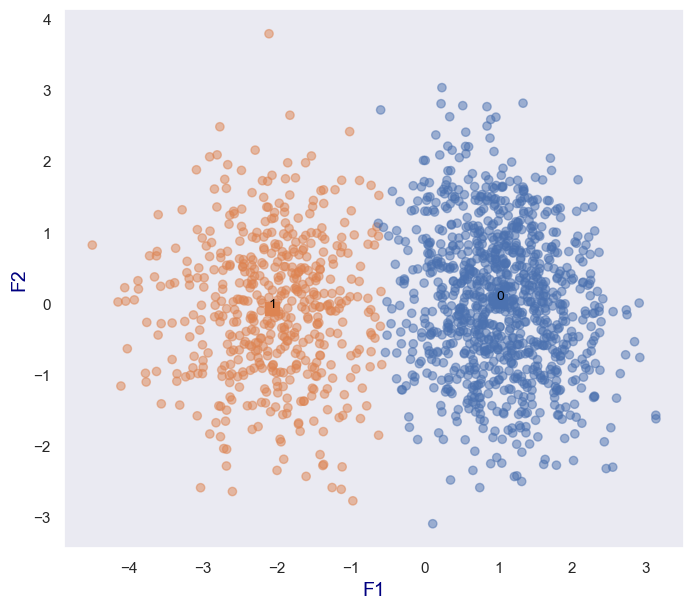

In [439]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 0], 
    X_proj_temp.iloc[:, 1], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 0], 
    centroids_proj_temp.iloc[:, 1], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F1")
ax.set_ylabel("F2")
plt.show()


On peut faire des graphiques à 3 dimensions :

Text(0.5, 0.92, 'Projection avec Clustering K-means classique')

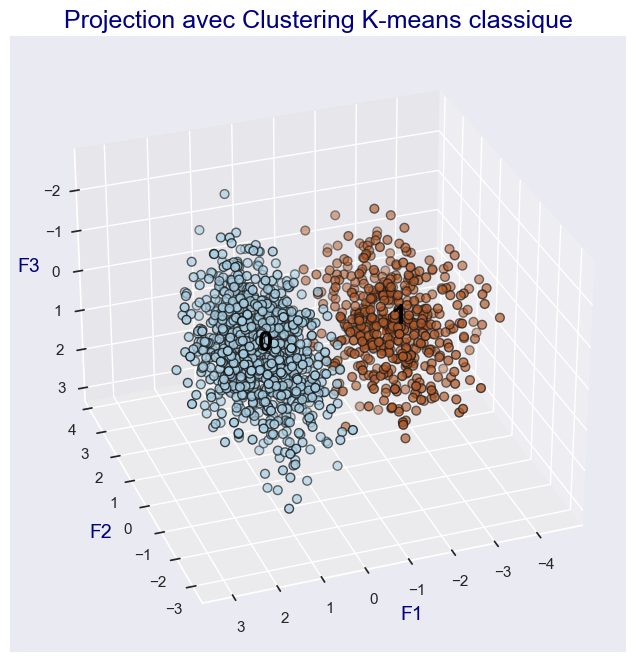

In [440]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(10, 8))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 1],
    X_proj_temp.iloc[:, 2],
    c=X_proj_temp['labels'], cmap="Paired", edgecolor="k", s=40)


# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, 0], 
           centroids_proj_temp.iloc[:, 1],  
           centroids_proj_temp.iloc[:, 2],  
           c=centroids_proj_temp['labels'],cmap="Paired", s=200,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1], 
        centroids_proj_temp.iloc[i, 2], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=20, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

plt.title("Projection avec Clustering K-means classique",color='navy',size=18)

In [441]:
X_proj_temp.head(2)

,F1,F2,F3,labels
0,-1.647418,0.746983,2.394085,1
1,2.019727,-2.206758,-1.002436,0


In [442]:
centroids_proj_temp.head()

,F1,F2,F3,labels
cluster,,,,
0,1.026165,0.034815,0.046065,0
1,-2.058500,-0.069840,-0.092408,1


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5bis.2one.4 - Visualisation des données centrées réduites : </h4>
</div>

Explications voir 5bis.1.5

In [443]:
df_X_bis_scaled = df_X_base_scaled.copy(deep=True)

In [444]:
df_X_bis_scaled.head()

,diagonal,height_left,height_right,margin_low,margin_up,length
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750


In [445]:
#Mappons df_X_bis_scaled avec nos labels
df_X_bis_scaled_KM_N_temp = df_X_bis_scaled.join(df_temp["labels"])
df_X_bis_scaled_KM_N_temp.head()

,diagonal,height_left,height_right,margin_low,margin_up,length,labels
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651,1
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666,0
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901,0
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075,0
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750,0


In [446]:
df_X_bis_scaled_KM_N_temp_grouped = (df_X_bis_scaled_KM_N_temp.groupby(by=['labels'])).mean()
df_X_bis_scaled_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_bis_scaled_KM_N_temp_grouped)

,diagonal,height_left,height_right,margin_low,margin_up,length
cluster,,,,,,
0,0.095225,-0.283663,-0.358598,-0.553376,-0.431503,0.593272
1,-0.191022,0.569032,0.719352,1.110079,0.865601,-1.190112


In [447]:
df_temp = df_X_bis_scaled_KM_N_temp.copy()
df_temp_grouped = df_X_bis_scaled_KM_N_temp_grouped.copy()

In [448]:
df_temp.head(5)

,diagonal,height_left,height_right,margin_low,margin_up,length,labels
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651,1
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666,0
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901,0
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075,0
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750,0


In [449]:
df_temp_grouped.head(2)

,diagonal,height_left,height_right,margin_low,margin_up,length
cluster,,,,,,
0,0.095225,-0.283663,-0.358598,-0.553376,-0.431503,0.593272
1,-0.191022,0.569032,0.719352,1.110079,0.865601,-1.190112


**Liste des billets (Vérification)**

In [450]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " / ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
1  / 2  / 3  / 4  / 5  / 6  / 7  / 8  / 9  / 10  / 11  / 12  / 13  / 14  / 15  / 16  / 17  / 18  / 19  / 20  / 21  / 22  / 23  / 24  / 25  / 26  / 27  / 28  / 29  / 30  / 31  / 32  / 33  / 34  / 35  / 36  / 37  / 38  / 39  / 40  / 41  / 42  / 43  / 44  / 45  / 46  / 47  / 48  / 49  / 50  / 51  / 52  / 53  / 54  / 55  / 56  / 57  / 58  / 59  / 60  / 61  / 62  / 63  / 64  / 65  / 66  / 67  / 68  / 69  / 70  / 71  / 72  / 73  / 74  / 75  / 76  / 77  / 78  / 79  / 80  / 81  / 82  / 83  / 84  / 85  / 86  / 87  / 88  / 89  / 90  / 91  / 92  / 93  / 94  / 95  / 96  / 97  / 98  / 99  / 100  / 101  / 102  / 103  / 104  / 105  / 106  / 107  / 108  / 109  / 110  / 111  / 112  / 113  / 114  / 115  / 116  / 117  / 118  / 119  / 120  / 121  / 122  / 123  / 124  / 125  / 126  / 127  / 128  / 129  / 130  / 131  / 132  / 133  / 134  / 135  / 136  / 137  / 138  / 139  / 140  / 141  / 142  / 143  / 144  / 145  / 146  / 147  / 148  / 149  / 150  / 151  / 152  / 153  / 154  / 155  / 156  / 157 

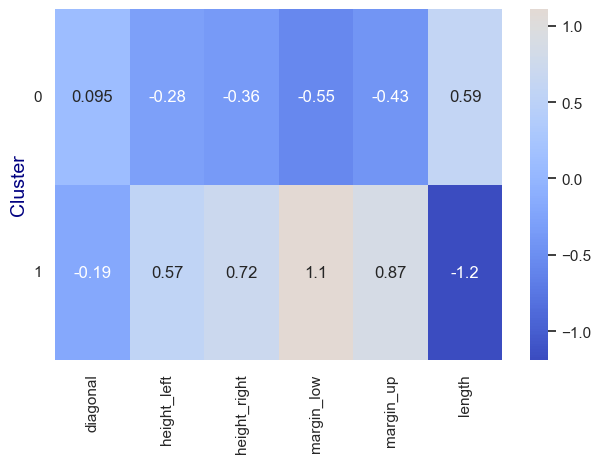

In [451]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap ='coolwarm',
            center =1 #pour voir les valeurs suffisamment positives
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

**RADAR**

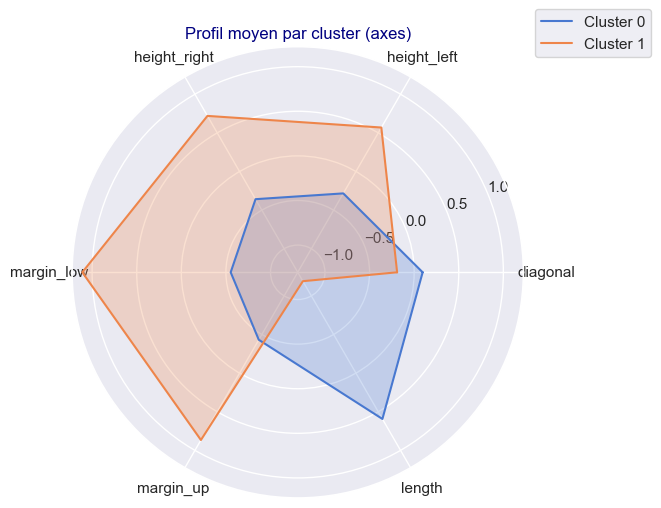

In [452]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend( bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

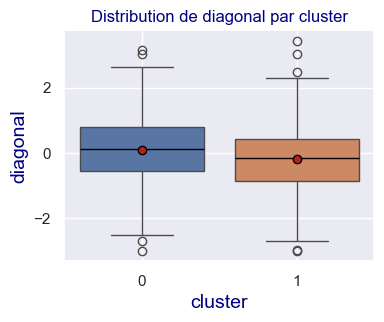

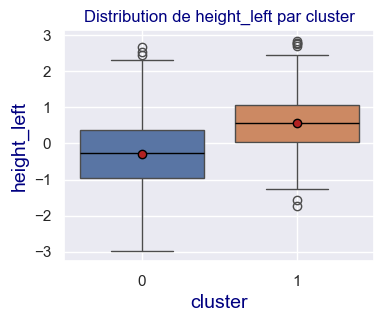

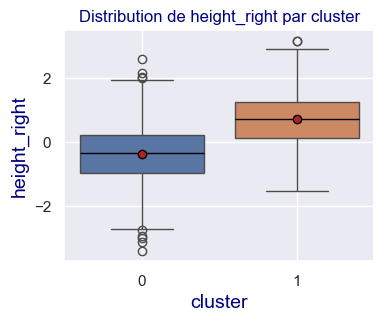

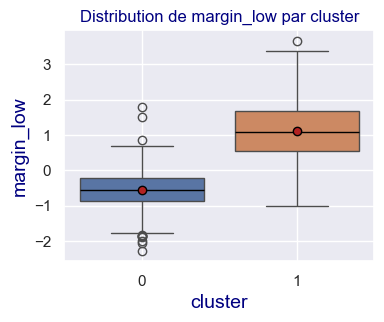

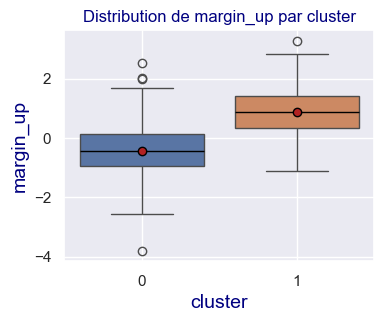

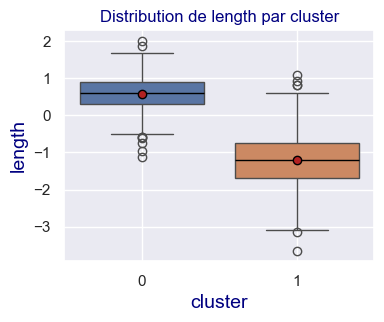

In [453]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(4, 3))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

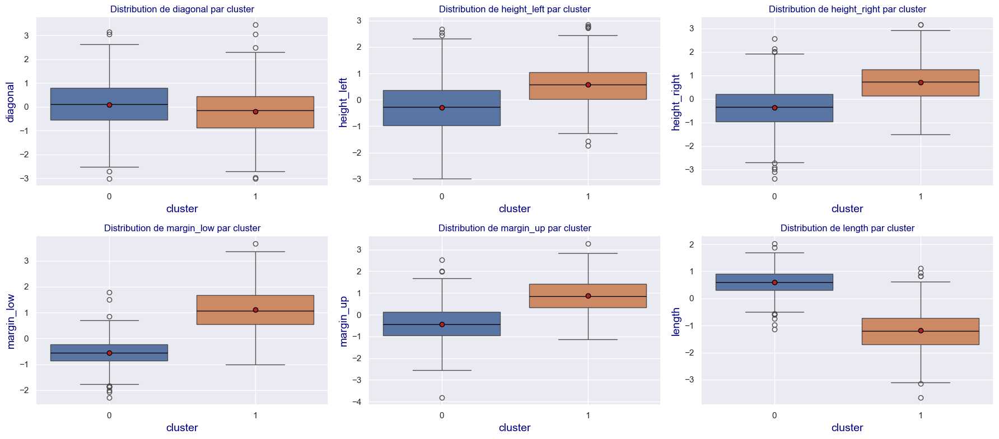

In [454]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Liste des variables à afficher (hors "labels")
variables = df_temp.columns.drop("labels", errors='ignore')
n = len(variables)

# Définir le nombre de lignes et de colonnes
n_cols = 3
n_rows = math.ceil(n / n_cols)

# Créer la figure
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 4))
axes = axes.flatten()  # pour indexer facilement

for i, col in enumerate(variables):
    ax = axes[i]
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                ax=ax,
                medianprops = {'color':"black"},
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},
                showmeans =True,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
                legend=False)
    ax.set_title(f"Distribution de {col} par cluster")
    ax.set_xlabel("cluster")
    ax.grid(True)

# Supprimer les axes vides s’il y a moins de 4 variables
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">5bis.3 - Evaluation du clustering : Matrice de confusion </h3>
</div>

In [455]:
#la matrice d'origine avec la colone d'authenticité is_genuine :
df_billets_analyse_1_2['is_genuine'].head()

0    True
1    True
2    True
3    True
4    True
Name: is_genuine, dtype: bool

In [456]:
#la liste des labels de clusters dans le même ordre :
df_X_bis_proj_KM_N_temp['labels'].head()

0    1
1    0
2    0
3    0
4    0
Name: labels, dtype: int32

In [457]:
from sklearn.metrics import confusion_matrix

In [458]:
# ------------------------------
# 3. Évaluation du clustering
# ------------------------------
print("\nMatrice de confusion entre clusters et vérité terrain :")
mat_confusion = confusion_matrix(df_billets_analyse_1_2['is_genuine'], df_X_bis_proj_KM_N_temp['labels'])
print(mat_confusion)


Matrice de confusion entre clusters et vérité terrain :
[[ 13 487]
 [988  12]]


In [459]:
import pandas as pd

# Suppose que df_billets_analyse_1_2['is_genuine'] = True/False
# et df_X_bis_proj_KM_N_temp['labels'] = 0/1 issus du clustering

# Création d'un DataFrame temporaire
df_graph = pd.DataFrame({
    'Authenticité (Vérité terrain)': df_billets_analyse_1_2['is_genuine'].map({True: 'Vrai', False: 'Faux'}),
    'Cluster K-means': df_X_bis_proj_KM_N_temp['labels'].map({0: 'Cluster 0', 1: 'Cluster 1'})
})

# Matrice de confusion lisible
matrice_lisible = pd.crosstab(df_graph['Authenticité (Vérité terrain)'], df_graph['Cluster K-means'], margins=True)
print("\nMatrice de confusion lisible :\n")
print(matrice_lisible)



Matrice de confusion lisible :

Cluster K-means                Cluster 0  Cluster 1   All
Authenticité (Vérité terrain)                            
Faux                                  13        487   500
Vrai                                 988         12  1000
All                                 1001        499  1500


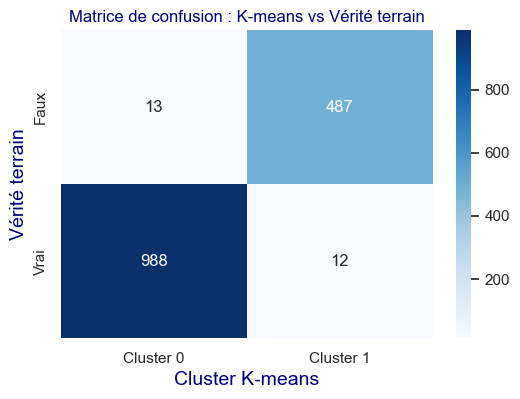

In [460]:
plt.figure(figsize=(6,4))
sns.heatmap(matrice_lisible.iloc[:-1, :-1], annot=True, fmt="d", cmap="Blues")
plt.title("Matrice de confusion : K-means vs Vérité terrain")
plt.ylabel("Vérité terrain")
plt.xlabel("Cluster K-means")
plt.show()

**Remarque :**  
Tester avec plusieurs initialisation aléatoires, et plusieurs random-state différents.  
On tombe sur les mêmes ordres de grandeurs, parfois c'est le cluster 1 qui représente les Vrai billets, parfois le Cluster 0.  

**Observation :**  
On observe une erreur de l'ordre de 1,2% de Vrai billets annoncé Faux à tord,  
Et une erreur de l'ordre de 0,6% de Faux billets annoncé Vrai à tord.  
Cela donne déjà une bonne indication avec moins de 1% d'erreur.

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 5Orig - Clustering sur données Originales </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">5Orig.0- Préparation Data  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.0.1 - Data : </h4>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.0.2 - Selection : </h4>
</div>

<font color='blue'>**DATA :**</font>  
Le jeu de données orginales :  
df_billets_analyse_1_2

In [461]:
df_billets_analyse_1_2.head()

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09
2,True,172.69,104.48,103.50,4.40,2.94,113.16
3,True,171.36,103.91,103.94,3.62,3.01,113.51
4,True,171.73,104.28,103.46,4.04,3.48,112.54


**PAS DE SELECTION DE DONNES: toutes sont utilisées**

In [462]:
df_billets_analyse_1_2_Orig_selec = df_billets_analyse_1_2.copy(deep=True)

In [463]:
df_billets_analyse_1_2_Orig_selec.shape

(1500, 7)

POINT SUR LES DONNEES :

In [464]:
Premieres_Analyses(df_billets_analyse_1_2_Orig_selec)


---- SHAPE ----


(1500, 7)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500 entries, 0 to 1499
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   is_genuine    1500 non-null   bool   
 1   diagonal      1500 non-null   float64
 2   height_left   1500 non-null   float64
 3   height_right  1500 non-null   float64
 4   margin_low    1500 non-null   float64
 5   margin_up     1500 non-null   float64
 6   length        1500 non-null   float64
dtypes: bool(1), float64(6)
memory usage: 71.9 KB

---- DESCRIBE ----


,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.00000
mean,171.958440,104.029533,103.920307,4.482858,3.151473,112.67850
std,0.305195,0.299462,0.325627,0.659857,0.231813,0.87273
min,171.040000,103.140000,102.820000,2.980000,2.270000,109.49000
25%,171.750000,103.820000,103.710000,4.027500,2.990000,112.03000
50%,171.960000,104.040000,103.920000,4.310000,3.140000,112.96000
75%,172.170000,104.230000,104.150000,4.870000,3.310000,113.34000
max,173.010000,104.880000,104.950000,6.900000,3.910000,114.44000



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1500,0,322,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


In [465]:
df_billets_analyse_1_2_Orig_selec.columns

Index(['is_genuine', 'diagonal', 'height_left', 'height_right', 'margin_low',
       'margin_up', 'length'],
      dtype='object')

In [466]:
df_billets_analyse_1_2_Orig_selec.dtypes

is_genuine         bool
diagonal        float64
height_left     float64
height_right    float64
margin_low      float64
margin_up       float64
length          float64
dtype: object

In [467]:
##### **SELECTION DES COLONNES QUANTITATIVES :**

In [468]:
#Rappel :
# Liste des variables quantitatives
print(quant_vars) 

['diagonal', 'height_left', 'height_right', 'margin_low', 'margin_up', 'length']


In [469]:
df_Orig_quant = (df_billets_analyse_1_2_Orig_selec[quant_vars] ).copy(deep=True)
df_Orig_quant.head()

,diagonal,height_left,height_right,margin_low,margin_up,length
0,171.81,104.86,104.95,4.52,2.89,112.83
1,171.46,103.36,103.66,3.77,2.99,113.09
2,172.69,104.48,103.50,4.40,2.94,113.16
3,171.36,103.91,103.94,3.62,3.01,113.51
4,171.73,104.28,103.46,4.04,3.48,112.54


Notre dataframe a maintenant une dimension de : 

In [470]:
df_Orig_quant.shape

(1500, 6)

In [471]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_Orig_quant)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1500,0,322,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


##### **PAS DE VALEURS MANQUANTES =>PAS DE TRAITEMENT :**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.0.3 - Data Split : </h4>
</div>

Nous allons ensuite séparer nos données. D'un coté `X_ter` la matrice des données : 

In [472]:
#X_Orig récupère les valeurs de df_Orig_quant dans un np.array
X_Orig = df_Orig_quant.values
#X_Orig[:5]
pd.DataFrame(X_Orig).head()

,0,1,2,3,4,5
0,171.81,104.86,104.95,4.52,2.89,112.83
1,171.46,103.36,103.66,3.77,2.99,113.09
2,172.69,104.48,103.50,4.40,2.94,113.16
3,171.36,103.91,103.94,3.62,3.01,113.51
4,171.73,104.28,103.46,4.04,3.48,112.54


In [473]:
X_Orig.shape

(1500, 6)

Nous enregistrons les noms de nos billets dans une variable `names_Orig` : 

In [474]:
names_Orig = df_Orig_quant.index
names_Orig

RangeIndex(start=0, stop=1500, step=1)

In [475]:
names_Orig.shape

(1500,)

et nos colonnes, nos features_base, dans une variable `features_Orig` : 

In [476]:
#DEJA FAIT DANS PCA_Bis_sans CHN_IND :
features_Orig = df_Orig_quant.columns
features_Orig

Index(['diagonal', 'height_left', 'height_right', 'margin_low', 'margin_up',
       'length'],
      dtype='object')

In [477]:
features_Orig.shape

(6,)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.0.4 - Data Preparation :Scaler </h4>
</div>

Nous allons scaler (centrer-réduire) notre np.array brut de données `X_Orig` :

In [478]:
#instanciation d'un fonction de centrage-reduction notée scaler
scaler_Orig = StandardScaler()
scaler_Orig

,copy,True
,with_mean,True
,with_std,True


In [479]:
#préparation de la fonction pour s'adapter au format de nos données X_ter (Fitage) :
scaler_Orig.fit(X_Orig)

,copy,True
,with_mean,True
,with_std,True


In [480]:
#Centrage -réduction de X_Orig dans le np.array X_Orig_scaled :
X_Orig_scaled = scaler_Orig.transform(X_Orig)
pd.DataFrame(X_Orig_scaled).head(5) #visualisation de X_Orig_scaled

,0,1,2,3,4,5
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750


##### VISUALISATION de `X_Orig_scaled` :

In [481]:
type(X_Orig_scaled)

numpy.ndarray

In [482]:
#On peut vérifier le centrage : (Attention pour std ddf=1 dans describe
pd.DataFrame(X_Orig_scaled).describe().round(2)

,0,1,2,3,4,5
count,1500.00,1500.00,1500.00,1500.00,1500.00,1500.00
mean,-0.00,0.00,-0.00,-0.00,-0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00
min,-3.01,-2.97,-3.38,-2.28,-3.80,-3.65
25%,-0.68,-0.70,-0.65,-0.69,-0.70,-0.74
50%,0.01,0.03,-0.00,-0.26,-0.05,0.32
75%,0.69,0.67,0.71,0.59,0.68,0.76
max,3.45,2.84,3.16,3.66,3.27,2.02


In [483]:
#de manière plus explicite en récupérant le nom des colonnes : (Attention pour std ddf=1 dans describe
pd.DataFrame(X_Orig_scaled,columns=quant_vars).describe().round(2)

,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.00,1500.00,1500.00,1500.00,1500.00,1500.00
mean,-0.00,0.00,-0.00,-0.00,-0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00
min,-3.01,-2.97,-3.38,-2.28,-3.80,-3.65
25%,-0.68,-0.70,-0.65,-0.69,-0.70,-0.74
50%,0.01,0.03,-0.00,-0.26,-0.05,0.32
75%,0.69,0.67,0.71,0.59,0.68,0.76
max,3.45,2.84,3.16,3.66,3.27,2.02


In [484]:
pd.DataFrame(X_Orig_scaled).mean().round(2)

0   -0.0
1    0.0
2   -0.0
3   -0.0
4   -0.0
5    0.0
dtype: float64

In [485]:
pd.DataFrame(X_Orig_scaled).std(ddof=1).round(2)

0    1.0
1    1.0
2    1.0
3    1.0
4    1.0
5    1.0
dtype: float64

In [486]:
#Visualisation de X_Orig_scaled les données centrées réduites

In [487]:
#Visualisation de X_Orig_scaled les données centrées réduites
df_X_Orig_scaled = pd.DataFrame(X_Orig_scaled) #les données centrées réduites
df_X_Orig_scaled.columns = features_Orig
df_X_Orig_scaled.index = names_Orig
df_X_Orig_scaled.head() #les données centrées réduites

,diagonal,height_left,height_right,margin_low,margin_up,length
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.0.5 - Pas de PCA : </h4>
</div>

La PCA est utilisé pour réduire la quantité d'information.  
Nous n'avons pas beaucoup de données. 
C'est pour ça que nous allons pouvoir tenter de faire un clustering sur les données originales centrées réduites.  
Nous pourrons tester plusiseurs manières de Scaler.  
Nous n'avons pas la contrainte de la PCA qui requiert un centrage sur la moyenne et une réduction sur la Variance à 1.

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">5Orig.2 - K-means  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2.1 - Préliminaire  : </h4>
</div>

##### IMPORTS

##### DATA :

In [488]:
df_X_base_scaled

,diagonal,height_left,height_right,margin_low,margin_up,length
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750
...,...,...,...,...,...,...
1495,-0.683201,1.170713,0.767063,-0.095292,-0.265273,-1.602978
1496,0.758981,2.005822,1.596509,1.193295,0.942999,-1.958303
1497,-0.519316,-0.065250,0.613462,1.557132,0.899846,-0.835016
1498,0.332882,0.836669,0.429141,1.041697,1.331372,-0.491152


**REMARQUE : Choix du fichier scalé :**  
Pour df_X_Orig_scaled je peux choisir de : 
- reprendre df_X_base_scaled (les données scalées en Standard Scaler avec la PCA) et supprimer toute la partie 5Orig0 ;     
- ou je peux prendre df_X_Orig_scaled calculé ci-dessus ce qui me permet de répéter le processus en variant les types de Scaler pour voir différents effets

Je préfère la version df_X_Orig_scaled ou le processus de Scaler est répété poru savori ce qui a été fait et pouvor faire différent test.

In [489]:
#df_X_Orig_scaled = df_X_base_scaled.copy(deep=True)
#df_X_Orig_scaled = df_X_Orig_scaled

In [490]:
df_X_Orig_scaled.head()

,diagonal,height_left,height_right,margin_low,margin_up,length
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750


In [491]:
df_X_Orig_scaled_KM=df_X_Orig_scaled.copy(deep=True)
df_X_Orig_scaled_KM.head()

,diagonal,height_left,height_right,margin_low,margin_up,length
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750


In [492]:
df_X_Orig_scaled_KM.shape

(1500, 6)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2.2 - Test avc nb predefini de cluster  : </h4>
</div>

Testons tout d'abord avec un nombre défini de clusters.

On instancie notre estimateur:

In [493]:
n_clusters=6

In [494]:
kmeans = KMeans(n_clusters=n_clusters)

On l'entraine : 

In [495]:
kmeans.fit(df_X_Orig_scaled_KM)

,n_clusters,6
,init,'k-means++'
,n_init,'auto'
,max_iter,300
,tol,0.0001
,verbose,0
,random_state,None
,copy_x,True
,algorithm,'lloyd'


On peut calculer son inertie : (PM l'inertie totale somme des inertie des groupes)

In [496]:
kmeans.inertia_

4133.7813351246195

C'est l'inertie intraclasse.  
Plus l’inertia est faible, plus les points sont proches de leur centroïde → les clusters sont compacts.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2.3 - Méthode du coude (elbow method)  : </h4>
</div>

Passons à la méthode du coude.

Text(0.5, 1.0, 'Méthode du coude- Inertie intra-classe')

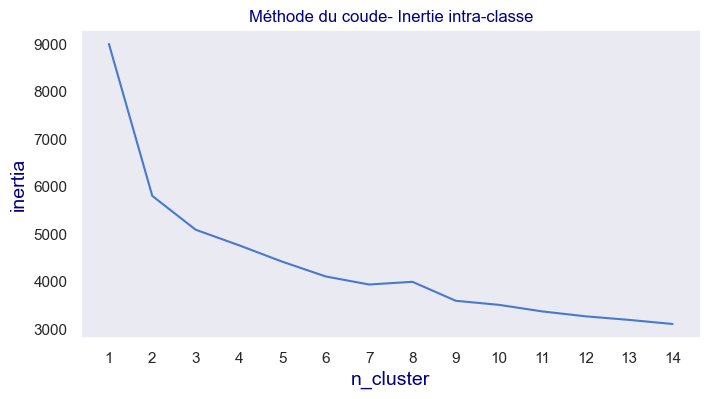

In [497]:
#On défini d'abord une liste vide pour sotcker nos inerties: 
inertia = []

#On défini ensuite la liste du nombre de clusters que l'on veut tester:
k_list = range(1, 15)
list(k_list)

#on effecture k K-Means et on relève l'inertie dans la liste d'inertie
for i in k_list :
  kmeans = KMeans(n_clusters=i)
  kmeans.fit(df_X_Orig_scaled_KM) 
  inertia.append(kmeans.inertia_)

#Nous obtenons une liste d'inerties intracluster que nous souhaitons minimale sans avroi trop de groupes : inertia

#Affichage du résultat :
fig, ax = plt.subplots(1,1,figsize=(8,4))

ax.set_ylabel("inertia")
ax.set_xlabel("n_cluster")
ax = plt.plot(k_list, inertia)
plt.xticks(k_list)
plt.title("Méthode du coude- Inertie intra-classe")

ATTENTION :  
LE Résultat n'est pas toujours le même sachant que le K-means n'est pas déterministe.  
Le résultat est relativement variable : 2, 3? 4, 5, 6...  
**coude récurrent : 2**  
coude variable 3, 4...

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2.3bis - Methode de la silhouette sur le K-means </h4>
</div>

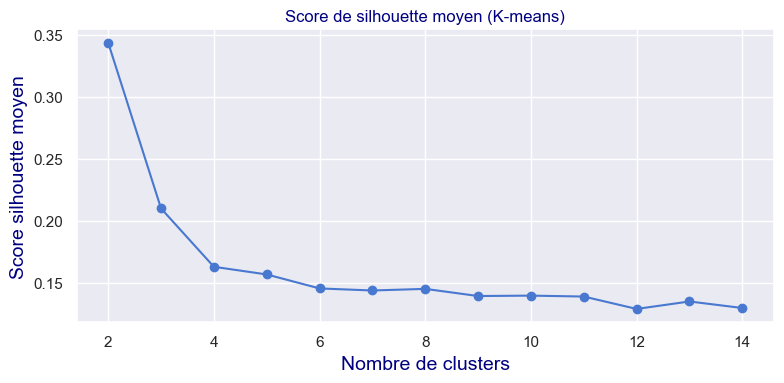

In [498]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Données déjà transformées (par exemple PCA)
X_temp = df_X_Orig_scaled_KM.copy()

# Liste pour stocker les scores
silhouette_scores = []

# Plage du nombre de clusters à tester
range_nb_clust = range(2, 15)

# Boucle pour calculer les scores
for nb_clust in range_nb_clust:
    kmeans = KMeans(n_clusters=nb_clust, random_state=42)
    labels = kmeans.fit_predict(X_temp)
    score = silhouette_score(X_temp, labels)
    silhouette_scores.append(score)

# Affichage de la courbe
plt.figure(figsize=(8, 4))
plt.plot(list(range_nb_clust), silhouette_scores, marker='o')
plt.title("Score de silhouette moyen (K-means)")
plt.xlabel("Nombre de clusters")
plt.ylabel("Score silhouette moyen")
plt.grid(True)
plt.tight_layout()
plt.show()


Moyenne des scores de silhouette (silhouette_avg)

C’est le score moyen sur tous les points → une mesure globale de la cohérence des clusters.

▸ Interprétation :  
Valeur	Qualité du clustering  

'> 0.7	Très bon  
0.5 – 0.7	Correct  
0.25 – 0.5	Moyennement structuré  
< 0.25	Faible ou non structuré  

Plus le score moyen est élevé, meilleur est le regroupement.

Le résultat est plus stable.  
**2 est clairement le nombre de cluster le meilleur, avec un score de silhouette de 0.45**  
cohérent avec le K-means

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">5Orig.2one - K-means Test à 2 clusters/random_state=150  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2one.1 - K-means </h4>
</div>

Regardons maintenant les clusters que nous avons obtenus.

Nous devons d'abord ré-entrainer un estimateur:

In [499]:
n_clusters=2

In [500]:
df_X_Orig_scaled_KM_N_temp =df_X_Orig_scaled_KM.copy()

In [501]:
kmeans = KMeans(n_clusters=n_clusters,random_state=150
               )
kmeans.fit(df_X_Orig_scaled_KM_N_temp  )

,n_clusters,2
,init,'k-means++'
,n_init,'auto'
,max_iter,300
,tol,0.0001
,verbose,0
,random_state,150
,copy_x,True
,algorithm,'lloyd'


Voici les clusters : 

In [502]:
kmeans.labels_

array([1, 0, 0, ..., 1, 1, 1])

In [503]:
pd.Series(kmeans.labels_).value_counts()

0    1003
1     497
Name: count, dtype: int64

Ajoutons nos labels à `df_X_Orig_scaled_KM_N_temp  `

In [504]:
df_X_Orig_scaled_KM_N_temp  ["labels"] = kmeans.labels_
df_X_Orig_scaled_KM_N_temp  

,diagonal,height_left,height_right,margin_low,margin_up,length,labels
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651,1
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666,0
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901,0
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075,0
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750,0
...,...,...,...,...,...,...,...
1495,-0.683201,1.170713,0.767063,-0.095292,-0.265273,-1.602978,1
1496,0.758981,2.005822,1.596509,1.193295,0.942999,-1.958303,1
1497,-0.519316,-0.065250,0.613462,1.557132,0.899846,-0.835016,1
1498,0.332882,0.836669,0.429141,1.041697,1.331372,-0.491152,1


Affichons cela de façon graphique :

In [505]:
#Création d'une palette pour les labelles des clusters
Ordre_cluster_labels = (df_X_Orig_scaled_KM_N_temp  ["labels"].sort_values()).unique()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_cluster_labels = sns.color_palette("deep", len(Ordre_cluster_labels))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_cluster_labels = dict(zip(Ordre_cluster_labels, couleurs_muted_cluster_labels))

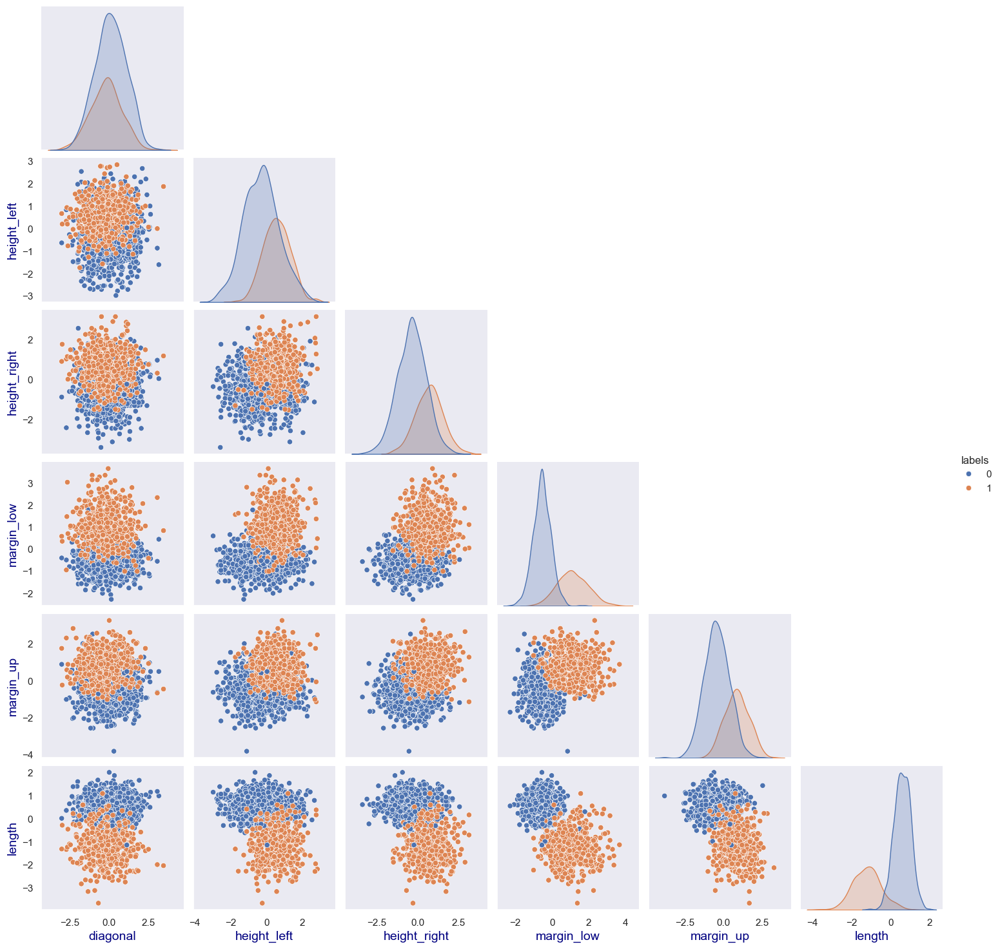

In [506]:
sns.pairplot(df_X_Orig_scaled_KM_N_temp  , 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2one.2 - Interprétation: </h4>
</div>

In [507]:
df_X_Orig_scaled_KM_N_temp.head(2)

,diagonal,height_left,height_right,margin_low,margin_up,length,labels
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651,1
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666,0


CENTRE DE GRAVITE :

In [508]:
df_X_Orig_scaled_KM_N_temp_grouped = (df_X_Orig_scaled_KM_N_temp.groupby(by=['labels'])).mean()
df_X_Orig_scaled_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_Orig_scaled_KM_N_temp_grouped)

,diagonal,height_left,height_right,margin_low,margin_up,length
cluster,,,,,,
0,0.096124,-0.281762,-0.352065,-0.553914,-0.428505,0.594584
1,-0.193988,0.568627,0.710506,1.117858,0.864769,-1.199935


LES CENTROIDES :

In [509]:
# On peut stocker nos centroids dans une variable : 
centroids = kmeans.cluster_centers_
centroids

array([[ 0.09612369, -0.28176231, -0.3520653 , -0.55391352, -0.42850453,
         0.59458412],
       [-0.19398804,  0.56862696,  0.71050603,  1.11785767,  0.8647687 ,
        -1.19993535]])

**CENTROIDES du K-means= BARYCENTRE**  
les centroides calculés par le K-means sont bien les centre de gravité despoints du cluster

Nous pouvons passer à la partie visualisation. Pour ce faire, nous allons réaliser une ACP.

ATTENTION ICI : 
Mes données d'origine sont déjà des données projetées.  
Car j'ai choisie de prendre les données aprs PCA

In [510]:
df_temp = df_X_Orig_scaled_KM_N_temp  .copy()
df_temp.head()

,diagonal,height_left,height_right,margin_low,margin_up,length,labels
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651,1
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666,0
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901,0
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075,0
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750,0


In [511]:
df_temp_grouped =df_X_Orig_scaled_KM_N_temp_grouped.copy()
df_temp_grouped.head()

,diagonal,height_left,height_right,margin_low,margin_up,length
cluster,,,,,,
0,0.096124,-0.281762,-0.352065,-0.553914,-0.428505,0.594584
1,-0.193988,0.568627,0.710506,1.117858,0.864769,-1.199935


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2one.3- Visualisation  : </h4>
</div>

**Liste des billets**

In [512]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " , ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
1  , 2  , 3  , 4  , 5  , 6  , 7  , 8  , 9  , 10  , 11  , 12  , 13  , 14  , 15  , 16  , 17  , 18  , 19  , 20  , 21  , 22  , 23  , 24  , 25  , 26  , 27  , 28  , 29  , 30  , 31  , 32  , 33  , 34  , 35  , 36  , 37  , 38  , 39  , 40  , 41  , 42  , 43  , 44  , 45  , 46  , 47  , 48  , 49  , 50  , 51  , 52  , 53  , 54  , 55  , 56  , 57  , 58  , 59  , 60  , 61  , 62  , 63  , 64  , 65  , 66  , 67  , 68  , 69  , 70  , 71  , 72  , 73  , 74  , 75  , 76  , 77  , 78  , 79  , 80  , 81  , 82  , 83  , 84  , 85  , 86  , 87  , 88  , 89  , 90  , 91  , 92  , 93  , 94  , 95  , 96  , 97  , 98  , 99  , 100  , 101  , 102  , 103  , 104  , 105  , 106  , 107  , 108  , 109  , 110  , 111  , 112  , 113  , 114  , 115  , 116  , 117  , 118  , 119  , 120  , 121  , 122  , 123  , 124  , 125  , 126  , 127  , 128  , 129  , 130  , 131  , 132  , 133  , 134  , 135  , 136  , 137  , 138  , 139  , 140  , 141  , 142  , 143  , 144  , 145  , 146  , 147  , 148  , 149  , 150  , 151  , 152  , 153  , 154  , 155  , 156  , 157 

**HEATMAP**

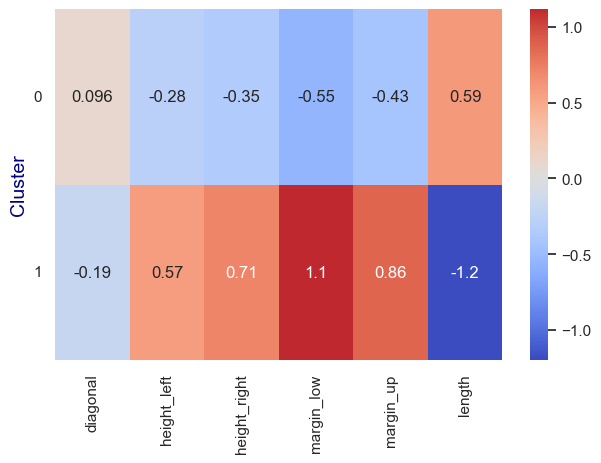

In [513]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap='coolwarm',
            center =0 
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

**RADAR**

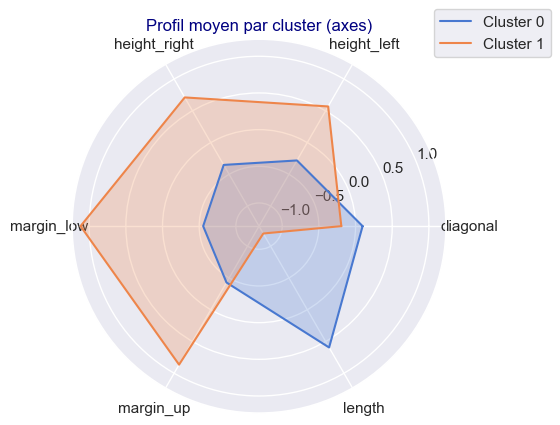

In [514]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

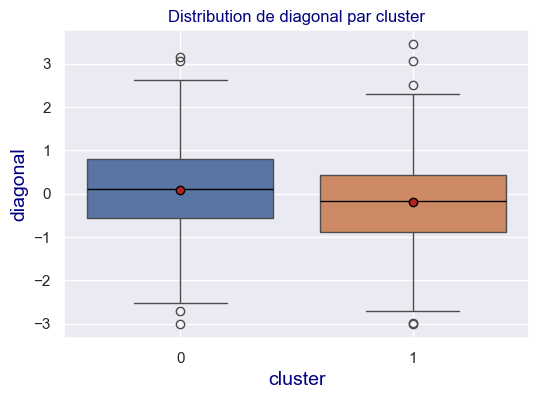

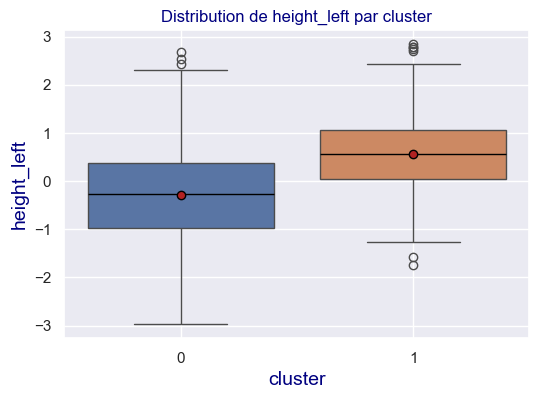

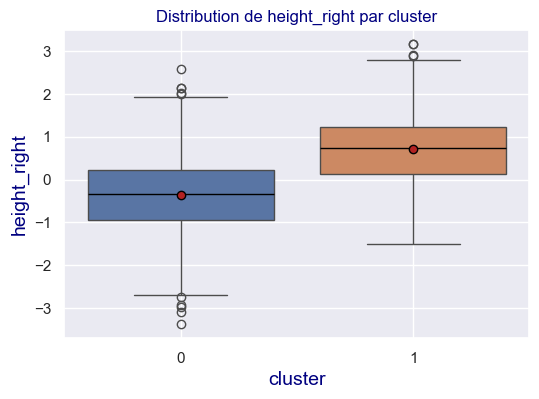

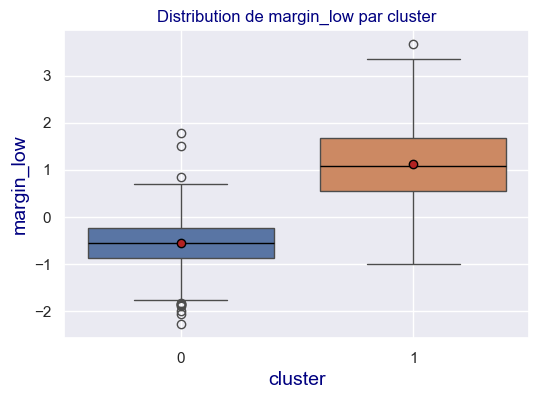

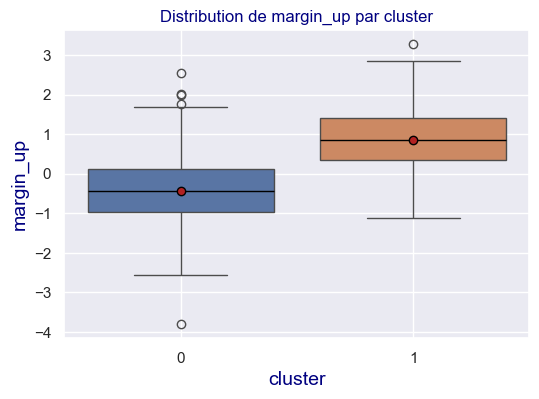

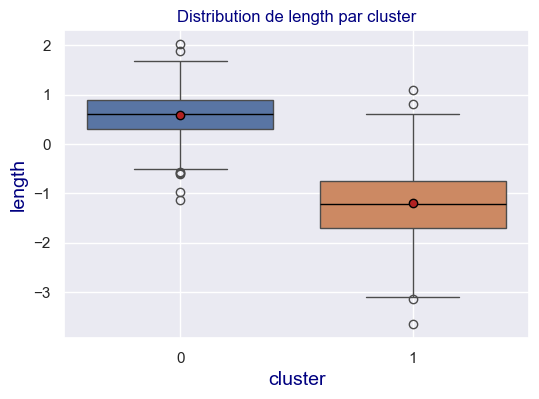

In [515]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

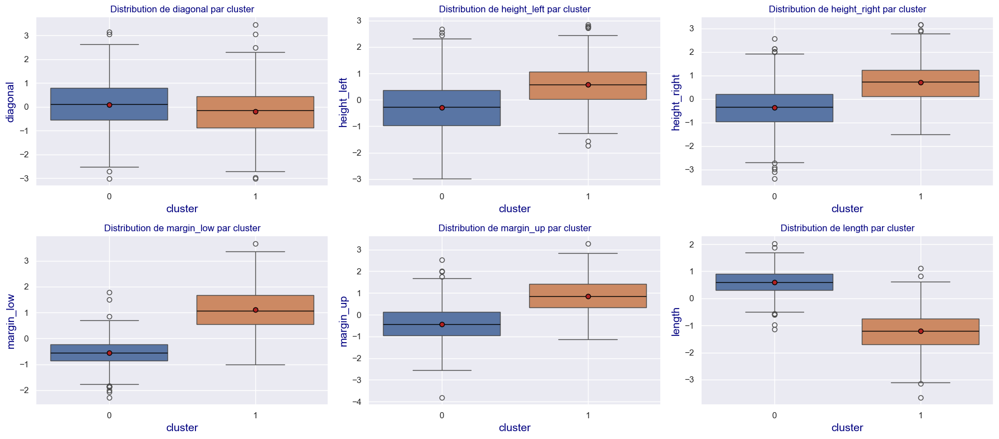

In [516]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Liste des variables à afficher (hors "labels")
variables = df_temp.columns.drop("labels", errors='ignore')
n = len(variables)

# Définir le nombre de lignes et de colonnes
n_cols = 3
n_rows = math.ceil(n / n_cols)

# Créer la figure
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 4))
axes = axes.flatten()  # pour indexer facilement

for i, col in enumerate(variables):
    ax = axes[i]
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                ax=ax,
                medianprops = {'color':"black"},
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},
                showmeans =True,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
                legend=False)
    ax.set_title(f"Distribution de {col} par cluster")
    ax.set_xlabel("cluster")
    ax.grid(True)

# Supprimer les axes vides s’il y a moins de 4 variables
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2one.4 - Visualisation des données centrées réduites : </h4>
</div>

##### **PROJECTIONS**

Je pourrais faire une PCA pour voir le maximum d'inertie.  
Mais je ne sais pas si c'est utile de faire une PCA juste pour ça (c'est utile pour réduire les variables).  
Mais sinon avec le boxplot j'ai déjà des axes qui pourraient mêtre utile pour visualiser.

Je pourrais faire une PCA pour voir le maximum d'inertie.  
Mais je ne sais pas si c'est utile de faire une PCA juste pour ça (c'est utile pour réduire les variables).  
Mais sinon avec le boxplot j'ai déjà des axes qui pourraient mêtre utile pour visualiser.

In [517]:
X_proj_temp = df_temp.copy()

In [518]:
X_proj_temp.head()

,diagonal,height_left,height_right,margin_low,margin_up,length,labels
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651,1
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666,0
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901,0
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075,0
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750,0


In [519]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,diagonal,height_left,height_right,margin_low,margin_up,length
cluster,,,,,,
0,0.096124,-0.281762,-0.352065,-0.553914,-0.428505,0.594584
1,-0.193988,0.568627,0.710506,1.117858,0.864769,-1.199935


In [520]:
#centroids_proj_temp['labels']=range(0,n_clusters)
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,diagonal,height_left,height_right,margin_low,margin_up,length,labels
cluster,,,,,,,
0,0.096124,-0.281762,-0.352065,-0.553914,-0.428505,0.594584,0
1,-0.193988,0.568627,0.710506,1.117858,0.864769,-1.199935,1


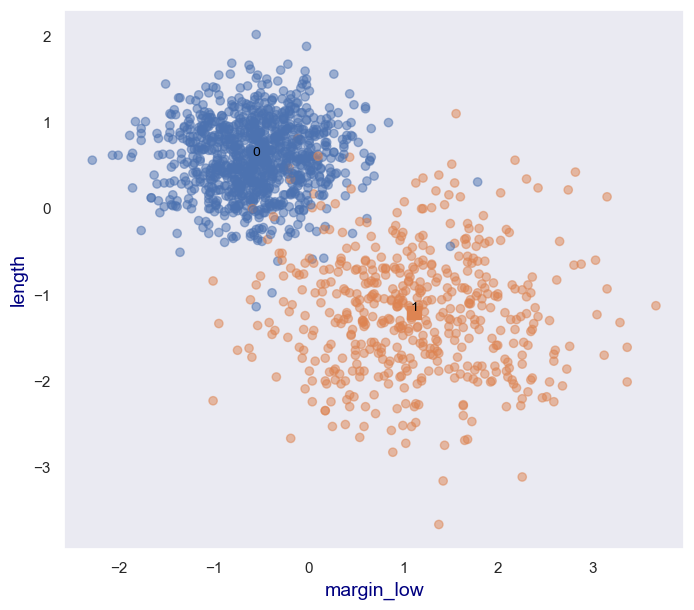

In [521]:
Axe_X = 3 # margin_low
Axe_Y = 5 # length

# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, Axe_X], 
    X_proj_temp.iloc[:, Axe_Y], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, Axe_X], 
    centroids_proj_temp.iloc[:, Axe_Y], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, Axe_X], 
        centroids_proj_temp.iloc[i, Axe_Y] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[Axe_X])
ax.set_ylabel(X_proj_temp.columns[Axe_Y])
plt.show()


On peut faire des graphiques à 3 dimensions :  
Pas de grand intérêt ici

Text(0.5, 0, 'length')

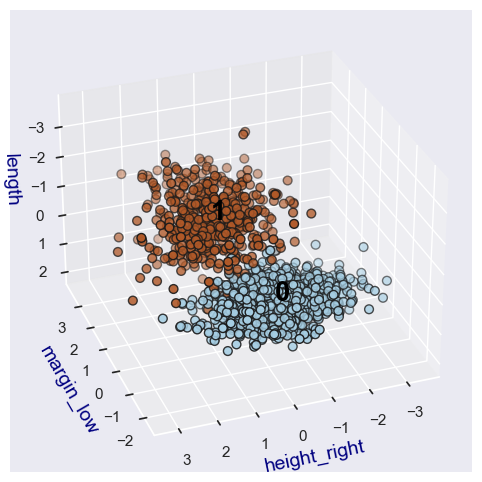

In [522]:
Axe_X = 2 # 
Axe_Y = 3 # 
Axe_Z = 5 # length


# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, Axe_X],
    X_proj_temp.iloc[:, Axe_Y],
    X_proj_temp.iloc[:, Axe_Z],
    c=X_proj_temp['labels'], cmap="Paired", edgecolor="k", s=40)


# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, Axe_X], 
           centroids_proj_temp.iloc[:, Axe_Y],  
           centroids_proj_temp.iloc[:, Axe_Z],  
           c=centroids_proj_temp['labels'],cmap="Paired", s=200,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, Axe_X], 
        centroids_proj_temp.iloc[i, Axe_Y], 
        centroids_proj_temp.iloc[i, Axe_Z], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=20, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel(X_proj_temp.columns[Axe_X])
ax.set_ylabel(X_proj_temp.columns[Axe_Y])
ax.set_zlabel(X_proj_temp.columns[Axe_Z])


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2one.6 - Visualisation des données projetées sur les axes Principaux: </h4>
</div>

Pas forcément un grand intérêt pour ce projet sinon voir P11

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2one.7 - Evaluation du clustering : Matrice de confusion </h4>
</div>

In [523]:
#la matrice d'origine avec la colone d'authenticité is_genuine :
df_billets_analyse_1_2['is_genuine'].head()

0    True
1    True
2    True
3    True
4    True
Name: is_genuine, dtype: bool

In [524]:
#la liste des labels de clusters dans le même ordre :
df_X_Orig_scaled_KM_N_temp['labels'].head()

0    1
1    0
2    0
3    0
4    0
Name: labels, dtype: int32

In [525]:
from sklearn.metrics import confusion_matrix

In [526]:
# ------------------------------
# 3. Évaluation du clustering
# ------------------------------
print("\nMatrice de confusion entre clusters et vérité terrain :")
mat_confusion = confusion_matrix(df_billets_analyse_1_2['is_genuine'], df_X_Orig_scaled_KM_N_temp['labels'])
print(mat_confusion)


Matrice de confusion entre clusters et vérité terrain :
[[ 13 487]
 [990  10]]


In [527]:
import pandas as pd

# Suppose que df_billets_analyse_1_2['is_genuine'] = True/False
# et df_X_Orig_scaled_KM_N_temp['labels'] = 0/1 issus du clustering

# Création d'un DataFrame temporaire
df_graph = pd.DataFrame({
    'Authenticité (Vérité terrain)': df_billets_analyse_1_2['is_genuine'].map({True: 'Vrai', False: 'Faux'}),
    'Cluster K-means': df_X_Orig_scaled_KM_N_temp['labels'].map({0: 'Cluster 0', 1: 'Cluster 1'})
})

# Matrice de confusion lisible
matrice_lisible = pd.crosstab(df_graph['Authenticité (Vérité terrain)'], df_graph['Cluster K-means'], margins=True)
print("\nMatrice de confusion lisible :\n")
print(matrice_lisible)



Matrice de confusion lisible :

Cluster K-means                Cluster 0  Cluster 1   All
Authenticité (Vérité terrain)                            
Faux                                  13        487   500
Vrai                                 990         10  1000
All                                 1003        497  1500


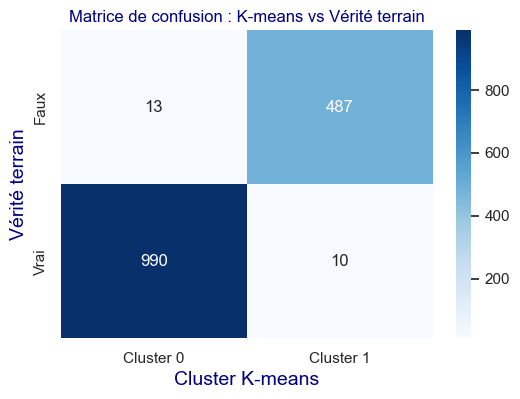

In [528]:
plt.figure(figsize=(6,4))
sns.heatmap(matrice_lisible.iloc[:-1, :-1], annot=True, fmt="d", cmap="Blues")
plt.title("Matrice de confusion : K-means vs Vérité terrain")
plt.ylabel("Vérité terrain")
plt.xlabel("Cluster K-means")
plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">5Orig.2bis - K-means Test à 2 clusters/random_state=8  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2bis.1 - K-means </h4>
</div>

Regardons maintenant les clusters que nous avons obtenus.

Nous devons d'abord ré-entrainer un estimateur:

In [529]:
n_clusters=2

In [530]:
df_X_Orig_scaled_KM_N_temp =df_X_Orig_scaled_KM.copy()

In [531]:
kmeans = KMeans(n_clusters=n_clusters,random_state=8
               )
kmeans.fit(df_X_Orig_scaled_KM_N_temp  )

,n_clusters,2
,init,'k-means++'
,n_init,'auto'
,max_iter,300
,tol,0.0001
,verbose,0
,random_state,8
,copy_x,True
,algorithm,'lloyd'


Voici les clusters : 

In [532]:
kmeans.labels_

array([0, 1, 1, ..., 0, 0, 0])

In [533]:
pd.Series(kmeans.labels_).value_counts()

1    1004
0     496
Name: count, dtype: int64

Ajoutons nos labels à `df_X_Orig_scaled_KM_N_temp  `

In [534]:
df_X_Orig_scaled_KM_N_temp  ["labels"] = kmeans.labels_
df_X_Orig_scaled_KM_N_temp  

,diagonal,height_left,height_right,margin_low,margin_up,length,labels
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651,0
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666,1
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901,1
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075,1
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750,1
...,...,...,...,...,...,...,...
1495,-0.683201,1.170713,0.767063,-0.095292,-0.265273,-1.602978,0
1496,0.758981,2.005822,1.596509,1.193295,0.942999,-1.958303,0
1497,-0.519316,-0.065250,0.613462,1.557132,0.899846,-0.835016,0
1498,0.332882,0.836669,0.429141,1.041697,1.331372,-0.491152,0


Affichons cela de façon graphique :

In [535]:
#Création d'une palette pour les labelles des clusters
Ordre_cluster_labels = (df_X_Orig_scaled_KM_N_temp  ["labels"].sort_values()).unique()

# Générer une palette 'muted' avec autant de couleurs que de catégories
couleurs_muted_cluster_labels = sns.color_palette("deep", len(Ordre_cluster_labels))

# Associer chaque produit à une couleur fixe dans un dictionnaire
palette_fixe_cluster_labels = dict(zip(Ordre_cluster_labels, couleurs_muted_cluster_labels))

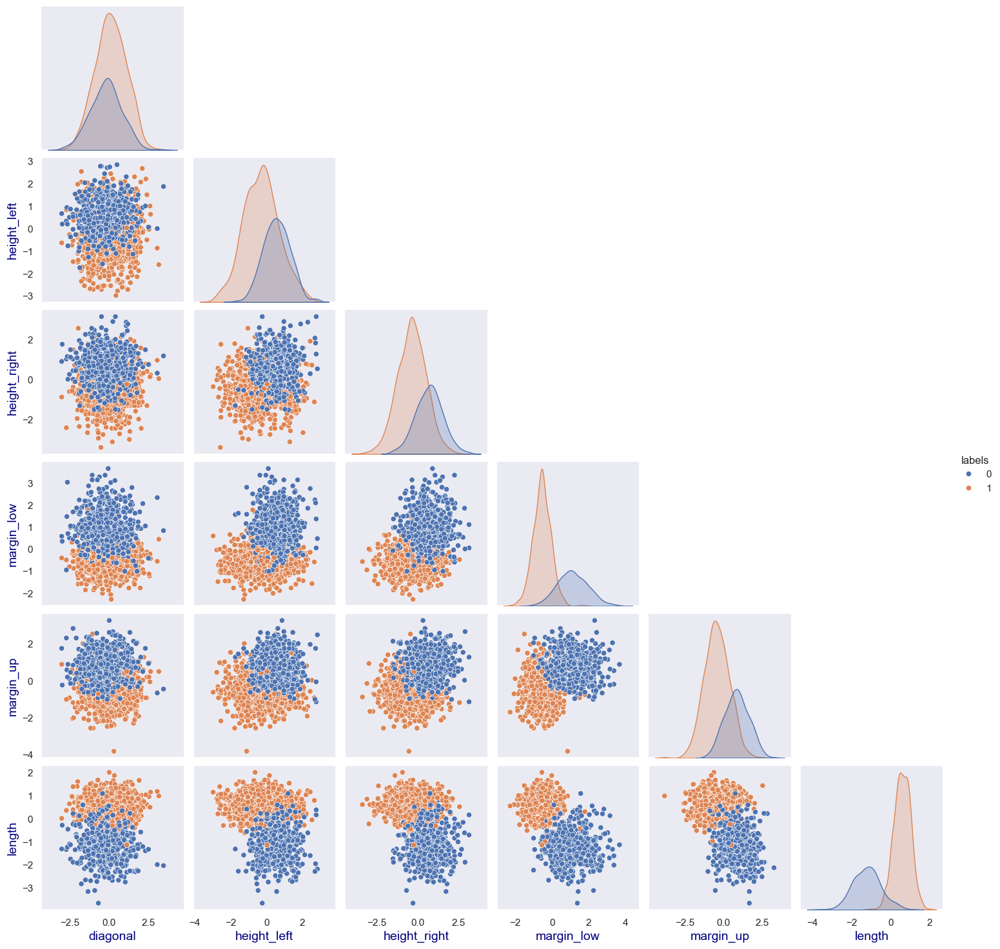

In [536]:
sns.pairplot(df_X_Orig_scaled_KM_N_temp  , 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2bis.2 - Interprétation: </h4>
</div>

In [537]:
df_X_Orig_scaled_KM_N_temp.head(2)

,diagonal,height_left,height_right,margin_low,margin_up,length,labels
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651,0
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666,1


CENTRE DE GRAVITE :

In [538]:
df_X_Orig_scaled_KM_N_temp_grouped = (df_X_Orig_scaled_KM_N_temp.groupby(by=['labels'])).mean()
df_X_Orig_scaled_KM_N_temp_grouped.index.name = 'cluster'
display(df_X_Orig_scaled_KM_N_temp_grouped)

,diagonal,height_left,height_right,margin_low,margin_up,length
cluster,,,,,,
0,-0.194323,0.570713,0.713365,1.120212,0.864176,-1.200833
1,0.096000,-0.281946,-0.352419,-0.553411,-0.426924,0.593240


LES CENTROIDES :

In [539]:
# On peut stocker nos centroids dans une variable : 
centroids = kmeans.cluster_centers_
centroids

array([[-0.19432338,  0.57071311,  0.71336493,  1.12021184,  0.86417597,
        -1.20083284],
       [ 0.09600039, -0.28194592, -0.35241933, -0.55341143, -0.42692359,
         0.59324013]])

**CENTROIDES du K-means= BARYCENTRE**  
les centroides calculés par le K-means sont bien les centre de gravité despoints du cluster

Nous pouvons passer à la partie visualisation. Pour ce faire, nous allons réaliser une ACP.

ATTENTION ICI : 
Mes données d'origine sont déjà des données projetées.  
Car j'ai choisie de prendre les données aprs PCA

In [540]:
df_temp = df_X_Orig_scaled_KM_N_temp  .copy()
df_temp.head()

,diagonal,height_left,height_right,margin_low,margin_up,length,labels
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651,0
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666,1
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901,1
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075,1
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750,1


In [541]:
df_temp_grouped =df_X_Orig_scaled_KM_N_temp_grouped.copy()
df_temp_grouped.head()

,diagonal,height_left,height_right,margin_low,margin_up,length
cluster,,,,,,
0,-0.194323,0.570713,0.713365,1.120212,0.864176,-1.200833
1,0.096000,-0.281946,-0.352419,-0.553411,-0.426924,0.593240


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2bis.3- Visualisation  : </h4>
</div>

**Liste des billets**

In [542]:
for i in range(0, n_clusters) : 
    # on fait une selection
    sub_df = df_temp.loc[df_temp.labels == i]

    # le cluster en question
    print(f"cluster {i} :")

    # on extrait les noms 
    names_list_temp = sub_df.index


    # on créé une liste de noms des pays
    txt = [f"{n} " for n in names_list_temp]

    # on transforme en str
    txt = " , ".join(txt)
 
    # on print
    print(txt)
    print("\n\n")

cluster 0 :
0  , 253  , 341  , 580  , 626  , 669  , 724  , 728  , 743  , 946  , 1000  , 1001  , 1002  , 1003  , 1004  , 1005  , 1006  , 1007  , 1008  , 1009  , 1010  , 1011  , 1012  , 1013  , 1014  , 1015  , 1016  , 1017  , 1018  , 1019  , 1020  , 1021  , 1022  , 1023  , 1024  , 1026  , 1027  , 1028  , 1029  , 1030  , 1031  , 1032  , 1033  , 1034  , 1035  , 1036  , 1037  , 1038  , 1039  , 1040  , 1041  , 1042  , 1043  , 1044  , 1045  , 1046  , 1047  , 1048  , 1049  , 1050  , 1051  , 1052  , 1053  , 1054  , 1055  , 1056  , 1057  , 1058  , 1059  , 1060  , 1061  , 1062  , 1063  , 1064  , 1065  , 1066  , 1067  , 1068  , 1069  , 1070  , 1071  , 1072  , 1074  , 1075  , 1076  , 1077  , 1078  , 1079  , 1080  , 1082  , 1084  , 1085  , 1086  , 1087  , 1088  , 1089  , 1090  , 1091  , 1092  , 1093  , 1094  , 1095  , 1096  , 1097  , 1098  , 1099  , 1100  , 1101  , 1102  , 1105  , 1106  , 1107  , 1108  , 1109  , 1110  , 1111  , 1112  , 1113  , 1114  , 1115  , 1116  , 1117  , 1118  , 1119  , 1120  , 

**HEATMAP**

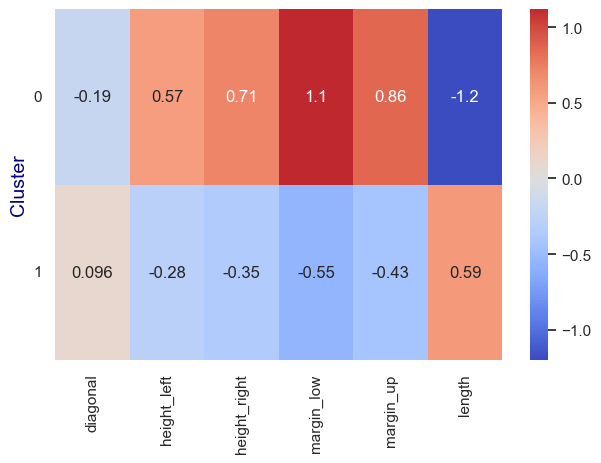

In [543]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap='coolwarm',
            center =0 
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

**RADAR**

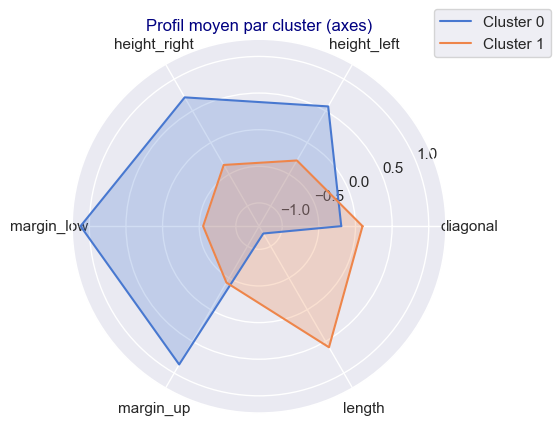

In [544]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

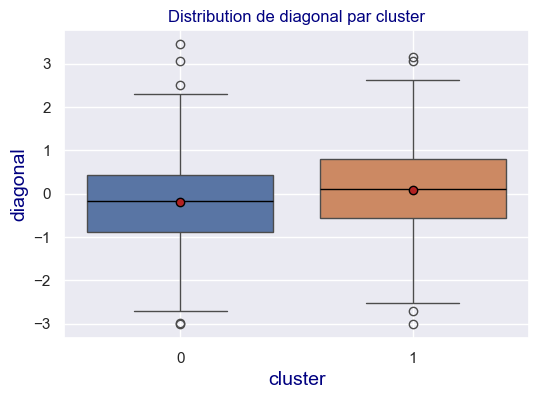

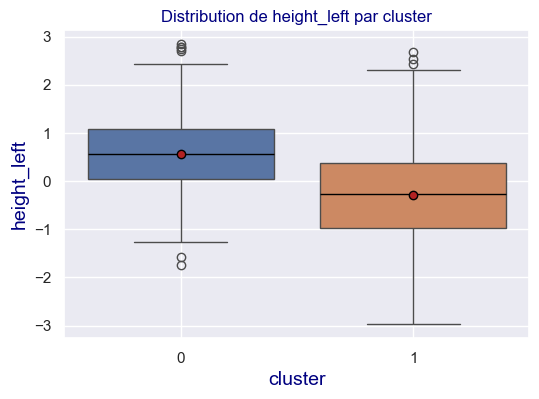

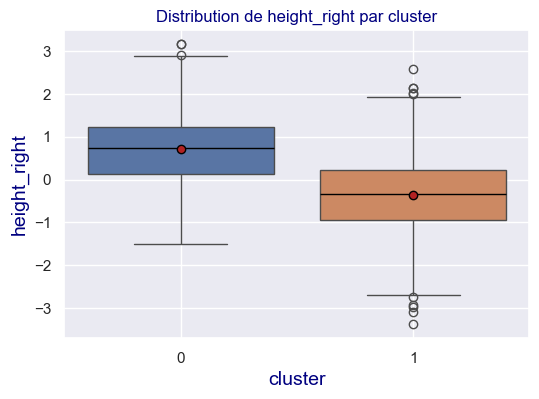

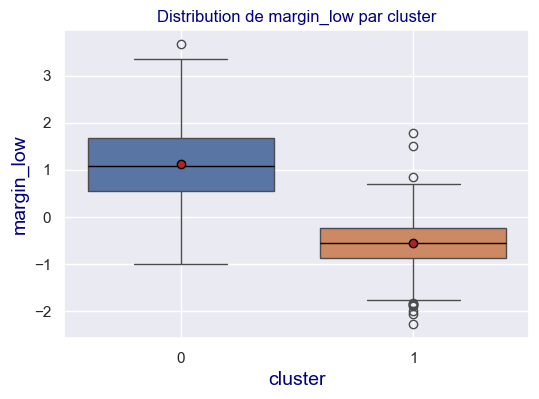

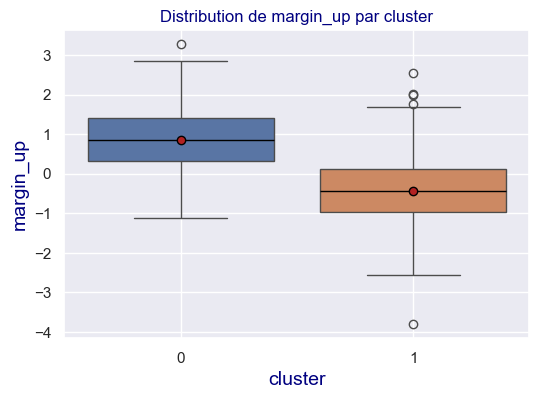

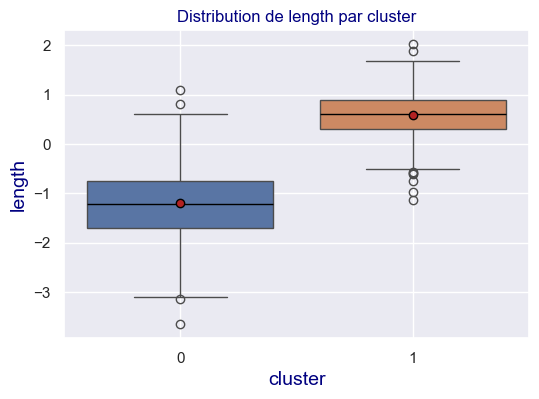

In [545]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

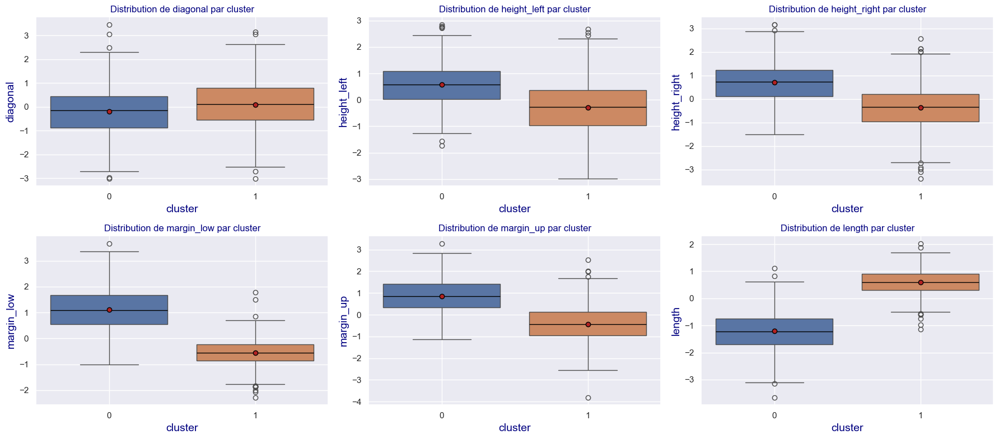

In [546]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Liste des variables à afficher (hors "labels")
variables = df_temp.columns.drop("labels", errors='ignore')
n = len(variables)

# Définir le nombre de lignes et de colonnes
n_cols = 3
n_rows = math.ceil(n / n_cols)

# Créer la figure
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 4))
axes = axes.flatten()  # pour indexer facilement

for i, col in enumerate(variables):
    ax = axes[i]
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                ax=ax,
                medianprops = {'color':"black"},
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},
                showmeans =True,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
                legend=False)
    ax.set_title(f"Distribution de {col} par cluster")
    ax.set_xlabel("cluster")
    ax.grid(True)

# Supprimer les axes vides s’il y a moins de 4 variables
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2bis.4 - Visualisation des données centrées réduites : </h4>
</div>

##### **PROJECTIONS**

Je pourrais faire une PCA pour voir le maximum d'inertie.  
Mais je ne sais pas si c'est utile de faire une PCA juste pour ça (c'est utile pour réduire les variables).  
Mais sinon avec le boxplot j'ai déjà des axes qui pourraient mêtre utile pour visualiser.

Je pourrais faire une PCA pour voir le maximum d'inertie.  
Mais je ne sais pas si c'est utile de faire une PCA juste pour ça (c'est utile pour réduire les variables).  
Mais sinon avec le boxplot j'ai déjà des axes qui pourraient mêtre utile pour visualiser.

In [547]:
X_proj_temp = df_temp.copy()

In [548]:
X_proj_temp.head()

,diagonal,height_left,height_right,margin_low,margin_up,length,labels
0,-0.486540,2.774123,3.163240,0.056306,-1.128325,0.173651,0
1,-1.633729,-2.236535,-0.799668,-1.080683,-0.696799,0.471666,1
2,2.397823,1.504756,-1.291191,-0.125612,-0.912562,0.551901,1
3,-1.961498,-0.399294,0.060498,-1.308081,-0.610494,0.953075,1
4,-0.748754,0.836669,-1.414072,-0.671367,1.417677,-0.158750,1


In [549]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,diagonal,height_left,height_right,margin_low,margin_up,length
cluster,,,,,,
0,-0.194323,0.570713,0.713365,1.120212,0.864176,-1.200833
1,0.096000,-0.281946,-0.352419,-0.553411,-0.426924,0.593240


In [550]:
#centroids_proj_temp['labels']=range(0,n_clusters)
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,diagonal,height_left,height_right,margin_low,margin_up,length,labels
cluster,,,,,,,
0,-0.194323,0.570713,0.713365,1.120212,0.864176,-1.200833,0
1,0.096000,-0.281946,-0.352419,-0.553411,-0.426924,0.593240,1


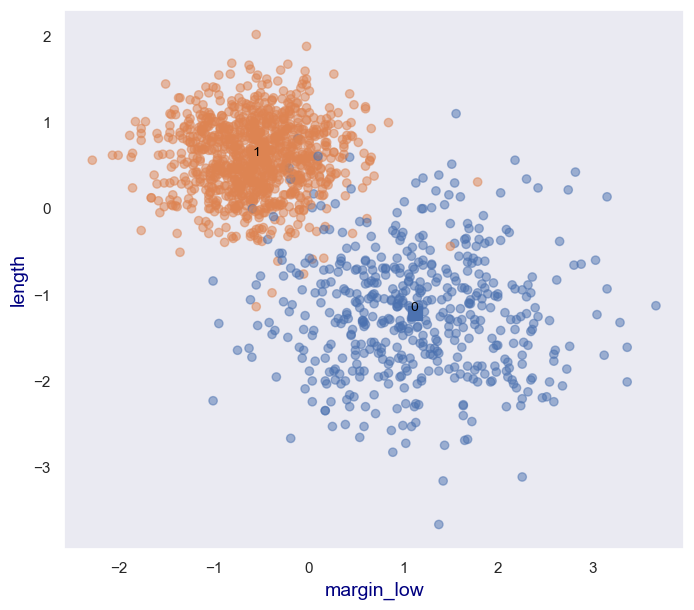

In [551]:
Axe_X = 3 # margin_low
Axe_Y = 5 # length

# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, Axe_X], 
    X_proj_temp.iloc[:, Axe_Y], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, Axe_X], 
    centroids_proj_temp.iloc[:, Axe_Y], 
    marker="s", 
    c=colors_centroids,
    s=100
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, Axe_X], 
        centroids_proj_temp.iloc[i, Axe_Y] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=10, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel(X_proj_temp.columns[Axe_X])
ax.set_ylabel(X_proj_temp.columns[Axe_Y])
plt.show()


On peut faire des graphiques à 3 dimensions :  
Pas de grand intérêt ici

Text(0.5, 0, 'length')

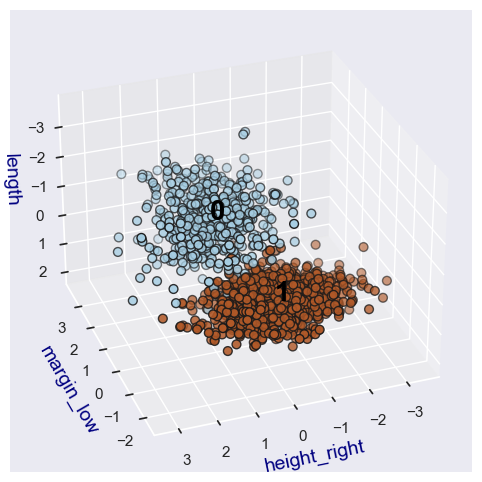

In [552]:
Axe_X = 2 # 
Axe_Y = 3 # 
Axe_Z = 5 # length


# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, Axe_X],
    X_proj_temp.iloc[:, Axe_Y],
    X_proj_temp.iloc[:, Axe_Z],
    c=X_proj_temp['labels'], cmap="Paired", edgecolor="k", s=40)


# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, Axe_X], 
           centroids_proj_temp.iloc[:, Axe_Y],  
           centroids_proj_temp.iloc[:, Axe_Z],  
           c=centroids_proj_temp['labels'],cmap="Paired", s=200,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, Axe_X], 
        centroids_proj_temp.iloc[i, Axe_Y], 
        centroids_proj_temp.iloc[i, Axe_Z], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=20, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel(X_proj_temp.columns[Axe_X])
ax.set_ylabel(X_proj_temp.columns[Axe_Y])
ax.set_zlabel(X_proj_temp.columns[Axe_Z])


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2bis.6 - Visualisation des données projetées sur les axes Principaux: </h4>
</div>

Pas forcément un grand intérêt pour ce projet sinon voir P11

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 5Orig.2bis.7 - Evaluation du clustering : Matrice de confusion </h4>
</div>

In [553]:
#la matrice d'origine avec la colone d'authenticité is_genuine :
df_billets_analyse_1_2['is_genuine'].head()

0    True
1    True
2    True
3    True
4    True
Name: is_genuine, dtype: bool

In [554]:
#la liste des labels de clusters dans le même ordre :
df_X_Orig_scaled_KM_N_temp['labels'].head()

0    0
1    1
2    1
3    1
4    1
Name: labels, dtype: int32

In [555]:
from sklearn.metrics import confusion_matrix

In [556]:
# ------------------------------
# 3. Évaluation du clustering
# ------------------------------
print("\nMatrice de confusion entre clusters et vérité terrain :")
mat_confusion = confusion_matrix(df_billets_analyse_1_2['is_genuine'], df_X_Orig_scaled_KM_N_temp['labels'])
print(mat_confusion)


Matrice de confusion entre clusters et vérité terrain :
[[486  14]
 [ 10 990]]


In [557]:
import pandas as pd

# Suppose que df_billets_analyse_1_2['is_genuine'] = True/False
# et df_X_Orig_scaled_KM_N_temp['labels'] = 0/1 issus du clustering

# Création d'un DataFrame temporaire
df_graph = pd.DataFrame({
    'Authenticité (Vérité terrain)': df_billets_analyse_1_2['is_genuine'].map({True: 'Vrai', False: 'Faux'}),
    'Cluster K-means': df_X_Orig_scaled_KM_N_temp['labels'].map({0: 'Cluster 0', 1: 'Cluster 1'})
})

# Matrice de confusion lisible
matrice_lisible = pd.crosstab(df_graph['Authenticité (Vérité terrain)'], df_graph['Cluster K-means'], margins=True)
print("\nMatrice de confusion lisible :\n")
print(matrice_lisible)



Matrice de confusion lisible :

Cluster K-means                Cluster 0  Cluster 1   All
Authenticité (Vérité terrain)                            
Faux                                 486         14   500
Vrai                                  10        990  1000
All                                  496       1004  1500


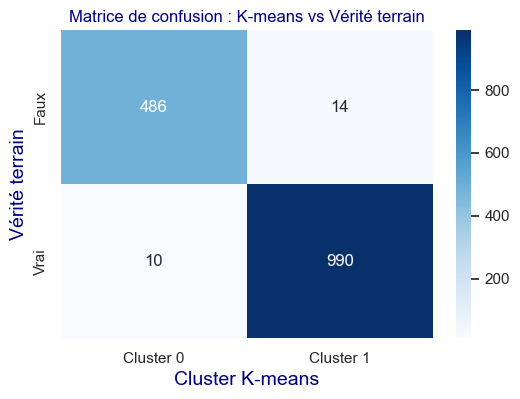

In [558]:
plt.figure(figsize=(6,4))
sns.heatmap(matrice_lisible.iloc[:-1, :-1], annot=True, fmt="d", cmap="Blues")
plt.title("Matrice de confusion : K-means vs Vérité terrain")
plt.ylabel("Vérité terrain")
plt.xlabel("Cluster K-means")
plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); "> 5Orig.3 - Bilan </h3>
</div>

**Remarque :**  
Tester avec plusieurs initialisation aléatoires, et plusieurs random-state différents.  
On tombe sur les mêmes ordres de grandeurs, parfois c'est le cluster 1 qui représente les Vrai billets, parfois le Cluster 0.  

**Observation :**  
On observe une erreur de l'ordre de 1,4% de Vrai billets annoncé Faux à tord,  
Et une erreur de l'ordre de 0,6% de Faux billets annoncé Vrai à tord.  
Cela donne déjà une bonne indication avec moins de 1% d'erreur.  

**PAS DE CHANGEMENT NOTABLE avec les données sur PCA ou sur Donnees Originales CentréeRduites  
et avec différentes random_state de K-means**

<u>**SCORES**</u>  
Sur la Matrice de confusion du K-means Orig_2bis (données originales scalées par StandardScaler)  
[[486  14]  
 [ 10 990]  ]
Si on veut calculer des Scores, on a :  

**Le TPR(Rappel-Recal  Taux de Vrais positifs):**  
TPR =TP / (TP + FN)  =990/990+10=0.99  
99% de positifs détectés parmis les positifs réels.  
**99% des Vrais billets sont bien détectés positifs**  
Seul 1% des Vrais billets sont déclarés Faux Taux de Faux Negatifs = 1%.  
  
**le FPR(Taux de Faux Positifs):**  
FPR=FP/(FP+TN)=14/(14+486)=0.028  
**le FPR, Taux de Faux Positifs est de 2,8%**  
2,8% des Faux billlets sont déclarés à tord de vrai billets




**La précision :**  
=TP/(TP+FP)=990/(990+14)=990/1004=0.9861  
**98.6% des Billets déclarés vrais le sont vraiment.**  
Il y a 1.4% des billets déclarés Vrai qui ne le sont pas.  

**Remarque supplémentaire :**   
TN/(TN+FP) = 486/(486+14)=486/500=0.972  
**97,2% des Faux billets sont détectés comme Faux billets.**  

**=>Avec un simple K-means, on a déjà des résultats honnêtes.**

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 6 - Regression logisitque -benchmark </h2>
</div>

Une première régression logisitque

RAPPEL DES DONNEES : `df_billets_analyse_1_2`  
Le fichier des données complétés par regression linéaire.

TRAVAILLONS SUR UNE Copie :

In [559]:
df_billets_analyse_1_2_copy = df_billets_analyse_1_2.copy(deep=True)

In [560]:
df_billets_analyse_1_2_copy.head()

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09
2,True,172.69,104.48,103.50,4.40,2.94,113.16
3,True,171.36,103.91,103.94,3.62,3.01,113.51
4,True,171.73,104.28,103.46,4.04,3.48,112.54


In [561]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1( df_billets_analyse_1_2_copy )

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1500,0,322,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


In [562]:
Premieres_Analyses( df_billets_analyse_1_2_copy )


---- SHAPE ----


(1500, 7)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500 entries, 0 to 1499
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   is_genuine    1500 non-null   bool   
 1   diagonal      1500 non-null   float64
 2   height_left   1500 non-null   float64
 3   height_right  1500 non-null   float64
 4   margin_low    1500 non-null   float64
 5   margin_up     1500 non-null   float64
 6   length        1500 non-null   float64
dtypes: bool(1), float64(6)
memory usage: 71.9 KB

---- DESCRIBE ----


,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.00000
mean,171.958440,104.029533,103.920307,4.482858,3.151473,112.67850
std,0.305195,0.299462,0.325627,0.659857,0.231813,0.87273
min,171.040000,103.140000,102.820000,2.980000,2.270000,109.49000
25%,171.750000,103.820000,103.710000,4.027500,2.990000,112.03000
50%,171.960000,104.040000,103.920000,4.310000,3.140000,112.96000
75%,172.170000,104.230000,104.150000,4.870000,3.310000,113.34000
max,173.010000,104.880000,104.950000,6.900000,3.910000,114.44000



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1500,0,322,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


In [563]:
df_billets_analyse_1_2_copy.columns

Index(['is_genuine', 'diagonal', 'height_left', 'height_right', 'margin_low',
       'margin_up', 'length'],
      dtype='object')

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">6.1 - Modèle RL_A : Regression logistique avec toutes variables numériques Non Scalées</h3>
</div>

<u>**Modèle RL_A**</u> 

In [564]:
#listes des variables prédictives pour le modèle RL_A : toutes les var quantitatives
var_pred_RL_A = ['diagonal', 
                'height_left', 'height_right', 
                'margin_low','margin_up', 
                'length']
#la variable cible :
var_cible = 'is_genuine'

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.1.1 - Préparation des données : </h4>
</div>

In [565]:
#le jeu de données prédictif complet:
X = (df_billets_analyse_1_2_copy[var_pred_RL_A]).copy(deep=True)

#le jeu de données cible réel en convertissant les False en 0 et les True en 1
y = (df_billets_analyse_1_2_copy[var_cible]).copy(deep=True)
y = y.astype(int) #conversion des False / True en 0 /1

In [566]:
print(X.shape)
print('---')
print(type(X))
print('---')
print(X.head())

(1500, 6)
---
<class 'pandas.core.frame.DataFrame'>
---
   diagonal  height_left  height_right  margin_low  margin_up  length
0    171.81       104.86        104.95        4.52       2.89  112.83
1    171.46       103.36        103.66        3.77       2.99  113.09
2    172.69       104.48        103.50        4.40       2.94  113.16
3    171.36       103.91        103.94        3.62       3.01  113.51
4    171.73       104.28        103.46        4.04       3.48  112.54


Les données ne sont pas dans des ordres de grandeurs trop différentes, faisons un premier test sans scaler les données.

In [567]:
print(y.shape)
print('---')
print(type(y))
print('---')
print(y.head())

(1500,)
---
<class 'pandas.core.series.Series'>
---
0    1
1    1
2    1
3    1
4    1
Name: is_genuine, dtype: int32


In [568]:
from sklearn.model_selection import train_test_split

SEPARATION en jeu_TRAIN, et jeu_TEST

In [569]:
# split train, test
# proportion du jeu test : 0.2
#random_state : 42 pour pouvoir reproduire (une fois testé avec différent random_state)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.1.2 - Regresion logistique  : </h4>
</div>

In [570]:
from sklearn.linear_model import LogisticRegression

In [571]:
# initialisation et entraînement en une ligne
clf_RL_A = LogisticRegression(max_iter=1000,random_state=42)
clf_RL_A.fit(X_train, y_train)

,penalty,'l2'
,dual,False
,tol,0.0001
,C,1.0
,fit_intercept,True
,intercept_scaling,1
,class_weight,None
,random_state,42
,solver,'lbfgs'
,max_iter,1000
,multi_class,'deprecated'


In [572]:
model = clf_RL_A

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.1.3 -Observations  : </h4>
</div>

Observation de la prédiction et de sa probabilité pour 1 échantillon du jeu total de donnée :

**PREDICTIONS :**

In [573]:
y_test_pred = model.predict(X_test)

In [574]:
y_test_pred[:5]

array([0, 0, 1, 1, 1])

**PROBA DE PREDICTIONS :**

In [575]:
# les 5 premières lignes de model.predict_proba(X_test)
model.predict_proba(X_test) [:5]

array([[0.99857804, 0.00142196],
       [0.99492727, 0.00507273],
       [0.00432661, 0.99567339],
       [0.0050083 , 0.9949917 ],
       [0.00143307, 0.99856693]])

In [576]:
# les 5 premières lignes de  la première colonne de model.predict_proba(X_test)
model.predict_proba(X_test) [:5,1]

array([0.00142196, 0.00507273, 0.99567339, 0.9949917 , 0.99856693])

In [577]:
#Array des probas de valoir 1
y_test_proba = model.predict_proba(X_test)[:,1] # la 2ème colonne des probas

Un bon moyen d'analyser les performances d'un modèle de classification est de tracer l'histogramme des probabilités des prédictions.

Text(0.5, 1.0, 'Répartitions des probas de valoir 1 sur le jeu de test')

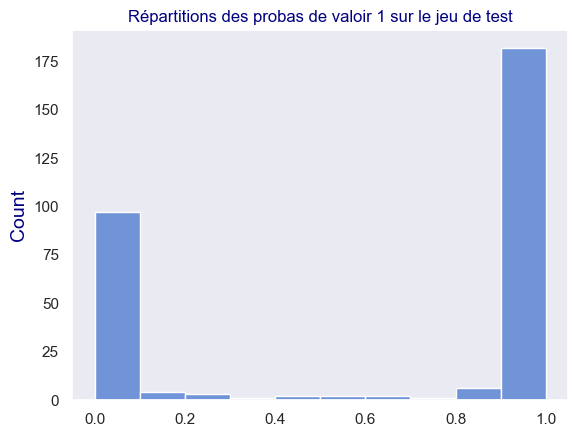

In [578]:
#Répartitions des probas de valoir 1 sur le jeu de test

sns.histplot(y_test_proba)
plt.title("Répartitions des probas de valoir 1 sur le jeu de test")

Le modèle est assez confiant de ses prédiction sur le jeu de test :  
la plupart des prédictions ont une probabilité proche de 0 ou de 1

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.1.4 - Score de performance : Exactitude(accuracy) </h4>
</div>

In [579]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_auc_score, roc_curve

Le plus simple pour mesurer la performance d'une classification est de regarder  
L'**exactitude(accuracy)**, c'est la proportion d'échantillons bien classé :  
exactitude = (échantillons bien classés)/échantillons au total

In [580]:
from sklearn.metrics import accuracy_score

In [581]:
print("Score d'Exactitude-accuracy sur le jeu test = ",accuracy_score(y_test, y_test_pred))

Score d'Exactitude-accuracy sur le jeu test =  0.99


**OBSERVATION :**  
99% d'échantilons bien classés sur le jeu test, très bonne performance

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.1.5 - Matrice de confusion </h4>
</div>

In [582]:
from sklearn.metrics import confusion_matrix

Attention la matrice de confusion pour scikit-learn est :  
TN | FP  
FN | TP  

In [583]:
confusion_matrix(y_test, y_test_pred)

array([[107,   3],
       [  0, 190]], dtype=int64)

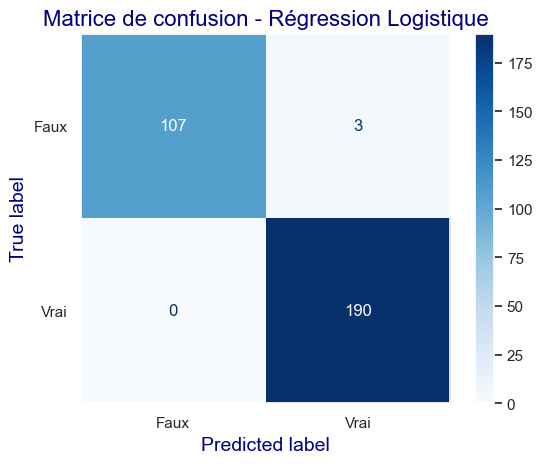

In [584]:
ConfusionMatrixDisplay.from_predictions(
    y_test, y_test_pred, display_labels=['Faux', 'Vrai'], cmap='Blues'
)
plt.title("Matrice de confusion - Régression Logistique",size=16)
plt.show()

In [585]:
# Matrice de confusion
tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred).ravel()

# Calculs
TPR = tp / (tp + fn) if (tp + fn) != 0 else 0
FPR = fp / (fp + tn) if (fp + tn) != 0 else 0

# Affichage
print(f"TPR (Recall / Taux de Vrai Positifs) : {TPR:.3f}")
print(f"FPR (Taux de faux positifs) : {FPR:.3f}")

TPR (Recall / Taux de Vrai Positifs) : 1.000
FPR (Taux de faux positifs) : 0.027


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.1.6 -  Autres metriques de classification : </h4>
</div>

Precision, Recall et ROC_AUC

In [586]:
from sklearn.metrics import precision_score, recall_score, roc_auc_score

<u>**Le Rappel-recall ou TPR(True Positive Rate):**</u>  
Rappel = TP/(TP+FN)  
= Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  
Compris entre 0 et 1.  
Plus il augmente plus cela minimise les Faux négatifs.  
(plus FN augmente, plus Rappel baisse)  
Plus on diminue le seuil de détection des positifs, plus on diminuera FN, plus on augmentera le Rappel.  

<u>**La Précision :**</u>  
Précision = TP/(TP+FP)  
= Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
Compris entre 0 et 1.  
plus il augmente, plus cela minimise lse Faux positifs.  
(plus FP augmente, plus la précision baisse)  
Plus on augmente le seuil de détection des positifs,  
plus on diminuera les FP,  plus on augmentera La Précision.  



**TPR(True Positive Rate)=Recall**  
TPR= TP / (TP + FN) (Taux de Positifs détectés parmi les positifs réels)
Plus TPR est haut, mieux c'est.  

**FPR(False Positive Rate)**  
FPR=  FP / (FP+TN)   (Taux de Faux positifs parmis les négatifs réels)
Plus FPR, est bas, mieux c'est.  

**Courbe ROC (Receiver Operating Characteristic) ou encore fonction d’efficacité du récepteur**  
TPR en fonction de FPR

<u>**ROC_AUC : Area under the ROC ou surface sous la courbe ROC**</u>  
Compris entre 0 et 1.  

Plus elle est proche de 1 mieux c'est :   
- Cela signifie que l'on peut trouver un TPR élevé pour un FPR bas.

Pour une courbe plus basse (0.5 ou au dessous) :
- avoir un TPR élevé se fait au prix d’un FPR élevé   ; 
-avoir une FPR bas se fait au prix d’un TPR bas.


In [587]:
print("Recall : ",recall_score(y_test, y_test_pred))
print("Precision : ",precision_score(y_test, y_test_pred))
print("ROC-AUC : ", roc_auc_score(y_test, model.predict_proba(X_test)[:, 1]))

Recall :  1.0
Precision :  0.9844559585492227
ROC-AUC :  0.9996650717703349


**OBSERVATION :**  
- Très bon Recall (proche de 1)  
(TPR)(Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  )   
- Très bonne Précision (proche de 1)  
Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
- Très bon ROC (proche de 1)  
on peut trouver un TPR((True Positive Rate) élevé pour un FPR(False Positive Rate) bas.

**Courbe ROC :**

In [588]:
from sklearn.metrics import roc_curve

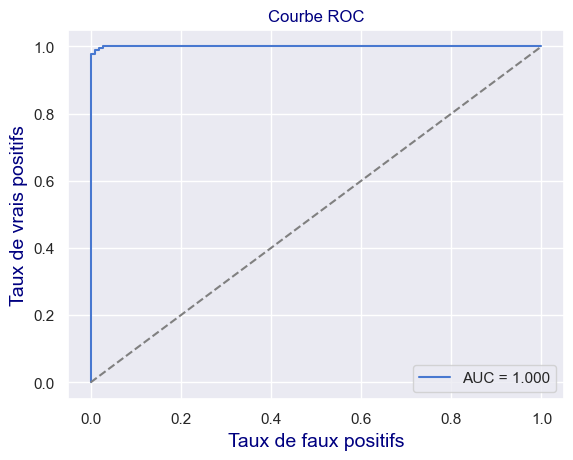

In [589]:
#La Courbe ROC-AUC

#y_test_proba = model.predict_proba(X_test)[:,1])

fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test)[:,1])

plt.plot(fpr, tpr, label=f"AUC = {roc_auc_score(y_test, model.predict_proba(X_test)[:,1] ):.3f}")
plt.plot([0,1], [0,1], linestyle='--', color='gray')
plt.xlabel("Taux de faux positifs")
plt.ylabel("Taux de vrais positifs")
plt.title("Courbe ROC")
plt.legend()
plt.grid()
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.1.7 - Rapport de classification : </h4>
</div>

In [590]:
from sklearn.metrics import classification_report

In [591]:
print(classification_report(y_test, y_test_pred, digits=3))

              precision    recall  f1-score   support

           0      1.000     0.973     0.986       110
           1      0.984     1.000     0.992       190

    accuracy                          0.990       300
   macro avg      0.992     0.986     0.989       300
weighted avg      0.990     0.990     0.990       300



<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.1.8 - Analyse des coefficients (importance des variables) : </h4>
</div>

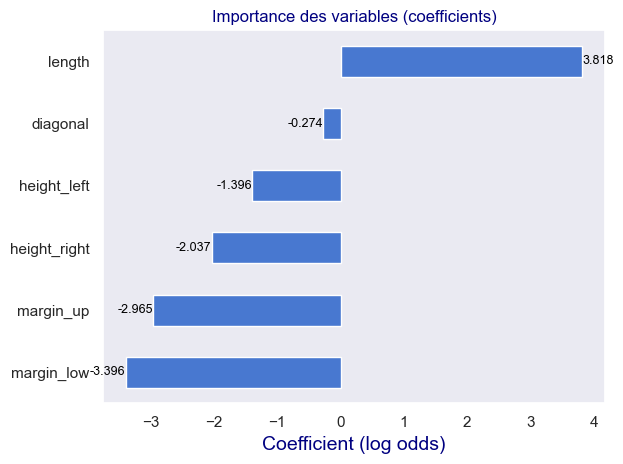

In [592]:
# Création de la série des coefficients
coeffs = pd.Series(model.coef_[0], index=X.columns)
coeffs_sorted = coeffs.sort_values()

# Création du graphique
ax = coeffs_sorted.plot(kind='barh', title="Importance des variables (coefficients)")
plt.xlabel("Coefficient (log odds)")

# Ajout des annotations (valeurs numériques sur les barres)
for i, (value, name) in enumerate(zip(coeffs_sorted, coeffs_sorted.index)):
    ax.text(x=value,                      # Position horizontale du texte
            y=i,                          # Position verticale (index de la barre)
            s=f"{value:.3f}",             # Texte à afficher (arrondi à 3 décimales)
            va='center', ha='left' if value > 0 else 'right',
            fontsize=9, color='black')

plt.tight_layout()
plt.show()

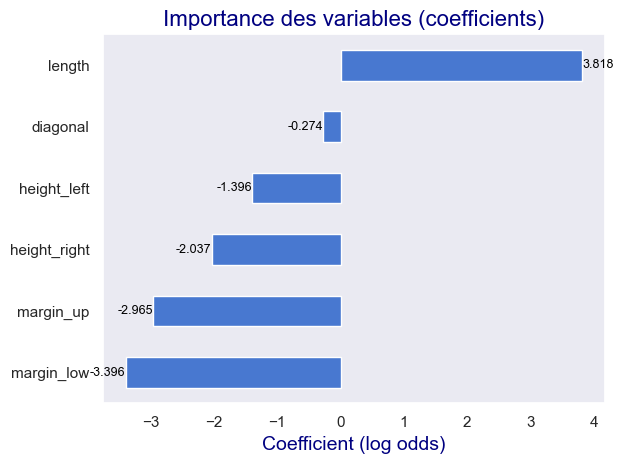

In [593]:
# Création de la série des coefficients
coeffs = pd.Series(model.coef_[0], index=X.columns)
coeffs_sorted = coeffs.sort_values()

# Création du graphique
ax = coeffs_sorted.plot(kind='barh', title="Importance des variables (coefficients)")#,figsize=(6,3))
plt.xlabel("Coefficient (log odds)")

# Ajout des annotations (valeurs numériques sur les barres)
for i, (value, name) in enumerate(zip(coeffs_sorted, coeffs_sorted.index)):
    ax.text(x=value,                      # Position horizontale du texte
            y=i,                          # Position verticale (index de la barre)
            s=f"{value:.3f}",             # Texte à afficher (arrondi à 3 décimales)
            va='center', ha='left' if value > 0 else 'right',
            fontsize=9, color='black')

plt.title("Importance des variables (coefficients)",size=16)
plt.tight_layout()
plt.show()

La variable `diagonal` semble avoir peu d'impact sur la prédiction Vrai/Faux billet.

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">6.2 - Modèle RL_B : Regression logistique avec toutes les variables numériques sur données scalées StandardScaler</h3>
</div>

Théoriquement c'est mieux de scalées nos données mais dans notre cas les données sont dans les mêmes ordres de grandeurs.

<u>**Modèle RL_B**</u> 

In [594]:
#listes des variables prédictives pour le modèle RL_B : toutes les var quantitatives
var_pred_RL_B = ['diagonal', 
                'height_left', 'height_right', 
                'margin_low','margin_up', 
                'length']
#la variable cible :
var_cible = 'is_genuine'

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.2.1 - Préparation des données : </h4>
</div>

In [595]:
#le jeu de données prédictif complet:
X = (df_billets_analyse_1_2_copy[var_pred_RL_B]).copy(deep=True)

#le jeu de données cible réel en convertissant les False en 0 et les True en 1
y = (df_billets_analyse_1_2_copy[var_cible]).copy(deep=True)
y = y.astype(int) #conversion des False / True en 0 /1

In [596]:
print(X.shape)
print('---')
print(type(X))
print('---')
print(X.head())

(1500, 6)
---
<class 'pandas.core.frame.DataFrame'>
---
   diagonal  height_left  height_right  margin_low  margin_up  length
0    171.81       104.86        104.95        4.52       2.89  112.83
1    171.46       103.36        103.66        3.77       2.99  113.09
2    172.69       104.48        103.50        4.40       2.94  113.16
3    171.36       103.91        103.94        3.62       3.01  113.51
4    171.73       104.28        103.46        4.04       3.48  112.54


In [597]:
print(y.shape)
print('---')
print(type(y))
print('---')
print(y.head())

(1500,)
---
<class 'pandas.core.series.Series'>
---
0    1
1    1
2    1
3    1
4    1
Name: is_genuine, dtype: int32


In [598]:
from sklearn.model_selection import train_test_split

SEPARATION en jeu_TRAIN, et jeu_TEST

In [599]:
# split train, test
# proportion du jeu test : 0.2
#random_state : 42 pour pouvoir reproduire (une fois testé avec différent random_state)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

In [600]:
from sklearn.preprocessing import StandardScaler

In [601]:
scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.2.2 - Regression logistique  : </h4>
</div>

In [602]:
from sklearn.linear_model import LogisticRegression

In [603]:
# initialisation et entraînement en une ligne
clf_RL_B = LogisticRegression(max_iter=1000,random_state=42)
clf_RL_B.fit(X_train_scaled, y_train)

,penalty,'l2'
,dual,False
,tol,0.0001
,C,1.0
,fit_intercept,True
,intercept_scaling,1
,class_weight,None
,random_state,42
,solver,'lbfgs'
,max_iter,1000
,multi_class,'deprecated'


In [604]:
model = clf_RL_B

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.2.3 -Observations  : </h4>
</div>

Observation de la prédiction et de sa probabilité pour 1 échantillon du jeu total de donnée :

**PREDICTIONS :**

In [605]:
y_test_pred = model.predict(X_test_scaled)

In [606]:
y_test_pred[:5]

array([0, 0, 1, 1, 1])

**PROBA DE PREDICTIONS :**

In [607]:
# les 5 premières lignes de model.predict_proba(X_test_scaled)
model.predict_proba(X_test_scaled) [:5]

array([[9.99577491e-01, 4.22509212e-04],
       [9.98374940e-01, 1.62505990e-03],
       [1.49030257e-03, 9.98509697e-01],
       [2.20394967e-03, 9.97796050e-01],
       [1.58978029e-04, 9.99841022e-01]])

In [608]:
# les 5 premières lignes de  la première colonne de model.predict_proba(X_test_scaled)
model.predict_proba(X_test_scaled) [:5,1]

array([4.22509212e-04, 1.62505990e-03, 9.98509697e-01, 9.97796050e-01,
       9.99841022e-01])

In [609]:
#Array des probas de valoir 1
y_test_proba = model.predict_proba(X_test_scaled)[:,1] # la 2ème colonne des probas

Un bon moyen d'analyser les performances d'un modèle de classification est de tracer l'histogramme des probabilités des prédictions.

Text(0.5, 1.0, 'Répartitions des probas de valoir 1 sur le jeu de test')

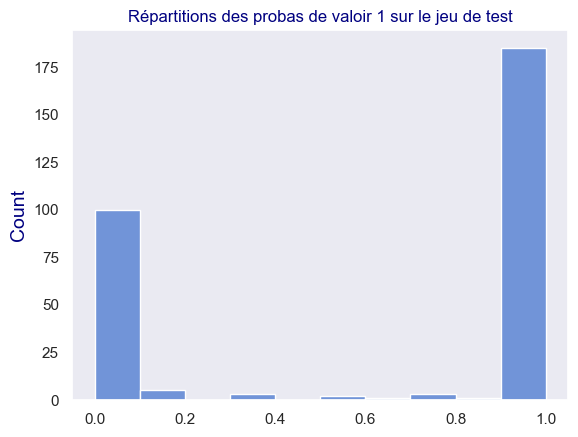

In [610]:
#Répartitions des probas de valoir 1 sur le jeu de test

sns.histplot(y_test_proba)
plt.title("Répartitions des probas de valoir 1 sur le jeu de test")

Le modèle est assez confiant de ses prédiction sur le jeu de test :  
la plupart des prédictions ont une probabilité proche de 0 ou de 1

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.2.4 - Score de performance : Exactitude(accuracy) </h4>
</div>

In [611]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_auc_score, roc_curve

Le plus simple pour mesurer la performance d'une classification est de regarder  
L'**exactitude(accuracy)**, c'est la proportion d'échantillons bien classé :  
exactitude = (échantillons bien classés)/échantillons au total

In [612]:
from sklearn.metrics import accuracy_score

In [613]:
print("Score d'Exactitude-accuracy sur le jeu test = ",accuracy_score(y_test, y_test_pred))

Score d'Exactitude-accuracy sur le jeu test =  0.9933333333333333


**OBSERVATION :**  
99% d'échantilons bien classés sur le jeu test, très bonne performance

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.2.5 - Matrice de confusion </h4>
</div>

In [614]:
from sklearn.metrics import confusion_matrix

Attention la matrice de confusion pour scikit-learn est :  
TN | FP  
FN | TP  

In [615]:
confusion_matrix(y_test, y_test_pred)

array([[108,   2],
       [  0, 190]], dtype=int64)

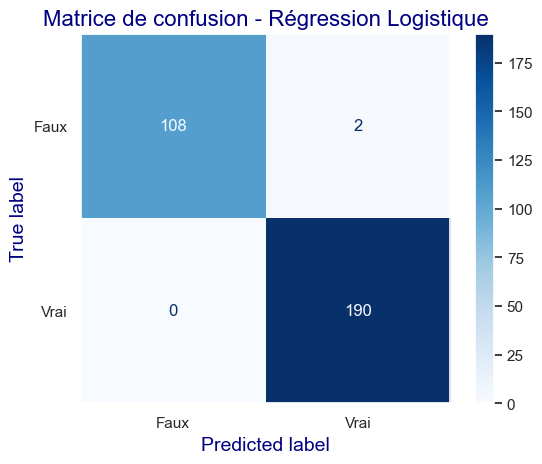

In [616]:
ConfusionMatrixDisplay.from_predictions(
    y_test, y_test_pred, display_labels=['Faux', 'Vrai'], cmap='Blues'
)
plt.title("Matrice de confusion - Régression Logistique",size=16)
plt.show()

In [617]:
# Matrice de confusion
tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred).ravel()

# Calculs
TPR = tp / (tp + fn) if (tp + fn) != 0 else 0
FPR = fp / (fp + tn) if (fp + tn) != 0 else 0

# Affichage
print(f"TPR (Recall / Sensibilité) : {TPR:.3f}")
print(f"FPR (Taux de faux positifs) : {FPR:.3f}")

TPR (Recall / Sensibilité) : 1.000
FPR (Taux de faux positifs) : 0.018


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.2.6 -  Autres metriques de classification : </h4>
</div>

Precision, Recall et ROC_AUC

In [618]:
from sklearn.metrics import precision_score, recall_score, roc_auc_score

<u>**Le Rappel-recall ou TPR(True Positive Rate):**</u>  
Rappel = TP/(TP+FN)  
= Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  
Compris entre 0 et 1.  
Plus il augmente plus cela minimise les Faux négatifs.  
(plus FN augmente, plus Rappel baisse)  
Plus on diminue le seuil de détection des positifs, plus on diminuera FN, plus on augmentera le Rappel.  

<u>**La Précision :**</u>  
Précision = TP/(TP+FP)  
= Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
Compris entre 0 et 1.  
plus il augmente, plus cela minimise lse Faux positifs.  
(plus FP augmente, plus la précision baisse)  
Plus on augmente le seuil de détection des positifs,  
plus on diminuera les FP,  plus on augmentera La Précision.  



**TPR(True Positive Rate)=Recall**  
TPR= TP / (TP + FN) (Taux de Positifs détectés parmi les positifs réels)
Plus TPR est haut, mieux c'est.  

**FPR(False Positive Rate)**  
FPR=  FP / (FP+TN)   (Taux de Faux positifs parmis les négatifs réels)
Plus FPR, est bas, mieux c'est.  

**Courbe ROC (Receiver Operating Characteristic) ou encore fonction d’efficacité du récepteur**  
TPR en fonction de FPR

<u>**ROC_AUC : Area under the ROC ou surface sous la courbe ROC**</u>  
Compris entre 0 et 1.  

Plus elle est proche de 1 mieux c'est :   
- Cela signifie que l'on peut trouver un TPR élevé pour un FPR bas.

Pour une courbe plus basse (0.5 ou au dessous) :
- avoir un TPR élevé se fait au prix d’un FPR élevé   ; 
-avoir une FPR bas se fait au prix d’un TPR bas.


In [619]:
print("Recall : ",recall_score(y_test, y_test_pred))
print("Precision : ",precision_score(y_test, y_test_pred))
print("ROC-AUC : ", roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:, 1]))

Recall :  1.0
Precision :  0.9895833333333334
ROC-AUC :  0.9998564593301436


**OBSERVATION :**  
- Très bon Recall (proche de 1)  
(TPR)(Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  )   
- Très bonne Précision (proche de 1)  
Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
- Très bon ROC (proche de 1)  
on peut trouver un TPR((True Positive Rate) élevé pour un FPR(False Positive Rate) bas.

**Courbe ROC :**

In [620]:
from sklearn.metrics import roc_curve

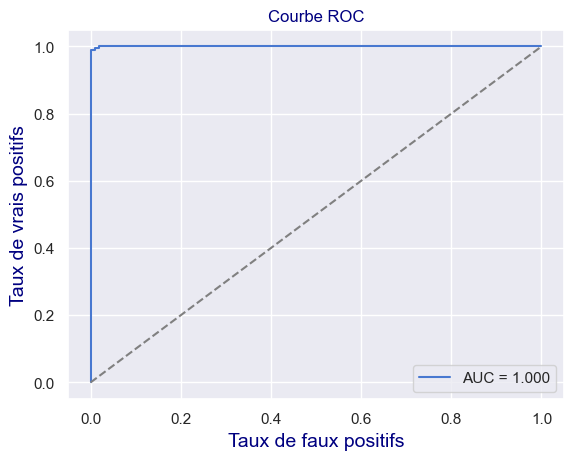

In [621]:
#La Courbe ROC-AUC

#y_test_proba = model.predict_proba(X_test_scaled)[:,1])

fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test_scaled)[:,1])

plt.plot(fpr, tpr, label=f"AUC = {roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:,1] ):.3f}")
plt.plot([0,1], [0,1], linestyle='--', color='gray')
plt.xlabel("Taux de faux positifs")
plt.ylabel("Taux de vrais positifs")
plt.title("Courbe ROC")
plt.legend()
plt.grid()
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.2.7 - Rapport de classification : </h4>
</div>

In [622]:
from sklearn.metrics import classification_report

In [623]:
print(classification_report(y_test, y_test_pred, digits=3))

              precision    recall  f1-score   support

           0      1.000     0.982     0.991       110
           1      0.990     1.000     0.995       190

    accuracy                          0.993       300
   macro avg      0.995     0.991     0.993       300
weighted avg      0.993     0.993     0.993       300



<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.2.8 - Analyse des coefficients (importance des variables : </h4>
</div>

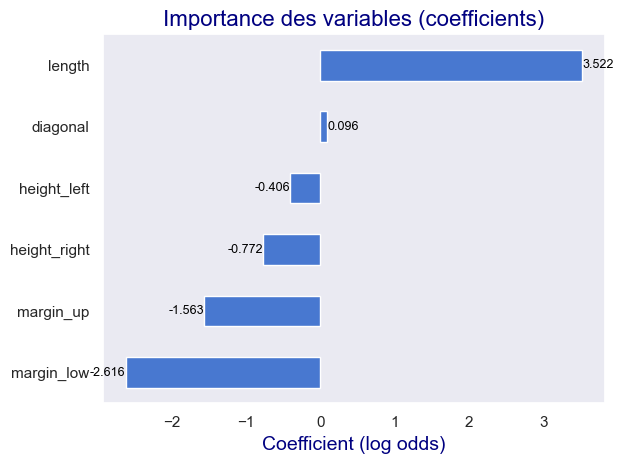

In [624]:
# Création de la série des coefficients
coeffs = pd.Series(model.coef_[0], index=X.columns)
coeffs_sorted = coeffs.sort_values()

# Création du graphique
ax = coeffs_sorted.plot(kind='barh', title="Importance des variables (coefficients)")
plt.xlabel("Coefficient (log odds)")

# Ajout des annotations (valeurs numériques sur les barres)
for i, (value, name) in enumerate(zip(coeffs_sorted, coeffs_sorted.index)):
    ax.text(x=value,                      # Position horizontale du texte
            y=i,                          # Position verticale (index de la barre)
            s=f"{value:.3f}",             # Texte à afficher (arrondi à 3 décimales)
            va='center', ha='left' if value > 0 else 'right',
            fontsize=9, color='black')

plt.title("Importance des variables (coefficients)",size=16)
plt.tight_layout()
plt.show()

La variable `diagonal` semble avoir peu d'impact sur la prédiction Vrai/Faux billet.

**OBSERVATION :**  
Pas de changement notable avec le MinMaxScaler !

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">6.3 - Modèle RL_C : Regression logistique sans `diagonal` sur données scalées</h3>
</div>

Théoriquement c'est mieux de scalées nos données mais dans notre cas les données sont dans les mêmes ordres de grandeurs.

<u>**Modèle RL_C**</u> 

In [625]:
#listes des variables prédictives pour le modèle RL_C : toutes les var quantitatives
var_pred_RL_C = ['height_left', 'height_right', 
                'margin_low','margin_up', 
                'length']
#la variable cible :
var_cible = 'is_genuine'

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.3.1 - Préparation des données : </h4>
</div>

In [626]:
#le jeu de données prédictif complet:
X = (df_billets_analyse_1_2_copy[var_pred_RL_C]).copy(deep=True)

#le jeu de données cible réel en convertissant les False en 0 et les True en 1
y = (df_billets_analyse_1_2_copy[var_cible]).copy(deep=True)
y = y.astype(int) #conversion des False / True en 0 /1

In [627]:
print(X.shape)
print('---')
print(type(X))
print('---')
print(X.head())

(1500, 5)
---
<class 'pandas.core.frame.DataFrame'>
---
   height_left  height_right  margin_low  margin_up  length
0       104.86        104.95        4.52       2.89  112.83
1       103.36        103.66        3.77       2.99  113.09
2       104.48        103.50        4.40       2.94  113.16
3       103.91        103.94        3.62       3.01  113.51
4       104.28        103.46        4.04       3.48  112.54


In [628]:
print(y.shape)
print('---')
print(type(y))
print('---')
print(y.head())

(1500,)
---
<class 'pandas.core.series.Series'>
---
0    1
1    1
2    1
3    1
4    1
Name: is_genuine, dtype: int32


In [629]:
from sklearn.model_selection import train_test_split

SEPARATION en jeu_TRAIN, et jeu_TEST

In [630]:
# split train, test
# proportion du jeu test : 0.2
#random_state : 42 pour pouvoir reproduire (une fois testé avec différent random_state)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

In [631]:
from sklearn.preprocessing import StandardScaler

In [632]:
scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.3.2 - Regresion logistique  : </h4>
</div>

In [633]:
from sklearn.linear_model import LogisticRegression

In [634]:
# initialisation et entraînement en une ligne
clf_RL_C = LogisticRegression(max_iter=1000,random_state=42)
clf_RL_C.fit(X_train_scaled, y_train)

,penalty,'l2'
,dual,False
,tol,0.0001
,C,1.0
,fit_intercept,True
,intercept_scaling,1
,class_weight,None
,random_state,42
,solver,'lbfgs'
,max_iter,1000
,multi_class,'deprecated'


In [635]:
model = clf_RL_C

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.3.3 -Observations  : </h4>
</div>

Observation de la prédiction et de sa probabilité pour 1 échantillon du jeu total de donnée :

**PREDICTIONS :**

In [636]:
y_test_pred = model.predict(X_test_scaled)

In [637]:
y_test_pred[:5]

array([0, 0, 1, 1, 1])

**PROBA DE PREDICTIONS :**

In [638]:
# les 5 premières lignes de model.predict_proba(X_test_scaled)
model.predict_proba(X_test_scaled) [:5]

array([[9.99635187e-01, 3.64813140e-04],
       [9.98317719e-01, 1.68228099e-03],
       [1.29033478e-03, 9.98709665e-01],
       [2.42162420e-03, 9.97578376e-01],
       [1.66573816e-04, 9.99833426e-01]])

In [639]:
# les 5 premières lignes de  la première colonne de model.predict_proba(X_test_scaled)
model.predict_proba(X_test_scaled) [:5,1]

array([3.64813140e-04, 1.68228099e-03, 9.98709665e-01, 9.97578376e-01,
       9.99833426e-01])

In [640]:
#Array des probas de valoir 1
y_test_proba = model.predict_proba(X_test_scaled)[:,1] # la 2ème colonne des probas

Un bon moyen d'analyser les performances d'un modèle de classification est de tracer l'histogramme des probabilités des prédictions.

Text(0.5, 1.0, 'Répartitions des probas de valoir 1 sur le jeu de test')

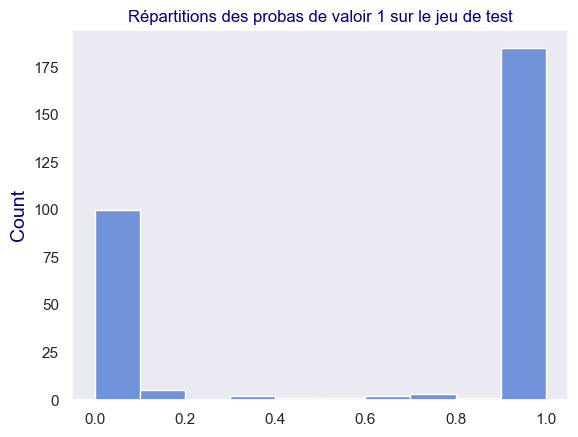

In [641]:
#Répartitions des probas de valoir 1 sur le jeu de test

sns.histplot(y_test_proba)
plt.title("Répartitions des probas de valoir 1 sur le jeu de test")

Le modèle est assez confiant de ses prédiction sur le jeu de test :  
la plupart des prédictions ont une probabilité proche de 0 ou de 1

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.3.4 - Score de performance : Exactitude(accuracy) </h4>
</div>

In [642]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_auc_score, roc_curve

Le plus simple pour mesurer la performance d'une classification est de regarder  
L'**exactitude(accuracy)**, c'est la proportion d'échantillons bien classé :  
exactitude = (échantillons bien classés)/échantillons au total

In [643]:
from sklearn.metrics import accuracy_score

In [644]:
print("Score d'Exactitude-accuracy sur le jeu test = ",accuracy_score(y_test, y_test_pred))

Score d'Exactitude-accuracy sur le jeu test =  0.9933333333333333


**OBSERVATION :**  
99% d'échantilons bien classés sur le jeu test, très bonne performance

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.3.5 - Matrice de confusion </h4>
</div>

In [645]:
from sklearn.metrics import confusion_matrix

Attention la matrice de confusion pour scikit-learn est :  
TN | FP  
FN | TP  

In [646]:
confusion_matrix(y_test, y_test_pred)

array([[108,   2],
       [  0, 190]], dtype=int64)

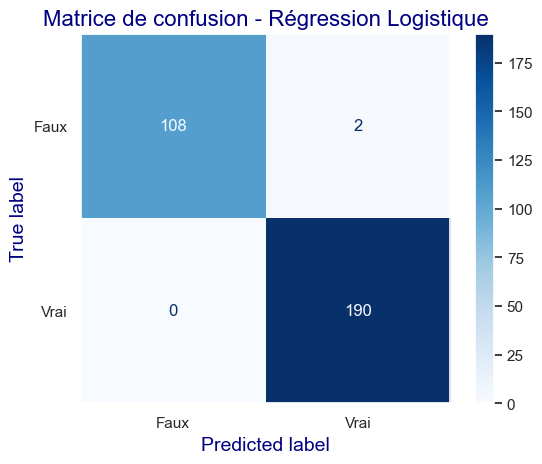

In [647]:
ConfusionMatrixDisplay.from_predictions(
    y_test, y_test_pred, display_labels=['Faux', 'Vrai'], cmap='Blues'
)
plt.title("Matrice de confusion - Régression Logistique",size=16)
plt.show()

In [648]:
# Matrice de confusion
tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred).ravel()

# Calculs
TPR = tp / (tp + fn) if (tp + fn) != 0 else 0
FPR = fp / (fp + tn) if (fp + tn) != 0 else 0

# Affichage
print(f"TPR (Recall / Sensibilité) : {TPR:.3f}")
print(f"FPR (Taux de faux positifs) : {FPR:.3f}")

TPR (Recall / Sensibilité) : 1.000
FPR (Taux de faux positifs) : 0.018


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.3.6 -  Autres metriques de classification : </h4>
</div>

Precision, Recall et ROC_AUC

In [649]:
from sklearn.metrics import precision_score, recall_score, roc_auc_score

<u>**Le Rappel-recall ou TPR(True Positive Rate):**</u>  
Rappel = TP/(TP+FN)  
= Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  
Compris entre 0 et 1.  
Plus il augmente plus cela minimise les Faux négatifs.  
(plus FN augmente, plus Rappel baisse)  
Plus on diminue le seuil de détection des positifs, plus on diminuera FN, plus on augmentera le Rappel.  

<u>**La Précision :**</u>  
Précision = TP/(TP+FP)  
= Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
Compris entre 0 et 1.  
plus il augmente, plus cela minimise lse Faux positifs.  
(plus FP augmente, plus la précision baisse)  
Plus on augmente le seuil de détection des positifs,  
plus on diminuera les FP,  plus on augmentera La Précision.  



**TPR(True Positive Rate)=Recall**  
TPR= TP / (TP + FN) (Taux de Positifs détectés parmi les positifs réels)
Plus TPR est haut, mieux c'est.  

**FPR(False Positive Rate)**  
FPR=  FP / (FP+TN)   (Taux de Faux positifs parmis les négatifs réels)
Plus FPR, est bas, mieux c'est.  

**Courbe ROC (Receiver Operating Characteristic) ou encore fonction d’efficacité du récepteur**  
TPR en fonction de FPR

<u>**ROC_AUC : Area under the ROC ou surface sous la courbe ROC**</u>  
Compris entre 0 et 1.  

Plus elle est proche de 1 mieux c'est :   
- Cela signifie que l'on peut trouver un TPR élevé pour un FPR bas.

Pour une courbe plus basse (0.5 ou au dessous) :
- avoir un TPR élevé se fait au prix d’un FPR élevé   ; 
-avoir une FPR bas se fait au prix d’un TPR bas.


In [650]:
print("Recall : ",recall_score(y_test, y_test_pred))
print("Precision : ",precision_score(y_test, y_test_pred))
print("ROC-AUC : ", roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:, 1]))

Recall :  1.0
Precision :  0.9895833333333334
ROC-AUC :  0.9998564593301436


**OBSERVATION :**  
- Très bon Recall (proche de 1)  
(TPR)(Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  )   
- Très bonne Précision (proche de 1)  
Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
- Très bon ROC (proche de 1)  
on peut trouver un TPR((True Positive Rate) élevé pour un FPR(False Positive Rate) bas.

**Courbe ROC :**

In [651]:
from sklearn.metrics import roc_curve

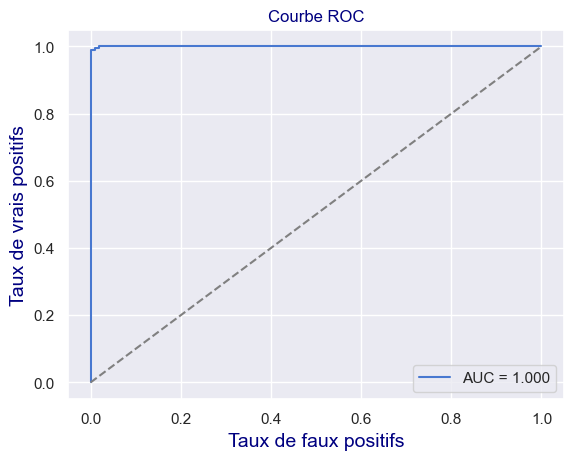

In [652]:
#La Courbe ROC-AUC

#y_test_proba = model.predict_proba(X_test_scaled)[:,1])

fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test_scaled)[:,1])

plt.plot(fpr, tpr, label=f"AUC = {roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:,1] ):.3f}")
plt.plot([0,1], [0,1], linestyle='--', color='gray')
plt.xlabel("Taux de faux positifs")
plt.ylabel("Taux de vrais positifs")
plt.title("Courbe ROC")
plt.legend()
plt.grid()
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.3.7 - Rapport de classification : </h4>
</div>

In [653]:
from sklearn.metrics import classification_report

In [654]:
print(classification_report(y_test, y_test_pred, digits=3))

              precision    recall  f1-score   support

           0      1.000     0.982     0.991       110
           1      0.990     1.000     0.995       190

    accuracy                          0.993       300
   macro avg      0.995     0.991     0.993       300
weighted avg      0.993     0.993     0.993       300



<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 6.3.8 - Analyse des coefficients (importance des variables : </h4>
</div>

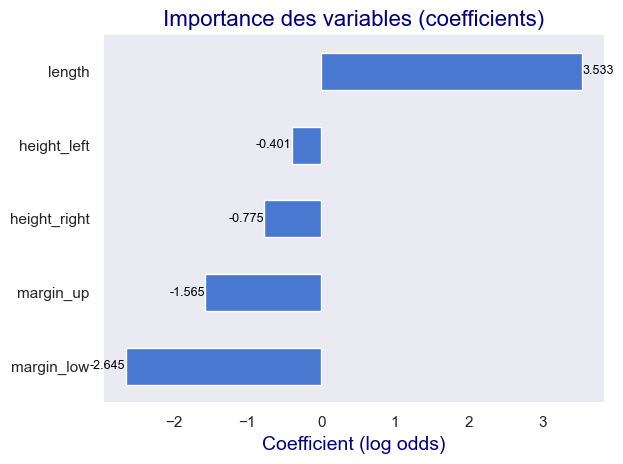

In [655]:
# Création de la série des coefficients
coeffs = pd.Series(model.coef_[0], index=X.columns)
coeffs_sorted = coeffs.sort_values()

# Création du graphique
ax = coeffs_sorted.plot(kind='barh', title="Importance des variables (coefficients)")
plt.xlabel("Coefficient (log odds)")

# Ajout des annotations (valeurs numériques sur les barres)
for i, (value, name) in enumerate(zip(coeffs_sorted, coeffs_sorted.index)):
    ax.text(x=value,                      # Position horizontale du texte
            y=i,                          # Position verticale (index de la barre)
            s=f"{value:.3f}",             # Texte à afficher (arrondi à 3 décimales)
            va='center', ha='left' if value > 0 else 'right',
            fontsize=9, color='black')

plt.title("Importance des variables (coefficients)",size=16)
plt.tight_layout()
plt.show()

La variable `diagonal` semble avoir peu d'impact sur la prédiction Vrai/Faux billet.

**OBSERVATION :**  
Pas de changement notable !!!

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">6.4 -BILAN PREMIERE REGRESSION LOGISTIQUE  </h3>
</div>


**la variable cible :** var_cible = 'is_genuine'

<u>**modèle A :**</u>  
**variables prédictives** : toutes les var quantitatives  
var_pred_RL_A = ['diagonal', 'height_left', 'height_right','margin_low','margin_up','length']

**Scaler : Données non scalées**  
(pour tester car les données sont dans le même ordre grandeur sans valeurs abérrantes ni fort outlier)

<u>**modèle B :**</u>  
**variables prédictives** : toutes les var quantitatives  
var_pred_RL_B = ['diagonal', 'height_left', 'height_right','margin_low','margin_up','length']

**Scaler** : StandardScaler

<u>**modèle C :**</u>  
**variables prédictives** : toutes sauf 'diagonal' qui semble peu influencer 'is_genuine'    
var_pred_RL_C = ['height_left', 'height_right','margin_low','margin_up','length']

**Scaler :** StandardScaler



<u>**BILAN :**</u>  
**RESULTATS QUASI IDENTIQUE :**  
- faible influence du MinMaxScaler (données de même ordre de grandeur sans valeurs abérrantes, ni outliers important)  
- faible influence du retrait de la variable 'diagonale qui semble peu influencer 'is_genuine'
- forte influence de length et margin_low


**RESULTAT DU MODELE B (TOUTES VAR QUANTITATIVES StandardScaler) :**

1. prédictions :  
Le modèle est assez confiant de ses prédiction sur le jeu de test :
la plupart des prédictions ont une probabilité proche de 0 ou de 1

2.Score d'exactitude-accuracy :   
Score d'Exactitude-accuracy sur le jeu test =  0.9867  
99% d'échantilons bien classés sur le jeu test, très bonne performance  

3. matrice de confusion pour scikit-learn est :  
TN | FP  
FN | TP  

[[106,   4],  
[  0, 190]]  

3. Autres scores :

Recall :  1.0  
Precision : 0.979381443298969    
ROC-AUC :  0.9997607655502392  

Très bon Recall (proche de 1)
(TPR)(Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN) )
Très bonne Précision (proche de 1)
Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)
Très bon ROC (proche de 1)
on peut trouver un TPR((True Positive Rate) élevé pour un FPR(False Positive Rate) bas.  

TPR (Recall / Sensibilité) : 1.000  
FPR (Taux de faux positifs) : 0.03  6Dans mon contexte j'ai l'impression que ce sont ces scores qui sont importants


4. coefficients d'influence des variables predicitves :
- faible influence de la variable 'diagonale'
- forte influence de 'length' et 'margin_low'

=> Une simple Regression Logistique semble avoir d'excellents résultats de prédiction.

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 7 - Amélioration de la Regression logistique </h2>
</div>

RAPPEL DES DONNEES : `df_billets_analyse_1_2`  
Le fichier des données complétés par regression linéaire.

TRAVAILLONS SUR UNE Copie :

In [656]:
df_billets_analyse_1_2_copy = df_billets_analyse_1_2.copy(deep=True)

In [657]:
df_billets_analyse_1_2_copy.head()

,is_genuine,diagonal,height_left,height_right,margin_low,margin_up,length
0,True,171.81,104.86,104.95,4.52,2.89,112.83
1,True,171.46,103.36,103.66,3.77,2.99,113.09
2,True,172.69,104.48,103.50,4.40,2.94,113.16
3,True,171.36,103.91,103.94,3.62,3.01,113.51
4,True,171.73,104.28,103.46,4.04,3.48,112.54


In [658]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1( df_billets_analyse_1_2_copy )

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1500,0,322,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


In [659]:
Premieres_Analyses( df_billets_analyse_1_2_copy )


---- SHAPE ----


(1500, 7)


---- INFO ----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1500 entries, 0 to 1499
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   is_genuine    1500 non-null   bool   
 1   diagonal      1500 non-null   float64
 2   height_left   1500 non-null   float64
 3   height_right  1500 non-null   float64
 4   margin_low    1500 non-null   float64
 5   margin_up     1500 non-null   float64
 6   length        1500 non-null   float64
dtypes: bool(1), float64(6)
memory usage: 71.9 KB

---- DESCRIBE ----


,diagonal,height_left,height_right,margin_low,margin_up,length
count,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.00000
mean,171.958440,104.029533,103.920307,4.482858,3.151473,112.67850
std,0.305195,0.299462,0.325627,0.659857,0.231813,0.87273
min,171.040000,103.140000,102.820000,2.980000,2.270000,109.49000
25%,171.750000,103.820000,103.710000,4.027500,2.990000,112.03000
50%,171.960000,104.040000,103.920000,4.310000,3.140000,112.96000
75%,172.170000,104.230000,104.150000,4.870000,3.310000,113.34000
max,173.010000,104.880000,104.950000,6.900000,3.910000,114.44000



---- DESCRIPTION ----


,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
is_genuine,bool,1500,1500,0,2,NaN
diagonal,float64,1500,1500,0,159,NaN
height_left,float64,1500,1500,0,155,NaN
height_right,float64,1500,1500,0,170,NaN
margin_low,float64,1500,1500,0,322,NaN
margin_up,float64,1500,1500,0,123,NaN
length,float64,1500,1500,0,336,NaN


In [660]:
df_billets_analyse_1_2_copy.columns

Index(['is_genuine', 'diagonal', 'height_left', 'height_right', 'margin_low',
       'margin_up', 'length'],
      dtype='object')

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">7.2 - Regression logistique de référence : Modèle RL_B : Regression logistique avec toutes les variables numériques sur données scalées</h3>
</div>

Théoriquement c'est mieux de scalées nos données mais dans notre cas les données sont dans les mêmes ordres de grandeurs.

<u>**Modèle RL_B**</u> 

In [661]:
#listes des variables prédictives pour le modèle RL_B : toutes les var quantitatives
var_pred_RL_B = ['diagonal', 
                'height_left', 'height_right', 
                'margin_low','margin_up', 
                'length']
#la variable cible :
var_cible = 'is_genuine'

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.2.1 - Préparation des données : </h4>
</div>

In [662]:
#le jeu de données prédictif complet:
X = (df_billets_analyse_1_2_copy[var_pred_RL_B]).copy(deep=True)

#le jeu de données cible réel en convertissant les False en 0 et les True en 1
y = (df_billets_analyse_1_2_copy[var_cible]).copy(deep=True)
y = y.astype(int) #conversion des False / True en 0 /1

In [663]:
print(X.shape)
print('---')
print(type(X))
print('---')
print(X.head())

(1500, 6)
---
<class 'pandas.core.frame.DataFrame'>
---
   diagonal  height_left  height_right  margin_low  margin_up  length
0    171.81       104.86        104.95        4.52       2.89  112.83
1    171.46       103.36        103.66        3.77       2.99  113.09
2    172.69       104.48        103.50        4.40       2.94  113.16
3    171.36       103.91        103.94        3.62       3.01  113.51
4    171.73       104.28        103.46        4.04       3.48  112.54


In [664]:
print(y.shape)
print('---')
print(type(y))
print('---')
print(y.head())

(1500,)
---
<class 'pandas.core.series.Series'>
---
0    1
1    1
2    1
3    1
4    1
Name: is_genuine, dtype: int32


In [665]:
from sklearn.model_selection import train_test_split

SEPARATION en jeu_TRAIN, et jeu_TEST

In [666]:
# split train, test
# proportion du jeu test : 0.2
#random_state : 42 pour pouvoir reproduire (une fois testé avec différent random_state)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

In [667]:
from sklearn.preprocessing import StandardScaler

In [668]:
scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.2.2 - Regression logistique  : </h4>
</div>

In [669]:
from sklearn.linear_model import LogisticRegression

In [670]:
# initialisation et entraînement en une ligne
clf_RL_B = LogisticRegression(max_iter=1000,random_state=42)
clf_RL_B.fit(X_train_scaled, y_train)

,penalty,'l2'
,dual,False
,tol,0.0001
,C,1.0
,fit_intercept,True
,intercept_scaling,1
,class_weight,None
,random_state,42
,solver,'lbfgs'
,max_iter,1000
,multi_class,'deprecated'


In [671]:
model = clf_RL_B

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.2.3 -Observations  : </h4>
</div>

Observation de la prédiction et de sa probabilité pour 1 échantillon du jeu total de donnée :

**PREDICTIONS :**

In [672]:
y_test_pred = model.predict(X_test_scaled)

In [673]:
y_test_pred[:5]

array([0, 0, 1, 1, 1])

**PROBA DE PREDICTIONS :**

In [674]:
# les 5 premières lignes de model.predict_proba(X_test_scaled)
model.predict_proba(X_test_scaled) [:5]

array([[9.99577491e-01, 4.22509212e-04],
       [9.98374940e-01, 1.62505990e-03],
       [1.49030257e-03, 9.98509697e-01],
       [2.20394967e-03, 9.97796050e-01],
       [1.58978029e-04, 9.99841022e-01]])

In [675]:
# les 5 premières lignes de  la première colonne de model.predict_proba(X_test_scaled)
model.predict_proba(X_test_scaled) [:5,1]

array([4.22509212e-04, 1.62505990e-03, 9.98509697e-01, 9.97796050e-01,
       9.99841022e-01])

In [676]:
#Array des probas de valoir 1
y_test_proba = model.predict_proba(X_test_scaled)[:,1] # la 2ème colonne des probas

Un bon moyen d'analyser les performances d'un modèle de classification est de tracer l'histogramme des probabilités des prédictions.

Text(0.5, 1.0, 'Répartitions des probas de valoir 1 sur le jeu de test')

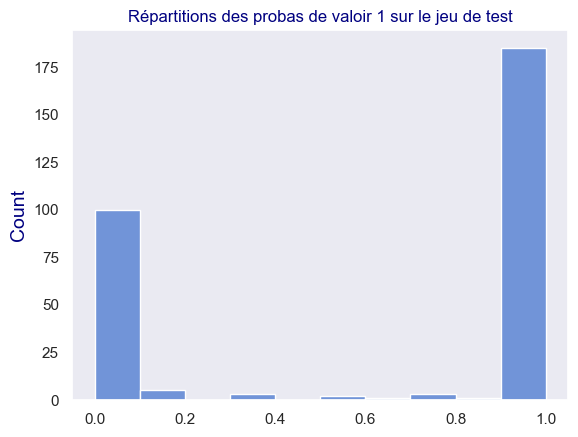

In [677]:
#Répartitions des probas de valoir 1 sur le jeu de test

sns.histplot(y_test_proba)
plt.title("Répartitions des probas de valoir 1 sur le jeu de test")

Le modèle est assez confiant de ses prédiction sur le jeu de test :  
la plupart des prédictions ont une probabilité proche de 0 ou de 1

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.2.4 - Score de performance : Exactitude(accuracy) </h4>
</div>

In [678]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_auc_score, roc_curve

Le plus simple pour mesurer la performance d'une classification est de regarder  
L'**exactitude(accuracy)**, c'est la proportion d'échantillons bien classé :  
exactitude = (échantillons bien classés)/échantillons au total

In [679]:
from sklearn.metrics import accuracy_score

In [680]:
print("Score d'Exactitude-accuracy sur le jeu test = ",accuracy_score(y_test, y_test_pred))

Score d'Exactitude-accuracy sur le jeu test =  0.9933333333333333


**OBSERVATION :**  
99% d'échantilons bien classés sur le jeu test, très bonne performance

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.2.5 - Matrice de confusion </h4>
</div>

In [681]:
from sklearn.metrics import confusion_matrix

Attention la matrice de confusion pour scikit-learn est :  
TN | FP  
FN | TP  

In [682]:
confusion_matrix(y_test, y_test_pred)

array([[108,   2],
       [  0, 190]], dtype=int64)

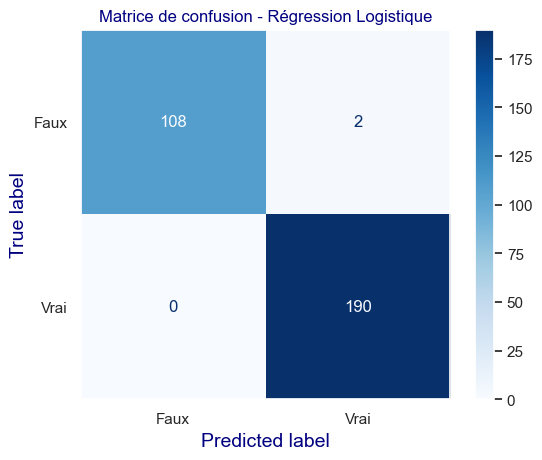

In [683]:
ConfusionMatrixDisplay.from_predictions(
    y_test, y_test_pred, display_labels=['Faux', 'Vrai'], cmap='Blues'
)
plt.title("Matrice de confusion - Régression Logistique")
plt.show()

In [684]:
# Matrice de confusion
tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred).ravel()

# Calculs
TPR = tp / (tp + fn) if (tp + fn) != 0 else 0
FPR = fp / (fp + tn) if (fp + tn) != 0 else 0

# Affichage
print(f"TPR (Recall / Sensibilité) : {TPR:.3f}")
print(f"FPR (Taux de faux positifs) : {FPR:.3f}")

TPR (Recall / Sensibilité) : 1.000
FPR (Taux de faux positifs) : 0.018


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.2.6 -  Autres metriques de classification : </h4>
</div>

Precision, Recall et ROC_AUC

In [685]:
from sklearn.metrics import precision_score, recall_score, roc_auc_score

<u>**Le Rappel-recall ou TPR(True Positive Rate):**</u>  
Rappel = TP/(TP+FN)  
= Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  
Compris entre 0 et 1.  
Plus il augmente plus cela minimise les Faux négatifs.  
(plus FN augmente, plus Rappel baisse)  
Plus on diminue le seuil de détection des positifs, plus on diminuera FN, plus on augmentera le Rappel.  

<u>**La Précision :**</u>  
Précision = TP/(TP+FP)  
= Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
Compris entre 0 et 1.  
plus il augmente, plus cela minimise lse Faux positifs.  
(plus FP augmente, plus la précision baisse)  
Plus on augmente le seuil de détection des positifs,  
plus on diminuera les FP,  plus on augmentera La Précision.  



**TPR(True Positive Rate)=Recall**  
TPR= TP / (TP + FN) (Taux de Positifs détectés parmi les positifs réels)
Plus TPR est haut, mieux c'est.  

**FPR(False Positive Rate)**  
FPR=  FP / (FP+TN)   (Taux de Faux positifs parmis les négatifs réels)
Plus FPR, est bas, mieux c'est.  

**Courbe ROC (Receiver Operating Characteristic) ou encore fonction d’efficacité du récepteur**  
TPR en fonction de FPR

<u>**ROC_AUC : Area under the ROC ou surface sous la courbe ROC**</u>  
Compris entre 0 et 1.  

Plus elle est proche de 1 mieux c'est :   
- Cela signifie que l'on peut trouver un TPR élevé pour un FPR bas.

Pour une courbe plus basse (0.5 ou au dessous) :
- avoir un TPR élevé se fait au prix d’un FPR élevé   ; 
-avoir une FPR bas se fait au prix d’un TPR bas.


In [686]:
print("Recall : ",recall_score(y_test, y_test_pred))
print("Precision : ",precision_score(y_test, y_test_pred))
print("ROC-AUC : ", roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:, 1]))

Recall :  1.0
Precision :  0.9895833333333334
ROC-AUC :  0.9998564593301436


**OBSERVATION :**  
- Très bon Recall (proche de 1)  
(TPR)(Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  )   
- Très bonne Précision (proche de 1)  
Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
- Très bon ROC (proche de 1)  
on peut trouver un TPR((True Positive Rate) élevé pour un FPR(False Positive Rate) bas.

**Courbe ROC :**

In [687]:
from sklearn.metrics import roc_curve

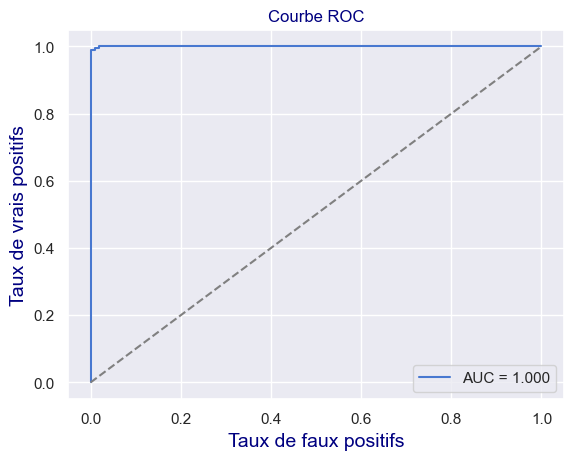

In [688]:
#La Courbe ROC-AUC

#y_test_proba = model.predict_proba(X_test_scaled)[:,1])

fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test_scaled)[:,1])

plt.plot(fpr, tpr, label=f"AUC = {roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:,1] ):.3f}")
plt.plot([0,1], [0,1], linestyle='--', color='gray')
plt.xlabel("Taux de faux positifs")
plt.ylabel("Taux de vrais positifs")
plt.title("Courbe ROC")
plt.legend()
plt.grid()
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.2.7 - Rapport de classification : </h4>
</div>

In [689]:
from sklearn.metrics import classification_report

In [690]:
print(classification_report(y_test, y_test_pred, digits=3))

              precision    recall  f1-score   support

           0      1.000     0.982     0.991       110
           1      0.990     1.000     0.995       190

    accuracy                          0.993       300
   macro avg      0.995     0.991     0.993       300
weighted avg      0.993     0.993     0.993       300



<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.2.8 - Analyse des coefficients (importance des variables : </h4>
</div>

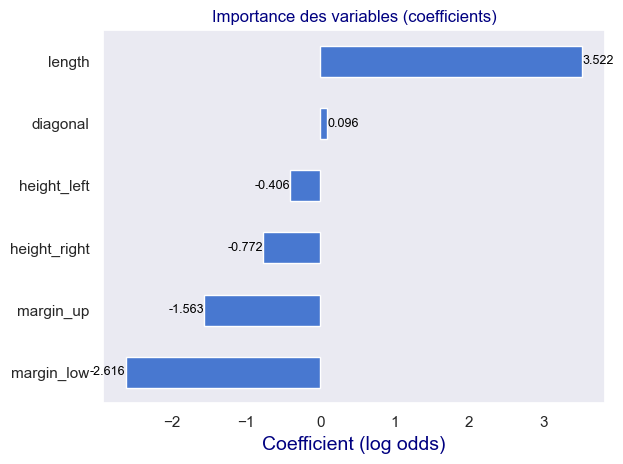

In [691]:
# Création de la série des coefficients
coeffs = pd.Series(model.coef_[0], index=X.columns)
coeffs_sorted = coeffs.sort_values()

# Création du graphique
ax = coeffs_sorted.plot(kind='barh', title="Importance des variables (coefficients)")
plt.xlabel("Coefficient (log odds)")

# Ajout des annotations (valeurs numériques sur les barres)
for i, (value, name) in enumerate(zip(coeffs_sorted, coeffs_sorted.index)):
    ax.text(x=value,                      # Position horizontale du texte
            y=i,                          # Position verticale (index de la barre)
            s=f"{value:.3f}",             # Texte à afficher (arrondi à 3 décimales)
            va='center', ha='left' if value > 0 else 'right',
            fontsize=9, color='black')

plt.tight_layout()
plt.show()

La variable `diagonal` semble avoir peu d'impact sur la prédiction Vrai/Faux billet.

**OBSERVATION :**  
Pas de changement notable avec le StandardScaler !

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">7.3 - VERIFICATION DE PERFORMANCE ET AMELIORATION DE LA REGRESSION LOGISTIQUE  </h3>
</div>

J'ai déjà fait une régression logistique classique qui donne de bon résultats (avec plusieurs random_state).  
Regardons si elle est stable et si elle peut être améliorer ?

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.3.1 -  : VALIDATION CROISEE 1:Robustesse au jeu de données</h4>
</div>

**Validation croisée**

Objectif : s’assurer que la performance n’est pas liée à un seul split train/test

In [692]:
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression

model = LogisticRegression(max_iter=1000, random_state=42)
scores = cross_val_score(model, X_train_scaled, y_train, cv=5, scoring='accuracy')  #accuracy ou 'roc_auc'
#print(f"Scores de validation croisée de précision : {scores}")
print(f"Moyenne du Score de Précision : {scores.mean():.3f}| Écart-type : {scores.std():.3f}")

model = LogisticRegression(max_iter=1000, random_state=42)
scores = cross_val_score(model, X_train_scaled, y_train, cv=5, scoring='roc_auc')  #accuracy ou 'roc_auc'
#print(f"Scores de validation croisée de ROC-AUC : {scores}")
print(f"Moyenne du score ROC-AUC : {scores.mean():.3f}| Écart-type : {scores.std():.3f}")

Moyenne du Score de Précision : 0.990| Écart-type : 0.003
Moyenne du score ROC-AUC : 0.999| Écart-type : 0.002


In [693]:
from sklearn.model_selection import cross_validate
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import make_scorer, precision_score, recall_score, roc_auc_score

# Définir le modèle
model = LogisticRegression(max_iter=1000, random_state=42)

# Dictionnaire des scores à calculer
scoring = {
    'accuracy': 'accuracy',
    'precision': 'precision',
    'recall': 'recall',
    'roc_auc': 'roc_auc',
}

# Validation croisée
results = cross_validate(model, X_train_scaled, y_train, cv=5, scoring=scoring)

# Affichage
for metric in scoring.keys():
    scores = results[f'test_{metric}']
    print(f"{metric.capitalize()} : Moyenne = {scores.mean():.3f} | Écart-type = {scores.std():.3f}")

Accuracy : Moyenne = 0.990 | Écart-type = 0.003
Precision : Moyenne = 0.988 | Écart-type = 0.004
Recall : Moyenne = 0.998 | Écart-type = 0.003
Roc_auc : Moyenne = 0.999 | Écart-type = 0.002


Les scores sont très bons et stables, ils dépendent peu du choix de jeu test.

Ecart-type faible (< 0.01) => modèle stable peu importe le jeu de test choisi.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.3.2 -  : VALIDATION CROISEE 2 :Robustesse au random state de LogisticRegression</h4>
</div>

**Validation croisée 2**

Objectif : évaluer la variance des scores en fonction de plusieurs valeurs de random_state dans la Regression logistic :

In [694]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score
import numpy as np

random_states = range(0, 110, 10)  # 10, 20, ..., 100
scores = []

for rs in random_states:
    model = LogisticRegression(C=0.1, max_iter=1000, penalty='l2', random_state=rs)
    score = cross_val_score(model, X_train, y_train, cv=5, scoring='roc_auc').mean()
    scores.append(score)

# Résumé
print("Scores pour différents random_state :", scores)
print(f"Score moyen : {np.mean(scores):.4f}")
print(f"Écart-type : {np.std(scores):.4f}")

Scores pour différents random_state : [0.9978474200696423, 0.9978474200696423, 0.9978474200696423, 0.9978474200696423, 0.9978474200696423, 0.9978474200696423, 0.9978474200696423, 0.9978474200696423, 0.9978474200696423, 0.9978474200696423, 0.9978474200696423]
Score moyen : 0.9978
Écart-type : 0.0000


In [695]:
from sklearn.model_selection import cross_validate
from sklearn.linear_model import LogisticRegression
import numpy as np

# Liste des random_state à tester
random_states = range(00, 100, 10)

# Dictionnaire pour stocker les résultats
all_results = {metric: [] for metric in ['accuracy', 'precision', 'recall', 'roc_auc']}

# Définition des métriques à évaluer
scoring = {
    'accuracy': 'accuracy',
    'precision': 'precision',
    'recall': 'recall',
    'roc_auc': 'roc_auc',
}

# Boucle sur les random_state
for rs in random_states:
    model = LogisticRegression(C=0.1, max_iter=1000, penalty='l2', random_state=rs)
    results = cross_validate(model, X_train, y_train, cv=5, scoring=scoring)
    
    for metric in scoring.keys():
        all_results[metric].append(results[f'test_{metric}'].mean())

# Affichage des résultats agrégés
print("📊 Résumé des performances selon différents random_state :")
for metric, values in all_results.items():
    print(f"{metric.capitalize()} : Moyenne = {np.mean(values):.3f} | Écart-type = {np.std(values):.3f}")


📊 Résumé des performances selon différents random_state :
Accuracy : Moyenne = 0.987 | Écart-type = 0.000
Precision : Moyenne = 0.982 | Écart-type = 0.000
Recall : Moyenne = 0.999 | Écart-type = 0.000
Roc_auc : Moyenne = 0.998 | Écart-type = 0.000


**Ecart-type faible (< 0.01) => modèle stable peu importe le random_state choisi.**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.3.3 -  Sélection de variable </h4>
</div>

**Sélection de variables**  
Objectif : tester si certaines variables sont peu utiles, voire nuisibles


In [696]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression

model = LogisticRegression(max_iter=1000, random_state=42)
rfe = RFE(model, n_features_to_select=4)
rfe.fit(X_train_scaled, y_train)

selected_features = X.columns[rfe.support_]
print("Variables sélectionnées :", selected_features)

Variables sélectionnées : Index(['height_right', 'margin_low', 'margin_up', 'length'], dtype='object')


OBSERVATION :  
C'est bien diagonal et height left qui sont les moins intéressants !

In [697]:
var_quant

['diagonal',
 'height_left',
 'height_right',
 'margin_low',
 'margin_up',
 'length']

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.3.4 GridSearchCV : Recherche des meilleurs paramètres de LogisticRegression </h4>
</div>

**GridSearchCV**  
Objectif : rechercher la meilleure régularisation (C)

In [698]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression

param_grid = {'C': [0.01, 0.1, 1, 10, 100]}
model = LogisticRegression(max_iter=1000, random_state=42)
grid = GridSearchCV(model, param_grid, cv=5, scoring='roc_auc')
grid.fit(X_train_scaled, y_train)

print("Meilleur paramètre :", grid.best_params_)
print("Meilleure AUC moyenne :", grid.best_score_)

Meilleur paramètre : {'C': 0.1}
Meilleure AUC moyenne : 0.9989553656220324


In [699]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression

param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'penalty':['l1', 'l2'],
    'solver': ['liblinear'],
    'max_iter' :[50,100,1_000,5_000]
}

model = LogisticRegression(max_iter=1000, random_state=42)
grid = GridSearchCV(model, param_grid, cv=5, scoring='roc_auc')
grid.fit(X_train_scaled, y_train)

print("Meilleur paramètre :", grid.best_params_)
print("Meilleure AUC moyenne :", grid.best_score_)

Meilleur paramètre : {'C': 0.01, 'max_iter': 50, 'penalty': 'l2', 'solver': 'liblinear'}
Meilleure AUC moyenne : 0.9988762266540044


Observation :  
ce n'est pas mieux avec le seolver par défaut 'lbfgs' qui ne supporte que 'l2' comme correction.  
Mais de toute façon c'est la penalty 'l2' (celle aussi par défaut qui est choisie).  
Relançon la recherche sans spécifier le solver('lbfgs' par défaut et la penalty'l2' par défaut)

In [700]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression

param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'max_iter' :[50,100,1_000,5_000]
}

model = LogisticRegression(max_iter=1000, random_state=42)
grid = GridSearchCV(model, param_grid, cv=5, scoring='roc_auc')
grid.fit(X_train_scaled, y_train)

print("Meilleur paramètre :", grid.best_params_)
print("Meilleure AUC moyenne :", grid.best_score_)

Meilleur paramètre : {'C': 0.1, 'max_iter': 50}
Meilleure AUC moyenne : 0.9989553656220324


50 ca fait vraiment bas,  
j'ai déjà un warning de non convergence dans le code qui a suivi.  
démarrons à 100 par sécurité, c'est plus Robuste.

In [701]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression

param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'max_iter' :[100,500,1_000,5_000]
}

model = LogisticRegression(max_iter=1000, random_state=42)
grid = GridSearchCV(model, param_grid, cv=5, scoring='roc_auc')
grid.fit(X_train_scaled, y_train)

print("Meilleur paramètre :", grid.best_params_)
print("Meilleure AUC moyenne :", grid.best_score_)

Meilleur paramètre : {'C': 0.1, 'max_iter': 100}
Meilleure AUC moyenne : 0.9989553656220324


OBSERVATION :  
Les meilleurs paramètres sont 'C'0.1 et max_iter :100 pas besoin d'aller jusqu'à 1000.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.3.5 Observation coefficients et rapport</h4>
</div>

**Analyse des coefficients**  
Objectif : interpréter les variables importantes

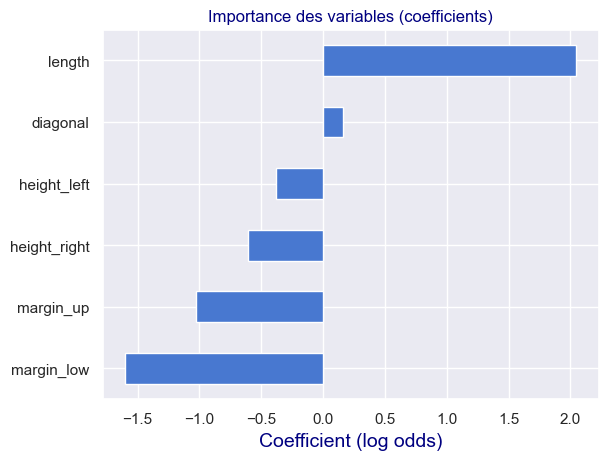

In [702]:
model_best = grid.best_estimator_
coeffs = pd.Series(model_best.coef_[0], index=X.columns)
coeffs.sort_values().plot(kind='barh', title="Importance des variables (coefficients)")
plt.xlabel("Coefficient (log odds)")
plt.grid()
plt.show()

**Évaluation classique :**

In [703]:
from sklearn.metrics import classification_report, confusion_matrix

y_test_pred = model_best.predict(X_test_scaled)

print(confusion_matrix(y_test, y_test_pred))
print(classification_report(y_test, y_test_pred))

[[107   3]
 [  0 190]]
              precision    recall  f1-score   support

           0       1.00      0.97      0.99       110
           1       0.98      1.00      0.99       190

    accuracy                           0.99       300
   macro avg       0.99      0.99      0.99       300
weighted avg       0.99      0.99      0.99       300



<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.3.6 - Ajustement du seuil de proba </h4>
</div>

**Ajustement du seuil**  
Objectif : trouver un meilleur compromis entre TPR et FPR

In [704]:
from sklearn.metrics import confusion_matrix

y_prob = model_best.predict_proba(X_test_scaled)[:, 1]
seuils = [0.3, 0.4, 0.5, 0.6, 0.7]

for seuil in seuils:
    y_pred = (y_prob >= seuil).astype(int)
    tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()
    TPR = tp / (tp + fn)
    FPR = fp / (fp + tn)
    print(f"Seuil {seuil:.2f} → TPR : {TPR:.2f} | FPR : {FPR:.2f}")

Seuil 0.30 → TPR : 1.00 | FPR : 0.08
Seuil 0.40 → TPR : 1.00 | FPR : 0.04
Seuil 0.50 → TPR : 1.00 | FPR : 0.03
Seuil 0.60 → TPR : 0.99 | FPR : 0.01
Seuil 0.70 → TPR : 0.98 | FPR : 0.01


Je pense que c'est important qu'il n'y ait aps de Faux négatifs, donc que TPR soit le plus haut possible, avec le FPR le plus bas possible.  
Le seuil à 0.5 est donc le meilleur et sera conservé;

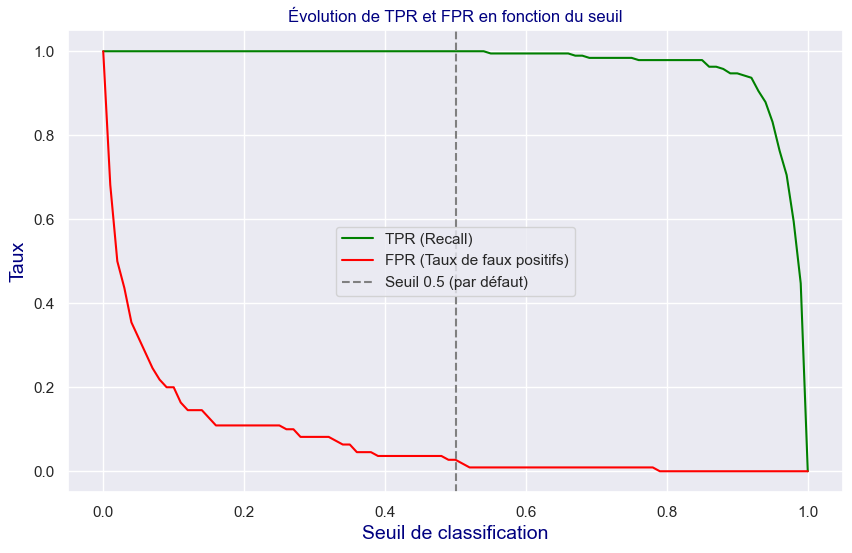

In [705]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

# Probabilités prédites pour la classe 1 (billet vrai)
y_prob = model_best.predict_proba(X_test_scaled)[:, 1]

# Listes pour stocker les résultats
seuils = np.arange(0, 1.01, 0.01)
tpr_list = []
fpr_list = []

for seuil in seuils:
    y_pred_seuil = (y_prob >= seuil).astype(int)
    tn, fp, fn, tp = confusion_matrix(y_test, y_pred_seuil).ravel()

    tpr = tp / (tp + fn) if (tp + fn) != 0 else 0  # Recall / Sensibilité
    fpr = fp / (fp + tn) if (fp + tn) != 0 else 0  # Taux de faux positifs

    tpr_list.append(tpr)
    fpr_list.append(fpr)

# ✨ Affichage du graphique
plt.figure(figsize=(10, 6))
plt.plot(seuils, tpr_list, label='TPR (Recall)', color='green')
plt.plot(seuils, fpr_list, label='FPR (Taux de faux positifs)', color='red')
plt.axvline(0.5, color='gray', linestyle='--', label='Seuil 0.5 (par défaut)')

plt.xlabel("Seuil de classification")
plt.ylabel("Taux")
plt.title("Évolution de TPR et FPR en fonction du seuil")
plt.legend()
plt.grid(True)
plt.show()

**Visualisation : courbe ROC**  
Objectif : visualiser tous les seuils possibles + AUC

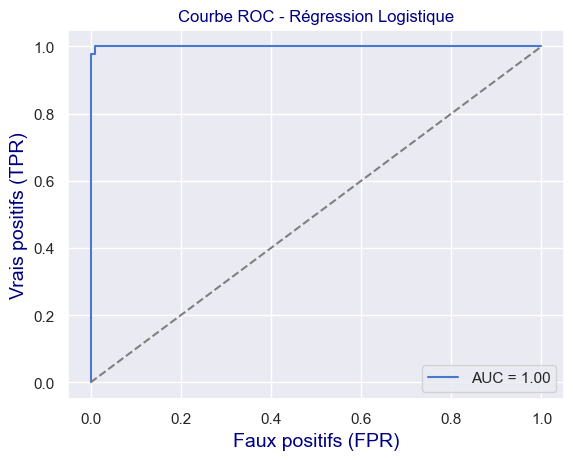

In [706]:
from sklearn.metrics import roc_curve, auc

fpr, tpr, thresholds = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, label=f"AUC = {roc_auc:.2f}")
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel("Faux positifs (FPR)")
plt.ylabel("Vrais positifs (TPR)")
plt.title("Courbe ROC - Régression Logistique")
plt.legend()
plt.grid()
plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">7.4 -  SYTNHESE DES MEILLEURS PARAMETRES : REGRESSION LOGISTIQUE  </h3>
</div>

**Rappel :**   
Standardisation	Oui, avec StandardScaler() après découpage Train/Test
Modèle	LogisticRegression

**Variables sélectionnées :**  
['height_right', 'margin_low', 'margin_up', 'length']   
Après vérification, je perds un peu en précision en retirant des variables donc je vais tout garder toutes les variables au vu du volume de données.  Même si je ne retire que daigonal il semble que je perde en performance.

['diagonal', 'height_left', 'height_right', 'margin_low', 'margin_up',
       'length']

**Paramètres optimaux :**  
C=0.1, max_iter=100, penalty='l2', random_state=42  

**Seuil de décision**  
0.5 (valide car bon compromis entre TPR & FPR)

In [707]:
df_billets_analyse_1_2_copy[var_quant].columns

Index(['diagonal', 'height_left', 'height_right', 'margin_low', 'margin_up',
       'length'],
      dtype='object')

**MODELE DE REGRESSION LOGISTIQUE FINAL :**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.4.1 -  Préparation des données identiques: </h4>
</div>

In [708]:
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

#listes des variables prédictives pour le modèle RL_final : toutes les var quantitatives
var_pred_RL_final = ['diagonal',
                     'height_left', 'height_right', 
                     'margin_low','margin_up', 
                     'length']
#la variable cible :
var_cible = 'is_genuine'

#le jeu de données prédictif complet:
X = (df_billets_analyse_1_2_copy[var_pred_RL_final]).copy(deep=True)

#le jeu de données cible réel en convertissant les False en 0 et les True en 1
y = (df_billets_analyse_1_2_copy[var_cible]).copy(deep=True)
y = y.astype(int) #conversion des False / True en 0 /1


# split train, test
# proportion du jeu test : 0.2
#random_state : 42 pour pouvoir reproduire (une fois testé avec différent random_state)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.4.2 -  Initialisation du modèle de Regression Logistique avece les meilleurs paramètres : clf_RL_final  </h4>
</div>

In [709]:
from sklearn.linear_model import LogisticRegression

# initialisation et entraînement en une ligne
clf_RL_final = LogisticRegression(C=0.1, max_iter=100, penalty='l2', random_state=42)

#Entrainement
clf_RL_final.fit(X_train_scaled, y_train)
model = clf_RL_final

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.4.3 -  Prédictions et Probabilités </h4>
</div>

In [710]:
#Prédictions
y_test_pred = model.predict(X_test_scaled)
y_test_proba = model.predict_proba(X_test_scaled)[:, 1]  # Pour courbe ROC et seuils

**PREDICTIONS :**

In [711]:
y_test_pred[:5]

array([0, 0, 1, 1, 1])

**PROBA DE PREDICTIONS :**

In [712]:
# les 5 premières lignes de model.predict_proba(X_test_scaled)
model.predict_proba(X_test_scaled) [:5]

array([[0.98503508, 0.01496492],
       [0.9805374 , 0.0194626 ],
       [0.00958586, 0.99041414],
       [0.010364  , 0.989636  ],
       [0.00209953, 0.99790047]])

In [713]:
# les 5 premières lignes de  la première colonne de model.predict_proba(X_test_scaled)
model.predict_proba(X_test_scaled) [:5,1]

array([0.01496492, 0.0194626 , 0.99041414, 0.989636  , 0.99790047])

Un bon moyen d'analyser les performances d'un modèle de classification est de tracer l'histogramme des probabilités des prédictions.

Text(0.5, 1.0, 'Répartitions des probas de valoir 1 sur le jeu de test')

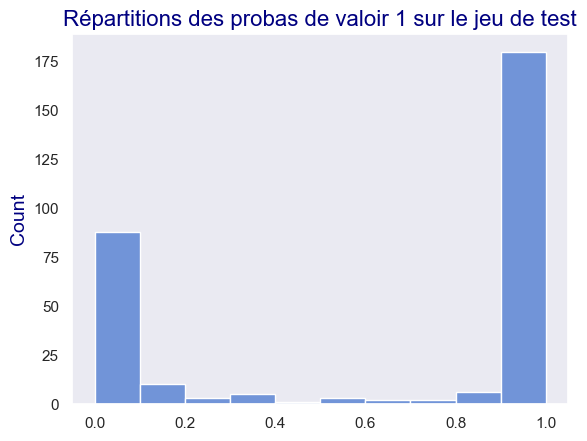

In [714]:
#Répartitions des probas de valoir 1 sur le jeu de test

sns.histplot(y_test_proba)
plt.title("Répartitions des probas de valoir 1 sur le jeu de test",size=16)

Le modèle est assez confiant de ses prédiction sur le jeu de test :  
la plupart des prédictions ont une probabilité proche de 0 ou de 1

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.4.4 - Score de performance : Exactitude(accuracy) </h4>
</div>

In [715]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_auc_score, roc_curve

Le plus simple pour mesurer la performance d'une classification est de regarder  
L'**exactitude(accuracy)**, c'est la proportion d'échantillons bien classé :  
exactitude = (échantillons bien classés)/échantillons au total

In [716]:
from sklearn.metrics import accuracy_score

In [717]:
print("Score d'Exactitude-accuracy sur le jeu test = ",accuracy_score(y_test, y_test_pred))

Score d'Exactitude-accuracy sur le jeu test =  0.99


**OBSERVATION :**  
99% d'échantilons bien classés sur le jeu test, très bonne performance

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.4.5 - Matrice de confusion </h4>
</div>

In [718]:
from sklearn.metrics import confusion_matrix

Attention la matrice de confusion pour scikit-learn est :  
TN | FP  
FN | TP  

In [719]:
confusion_matrix(y_test, y_test_pred)

array([[107,   3],
       [  0, 190]], dtype=int64)

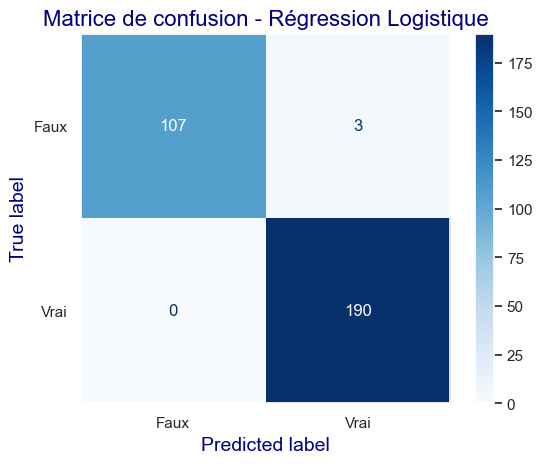

In [720]:
ConfusionMatrixDisplay.from_predictions(
    y_test, y_test_pred, display_labels=['Faux', 'Vrai'], cmap='Blues'
)
plt.title("Matrice de confusion - Régression Logistique",size=16)
plt.show()

In [721]:
# Matrice de confusion
tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred).ravel()

# Calculs
TPR = tp / (tp + fn) if (tp + fn) != 0 else 0
FPR = fp / (fp + tn) if (fp + tn) != 0 else 0

# Affichage
print(f"TPR (Recall / Sensibilité) : {TPR:.3f}")
print(f"FPR (Taux de faux positifs) : {FPR:.3f}")

TPR (Recall / Sensibilité) : 1.000
FPR (Taux de faux positifs) : 0.027


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.4.6 -  Autres metriques de classification : </h4>
</div>

Precision, Recall et ROC_AUC

In [722]:
from sklearn.metrics import precision_score, recall_score, roc_auc_score

<u>**Le Rappel-recall ou TPR(True Positive Rate):**</u>  
Rappel = TP/(TP+FN)  
= Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  
Compris entre 0 et 1.  
Plus il augmente plus cela minimise les Faux négatifs.  
(plus FN augmente, plus Rappel baisse)  
Plus on diminue le seuil de détection des positifs, plus on diminuera FN, plus on augmentera le Rappel.  

<u>**La Précision :**</u>  
Précision = TP/(TP+FP)  
= Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
Compris entre 0 et 1.  
plus il augmente, plus cela minimise lse Faux positifs.  
(plus FP augmente, plus la précision baisse)  
Plus on augmente le seuil de détection des positifs,  
plus on diminuera les FP,  plus on augmentera La Précision.  



**TPR(True Positive Rate)=Recall**  
TPR= TP / (TP + FN) (Taux de Positifs détectés parmi les positifs réels)
Plus TPR est haut, mieux c'est.  

**FPR(False Positive Rate)**  
FPR=  FP / (FP+TN)   (Taux de Faux positifs parmis les négatifs réels)
Plus FPR, est bas, mieux c'est.  

**Courbe ROC (Receiver Operating Characteristic) ou encore fonction d’efficacité du récepteur**  
TPR en fonction de FPR

<u>**ROC_AUC : Area under the ROC ou surface sous la courbe ROC**</u>  
Compris entre 0 et 1.  

Plus elle est proche de 1 mieux c'est :   
- Cela signifie que l'on peut trouver un TPR élevé pour un FPR bas.

Pour une courbe plus basse (0.5 ou au dessous) :
- avoir un TPR élevé se fait au prix d’un FPR élevé   ; 
-avoir une FPR bas se fait au prix d’un TPR bas.


In [723]:
print("Recall : ",recall_score(y_test, y_test_pred))
print("Precision : ",precision_score(y_test, y_test_pred))
print("ROC-AUC : ", roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:, 1]))

Recall :  1.0
Precision :  0.9844559585492227
ROC-AUC :  0.9998086124401915


**OBSERVATION :**  
- Très bon Recall (proche de 1)  
(TPR)(Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  )   
- Très bonne Précision (proche de 1)  
Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
- Très bon ROC (proche de 1)  
on peut trouver un TPR((True Positive Rate) élevé pour un FPR(False Positive Rate) bas.

**Courbe ROC :**

In [724]:
from sklearn.metrics import roc_curve

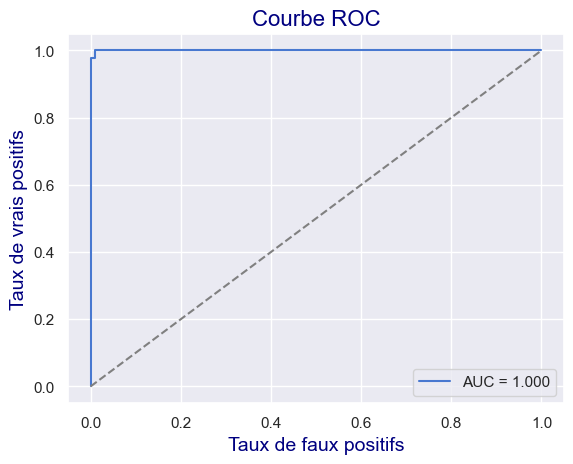

In [725]:
#La Courbe ROC-AUC

#y_test_proba = model.predict_proba(X_test_scaled)[:,1])

fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test_scaled)[:,1])

plt.plot(fpr, tpr, label=f"AUC = {roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:,1] ):.3f}")
plt.plot([0,1], [0,1], linestyle='--', color='gray')
plt.xlabel("Taux de faux positifs")
plt.ylabel("Taux de vrais positifs")
plt.title("Courbe ROC",size=16)
plt.legend()
plt.grid()
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.4.7 - Rapport de classification : </h4>
</div>

In [726]:
from sklearn.metrics import classification_report

In [727]:
print(classification_report(y_test, y_test_pred, digits=3))

              precision    recall  f1-score   support

           0      1.000     0.973     0.986       110
           1      0.984     1.000     0.992       190

    accuracy                          0.990       300
   macro avg      0.992     0.986     0.989       300
weighted avg      0.990     0.990     0.990       300



<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 7.4.8 - Analyse des coefficients (importance des variables : </h4>
</div>

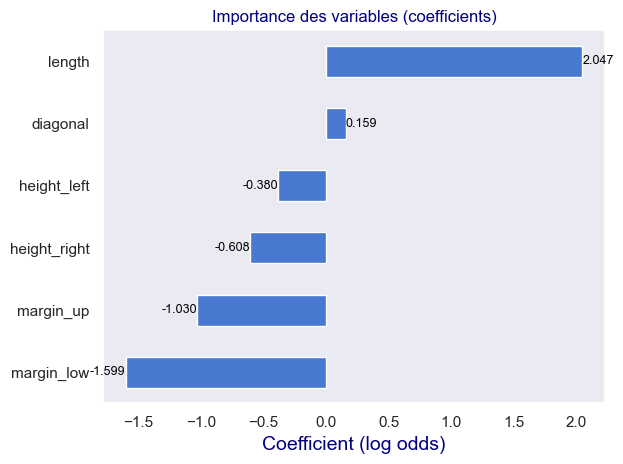

In [728]:
# Création de la série des coefficients
coeffs = pd.Series(model.coef_[0], index=X.columns)
coeffs_sorted = coeffs.sort_values()

# Création du graphique
ax = coeffs_sorted.plot(kind='barh', title="Importance des variables (coefficients)")
plt.xlabel("Coefficient (log odds)")

# Ajout des annotations (valeurs numériques sur les barres)
for i, (value, name) in enumerate(zip(coeffs_sorted, coeffs_sorted.index)):
    ax.text(x=value,                      # Position horizontale du texte
            y=i,                          # Position verticale (index de la barre)
            s=f"{value:.3f}",             # Texte à afficher (arrondi à 3 décimales)
            va='center', ha='left' if value > 0 else 'right',
            fontsize=9, color='black')

plt.tight_layout()
plt.show()

In [729]:
print("Converged :", model.n_iter_)  # Nombre d'itérations avant convergence


Converged : [8]


<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">ETAPE 8 - TEST D'UN RANDOM FOREST  </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">8.1 - Preparation des données </h3>
</div>

In [730]:
var_quant

['diagonal',
 'height_left',
 'height_right',
 'margin_low',
 'margin_up',
 'length']

In [731]:
#listes des variables prédictives pour le modèle RF_A : toutes les var quantitatives
var_pred_RF_A = ['diagonal', 
                'height_left', 'height_right', 
                'margin_low','margin_up', 
                'length']
#la variable cible :
var_cible = 'is_genuine'

In [732]:
#le jeu de données prédictif complet:
X = (df_billets_analyse_1_2_copy[var_pred_RF_A]).copy(deep=True)

#le jeu de données cible réel en convertissant les False en 0 et les True en 1
y = (df_billets_analyse_1_2_copy[var_cible]).copy(deep=True)
y = y.astype(int) #conversion des False / True en 0 /1

In [733]:
# split train, test
# proportion du jeu test : 0.2
#random_state : 42 pour pouvoir reproduire (une fois testé avec différent random_state)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

In [734]:
scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">8.2 - Un premier Random Forest </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.2.1 -Preparation des données déjà faite  : </h4>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.2.2 -Random Forest de base  : mpodèle clf_RF_A</h4>
</div>

In [735]:
from sklearn.ensemble import RandomForestClassifier

In [736]:
# initialisation et entraînement

from sklearn.ensemble import RandomForestClassifier

clf_RF_A = RandomForestClassifier(n_estimators=100,#default
                                  max_depth=None,#default risque d'overfit
                                  max_features=3,
                                  random_state=42
                                 )
clf_RF_A.fit(X_train_scaled, y_train)



,n_estimators,100
,criterion,'gini'
,max_depth,None
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,3
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,bootstrap,True
,oob_score,False


In [737]:
model = clf_RF_A

In [738]:
# Prédictions
y_test_pred = model.predict(X_test_scaled)
y_test_proba = model.predict_proba(X_test_scaled)[:, 1]  # Pour courbe ROC et seuils

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.2.3 - Observations des Probas</h4>
</div>

**PREDICTIONS :**

In [739]:
#Dejà fait
#y_test_pred = model.predict(X_test_scaled)

In [740]:
y_test_pred[:5]

array([0, 0, 1, 1, 1])

**PROBA DE PREDICTIONS :**

In [741]:
# les 5 premières lignes de  la première colonne de model.predict_proba(X_test_scaled)
model.predict_proba(X_test_scaled) [:5,1]

array([0., 0., 1., 1., 1.])

In [742]:
#déjà fait
#Array des probas de valoir 1
#y_test_proba = model.predict_proba(X_test_scaled)[:,1] # la 2ème colonne des probas

Un bon moyen d'analyser les performances d'un modèle de classification est de tracer l'histogramme des probabilités des prédictions.

Text(0.5, 1.0, 'Répartitions des probas de valoir 1 sur le jeu de test')

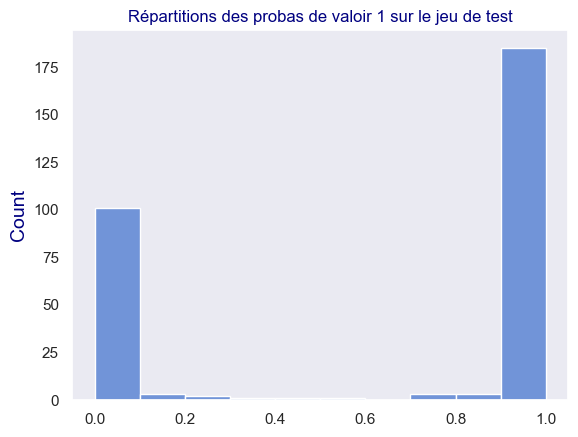

In [743]:
#Répartitions des probas de valoir 1 sur le jeu de test

sns.histplot(y_test_proba)
plt.title("Répartitions des probas de valoir 1 sur le jeu de test")

Le modèle est assez confiant de ses prédiction sur le jeu de test :  
la plupart des prédictions ont une probabilité proche de 0 ou de 1

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.2.4 - Score de performance : Exactitude(accuracy) </h4>
</div>

In [744]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_auc_score, roc_curve

Le plus simple pour mesurer la performance d'une classification est de regarder  
L'**exactitude(accuracy)**, c'est la proportion d'échantillons bien classé :  
exactitude = (échantillons bien classés)/échantillons au total

In [745]:
from sklearn.metrics import accuracy_score

In [746]:
print("Score d'Exactitude-accuracy sur le jeu test = ",accuracy_score(y_test, y_test_pred))

Score d'Exactitude-accuracy sur le jeu test =  0.9933333333333333


**OBSERVATION :**  
99% d'échantilons bien classés sur le jeu test, très bonne performance

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.2.5 - Matrice de confusion </h4>
</div>

In [747]:
from sklearn.metrics import confusion_matrix

Attention la matrice de confusion pour scikit-learn est :  
TN | FP  
FN | TP  

In [748]:
confusion_matrix(y_test, y_test_pred)

array([[108,   2],
       [  0, 190]], dtype=int64)

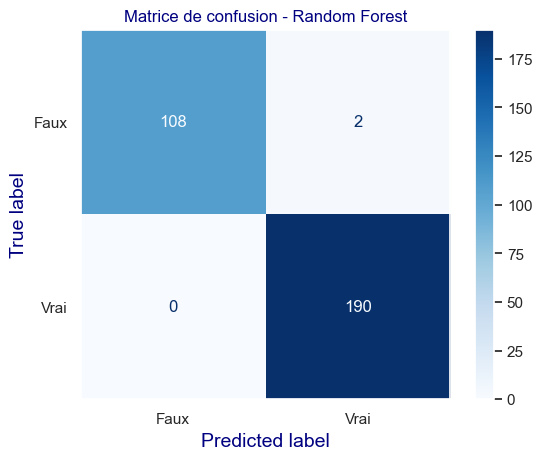

In [749]:
ConfusionMatrixDisplay.from_predictions(
    y_test, y_test_pred, display_labels=['Faux', 'Vrai'], cmap='Blues'
)
plt.title("Matrice de confusion - Random Forest")
plt.show()

In [750]:
# Matrice de confusion
tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred).ravel()

# Calculs
TPR = tp / (tp + fn) if (tp + fn) != 0 else 0
FPR = fp / (fp + tn) if (fp + tn) != 0 else 0

# Affichage
print(f"TPR (Recall / Sensibilité) : {TPR:.3f}")
print(f"FPR (Taux de faux positifs) : {FPR:.3f}")

TPR (Recall / Sensibilité) : 1.000
FPR (Taux de faux positifs) : 0.018


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.2.6 -  Autres metriques de classification : </h4>
</div>

Precision, Recall et ROC_AUC

In [751]:
from sklearn.metrics import precision_score, recall_score, roc_auc_score

<u>**Le Rappel-recall ou TPR(True Positive Rate):**</u>  
Rappel = TP/(TP+FN)  
= Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  
Compris entre 0 et 1.  
Plus il augmente plus cela minimise les Faux négatifs.  
(plus FN augmente, plus Rappel baisse)  
Plus on diminue le seuil de détection des positifs, plus on diminuera FN, plus on augmentera le Rappel.  

<u>**La Précision :**</u>  
Précision = TP/(TP+FP)  
= Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
Compris entre 0 et 1.  
plus il augmente, plus cela minimise lse Faux positifs.  
(plus FP augmente, plus la précision baisse)  
Plus on augmente le seuil de détection des positifs,  
plus on diminuera les FP,  plus on augmentera La Précision.  



**TPR(True Positive Rate)=Recall**  
TPR= TP / (TP + FN) (Taux de Positifs détectés parmi les positifs réels)
Plus TPR est haut, mieux c'est.  

**FPR(False Positive Rate)**  
FPR=  FP / (FP+TN)   (Taux de Faux positifs parmis les négatifs réels)
Plus FPR, est bas, mieux c'est.  

**Courbe ROC (Receiver Operating Characteristic) ou encore fonction d’efficacité du récepteur**  
TPR en fonction de FPR

<u>**ROC_AUC : Area under the ROC ou surface sous la courbe ROC**</u>  
Compris entre 0 et 1.  

Plus elle est proche de 1 mieux c'est :   
- Cela signifie que l'on peut trouver un TPR élevé pour un FPR bas.

Pour une courbe plus basse (0.5 ou au dessous) :
- avoir un TPR élevé se fait au prix d’un FPR élevé   ; 
-avoir une FPR bas se fait au prix d’un TPR bas.


In [752]:
print("Recall : ",recall_score(y_test, y_test_pred))
print("Precision : ",precision_score(y_test, y_test_pred))
print("ROC-AUC : ", roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:, 1]))

Recall :  1.0
Precision :  0.9895833333333334
ROC-AUC :  0.9999043062200956


**OBSERVATION :**  
- Très bon Recall (proche de 1)  
(TPR)(Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  )   
- Très bonne Précision (proche de 1)  
Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
- Très bon ROC (proche de 1)  
on peut trouver un TPR((True Positive Rate) élevé pour un FPR(False Positive Rate) bas.

**Courbe ROC :**

In [753]:
from sklearn.metrics import roc_curve

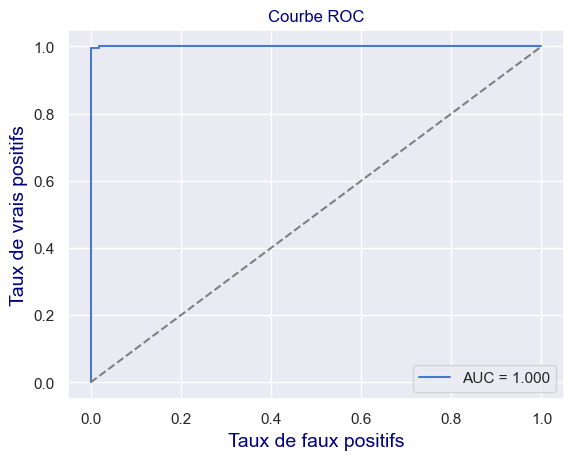

In [754]:
#La Courbe ROC-AUC

#y_test_proba = model.predict_proba(X_test_scaled)[:,1])

fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test_scaled)[:,1])

plt.plot(fpr, tpr, label=f"AUC = {roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:,1] ):.3f}")
plt.plot([0,1], [0,1], linestyle='--', color='gray')
plt.xlabel("Taux de faux positifs")
plt.ylabel("Taux de vrais positifs")
plt.title("Courbe ROC")
plt.legend()
plt.grid()
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.2.7 - Rapport de classification : </h4>
</div>

In [755]:
from sklearn.metrics import classification_report

In [756]:
print(classification_report(y_test, y_test_pred, digits=3))

              precision    recall  f1-score   support

           0      1.000     0.982     0.991       110
           1      0.990     1.000     0.995       190

    accuracy                          0.993       300
   macro avg      0.995     0.991     0.993       300
weighted avg      0.993     0.993     0.993       300



<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.2.8 - Analyse des coefficients (importance des variables : </h4>
</div>

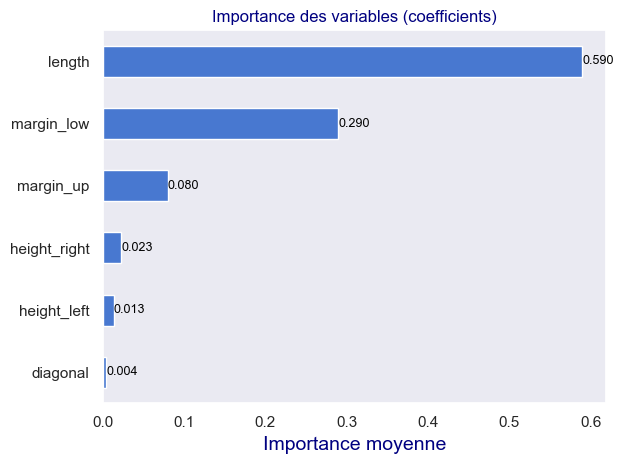

In [757]:
# Création de la série des coefficients
importances = pd.Series(model.feature_importances_, index=X.columns)
importances_sorted = importances.sort_values()

# Création du graphique
ax = importances_sorted.plot(kind='barh', title="Importance des variables (coefficients)")
plt.xlabel("Importance moyenne")#"Importance moyenne (Gini)"

# Ajout des annotations (valeurs numériques sur les barres)
for i, (value, name) in enumerate(zip(importances_sorted, importances_sorted.index)):
    ax.text(x=value,                      # Position horizontale du texte
            y=i,                          # Position verticale (index de la barre)
            s=f"{value:.3f}",             # Texte à afficher (arrondi à 3 décimales)
            va='center', ha='left' if value > 0 else 'right',
            fontsize=9, color='black')

plt.tight_layout()
plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">8.3 - VERIFICATION DE PERFORMANCE ET AMELIORATION DU RANDOM FOREST  </h3>
</div>

J'ai déjà fait un RandomForest qui donne de bon résultats (avec plusieurs random_state).  
Regardons si elle est stable et si elle peut être améliorer ?

Remarque :  
Je peux garder X_train_scaled, même si le scaling n’est pas nécessaire pour Random Forest.  
Mais je le garde par homogénéité et comparaison

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.3.1 -  : VALIDATION CROISEE 1:Robustesse au jeu de données</h4>
</div>

**Validation croisée**

Objectif : s’assurer que la performance n’est pas liée à un seul split train/test

In [758]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_validate

model = RandomForestClassifier(random_state=42)

scoring = {
    'accuracy': 'accuracy',
    'precision': 'precision',
    'recall': 'recall',
    'roc_auc': 'roc_auc',
}

results = cross_validate(model, X_train_scaled, y_train, cv=5, scoring=scoring)

for metric in scoring.keys():
    scores = results[f'test_{metric}']
    print(f"{metric.capitalize()} : Moyenne = {scores.mean():.3f} | Écart-type = {scores.std():.3f}")


Accuracy : Moyenne = 0.993 | Écart-type = 0.003
Precision : Moyenne = 0.991 | Écart-type = 0.005
Recall : Moyenne = 0.998 | Écart-type = 0.003
Roc_auc : Moyenne = 0.999 | Écart-type = 0.001


Les scores sont très bons et stables, ils dépendent peu du choix de jeu test.

Ecart-type faible (< 0.01) => modèle stable peu importe le jeu de test choisi.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.3.2 -  : VALIDATION CROISEE 2 :Robustesse au random state de LogisticRegression</h4>
</div>

**Validation croisée 2**

Objectif : évaluer la variance des scores en fonction de plusieurs valeurs de random_state dans la Regression logistic :

Remarque :  
RandomForest est stochastique, donc la méthode est très pertinente ici aussi.

In [759]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_validate
import numpy as np

random_states = range(0, 100, 10)
all_results = {metric: [] for metric in ['accuracy', 'precision', 'recall', 'roc_auc']}

scoring = {
    'accuracy': 'accuracy',
    'precision': 'precision',
    'recall': 'recall',
    'roc_auc': 'roc_auc',
}

for rs in random_states:
    model = RandomForestClassifier(random_state=rs)
    results = cross_validate(model, X_train_scaled, y_train, cv=5, scoring=scoring)
    
    for metric in scoring.keys():
        all_results[metric].append(results[f'test_{metric}'].mean())

print("📊 Résumé des performances selon différents random_state :")
for metric, values in all_results.items():
    print(f"{metric.capitalize()} : Moyenne = {np.mean(values):.3f} | Écart-type = {np.std(values):.3f}")


📊 Résumé des performances selon différents random_state :
Accuracy : Moyenne = 0.992 | Écart-type = 0.001
Precision : Moyenne = 0.991 | Écart-type = 0.001
Recall : Moyenne = 0.997 | Écart-type = 0.001
Roc_auc : Moyenne = 0.999 | Écart-type = 0.000


**Ecart-type faible (< 0.01) => modèle stable peu importe le random_state choisi.**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.3.3 -  Sélection de variable : PAS DE SELECTION de VARIABLE Pour comparaison </h4>
</div>

**Sélection de variables**  
Objectif : tester si certaines variables sont peu utiles, voire nuisibles


Ayant peu de variables et peu de données,
n'ayant pas retiré de variable pour la Regression Logistique,   
pour pouvoir comparer je vais garder l'ensemble des variables.  
D'autant plus que cela avait fait baisser les scores de l aRegression logistique, et que le RandomForest fait lui-même des actions via n_features.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.3.4 GridSearchCV : Recherche des meilleurs paramètres de RandomForestClassifier </h4>
</div>

**GridSearchCV**  
Objectif : rechercher la meilleure paramétrisation

`n_estimators` :  
Le nombre d’arbres dans la forêt. Plus il y en a, plus le modèle est stable, mais plus le temps de calcul augmente.  

`max_depth :`
La profondeur maximale de chaque arbre. Un arbre trop profond risque de surapprendre (overfitting), un arbre trop peu profond risque de sous-apprendre (underfitting).  

`max_features :`  
Le nombre de variables (features) à considérer pour chaque split. Cela contrôle la diversité entre les arbres et réduit le surapprentissage.  

`min_samples_split :`  
Le nombre minimum d’échantillons requis pour diviser un nœud. Augmenter cette valeur permet de rendre le modèle plus simple et moins sujet à l’overfitting.  

`criterion :`  
La fonction utilisée pour mesurer la qualité d’un split. gini est plus rapide ; entropy peut donner des résultats similaires mais est plus coûteux en calcul.

RESUME :  
- `n_estimators` : nombre d’arbres dans la forêt, augmente la robustesse du modèle.  
- `max_depth` : limite la profondeur des arbres pour éviter le surapprentissage.
- `max_features` : contrôle combien de variables sont testées à chaque division pour favoriser la diversité.  
- `min_samples_split` : empêche les arbres de trop se complexifier en exigeant un minimum d’échantillons pour un split.  
- `criterion` : définit la méthode de mesure de la qualité d’un split (gini ou entropy).  

**RESULTATS :**    
Meilleurs paramètres : {'criterion': 'entropy', 'max_depth': 10, 'max_features': 2, 'min_samples_split': 2, 'n_estimators': 500}
Meilleure AUC moyenne : 0.9996043051598609

**TEMPS DE CALCUL TRES LONG :**  
Donc je vais le figer, et le refarie en dynamique avec moins de paramètres : 

In [760]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

param_grid = {
    'n_estimators': [100, 500],
    'max_depth': [ 5, 10],
    'max_features': [2, 3],
    'min_samples_split': [2, 5],
    'criterion': ['gini', 'entropy'],
}

model = RandomForestClassifier(random_state=42)
grid = GridSearchCV(model, param_grid, cv=5, scoring='roc_auc', n_jobs=-1)

grid.fit(X_train_scaled, y_train)

print("Meilleurs paramètres :", grid.best_params_)
print("Meilleure AUC moyenne :", grid.best_score_)

Meilleurs paramètres : {'criterion': 'entropy', 'max_depth': 10, 'max_features': 2, 'min_samples_split': 2, 'n_estimators': 500}
Meilleure AUC moyenne : 0.9996043051598609


**OBSERVATION :**  
Les meilleurs paramètres sont :  
{'criterion': 'entropy', 'max_depth': 10, 'max_features': 2, 'min_samples_split': 2, 'n_estimators': 500}

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.3.5 Importance des variables (équivalent des coefficients)</h4>
</div>

**Analyse des coefficients**  
Objectif : interpréter les variables importantes

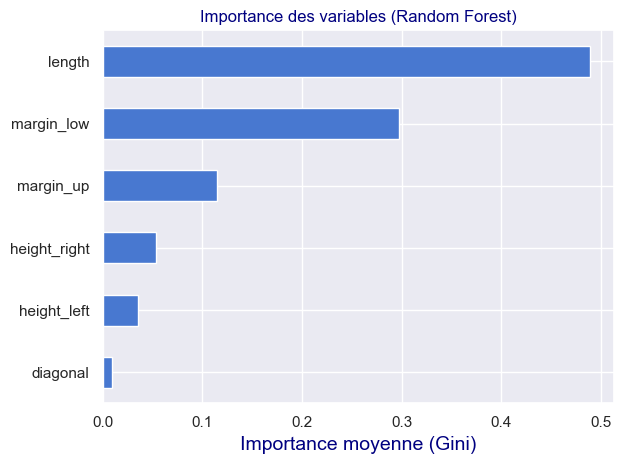

In [761]:
#import pandas as pd
#import matplotlib.pyplot as plt

model_best = grid.best_estimator_

importances = pd.Series(model_best.feature_importances_, index=X.columns)
importances.sort_values().plot(kind='barh', title="Importance des variables (Random Forest)")
plt.xlabel("Importance moyenne (Gini)")
plt.tight_layout()
plt.grid()
plt.show()


**Évaluation classique :**

In [762]:
from sklearn.metrics import classification_report, confusion_matrix

y_test_pred = model_best.predict(X_test_scaled)

print(confusion_matrix(y_test, y_test_pred))
print(classification_report(y_test, y_test_pred))

[[108   2]
 [  0 190]]
              precision    recall  f1-score   support

           0       1.00      0.98      0.99       110
           1       0.99      1.00      0.99       190

    accuracy                           0.99       300
   macro avg       0.99      0.99      0.99       300
weighted avg       0.99      0.99      0.99       300



<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.3.6 -Ajustement du seuil de proba </h4>
</div>

**Ajustement du seuil**  
Objectif : trouver un meilleur compromis entre TPR et FPR

In [763]:
from sklearn.metrics import confusion_matrix

y_prob = model_best.predict_proba(X_test_scaled)[:, 1]
seuils = [0.3, 0.4, 0.5, 0.6, 0.7]

for seuil in seuils:
    y_pred = (y_prob >= seuil).astype(int)
    tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()
    TPR = tp / (tp + fn)
    FPR = fp / (fp + tn)
    print(f"Seuil {seuil:.2f} → TPR : {TPR:.2f} | FPR : {FPR:.2f}")

Seuil 0.30 → TPR : 1.00 | FPR : 0.04
Seuil 0.40 → TPR : 1.00 | FPR : 0.04
Seuil 0.50 → TPR : 1.00 | FPR : 0.02
Seuil 0.60 → TPR : 1.00 | FPR : 0.02
Seuil 0.70 → TPR : 0.99 | FPR : 0.00


Je pense que c'est important qu'il n'y ait pas de Faux négatifs, donc que TPR soit le plus haut possible, avec le FPR le plus bas possible.  
Le seuil à 0.5 est encore le meilleur (avc 0.6)et sera conservé;

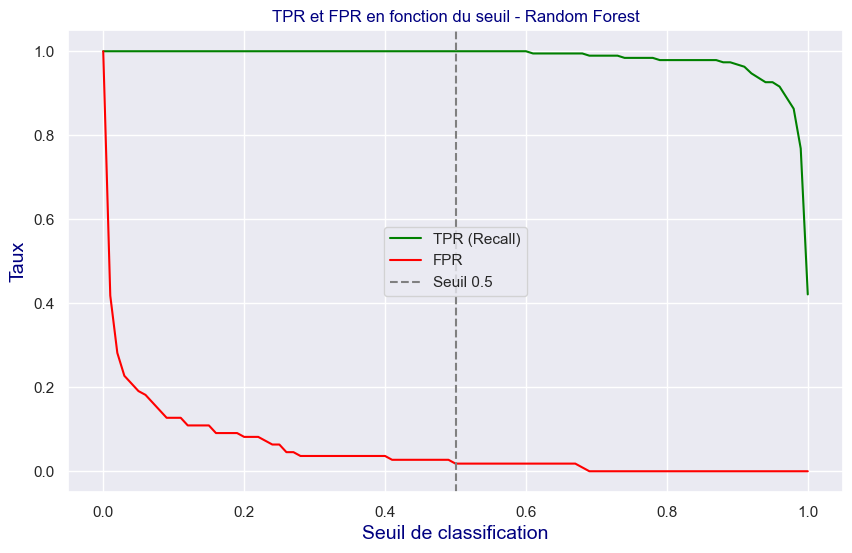

In [764]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

seuils = np.arange(0, 1.01, 0.01)
tpr_list = []
fpr_list = []

for seuil in seuils:
    y_pred_seuil = (y_prob >= seuil).astype(int)
    tn, fp, fn, tp = confusion_matrix(y_test, y_pred_seuil).ravel()
    tpr = tp / (tp + fn) if (tp + fn) != 0 else 0
    fpr = fp / (fp + tn) if (fp + tn) != 0 else 0
    tpr_list.append(tpr)
    fpr_list.append(fpr)

plt.figure(figsize=(10, 6))
plt.plot(seuils, tpr_list, label='TPR (Recall)', color='green')
plt.plot(seuils, fpr_list, label='FPR', color='red')
plt.axvline(0.5, color='gray', linestyle='--', label='Seuil 0.5')
plt.xlabel("Seuil de classification")
plt.ylabel("Taux")
plt.title("TPR et FPR en fonction du seuil - Random Forest")
plt.legend()
plt.grid(True)
plt.show()


**Visualisation : courbe ROC**  
Objectif : visualiser tous les seuils possibles + AUC

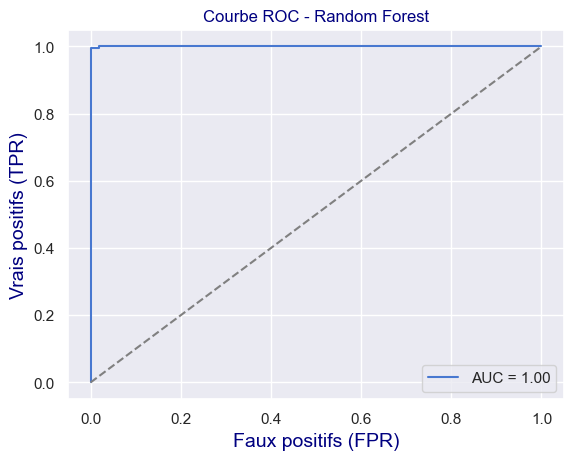

In [765]:
from sklearn.metrics import roc_curve, auc

fpr, tpr, thresholds = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, label=f"AUC = {roc_auc:.2f}")
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel("Faux positifs (FPR)")
plt.ylabel("Vrais positifs (TPR)")
plt.title("Courbe ROC - Random Forest")
plt.legend()
plt.grid()
plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">8.4 -  SYNTHESE DES MEILLEURS PARAMETRES : RANDOM FOREST CLASSIFIER  </h3>
</div>

**Rappel :**   
Standardisation	Oui, avec StandardScaler() après découpage Train/Test
Modèle	LogisticRegression

**Variables sélectionnées :**  
PAS DE SELECTION :
['diagonal', 'height_left', 'height_right', 'margin_low', 'margin_up',
       'length']

**Paramètres optimaux :**  {'criterion': 'entropy', 'max_depth': 10, 'max_features': 2,'min_samples_split': 2, 'n_estimators': 500} 

**Seuil de décision**  
0.5 (valide car bon compromis entre TPR & FPR)

In [766]:
df_billets_analyse_1_2_copy[var_quant].columns

Index(['diagonal', 'height_left', 'height_right', 'margin_low', 'margin_up',
       'length'],
      dtype='object')

**MODELE DE RANDOM FOREST FINAL :**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.4.1 -  Préparation des données identiques: </h4>
</div>

In [767]:
# Liste des variables prédictives (identique à la régression logistique)
var_pred_RF_final = ['diagonal',
                     'height_left', 'height_right',
                     'margin_low', 'margin_up',
                     'length']
var_cible = 'is_genuine'

# Jeu de données prédictif et cible
X = df_billets_analyse_1_2_copy[var_pred_RF_final].copy(deep=True)
y = df_billets_analyse_1_2_copy[var_cible].astype(int)  # Conversion booléen → int

# Split train/test
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.20, random_state=42
)

# Standardisation
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.4.2 -  Initialisation du modèle Random Forest final avec les meilleurs hyperparamètres:clf_RF_final  </h4>
</div>

In [768]:
from sklearn.ensemble import RandomForestClassifier

clf_RF_final = RandomForestClassifier(
    n_estimators=500,
    max_depth=10,
    max_features=2,
    min_samples_split=2,
    criterion='entropy',
    random_state=42
)

clf_RF_final.fit(X_train_scaled, y_train)
model = clf_RF_final

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.4.3 -  Prédictions et Probabilités </h4>
</div>

In [769]:
y_test_pred = model.predict(X_test_scaled)
y_test_proba = model.predict_proba(X_test_scaled)[:, 1]  # Probabilité d’être "vrai billet"

Un bon moyen d'analyser les performances d'un modèle de classification est de tracer l'histogramme des probabilités des prédictions.

Text(0.5, 1.0, 'Répartitions des probas de valoir 1 sur le jeu de test')

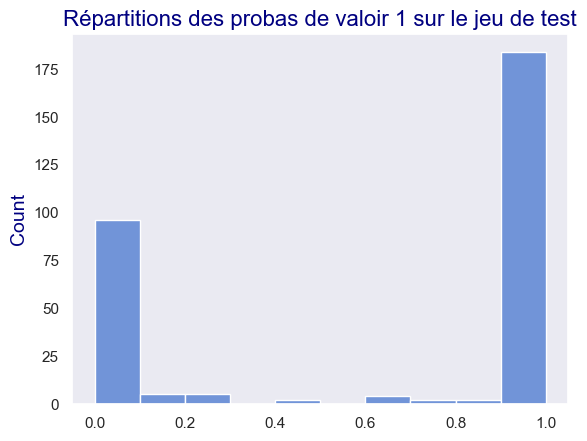

In [770]:
#Répartitions des probas de valoir 1 sur le jeu de test

sns.histplot(y_test_proba)
plt.title("Répartitions des probas de valoir 1 sur le jeu de test",size=16)

Le modèle est assez confiant de ses prédiction sur le jeu de test :  
la plupart des prédictions ont une probabilité proche de 0 ou de 1

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.4.4 - Score de performance : Exactitude(accuracy) </h4>
</div>

In [771]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_auc_score, roc_curve

Le plus simple pour mesurer la performance d'une classification est de regarder  
L'**exactitude(accuracy)**, c'est la proportion d'échantillons bien classé :  
exactitude = (échantillons bien classés)/échantillons au total

In [772]:
from sklearn.metrics import accuracy_score

In [773]:
print("Score d'Exactitude-accuracy sur le jeu test = ",accuracy_score(y_test, y_test_pred))

Score d'Exactitude-accuracy sur le jeu test =  0.9933333333333333


**OBSERVATION :**  
99% d'échantilons bien classés sur le jeu test, très bonne performance

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.4.5 - Matrice de confusion </h4>
</div>

In [774]:
from sklearn.metrics import confusion_matrix

Attention la matrice de confusion pour scikit-learn est :  
TN | FP  
FN | TP  

In [775]:
confusion_matrix(y_test, y_test_pred)

array([[108,   2],
       [  0, 190]], dtype=int64)

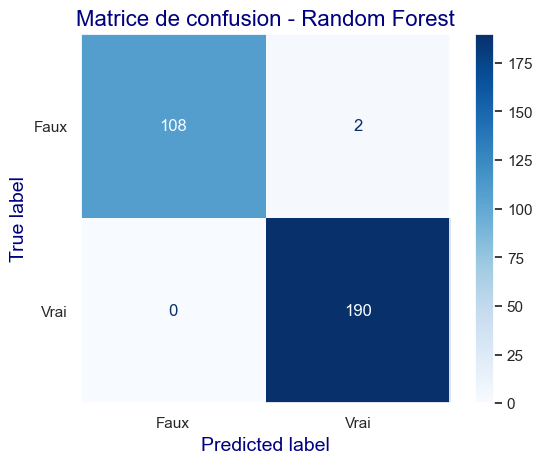

In [776]:
ConfusionMatrixDisplay.from_predictions(
    y_test, y_test_pred, display_labels=['Faux', 'Vrai'], cmap='Blues'
)
plt.title("Matrice de confusion - Random Forest",size=16)
plt.show()

In [777]:
# Matrice de confusion
tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred).ravel()

# Calculs
TPR = tp / (tp + fn) if (tp + fn) != 0 else 0
FPR = fp / (fp + tn) if (fp + tn) != 0 else 0

# Affichage
print(f"TPR (Recall / Sensibilité) : {TPR:.3f}")
print(f"FPR (Taux de faux positifs) : {FPR:.3f}")

TPR (Recall / Sensibilité) : 1.000
FPR (Taux de faux positifs) : 0.018


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.4.6 -  Autres metriques de classification : </h4>
</div>

Precision, Recall et ROC_AUC

In [778]:
from sklearn.metrics import precision_score, recall_score, roc_auc_score

<u>**Le Rappel-recall ou TPR(True Positive Rate):**</u>  
Rappel = TP/(TP+FN)  
= Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  
Compris entre 0 et 1.  
Plus il augmente plus cela minimise les Faux négatifs.  
(plus FN augmente, plus Rappel baisse)  
Plus on diminue le seuil de détection des positifs, plus on diminuera FN, plus on augmentera le Rappel.  

<u>**La Précision :**</u>  
Précision = TP/(TP+FP)  
= Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
Compris entre 0 et 1.  
plus il augmente, plus cela minimise lse Faux positifs.  
(plus FP augmente, plus la précision baisse)  
Plus on augmente le seuil de détection des positifs,  
plus on diminuera les FP,  plus on augmentera La Précision.  



**TPR(True Positive Rate)=Recall**  
TPR= TP / (TP + FN) (Taux de Positifs détectés parmi les positifs réels)
Plus TPR est haut, mieux c'est.  

**FPR(False Positive Rate)**  
FPR=  FP / (FP+TN)   (Taux de Faux positifs parmis les négatifs réels)
Plus FPR, est bas, mieux c'est.  

**Courbe ROC (Receiver Operating Characteristic) ou encore fonction d’efficacité du récepteur**  
TPR en fonction de FPR

<u>**ROC_AUC : Area under the ROC ou surface sous la courbe ROC**</u>  
Compris entre 0 et 1.  

Plus elle est proche de 1 mieux c'est :   
- Cela signifie que l'on peut trouver un TPR élevé pour un FPR bas.

Pour une courbe plus basse (0.5 ou au dessous) :
- avoir un TPR élevé se fait au prix d’un FPR élevé   ; 
-avoir une FPR bas se fait au prix d’un TPR bas.


In [779]:
print("Recall : ",recall_score(y_test, y_test_pred))
print("Precision : ",precision_score(y_test, y_test_pred))
print("ROC-AUC : ", roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:, 1]))

Recall :  1.0
Precision :  0.9895833333333334
ROC-AUC :  0.9999043062200957


**OBSERVATION :**  
- Très bon Recall (proche de 1)  
(TPR)(Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  )   
- Très bonne Précision (proche de 1)  
Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
- Très bon ROC (proche de 1)  
on peut trouver un TPR((True Positive Rate) élevé pour un FPR(False Positive Rate) bas.

**Courbe ROC :**

In [780]:
from sklearn.metrics import roc_curve

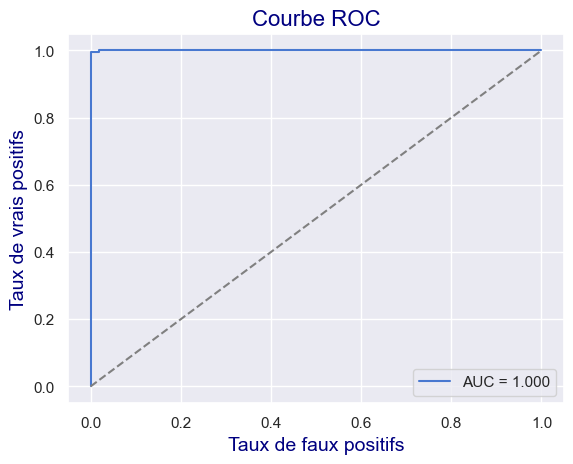

In [781]:
#La Courbe ROC-AUC

#y_test_proba = model.predict_proba(X_test_scaled)[:,1])

fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test_scaled)[:,1])

plt.plot(fpr, tpr, label=f"AUC = {roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:,1] ):.3f}")
plt.plot([0,1], [0,1], linestyle='--', color='gray')
plt.xlabel("Taux de faux positifs")
plt.ylabel("Taux de vrais positifs")
plt.title("Courbe ROC",size=16)
plt.legend()
plt.grid()
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.4.7 - Rapport de classification : </h4>
</div>

In [782]:
from sklearn.metrics import classification_report

In [783]:
print(classification_report(y_test, y_test_pred, digits=3))

              precision    recall  f1-score   support

           0      1.000     0.982     0.991       110
           1      0.990     1.000     0.995       190

    accuracy                          0.993       300
   macro avg      0.995     0.991     0.993       300
weighted avg      0.993     0.993     0.993       300



<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 8.4.8 - Analyse des coefficients (importance des variables : </h4>
</div>

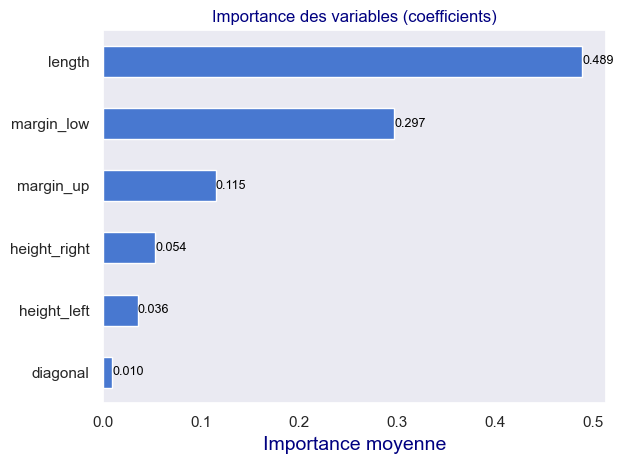

In [784]:
# Création de la série des coefficients
importances = pd.Series(model.feature_importances_, index=X.columns)
importances_sorted = importances.sort_values()

# Création du graphique
ax = importances_sorted.plot(kind='barh', title="Importance des variables (coefficients)")
plt.xlabel("Importance moyenne")#"Importance moyenne (Gini)"

# Ajout des annotations (valeurs numériques sur les barres)
for i, (value, name) in enumerate(zip(importances_sorted, importances_sorted.index)):
    ax.text(x=value,                      # Position horizontale du texte
            y=i,                          # Position verticale (index de la barre)
            s=f"{value:.3f}",             # Texte à afficher (arrondi à 3 décimales)
            va='center', ha='left' if value > 0 else 'right',
            fontsize=9, color='black')

plt.tight_layout()
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); ">  8.4.9 Affichage des performances Sytnhèse</h4>
</div>

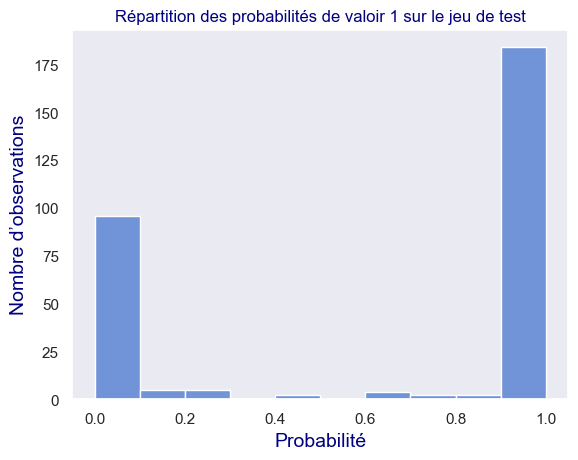

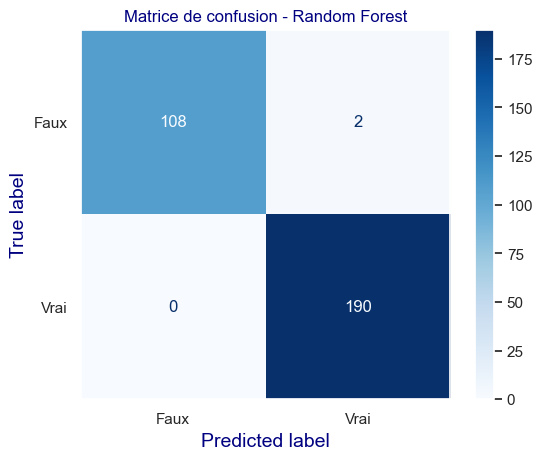

Accuracy : 0.993
Precision : 0.990
Recall (Sensibilité) : 1.000
ROC-AUC : 1.000

Rapport de classification :

              precision    recall  f1-score   support

           0      1.000     0.982     0.991       110
           1      0.990     1.000     0.995       190

    accuracy                          0.993       300
   macro avg      0.995     0.991     0.993       300
weighted avg      0.993     0.993     0.993       300



In [785]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, roc_auc_score, confusion_matrix, ConfusionMatrixDisplay, classification_report
import seaborn as sns
import matplotlib.pyplot as plt

# Histogramme des probabilités
sns.histplot(y_test_proba)
plt.title("Répartition des probabilités de valoir 1 sur le jeu de test")
plt.xlabel("Probabilité")
plt.ylabel("Nombre d’observations")
plt.show()

# Matrice de confusion
ConfusionMatrixDisplay.from_predictions(
    y_test, y_test_pred, display_labels=['Faux', 'Vrai'], cmap='Blues'
)
plt.title("Matrice de confusion - Random Forest")
plt.show()

# Métriques
print(f"Accuracy : {accuracy_score(y_test, y_test_pred):.3f}")
print(f"Precision : {precision_score(y_test, y_test_pred):.3f}")
print(f"Recall (Sensibilité) : {recall_score(y_test, y_test_pred):.3f}")
print(f"ROC-AUC : {roc_auc_score(y_test, y_test_proba):.3f}")

print("\nRapport de classification :\n")
print(classification_report(y_test, y_test_pred, digits=3))


**Courbe ROC et seuils**

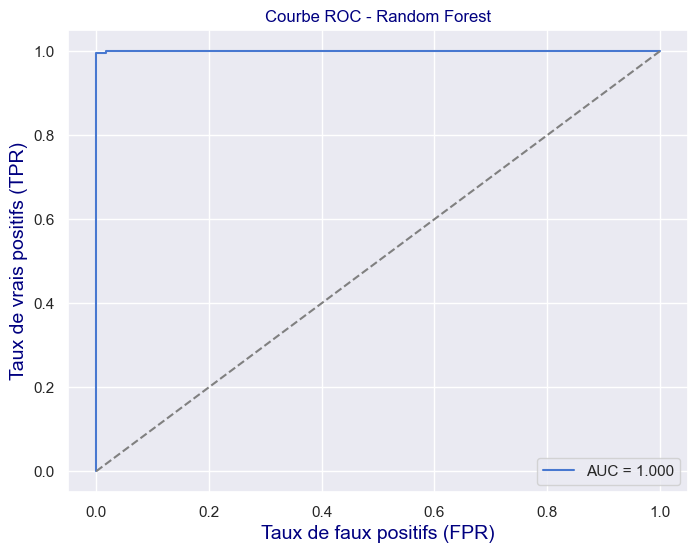

Seuil 0.30 → TPR : 1.00 | FPR : 0.04
Seuil 0.40 → TPR : 1.00 | FPR : 0.04
Seuil 0.50 → TPR : 1.00 | FPR : 0.02
Seuil 0.60 → TPR : 1.00 | FPR : 0.02
Seuil 0.70 → TPR : 0.99 | FPR : 0.00


In [786]:
from sklearn.metrics import roc_curve

fpr, tpr, thresholds = roc_curve(y_test, y_test_proba)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f"AUC = {roc_auc_score(y_test, y_test_proba):.3f}")
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel("Taux de faux positifs (FPR)")
plt.ylabel("Taux de vrais positifs (TPR)")
plt.title("Courbe ROC - Random Forest")
plt.legend()
plt.grid()
plt.show()

# Analyse de quelques seuils
for seuil in [0.3, 0.4, 0.5, 0.6, 0.7]:
    y_seuil = (y_test_proba >= seuil).astype(int)
    tn, fp, fn, tp = confusion_matrix(y_test, y_seuil).ravel()
    tpr_val = tp / (tp + fn)
    fpr_val = fp / (fp + tn)
    print(f"Seuil {seuil:.2f} → TPR : {tpr_val:.2f} | FPR : {fpr_val:.2f}")


<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">ETAPE 9 - TEST D'UN MODELE KNN  </h2>
</di</div>


<u>**KNN – Principes de base :**</u>  
Le KNN (K-Nearest Neighbors) est un algorithme non paramétrique basé sur la proximité des données.  

**Idée principale :**  
Pour prédire la classe d’un nouvel échantillon, on regarde les K points les plus proches (voisins) dans les données d'entraînement, puis on prend la classe majoritaire (ou un vote pondéré).  

**Caractéristiques clés :**  
- Pas d’apprentissage à proprement parler : l’algorithme mémorise les données.
- La distance entre points joue un rôle fondamental.
- Le choix de K (nbre de voisins) et de la distance utilisée a un impact majeur sur la performance.

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">9.1 - Preparation des données </h3>
</div>

In [787]:
# Liste des variables quantitatives pour KNN (identique à RF)
var_pred_KNN = ['diagonal', 
                'height_left', 'height_right', 
                'margin_low','margin_up', 
                'length']
var_cible = 'is_genuine'

# Données prédictives
X = df_billets_analyse_1_2_copy[var_pred_KNN].copy()

#le jeu de données cible réel en convertissant les False en 0 et les True en 1
y = (df_billets_analyse_1_2_copy[var_cible]).copy(deep=True)
y = y.astype(int) #conversion des False / True en 0 /1

# Séparation train / test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

# Standardisation des données
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">9.2 - Premier Modèle KNN</h3>
</div>


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.2.1 -Preparation des données déjà faite  : </h4>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.2.2 -Random Forest de base  : modèle clf_KNN_A</h4>
</div>

In [788]:
from sklearn.neighbors import KNeighborsClassifier

# Initialisation d’un modèle KNN basique
clf_KNN_A = KNeighborsClassifier(n_neighbors=5)
clf_KNN_A.fit(X_train_scaled, y_train)

model = clf_KNN_A

# Prédictions
y_test_pred = model.predict(X_test_scaled)
y_test_proba = model.predict_proba(X_test_scaled)[:, 1]  # Pour ROC/seuils


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.2.3 -Observations des Probas</h4>
</div>

**PREDICTIONS :**

In [789]:
#Dejà fait
#y_test_pred = model.predict(X_test_scaled)

In [790]:
y_test_pred[:5]

array([0, 0, 1, 1, 1])

**PROBA DE PREDICTIONS :**

In [791]:
# les 5 premières lignes de  la première colonne de model.predict_proba(X_test_scaled)
model.predict_proba(X_test_scaled) [:5,1]

array([0., 0., 1., 1., 1.])

In [792]:
#déjà fait
#Array des probas de valoir 1
#y_test_proba = model.predict_proba(X_test_scaled)[:,1] # la 2ème colonne des probas

Un bon moyen d'analyser les performances d'un modèle de classification est de tracer l'histogramme des probabilités des prédictions.

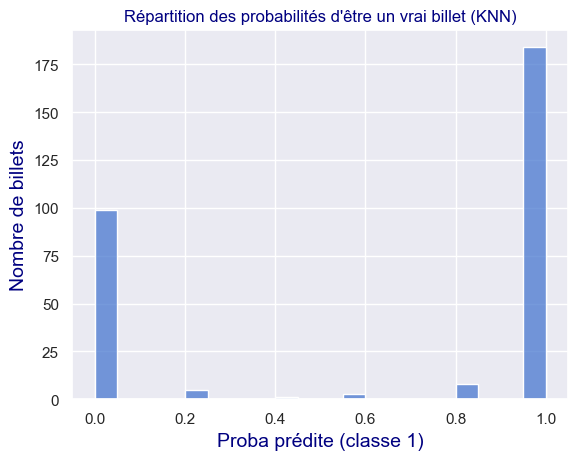

In [793]:
#Répartitions des probas de valoir 1 sur le jeu de test


sns.histplot(y_test_proba, bins=20, kde=False)
plt.title("Répartition des probabilités d'être un vrai billet (KNN)")#proba de valoir 1
plt.xlabel("Proba prédite (classe 1)")
plt.ylabel("Nombre de billets")
plt.grid(True)
plt.show()

Le modèle est assez confiant de ses prédiction sur le jeu de test :  
la plupart des prédictions ont une probabilité proche de 0 ou de 1

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.2.4 - Score de performance : Exactitude(accuracy) </h4>
</div>

In [794]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_auc_score, roc_curve

Le plus simple pour mesurer la performance d'une classification est de regarder  
L'**exactitude(accuracy)**, c'est la proportion d'échantillons bien classé :  
exactitude = (échantillons bien classés)/échantillons au total

In [795]:
from sklearn.metrics import accuracy_score

In [796]:
print("Score d'Exactitude-accuracy sur le jeu test = ",accuracy_score(y_test, y_test_pred))

Score d'Exactitude-accuracy sur le jeu test =  0.9833333333333333


**OBSERVATION :**  
99% d'échantilons bien classés sur le jeu test, très bonne performance

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.2.5 - Matrice de confusion </h4>
</div>

In [797]:
from sklearn.metrics import confusion_matrix

Attention la matrice de confusion pour scikit-learn est :  
TN | FP  
FN | TP  

In [798]:
confusion_matrix(y_test, y_test_pred)

array([[105,   5],
       [  0, 190]], dtype=int64)

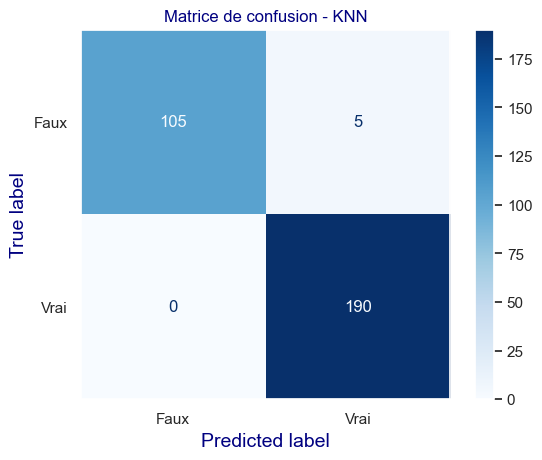

In [799]:
ConfusionMatrixDisplay.from_predictions(
    y_test, y_test_pred, display_labels=['Faux', 'Vrai'], cmap='Blues'
)
plt.title("Matrice de confusion - KNN")
plt.show()

In [800]:
# Matrice de confusion
tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred).ravel()

# Calculs
TPR = tp / (tp + fn) if (tp + fn) != 0 else 0
FPR = fp / (fp + tn) if (fp + tn) != 0 else 0

# Affichage
print(f"TPR (Recall / Sensibilité) : {TPR:.3f}")
print(f"FPR (Taux de faux positifs) : {FPR:.3f}")

TPR (Recall / Sensibilité) : 1.000
FPR (Taux de faux positifs) : 0.045


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.2.6 -  Autres metriques de classification : </h4>
</div>

Precision, Recall et ROC_AUC

In [801]:
from sklearn.metrics import precision_score, recall_score, roc_auc_score

<u>**Le Rappel-recall ou TPR(True Positive Rate):**</u>  
Rappel = TP/(TP+FN)  
= Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  
Compris entre 0 et 1.  
Plus il augmente plus cela minimise les Faux négatifs.  
(plus FN augmente, plus Rappel baisse)  
Plus on diminue le seuil de détection des positifs, plus on diminuera FN, plus on augmentera le Rappel.  

<u>**La Précision :**</u>  
Précision = TP/(TP+FP)  
= Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
Compris entre 0 et 1.  
plus il augmente, plus cela minimise lse Faux positifs.  
(plus FP augmente, plus la précision baisse)  
Plus on augmente le seuil de détection des positifs,  
plus on diminuera les FP,  plus on augmentera La Précision.  



**TPR(True Positive Rate)=Recall**  
TPR= TP / (TP + FN) (Taux de Positifs détectés parmi les positifs réels)
Plus TPR est haut, mieux c'est.  

**FPR(False Positive Rate)**  
FPR=  FP / (FP+TN)   (Taux de Faux positifs parmis les négatifs réels)
Plus FPR, est bas, mieux c'est.  

**Courbe ROC (Receiver Operating Characteristic) ou encore fonction d’efficacité du récepteur**  
TPR en fonction de FPR

<u>**ROC_AUC : Area under the ROC ou surface sous la courbe ROC**</u>  
Compris entre 0 et 1.  

Plus elle est proche de 1 mieux c'est :   
- Cela signifie que l'on peut trouver un TPR élevé pour un FPR bas.

Pour une courbe plus basse (0.5 ou au dessous) :
- avoir un TPR élevé se fait au prix d’un FPR élevé   ; 
-avoir une FPR bas se fait au prix d’un TPR bas.


In [802]:
print("Recall : ",recall_score(y_test, y_test_pred))
print("Precision : ",precision_score(y_test, y_test_pred))
print("ROC-AUC : ", roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:, 1]))

Recall :  1.0
Precision :  0.9743589743589743
ROC-AUC :  0.9951196172248804


**OBSERVATION :**  
- Très bon Recall (proche de 1)  
(TPR)(Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  )   
- Très bonne Précision (proche de 1)  
Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
- Très bon ROC (proche de 1)  
on peut trouver un TPR((True Positive Rate) élevé pour un FPR(False Positive Rate) bas.

**Courbe ROC :**

In [803]:
from sklearn.metrics import roc_curve

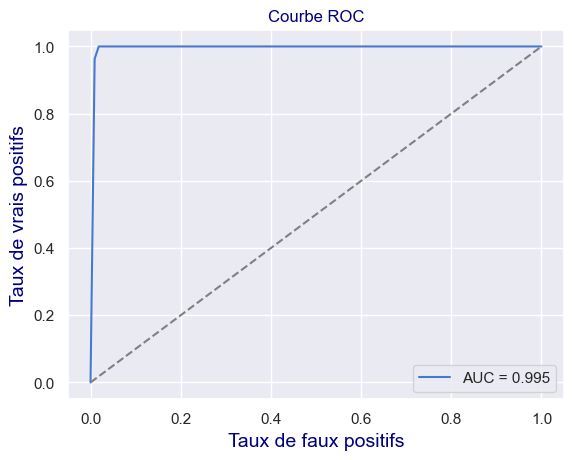

In [804]:
#La Courbe ROC-AUC

#y_test_proba = model.predict_proba(X_test_scaled)[:,1])

fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test_scaled)[:,1])

plt.plot(fpr, tpr, label=f"AUC = {roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:,1] ):.3f}")
plt.plot([0,1], [0,1], linestyle='--', color='gray')
plt.xlabel("Taux de faux positifs")
plt.ylabel("Taux de vrais positifs")
plt.title("Courbe ROC")
plt.legend()
plt.grid()
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.2.7 - Rapport de classification : </h4>
</div>

In [805]:
from sklearn.metrics import classification_report

In [806]:
print(classification_report(y_test, y_test_pred, digits=3))

              precision    recall  f1-score   support

           0      1.000     0.955     0.977       110
           1      0.974     1.000     0.987       190

    accuracy                          0.983       300
   macro avg      0.987     0.977     0.982       300
weighted avg      0.984     0.983     0.983       300



<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.2.8 - Analyse des coefficients (importance des variables : </h4>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.2.9 -Affichage de performance Synthèse</h4>
</div>

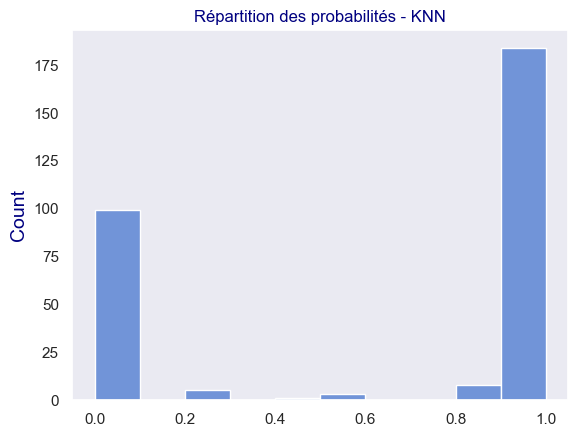

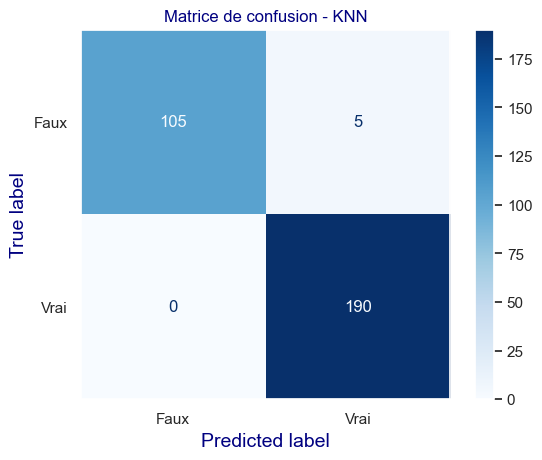

Accuracy : 0.9833333333333333
Recall : 1.0
Precision : 0.9743589743589743
ROC-AUC : 0.9951196172248804


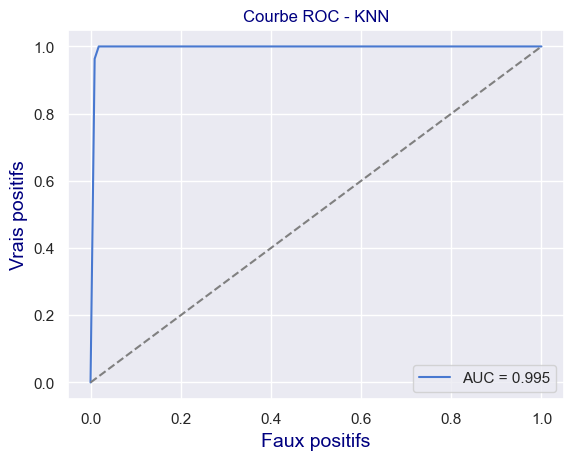

              precision    recall  f1-score   support

           0      1.000     0.955     0.977       110
           1      0.974     1.000     0.987       190

    accuracy                          0.983       300
   macro avg      0.987     0.977     0.982       300
weighted avg      0.984     0.983     0.983       300



In [807]:
# Répartition des probabilités
sns.histplot(y_test_proba)
plt.title("Répartition des probabilités - KNN")
plt.show()

# Matrice de confusion
ConfusionMatrixDisplay.from_predictions(
    y_test, y_test_pred, display_labels=['Faux', 'Vrai'], cmap='Blues'
)
plt.title("Matrice de confusion - KNN")
plt.show()

# Scores
from sklearn.metrics import accuracy_score, recall_score, precision_score, roc_auc_score, roc_curve

print("Accuracy :", accuracy_score(y_test, y_test_pred))
print("Recall :", recall_score(y_test, y_test_pred))
print("Precision :", precision_score(y_test, y_test_pred))
print("ROC-AUC :", roc_auc_score(y_test, y_test_proba))

# ROC Curve
fpr, tpr, thresholds = roc_curve(y_test, y_test_proba)
plt.plot(fpr, tpr, label=f"AUC = {roc_auc_score(y_test, y_test_proba):.3f}")
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel("Faux positifs")
plt.ylabel("Vrais positifs")
plt.title("Courbe ROC - KNN")
plt.grid()
plt.legend()
plt.show()

# Rapport de classification
print(classification_report(y_test, y_test_pred, digits=3))


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">9.3 - VERIFICATION DE PERFORMANCE ET AMELIORATION DU KNN  </h3>
</div>

J'ai déjà fait un KNN qui donne de bon résultats (avec plusieurs random_state).  
Regardons si elle est stable et si elle peut être améliorer ?

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.3.1 -  : VALIDATION CROISEE 1:Robustesse au jeu de données</h4>
</div>

**Validation croisée**

Objectif : s’assurer que la performance n’est pas liée à un seul split train/test

In [808]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_val_score, cross_validate

model = KNeighborsClassifier(n_neighbors=5)

# Validation croisée multi-métriques
scoring = {
    'accuracy': 'accuracy',
    'precision': 'precision',
    'recall': 'recall',
    'roc_auc': 'roc_auc',
}

results = cross_validate(model, X_train_scaled, y_train, cv=5, scoring=scoring)

for metric in scoring.keys():
    scores = results[f'test_{metric}']
    print(f"{metric.capitalize()} : Moyenne = {scores.mean():.3f} | Écart-type = {scores.std():.3f}")

Accuracy : Moyenne = 0.990 | Écart-type = 0.005
Precision : Moyenne = 0.989 | Écart-type = 0.005
Recall : Moyenne = 0.996 | Écart-type = 0.003
Roc_auc : Moyenne = 0.991 | Écart-type = 0.003


Les scores sont très bons et stables, ils dépendent peu du choix de jeu test.

Ecart-type faible (< 0.01) => modèle stable peu importe le jeu de test choisi.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.3.2 -  : VALIDATION CROISEE 2 :Validation croisée selon plusieurs random_state (simulé)</h4>
</div>

**Validation croisée 2**

Validation croisée selon plusieurs random_state (simulé)

Remarque :  
(Le KNN n’a pas de random_state, mais on peut simuler la robustesse avec des split différents)  

"Cette validation croisée simule différents aléas dans les découpages de jeux de données (via StratifiedKFold), pour tester la stabilité du modèle KNN face à la variabilité des folds."

In [809]:
from sklearn.model_selection import StratifiedKFold
import numpy as np

random_states = range(0, 100, 10)
all_results = {metric: [] for metric in scoring.keys()}

for rs in random_states:
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=rs)
    model = KNeighborsClassifier()
    results = cross_validate(model, X_train_scaled, y_train, cv=cv, scoring=scoring)
    
    for metric in scoring:
        all_results[metric].append(results[f'test_{metric}'].mean())

# Résumé
print("📊 Résumé des performances selon différents random_state :")
for metric, values in all_results.items():
    print(f"{metric.capitalize()} : Moyenne = {np.mean(values):.3f} | Écart-type = {np.std(values):.3f}")


📊 Résumé des performances selon différents random_state :
Accuracy : Moyenne = 0.991 | Écart-type = 0.001
Precision : Moyenne = 0.990 | Écart-type = 0.001
Recall : Moyenne = 0.997 | Écart-type = 0.000
Roc_auc : Moyenne = 0.992 | Écart-type = 0.001


**Ecart-type faible (< 0.01) => modèle stable peu importe le random_state choisi.**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.3.3 -  Sélection de variable : PAS DE SELECTION de VARIABLE Pour comparaison </h4>
</div>

**Sélection de variables**  
Objectif : tester si certaines variables sont peu utiles, voire nuisibles


Ayant peu de variables et peu de données,
n'ayant pas retiré de variable pour la Regression Logistique,   
pour pouvoir comparer je vais garder l'ensemble des variables.  
D'autant plus que cela avait fait baisser les scores de l aRegression logistique, et que le RandomForest fait lui-même des actions via n_features.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.3.4 GridSearchCV : Recherche des meilleurs paramètres de KNN </h4>
</div>

**GridSearchCV**  
Objectif : rechercher la meilleure paramétrisation

**RESUME :**    
`n_neighbors` : nombre de voisins à prendre en compte pour la prédiction.  

`weights` : pondération appliquée aux voisins (uniforme ou en fonction de la distance).  

`p` : type de distance utilisée (p=1 → Manhattan, p=2 → Euclidienne).  

`metric` : méthode de calcul de la distance entre les points (minkowski permet de généraliser p=1 ou p=2).  

In [810]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'n_neighbors': [3, 5, 7, 9, 11],
    'weights': ['uniform', 'distance'],
    'p': [1, 2],  # 1 = Manhattan, 2 = Euclidean
    'metric': ['minkowski']
}

model = KNeighborsClassifier()
grid = GridSearchCV(model, param_grid, cv=5, scoring='roc_auc')
grid.fit(X_train_scaled, y_train)

print("🔧 Meilleurs paramètres :", grid.best_params_)
print(f"✅ Meilleure AUC moyenne : {grid.best_score_:.3f}")


🔧 Meilleurs paramètres : {'metric': 'minkowski', 'n_neighbors': 9, 'p': 1, 'weights': 'uniform'}
✅ Meilleure AUC moyenne : 0.997


**OBSERVATION :**  
**RESULTATS :**    
 Meilleurs paramètres :   
 {'metric': 'minkowski',   
 'n_neighbors': 9,   
 'p': 1, # 1 = Manhattan,  
 'weights': 'uniform'}  
 
Meilleure AUC moyenne : 0.997  

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.3.5 Importance des variables (équivalent des coefficients)</h4>
</div>

**Analyse des coefficients**  
PAS DE COEFF pour KNN

**Évaluation classique :**

In [811]:
from sklearn.metrics import classification_report, confusion_matrix

model_best = grid.best_estimator_
y_test_pred = model_best.predict(X_test_scaled)

print("📌 Matrice de confusion :\n", confusion_matrix(y_test, y_test_pred))
print("📊 Classification Report :\n", classification_report(y_test, y_test_pred))


📌 Matrice de confusion :
 [[106   4]
 [  0 190]]
📊 Classification Report :
               precision    recall  f1-score   support

           0       1.00      0.96      0.98       110
           1       0.98      1.00      0.99       190

    accuracy                           0.99       300
   macro avg       0.99      0.98      0.99       300
weighted avg       0.99      0.99      0.99       300



<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.3.6 -Ajustement du seuil de proba </h4>
</div>

**Ajustement du seuil**  
Objectif : trouver un meilleur compromis entre TPR et FPR

In [812]:
import numpy as np
from sklearn.metrics import confusion_matrix

y_prob = model_best.predict_proba(X_test_scaled)[:, 1]
seuils = [0.3, 0.4, 0.5, 0.6, 0.7]

for seuil in seuils:
    y_pred = (y_prob >= seuil).astype(int)
    tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()
    TPR = tp / (tp + fn)
    FPR = fp / (fp + tn)
    print(f"Seuil {seuil:.2f} → TPR : {TPR:.2f} | FPR : {FPR:.2f}")


Seuil 0.30 → TPR : 1.00 | FPR : 0.05
Seuil 0.40 → TPR : 1.00 | FPR : 0.05
Seuil 0.50 → TPR : 1.00 | FPR : 0.04
Seuil 0.60 → TPR : 1.00 | FPR : 0.02
Seuil 0.70 → TPR : 0.99 | FPR : 0.02


Pour des raisons pratiques je vais rester sur le seuil de 0.5 .  
Mais il semble que passer au seuil de 0.6 pourrait améliorer

**Visualisation TPR / FPR selon seuil**

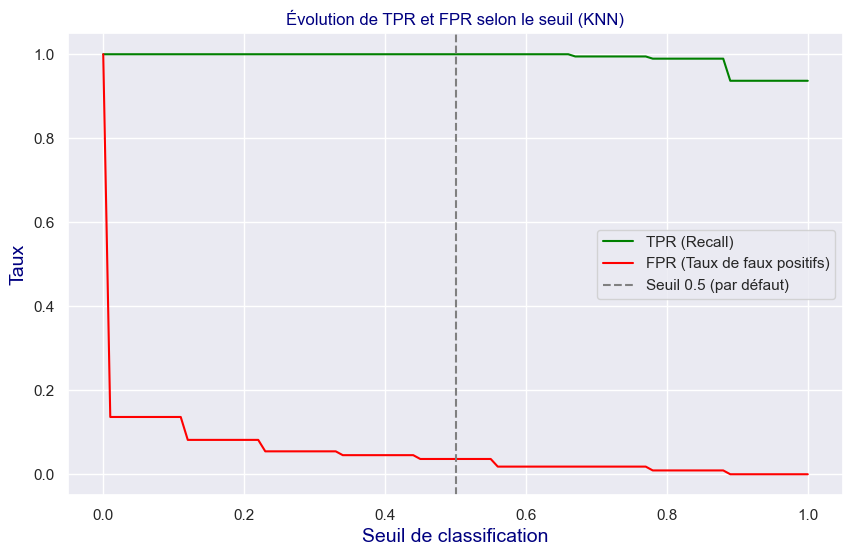

In [813]:
import matplotlib.pyplot as plt

seuils = np.arange(0, 1.01, 0.01)
tpr_list = []
fpr_list = []

for seuil in seuils:
    y_pred_seuil = (y_prob >= seuil).astype(int)
    tn, fp, fn, tp = confusion_matrix(y_test, y_pred_seuil).ravel()

    tpr = tp / (tp + fn) if (tp + fn) != 0 else 0
    fpr = fp / (fp + tn) if (fp + tn) != 0 else 0

    tpr_list.append(tpr)
    fpr_list.append(fpr)

plt.figure(figsize=(10, 6))
plt.plot(seuils, tpr_list, label='TPR (Recall)', color='green')
plt.plot(seuils, fpr_list, label='FPR (Taux de faux positifs)', color='red')
plt.axvline(0.5, linestyle='--', color='gray', label='Seuil 0.5 (par défaut)')

plt.xlabel("Seuil de classification")
plt.ylabel("Taux")
plt.title("Évolution de TPR et FPR selon le seuil (KNN)")
plt.legend()
plt.grid(True)
plt.show()


**Visualisation : courbe ROC**  
Objectif : visualiser tous les seuils possibles + AUC

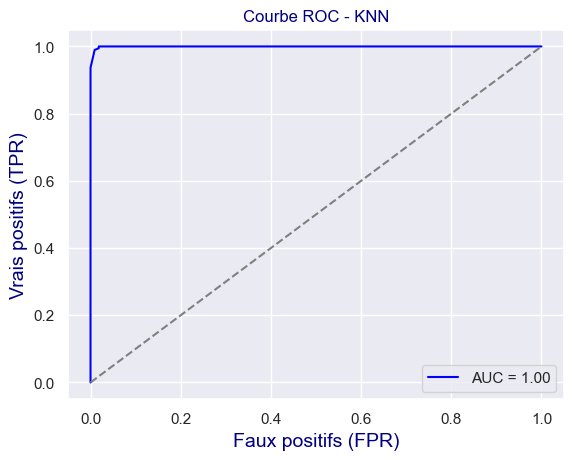

In [814]:
from sklearn.metrics import roc_curve, auc

fpr, tpr, thresholds = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, label=f"AUC = {roc_auc:.2f}", color='blue')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel("Faux positifs (FPR)")
plt.ylabel("Vrais positifs (TPR)")
plt.title("Courbe ROC - KNN")
plt.legend()
plt.grid()
plt.show()


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">9.4 -  SYNTHESE DES MEILLEURS PARAMETRES : KNN </h3>
</div>

**Rappel :**   
Standardisation	Oui, avec StandardScaler() après découpage Train/Test
Modèle	KNeighborsClassifier

**Variables sélectionnées :**  
PAS DE SELECTION : 
['diagonal', 'height_left', 'height_right', 'margin_low', 'margin_up',
       'length']

**Paramètres optimaux :**   
{'metric': 'minkowski',   
'n_neighbors': 9,   
'p': 1,   
'weights': 'uniform'} 

**Seuil de décision**  
0.5 (valide car bon compromis entre TPR & FPR)

In [815]:
df_billets_analyse_1_2_copy[var_quant].columns

Index(['diagonal', 'height_left', 'height_right', 'margin_low', 'margin_up',
       'length'],
      dtype='object')

**MODELE DE RANDOM FOREST FINAL :**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.4.1 -  Préparation des données identiques: </h4>
</div>

In [816]:
# Variables prédictives et cible (identiques à la RF)
var_pred_KNN_final = ['diagonal',
                      'height_left', 'height_right',
                      'margin_low', 'margin_up',
                      'length']
var_cible = 'is_genuine'

# Jeu de données
X = df_billets_analyse_1_2_copy[var_pred_KNN_final].copy(deep=True)
y = df_billets_analyse_1_2_copy[var_cible].astype(int)

# Split train/test
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.20, random_state=42
)

# Standardisation
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.4.2 – Initialisation du modèle KNN final avec les meilleurs hyperparamètres : clf_KNN_final  </h4>
</div>

In [817]:
from sklearn.neighbors import KNeighborsClassifier

clf_KNN_final = KNeighborsClassifier(
    n_neighbors=9,
    weights='uniform',
    metric='minkowski',
    p=1
)

clf_KNN_final.fit(X_train_scaled, y_train)
model = clf_KNN_final

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.4.3 -  Prédictions et Probabilités </h4>
</div>

In [818]:
# Prédiction
y_test_pred = model.predict(X_test_scaled)

# Probabilités pour la classe 1 (vrai billet)
y_test_proba = model.predict_proba(X_test_scaled)[:, 1]

Un bon moyen d'analyser les performances d'un modèle de classification est de tracer l'histogramme des probabilités des prédictions.

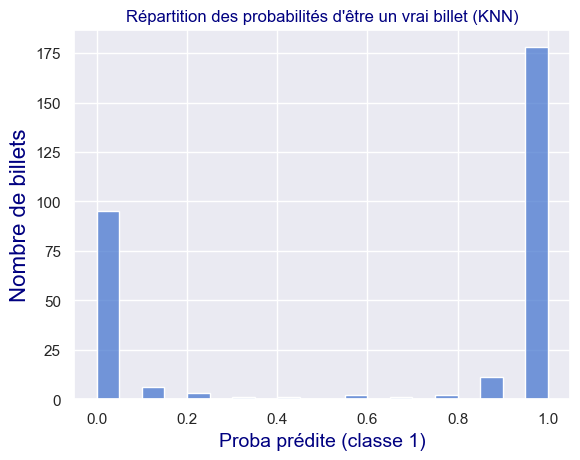

In [819]:
#Répartitions des probas de valoir 1 sur le jeu de test

sns.histplot(y_test_proba, bins=20, kde=False)
plt.title("Répartition des probabilités d'être un vrai billet (KNN)")#=avoir 1
plt.xlabel("Proba prédite (classe 1)")
plt.ylabel("Nombre de billets",size=16)
plt.grid(True)
plt.show()

Le modèle est assez confiant de ses prédiction sur le jeu de test :  
la plupart des prédictions ont une probabilité proche de 0 ou de 1

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.4.4 - Score de performance : Exactitude(accuracy) </h4>
</div>

In [820]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_auc_score, roc_curve

Le plus simple pour mesurer la performance d'une classification est de regarder  
L'**exactitude(accuracy)**, c'est la proportion d'échantillons bien classé :  
exactitude = (échantillons bien classés)/échantillons au total

In [821]:
from sklearn.metrics import accuracy_score

In [822]:
print("Score d'Exactitude-accuracy sur le jeu test = ",accuracy_score(y_test, y_test_pred))

Score d'Exactitude-accuracy sur le jeu test =  0.9866666666666667


**OBSERVATION :**  
98,7% d'échantilons bien classés sur le jeu test, très bonne performance

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.4.5 - Matrice de confusion </h4>
</div>

In [823]:
from sklearn.metrics import confusion_matrix

Attention la matrice de confusion pour scikit-learn est :  
TN | FP  
FN | TP  

In [824]:
confusion_matrix(y_test, y_test_pred)

array([[106,   4],
       [  0, 190]], dtype=int64)

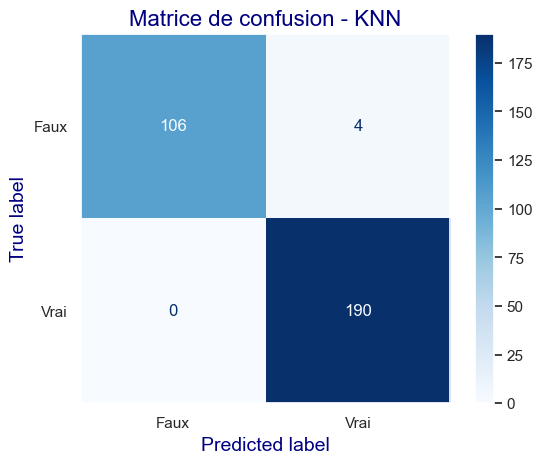

In [825]:
ConfusionMatrixDisplay.from_predictions(
    y_test, y_test_pred, display_labels=['Faux', 'Vrai'], cmap='Blues'
)
plt.title("Matrice de confusion - KNN",size=16)
plt.show()

In [826]:
# Matrice de confusion
tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred).ravel()

# Calculs
TPR = tp / (tp + fn) if (tp + fn) != 0 else 0
FPR = fp / (fp + tn) if (fp + tn) != 0 else 0

# Affichage
print(f"TPR (Recall / Sensibilité) : {TPR:.3f}")
print(f"FPR (Taux de faux positifs) : {FPR:.3f}")

TPR (Recall / Sensibilité) : 1.000
FPR (Taux de faux positifs) : 0.036


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.4.6 -  Autres metriques de classification : </h4>
</div>

Precision, Recall et ROC_AUC

In [827]:
from sklearn.metrics import precision_score, recall_score, roc_auc_score

<u>**Le Rappel-recall ou TPR(True Positive Rate):**</u>  
Rappel = TP/(TP+FN)  
= Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  
Compris entre 0 et 1.  
Plus il augmente plus cela minimise les Faux négatifs.  
(plus FN augmente, plus Rappel baisse)  
Plus on diminue le seuil de détection des positifs, plus on diminuera FN, plus on augmentera le Rappel.  

<u>**La Précision :**</u>  
Précision = TP/(TP+FP)  
= Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
Compris entre 0 et 1.  
plus il augmente, plus cela minimise lse Faux positifs.  
(plus FP augmente, plus la précision baisse)  
Plus on augmente le seuil de détection des positifs,  
plus on diminuera les FP,  plus on augmentera La Précision.  



**TPR(True Positive Rate)=Recall**  
TPR= TP / (TP + FN) (Taux de Positifs détectés parmi les positifs réels)
Plus TPR est haut, mieux c'est.  

**FPR(False Positive Rate)**  
FPR=  FP / (FP+TN)   (Taux de Faux positifs parmis les négatifs réels)
Plus FPR, est bas, mieux c'est.  

**Courbe ROC (Receiver Operating Characteristic) ou encore fonction d’efficacité du récepteur**  
TPR en fonction de FPR

<u>**ROC_AUC : Area under the ROC ou surface sous la courbe ROC**</u>  
Compris entre 0 et 1.  

Plus elle est proche de 1 mieux c'est :   
- Cela signifie que l'on peut trouver un TPR élevé pour un FPR bas.

Pour une courbe plus basse (0.5 ou au dessous) :
- avoir un TPR élevé se fait au prix d’un FPR élevé   ; 
-avoir une FPR bas se fait au prix d’un TPR bas.


In [828]:
print("Recall : ",recall_score(y_test, y_test_pred))
print("Precision : ",precision_score(y_test, y_test_pred))
print("ROC-AUC : ", roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:, 1]))

Recall :  1.0
Precision :  0.979381443298969
ROC-AUC :  0.9995933014354067


**OBSERVATION :**  
- Très bon Recall (proche de 1)  
(TPR)(Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  )   
- Très bonne Précision (proche de 1)  
Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
- Très bon ROC (proche de 1)  
on peut trouver un TPR((True Positive Rate) élevé pour un FPR(False Positive Rate) bas.

**Courbe ROC :**

In [829]:
from sklearn.metrics import roc_curve

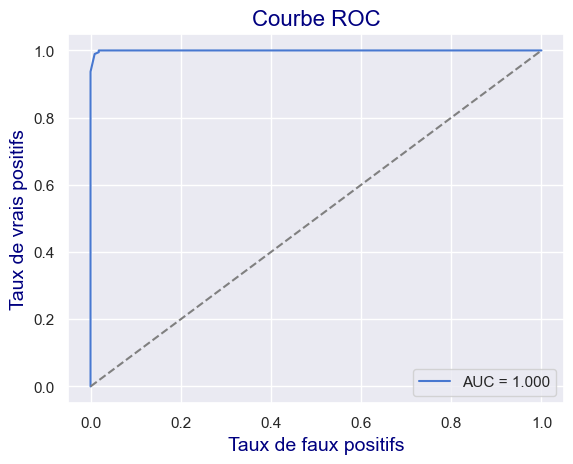

In [830]:
#La Courbe ROC-AUC

#y_test_proba = model.predict_proba(X_test_scaled)[:,1])

fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test_scaled)[:,1])

plt.plot(fpr, tpr, label=f"AUC = {roc_auc_score(y_test, model.predict_proba(X_test_scaled)[:,1] ):.3f}")
plt.plot([0,1], [0,1], linestyle='--', color='gray')
plt.xlabel("Taux de faux positifs")
plt.ylabel("Taux de vrais positifs")
plt.title("Courbe ROC",size=16)
plt.legend()
plt.grid()
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.4.7 - Rapport de classification : </h4>
</div>

In [831]:
from sklearn.metrics import classification_report

In [832]:
print(classification_report(y_test, y_test_pred, digits=3))

              precision    recall  f1-score   support

           0      1.000     0.964     0.981       110
           1      0.979     1.000     0.990       190

    accuracy                          0.987       300
   macro avg      0.990     0.982     0.986       300
weighted avg      0.987     0.987     0.987       300



<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.4.8 - Analyse des coefficients (importance des variables : </h4>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 9.4.9 -Affichage de performance Synthèse</h4>
</div>

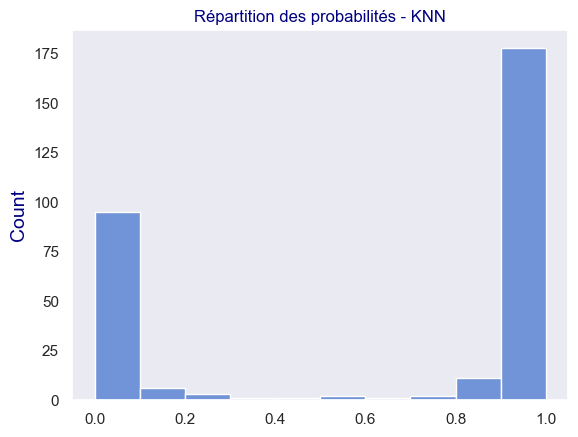

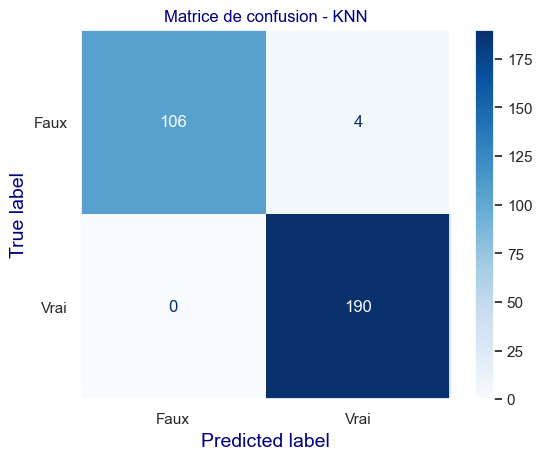

Accuracy : 0.9866666666666667
Recall : 1.0
Precision : 0.979381443298969
ROC-AUC : 0.9995933014354067


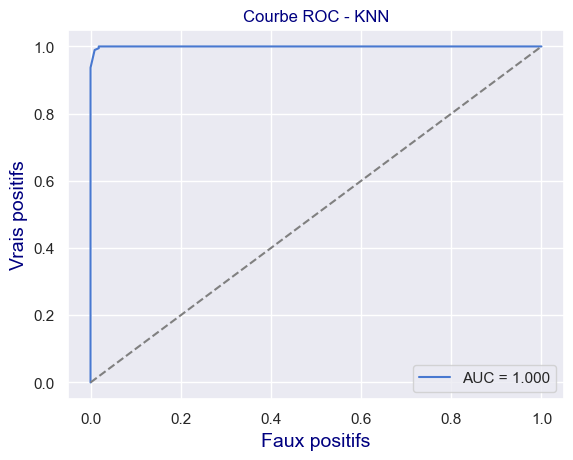

              precision    recall  f1-score   support

           0      1.000     0.964     0.981       110
           1      0.979     1.000     0.990       190

    accuracy                          0.987       300
   macro avg      0.990     0.982     0.986       300
weighted avg      0.987     0.987     0.987       300



In [833]:
# Répartition des probabilités
sns.histplot(y_test_proba)
plt.title("Répartition des probabilités - KNN")
plt.show()

# Matrice de confusion
ConfusionMatrixDisplay.from_predictions(
    y_test, y_test_pred, display_labels=['Faux', 'Vrai'], cmap='Blues'
)
plt.title("Matrice de confusion - KNN")
plt.show()

# Scores
from sklearn.metrics import accuracy_score, recall_score, precision_score, roc_auc_score, roc_curve

print("Accuracy :", accuracy_score(y_test, y_test_pred))
print("Recall :", recall_score(y_test, y_test_pred))
print("Precision :", precision_score(y_test, y_test_pred))
print("ROC-AUC :", roc_auc_score(y_test, y_test_proba))

# ROC Curve
fpr, tpr, thresholds = roc_curve(y_test, y_test_proba)
plt.plot(fpr, tpr, label=f"AUC = {roc_auc_score(y_test, y_test_proba):.3f}")
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel("Faux positifs")
plt.ylabel("Vrais positifs")
plt.title("Courbe ROC - KNN")
plt.grid()
plt.legend()
plt.show()

# Rapport de classification
print(classification_report(y_test, y_test_pred, digits=3))


<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 10 - TEST d'un modèle supervisé sur la base du K-means(non supervisé) !!!</h2>
</div>

Le K-means est un modèle non supervisé qui a pour principe de regrouper des individus (échantillons) avec des caractéristiques similaires.   
Dans l'énoncé il nous est demandé de construire un énoncé sur la base du K-means.  
De ce que je comprends il s'agit de monter un algorithme sur la base du K-means (non supervisé) et qui serait entrainé sur un jue de données test, donc qui deviendrait supervisé !!!   
Et qui permettrait de classifier de nouvelles données par rapport aux centroïdes des données entrainées.
Ce n'est pas vraiment le principe du K-means mais voyons ce que cela peut donner !!!

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">10.1 -  Préparation des données PCA</h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.1.1 - CHOIX DES VARIABLES : toutes les données géométriques </h4>
</div>

In [834]:
#listes des variables prédictives pour le modèle KM_A : toutes les var quantitatives
var_pred_KM_A = ['diagonal', 
                'height_left', 'height_right', 
                'margin_low','margin_up', 
                'length']
#la variable cible :
var_cible = 'is_genuine'

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.1.2 - Split Jeux de données : X_train X_scaled </h4>
</div>

**Les jeux de données :**

In [835]:
#le jeu de données prédictif complet:
X = (df_billets_analyse_1_2_copy[var_pred_KM_A]).copy(deep=True)

#le jeu de données cible réel en convertissant les False en 0 et les True en 1
y = (df_billets_analyse_1_2_copy[var_cible]).copy(deep=True)
y = y.astype(int) #conversion des False / True en 0 /1

In [836]:
names_KM_A = X.index
features_KM_A = X.columns

In [837]:
# split train, test
# proportion du jeu test : 0.2
#random_state : 42 pour pouvoir reproduire (une fois testé avec différent random_state)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

In [838]:
X_train

,diagonal,height_left,height_right,margin_low,margin_up,length
382,172.28,104.62,103.80,4.08,3.08,113.26
538,171.90,104.50,103.49,4.08,2.82,113.50
1493,171.63,104.33,104.61,4.88,3.35,112.16
1112,172.06,104.28,104.31,5.61,3.27,111.61
324,172.10,104.42,103.60,4.18,2.89,113.32
...,...,...,...,...,...,...
1130,171.56,104.29,104.19,5.23,3.63,112.94
1294,172.40,104.27,104.18,4.92,3.17,111.79
860,171.38,103.83,103.99,4.44,3.12,113.48
1459,171.78,104.31,103.82,6.19,3.25,111.14


In [839]:
names_KM_A_train = X_train.index
names_KM_A_test = X_test.index

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.1.3 - Standardisation des données : StandardScaler </h4>
</div>

**Standardisation des données : StandardScaler**

In [840]:
scaler_KM_A = StandardScaler()

X_train_scaled = scaler_KM_A.fit_transform(X_train)
X_test_scaled = scaler_KM_A.transform(X_test)

In [841]:
X_train_scaled

array([[ 1.05085314,  1.95841641, -0.36771166, -0.59460041, -0.30611809,
         0.64852865],
       [-0.18569989,  1.55986362, -1.31796341, -0.59460041, -1.42816747,
         0.92162529],
       [-1.06430336,  0.99524718,  2.1152042 ,  0.61977482,  0.85908704,
        -0.60316427],
       ...,
       [-1.87782509, -0.6653894 ,  0.2147007 , -0.04813156, -0.13349511,
         0.89886723],
       [-0.57619032,  0.92882172, -0.3064051 ,  2.60831426,  0.42752958,
        -1.76382497],
       [-0.38094511,  0.09850343,  0.5518868 ,  0.60459513,  0.42752958,
        -1.87761524]])

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.1.4 - ACP : Analyse en Composantes Principales </h4>
</div>

Dans un premier temps,  
Nous allons travailler sur 6 composantes principales (pour récupérer toutes les informations des 6 variables initiales) 

In [842]:
#Choix du nombre de composantes principales, sur lesquelles on va projeter :
nb_components_base = 6

On "l'entraine" sur les données scalées : 

In [843]:
#On instancie notre fonction PCA avec le nombre de composantes principales souhaités
pca_KM_A = PCA(n_components=nb_components_base)

In [844]:
#On génère les Axes principaux avec notre jeux de données centré sans réduction: 
#("entrainer" sur les données scalées)
#ATTENTION , on ne le fait qu'avec X_train_scaled , car on doit tester après ce que ça ferait sur un X_test qui arrive après
pca_KM_A.fit(X_train_scaled)

,n_components,6
,copy,True
,whiten,False
,svd_solver,'auto'
,tol,0.0
,iterated_power,'auto'
,n_oversamples,10
,power_iteration_normalizer,'auto'
,random_state,None


**Transformation des données**

In [845]:
X_train_proj = pca_KM_A.transform(X_train_scaled)
X_test_proj = pca_KM_A.transform(X_test_scaled)

In [846]:
X_train_proj

array([[ 0.36378606,  1.61664123,  1.70034621, -0.49847157,  0.23005979,
         0.06556311],
       [ 1.41497224,  0.2526112 ,  2.12574275, -0.68173073, -0.6306749 ,
         0.00655424],
       [-2.25316428, -0.53247039,  0.69487368,  1.29974178,  0.72678164,
         0.15047331],
       ...,
       [ 0.55252223, -1.88325749,  0.20432231,  0.6585188 ,  0.34894613,
         0.62774901],
       [-2.66857116, -0.60761658,  0.16511121, -1.05846155, -1.6291443 ,
         0.30589019],
       [-1.77192503, -0.4157633 , -0.38188558,  0.00806225, -0.36846497,
        -0.96897445]])

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.1.5 - Explication de la variance et du scree plot : </h4>
</div>

Intéressons nous maintenant à la variance *captée* par chaque nouvelle composante. 

In [847]:
pca_KM_A.explained_variance_ratio_

array([0.42978567, 0.16972423, 0.13194099, 0.1181994 , 0.09904108,
       0.05130863])

In [848]:
range(0,len(pca_KM_A.explained_variance_ratio_))

range(0, 6)

In [849]:
for i in range(0,len(pca_KM_A.explained_variance_ratio_)) :
    print(f" la {i+1}ème composante capte",
          f"{round(100*pca_KM_A.explained_variance_ratio_[i],1)}% de la variance")

 la 1ème composante capte 43.0% de la variance
 la 2ème composante capte 17.0% de la variance
 la 3ème composante capte 13.2% de la variance
 la 4ème composante capte 11.8% de la variance
 la 5ème composante capte 9.9% de la variance
 la 6ème composante capte 5.1% de la variance


<u>**Critère de Kaiser :**</u>  
IL est coutume de s'intéresser aux Composantes principales qui récupère plus de 100%/6 = 16,7% de la variance des données initiales.  
Soit ici les Composantes pricipales F1, et F2.

In [850]:
#Enregistrons cela dans une variable : 
#Array des variances
scree_KM_A = (pca_KM_A.explained_variance_ratio_*100).round(2)
#Array des variances cumulées
scree_KM_A_cum = scree_KM_A.cumsum().round(2)
scree_KM_A_cum

array([42.98, 59.95, 73.14, 84.96, 94.86, 99.99])

In [851]:
#Définisions ensuite une variable avec la liste de nos 6 composantes :
x_list_num_axes_tot = range(1, nb_components_base+1) #[1, 2, 3, 4, 5, 6]

list_Fi_tot = [f"F{i}" for i in x_list_num_axes_tot] #['F1', 'F2', 'F3', 'F4', 'F5', 'F6']
list_Fi_tot

['F1', 'F2', 'F3', 'F4', 'F5', 'F6']

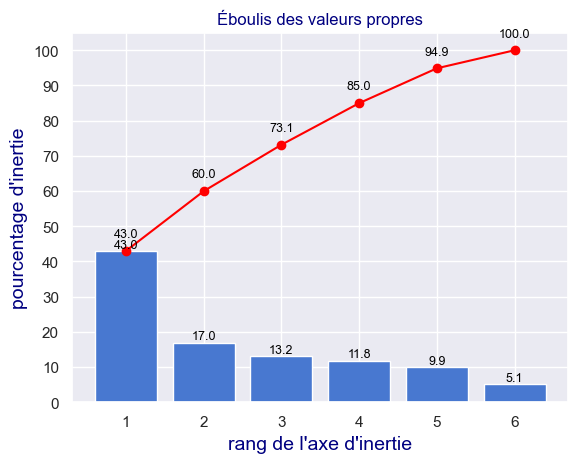

In [852]:
#EBOULIS DES VALEURS PROPRES
#  Affichage des barres
plt.bar(x_list_num_axes_tot, scree_KM_A)

# ➕ Affichage des valeurs sur les barres
for i, val in enumerate(scree_KM_A):
    plt.text(x_list_num_axes_tot[i], val + 0.0, 
             f"{val:.1f}", 
             ha='center', va='bottom', fontsize=9, color='black')

# ➕ Affichage de la courbe
plt.plot(x_list_num_axes_tot, scree_KM_A_cum, c="red", marker='o')

# ➕ Affichage des valeurs sur la courbe
for i, val in enumerate(scree_KM_A_cum):
    plt.text(x_list_num_axes_tot[i], val + 3.0,   # Décalage un peu plus haut que les barres
             f"{val:.1f}", 
             ha='center', va='bottom', fontsize=9, color='black')

# Paramétrage des axes et du titre
plt.xlabel("rang de l'axe d'inertie")
plt.xticks(x_list_num_axes_tot)
plt.yticks(range(0, 105, 10))
plt.ylabel("pourcentage d'inertie")
plt.title("Éboulis des valeurs propres")
plt.grid()
plt.show(block=False)

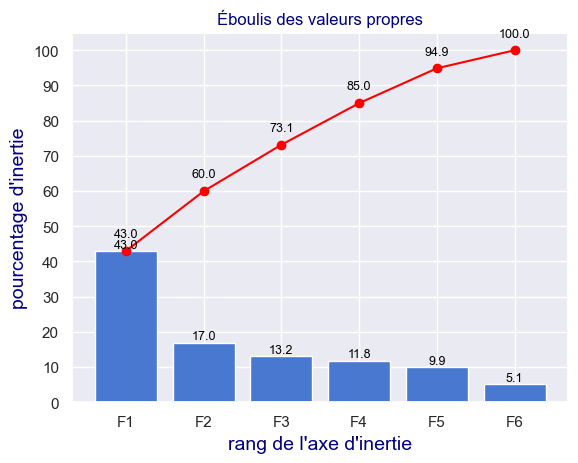

In [853]:
#EBOULIS DES VALEURS PROPRES
#  Affichage des barres
plt.bar(list_Fi_tot, scree_KM_A)

# ➕ Affichage des valeurs sur les barres
for i, val in enumerate(scree_KM_A):
    plt.text(list_Fi_tot[i], val + 0.0, 
             f"{val:.1f}", 
             ha='center', va='bottom', fontsize=9, color='black')

# ➕ Affichage de la courbe
plt.plot(list_Fi_tot, scree_KM_A_cum, c="red", marker='o')

# ➕ Affichage des valeurs sur la courbe
for i, val in enumerate(scree_KM_A_cum):
    plt.text(list_Fi_tot[i], val + 3.0,   # Décalage un peu plus haut que les barres
             f"{val:.1f}", 
             ha='center', va='bottom', fontsize=9, color='black')

# Paramétrage des axes et du titre
plt.xlabel("rang de l'axe d'inertie")
plt.xticks(list_Fi_tot)
plt.yticks(range(0, 105, 10))
plt.ylabel("pourcentage d'inertie")
plt.title("Éboulis des valeurs propres")
plt.grid()
plt.show(block=False)

On a en bleu la variance de chaque nouvelle composante, et en rouge la variance cumulée.  
On voit ici que 73% de la variance est prise dans les 3 premières composantes. (85% dans les 4)

**OBSERVATIONS :**  
Si l'on regroupe les 2 critères variance totale prise, et Critère de Kaiser, prendre les 3 premières composantes semblent permettent d'expliquer 73% de la variance avec des Axes Principaux portant suffisamment de variance eux-même pour être significatifs.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.1.6 Etudes des Composantes principales : </h4>
</div>

Intéressons nous maintenant à nos fameuses composantes. 
Les Composantes principales nous sont donnée par l'attribut `components_`. Cette variable est généralement nommée `pcs` : 

In [854]:
#les vecteurs Axes principaux enf contion des vecteurs originaux
#sur la première ligne on a ce qui compose l'axe F1, en fonction des variables d'origine
#sur la seconde ligne la décomposition de l'axe F2 en fonction des variables d'origine
#PM j'ai l'impression que ça se lit plutôt colonne par colonne
#PM et qu'on a sur la 1ère colonne la décomposition de la variable d'originie sur les axes principaux
#PM et qu'on a sur la 2ème colonne la décomposition de la variable d'originie sur les axes principaux
pcs_KM_A = pca_KM_A.components_
pcs_KM_A

array([[ 0.07569903, -0.32718176, -0.39495813, -0.50396336, -0.43992556,
         0.53265022],
       [ 0.94046828,  0.30004173,  0.12715964, -0.07703649, -0.02191844,
         0.0539422 ],
       [-0.30541821,  0.87584951, -0.02467813, -0.1412724 , -0.28564072,
         0.19351959],
       [-0.08718128, -0.17974481,  0.88245587, -0.09644346, -0.3891215 ,
         0.14368711],
       [-0.09415027,  0.05920172,  0.21783968, -0.58434379,  0.72869325,
         0.26024074],
       [ 0.00662857, -0.0012853 ,  0.03235751,  0.60775769,  0.20490257,
         0.76652001]])

In [855]:
features_KM_A

Index(['diagonal', 'height_left', 'height_right', 'margin_low', 'margin_up',
       'length'],
      dtype='object')

In [856]:
#CALRIFIONS LE RESULTAT/ TRANSFORMONS pcs_base en DF
pcs_KM_A = pd.DataFrame(pcs_KM_A)
pcs_KM_A.columns = features_KM_A
pcs_KM_A.index = list_Fi_tot
pcs_KM_A.round(2)

,diagonal,height_left,height_right,margin_low,margin_up,length
F1,0.08,-0.33,-0.39,-0.50,-0.44,0.53
F2,0.94,0.30,0.13,-0.08,-0.02,0.05
F3,-0.31,0.88,-0.02,-0.14,-0.29,0.19
F4,-0.09,-0.18,0.88,-0.10,-0.39,0.14
F5,-0.09,0.06,0.22,-0.58,0.73,0.26
F6,0.01,-0.00,0.03,0.61,0.20,0.77


-- **ATTENTION** -- : Nous avons arrondi les résultats pour simplifier l'analyse

**<u>INTERPRETATIONS des Composantes:</u>**  

**F1 => Vue global hors diagonal (43% de la variance)**   
`F1` =
0.53 * length    
-0,50 * margin_low    
-0.44 * margin_up  
-0.39 * height_right  
-0.33 * height_left

**F2 => diagonal (17% de la variance)**  
`F2` =  
+0,94 * diagonal  
+0,30 * height_left

**F3 => height_left  (13% de la variance)**    
`F3` =  
0.88 *height_left  

**F4 => height_right - margin_up(12% de la variance)**    
`F4` =  
...  

**F5 => margin_up et low(10% de la variance)**  
`F5` =  
...  

**F6 => length(5% de la variance)**  
`F6` =  
...  


L'axe le plus pertinents semblent être F1.

pour une représentation plus *visuelle*

(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5]),
 [Text(0, 0.5, 'F1'),
  Text(0, 1.5, 'F2'),
  Text(0, 2.5, 'F3'),
  Text(0, 3.5, 'F4'),
  Text(0, 4.5, 'F5'),
  Text(0, 5.5, 'F6')])

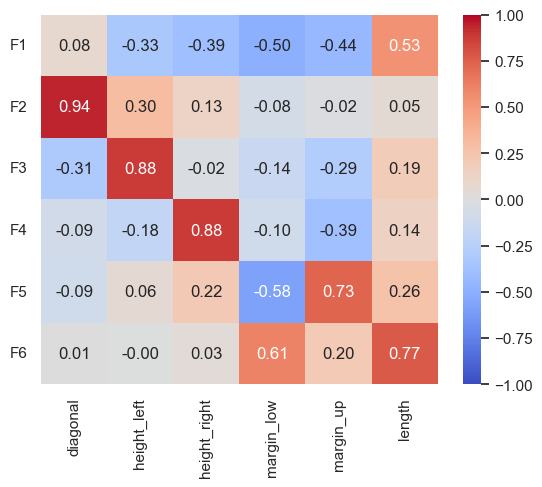

In [857]:
#fig, ax = plt.subplots(figsize=(20, 6))
sns.heatmap(pcs_KM_A, vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f")
plt.yticks(rotation=0)

In [858]:
#Autre visualisation :
pcs_KM_A.T

,F1,F2,F3,F4,F5,F6
diagonal,0.075699,0.940468,-0.305418,-0.087181,-0.094150,0.006629
height_left,-0.327182,0.300042,0.875850,-0.179745,0.059202,-0.001285
height_right,-0.394958,0.127160,-0.024678,0.882456,0.217840,0.032358
margin_low,-0.503963,-0.077036,-0.141272,-0.096443,-0.584344,0.607758
margin_up,-0.439926,-0.021918,-0.285641,-0.389122,0.728693,0.204903
length,0.532650,0.053942,0.193520,0.143687,0.260241,0.766520


Text(0.5, 1.0, "Composition des Axes Principaux de l'ACP")

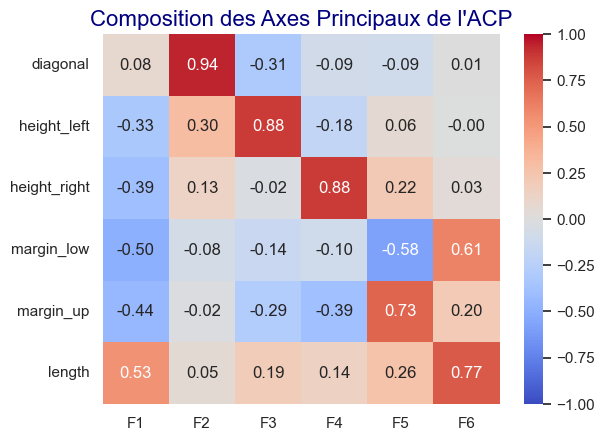

In [859]:
#fig, ax = plt.subplots(figsize=(20, 6))
sns.heatmap(pcs_KM_A.T, vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f")
plt.title("Composition des Axes Principaux de l'ACP",size=16)

##### **Pour Rappel : Corrélation des variables d'origines entre elles :**

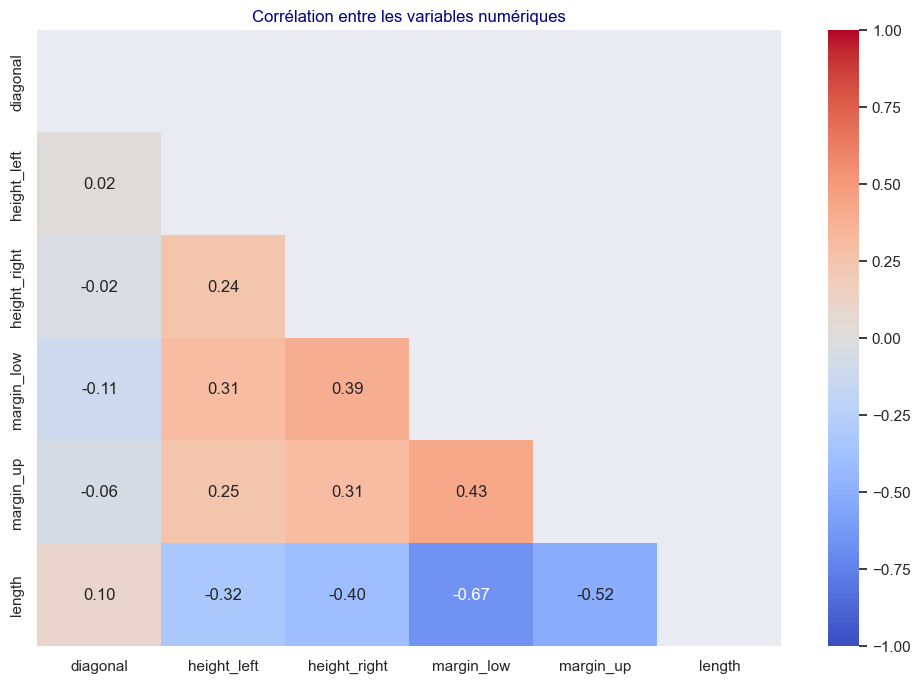

In [860]:
# Visualisation de la Matrice de corrélation

#mask_triangulaire
mask_semi_heatmap = np.triu(np.ones( (df_billets_analyse_1_2[quant_vars].corr(method='pearson')).shape  ))

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(12, 8))
sns.heatmap(df_billets_analyse_1_2[quant_vars].corr(), 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f",
            mask = mask_semi_heatmap
           )
plt.title("Corrélation entre les variables numériques")
plt.grid(visible=False)
plt.show()

##### **Pour Rappel : Corrélation des variables d'origines entre elles pour X_train:**

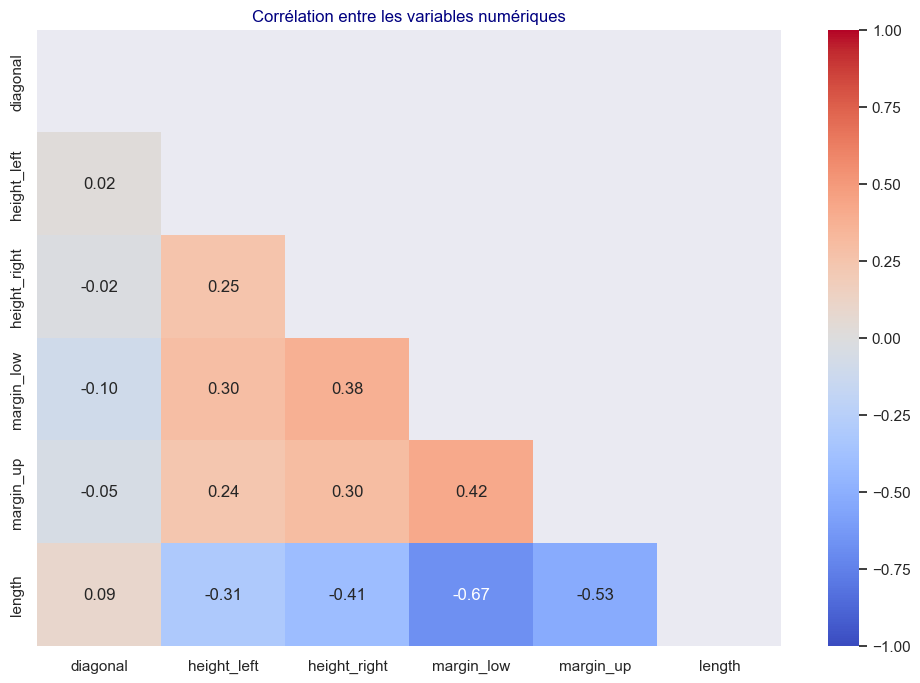

In [861]:
# Visualisation de la Matrice de corrélation
df=X_train

#mask_triangulaire
mask_semi_heatmap = np.triu(np.ones( (df.corr(method='pearson')).shape  ))

# Visualisation de la Matrice de corrélation
plt.figure(figsize=(12, 8))
sns.heatmap(df.corr(), 
            annot=True, 
            cmap='coolwarm',
            vmin=-1,
            vmax=1,
            center=0.0,
            fmt=".2f",
            mask = mask_semi_heatmap
           )
plt.title("Corrélation entre les variables numériques")
plt.grid(visible=False)
plt.show()

Pas de trop grosse corrélation

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.1.7 -Cercles de corrélations  </h4>
</div>

In [862]:
#pour F1 et F2
x,y=0,1

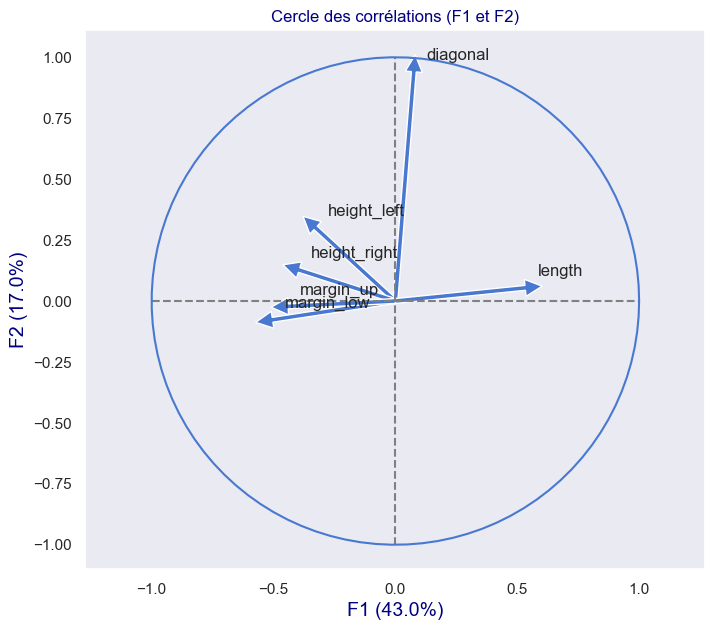

In [863]:
#pour F1 et F2
correlation_graph(pca_KM_A, (0,1) , features=features_KM_A)

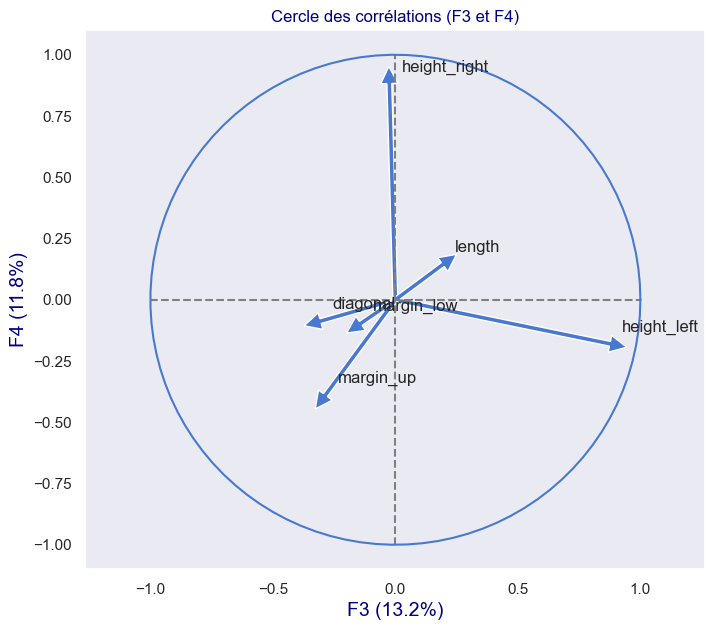

In [864]:
#pour F3 et F4
correlation_graph(pca_KM_A, (2,3) , features=features_KM_A)

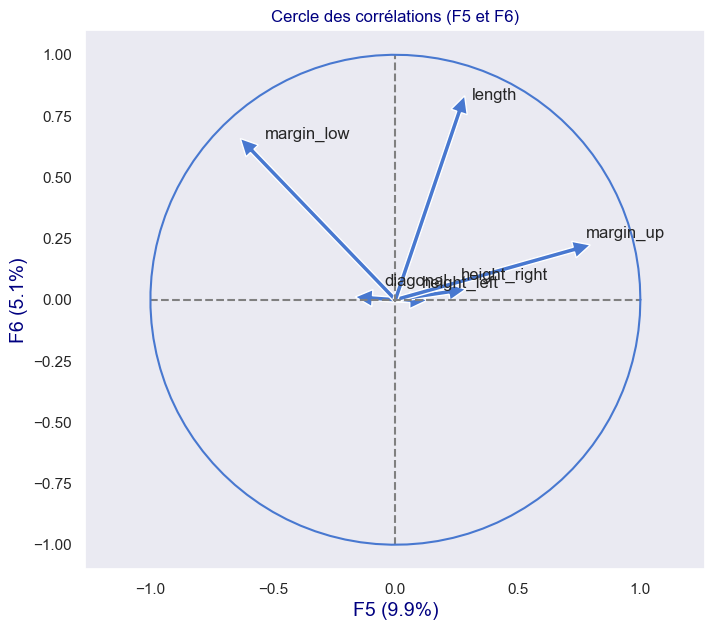

In [865]:
#pour F5 et F6
correlation_graph(pca_KM_A, (4,5) , features=features_KM_A)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.1.8 - Projections  </h4>
</div>

In [866]:
X_train

,diagonal,height_left,height_right,margin_low,margin_up,length
382,172.28,104.62,103.80,4.08,3.08,113.26
538,171.90,104.50,103.49,4.08,2.82,113.50
1493,171.63,104.33,104.61,4.88,3.35,112.16
1112,172.06,104.28,104.31,5.61,3.27,111.61
324,172.10,104.42,103.60,4.18,2.89,113.32
...,...,...,...,...,...,...
1130,171.56,104.29,104.19,5.23,3.63,112.94
1294,172.40,104.27,104.18,4.92,3.17,111.79
860,171.38,103.83,103.99,4.44,3.12,113.48
1459,171.78,104.31,103.82,6.19,3.25,111.14


In [867]:
#Visualisation de X_train_scaled les données centrées réduites
df_X_train_scaled = pd.DataFrame(X_train_scaled) #les données centrées réduites
df_X_train_scaled.columns = features_KM_A
df_X_train_scaled.index = names_KM_A_train
df_X_train_scaled.head() #les données centrées réduites

,diagonal,height_left,height_right,margin_low,margin_up,length
382,1.050853,1.958416,-0.367712,-0.594600,-0.306118,0.648529
538,-0.185700,1.559864,-1.317963,-0.594600,-1.428167,0.921625
1493,-1.064303,0.995247,2.115204,0.619775,0.859087,-0.603164
1112,0.334954,0.829184,1.195606,1.727892,0.513841,-1.229011
324,0.465117,1.294162,-0.980777,-0.442804,-1.126077,0.716803


In [868]:
X_train_scaled.shape

(1200, 6)

In [869]:
#Visualisation de X_test_scaled les données centrées réduites
df_X_test_scaled = pd.DataFrame(X_test_scaled) #les données centrées réduites
df_X_test_scaled.columns = features_KM_A
df_X_test_scaled.index = names_KM_A_test
df_X_test_scaled.head() #les données centrées réduites

,diagonal,height_left,height_right,margin_low,margin_up,length
1116,0.985771,-0.432900,0.613193,0.786751,1.161177,-1.615898
1368,-0.999222,0.962034,1.410179,1.788611,0.384374,-0.443858
422,-1.389712,-1.661771,-0.888817,-0.655319,-0.823987,0.079577
413,1.115935,-1.230006,-1.287310,-0.587464,0.039128,0.295779
451,0.692904,-0.798240,-1.164697,-0.609780,-1.600790,0.386811


In [870]:
#Visualisation dans un DF de X_train_proj les données centrées réduites projetées sur nos axes principaux
df_X_train_proj = pd.DataFrame(X_train_proj) #les données centrées réduites projetées sur nos axes principaux
df_X_train_proj.columns = list_Fi_tot
df_X_train_proj.index = names_KM_A_train
df_X_train_proj.head() #les données centrées réduites projetées

,F1,F2,F3,F4,F5,F6
382,0.363786,1.616641,1.700346,-0.498472,0.230060,0.065563
538,1.414972,0.252611,2.125743,-0.681731,-0.630675,0.006554
1493,-2.253164,-0.532470,0.694874,1.299742,0.726782,0.150473
1112,-2.469631,0.505167,-0.034281,0.333643,-0.677086,0.253207
324,1.099501,0.798475,1.538564,-0.554779,-0.556101,0.019275


In [871]:
df_X_train_scaled.describe().round(2)

,diagonal,height_left,height_right,margin_low,margin_up,length
count,1200.00,1200.00,1200.00,1200.00,1200.00,1200.00
mean,0.00,-0.00,0.00,0.00,0.00,-0.00
std,1.00,1.00,1.00,1.00,1.00,1.00
min,-2.98,-2.96,-3.37,-2.26,-3.80,-3.64
25%,-0.67,-0.70,-0.65,-0.70,-0.69,-0.72
50%,0.01,0.03,0.00,-0.28,-0.09,0.33
75%,0.69,0.66,0.71,0.56,0.69,0.75
max,3.43,2.82,3.16,3.69,3.28,1.85


In [872]:
df_X_train_proj.describe().round(2)

,F1,F2,F3,F4,F5,F6
count,1200.00,1200.00,1200.00,1200.00,1200.00,1200.00
mean,-0.00,-0.00,0.00,0.00,0.00,-0.00
std,1.61,1.01,0.89,0.84,0.77,0.56
min,-4.16,-3.10,-2.54,-2.96,-3.23,-1.70
25%,-1.52,-0.69,-0.63,-0.57,-0.51,-0.34
50%,0.56,0.01,-0.02,0.01,0.03,0.01
75%,1.23,0.69,0.55,0.52,0.50,0.35
max,3.12,3.77,2.92,3.20,3.13,2.21


In [873]:
#Visualisation de X_test_scaled les données centrées réduites
df_X_test_proj = pd.DataFrame(X_test_proj) #les données centrées réduites
df_X_test_proj.columns = list_Fi_tot
df_X_test_proj.index = names_KM_A_test
df_X_test_proj.head() #les données centrées réduites

,F1,F2,F3,F4,F5,F6
1116,-1.793960,0.701947,-1.450894,-0.226913,-0.018975,-0.495603
1368,-2.254273,-0.641924,0.664608,0.772769,-0.422359,0.863345
422,1.524684,-1.845766,-0.665741,0.030776,-0.357951,-0.541951
413,1.431738,0.577108,-1.257303,-0.928265,-0.009544,-0.154974
451,1.991199,0.366974,-0.263770,-0.207431,-1.075711,-0.434174


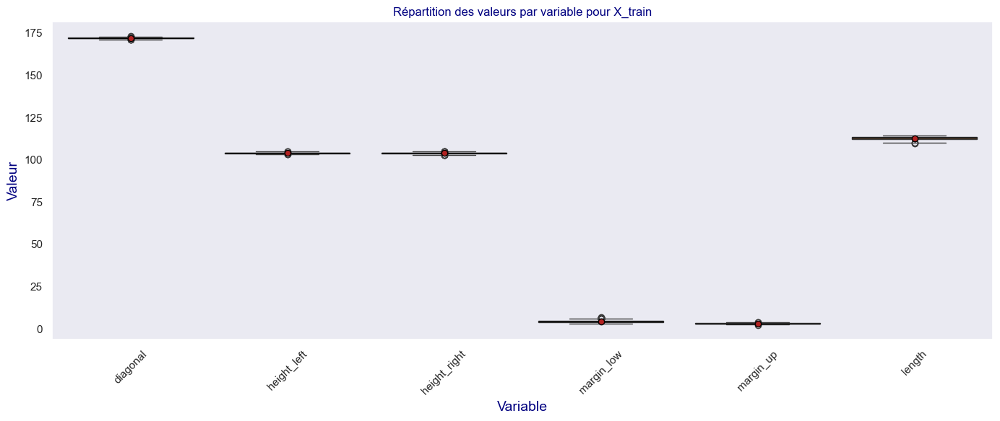

In [874]:
#boxplot de X_train
#import pandas as pd
#import seaborn as sns
#import matplotlib.pyplot as plt

# Reconstruction de X_train en DataFrame à partir des valeurs, index et colonnes
df_temp = pd.DataFrame(X_train, index=names_KM_A_train, columns=features_KM_A)

# Mise en format long pour seaborn
df_melted = df_temp.reset_index().melt(id_vars='index', var_name='Variable', value_name='Valeur')

# Renommer proprement l'ancienne index (souvent iso3)
#df_melted.rename(columns={'index': 'iso3'}, inplace=True)

# Tracer le boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_melted, 
            x='Variable', 
            y='Valeur',
            hue='Variable',
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
            palette = palette_fixe_qvars,
            hue_order = Ordre_qvars
           )

plt.xticks(rotation=45)
plt.title("Répartition des valeurs par variable pour X_train")
plt.tight_layout()
plt.show()

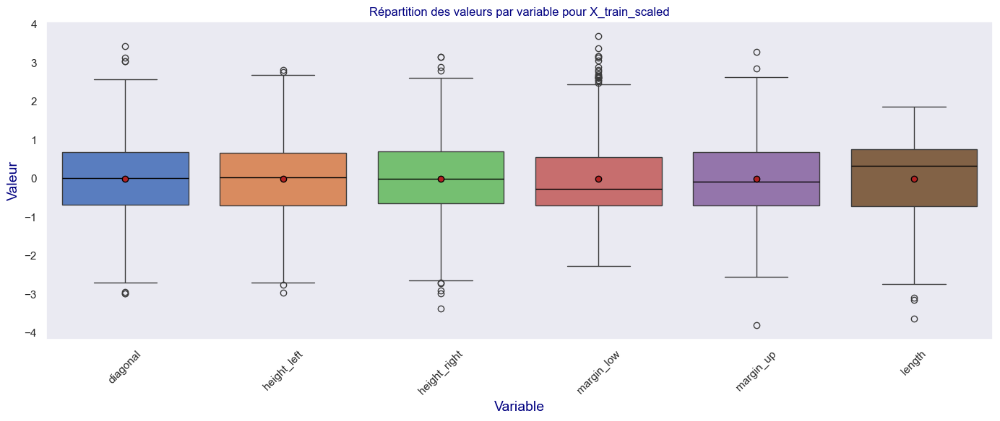

In [875]:
#boxplot de X_train_scaled 
#import pandas as pd
#import seaborn as sns
#import matplotlib.pyplot as plt

df_temp = df_X_train_scaled

# Mise en format long pour seaborn
df_melted = df_temp.reset_index().melt(id_vars='index', var_name='Variable', value_name='Valeur')

# Renommer proprement l'ancienne index (souvent iso3)
#df_melted.rename(columns={'index': 'iso3'}, inplace=True)

# Tracer le boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_melted, 
            x='Variable', 
            y='Valeur',
            hue='Variable',
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
            palette = palette_fixe_qvars,
            hue_order = Ordre_qvars
           )

plt.xticks(rotation=45)
plt.title("Répartition des valeurs par variable pour X_train_scaled")
plt.tight_layout()
plt.show()


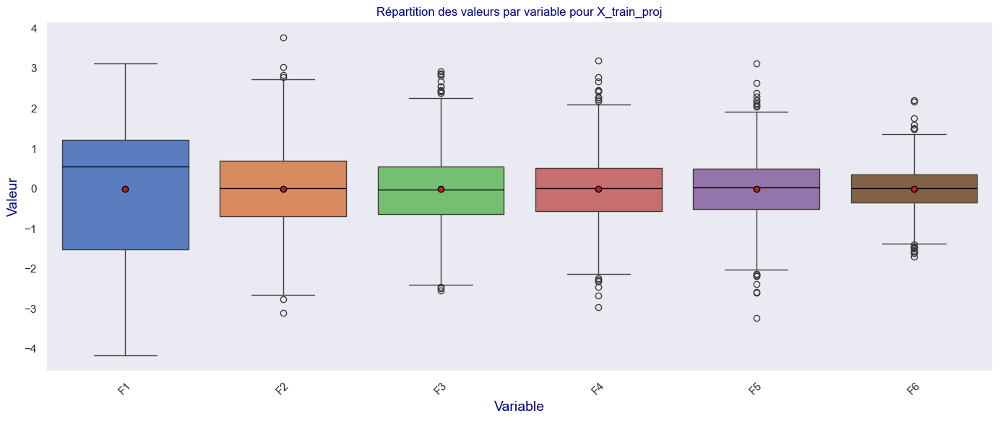

In [876]:
#boxplot de X_train_scaled 
#import pandas as pd
#import seaborn as sns
#import matplotlib.pyplot as plt

df_temp = df_X_train_proj

# Mise en format long pour seaborn
df_melted = df_temp.reset_index().melt(id_vars='index', var_name='Variable', value_name='Valeur')

# Renommer proprement l'ancienne index (souvent iso3)
#df_melted.rename(columns={'index': 'iso3'}, inplace=True)

# Tracer le boxplot
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_melted, 
            x='Variable', 
            y='Valeur',
            hue='Variable',
            medianprops = {'color':"black"},#caract de l'indice de la médiane
            meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
            showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
            palette = palette_fixe_Fi,
            hue_order = Ordre_Fi
           )

plt.xticks(rotation=45)
plt.title("Répartition des valeurs par variable pour X_train_proj")
plt.tight_layout()
plt.show()


##### <font color='blue'>**PROJECTIONS 2D sur les AXES PRINCIPAUX :**</font>

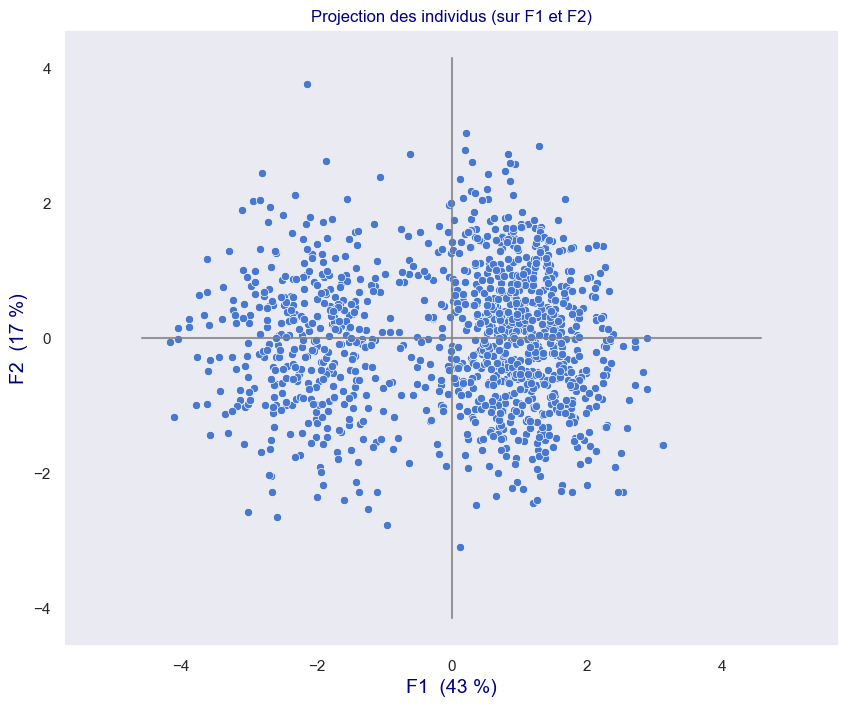

In [877]:
x_y = [0,1] #pour F1 et F2 :
display_factorial_planes(X_train_proj, x_y, pca=pca_KM_A)

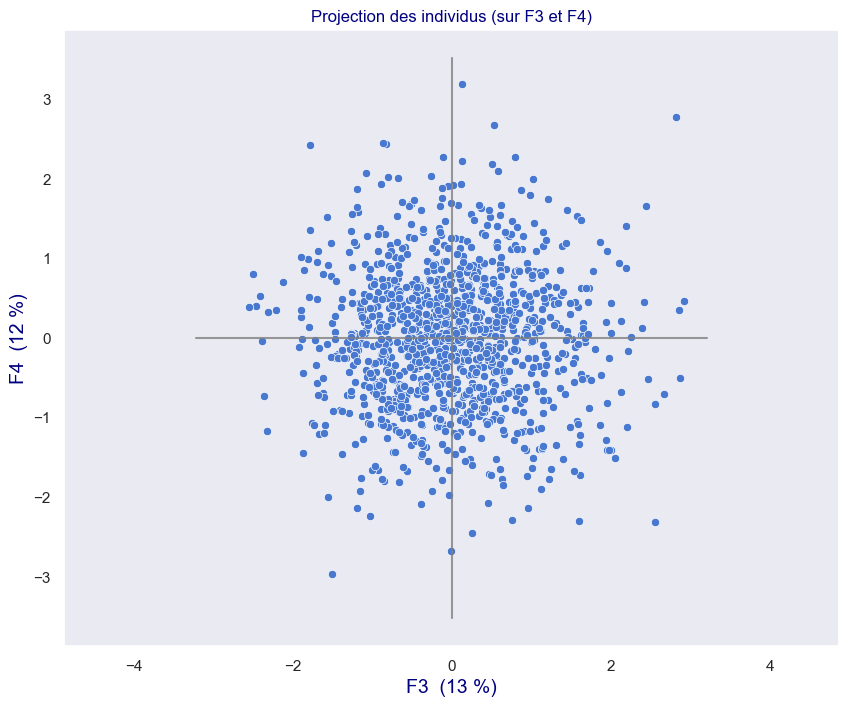

In [878]:
x_y = [2,3] #pour F3 et F4 :
display_factorial_planes(X_train_proj, x_y, pca=pca_KM_A)

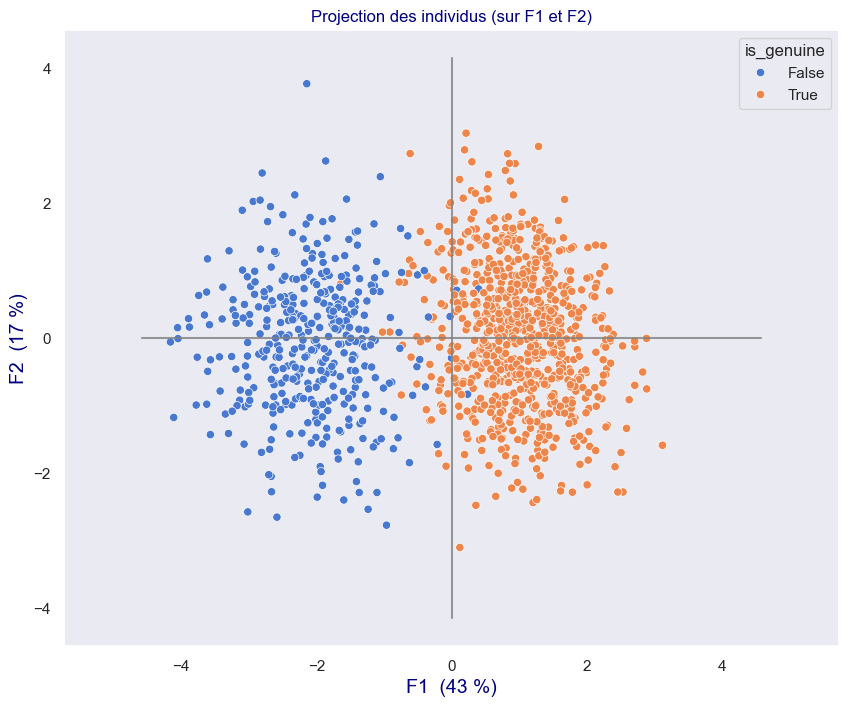

In [879]:
x_y = [0,1] #pour F1 et F2 :
display_factorial_planes(X_train_proj, x_y, pca=pca_KM_A,clusters=y_train.astype(bool))

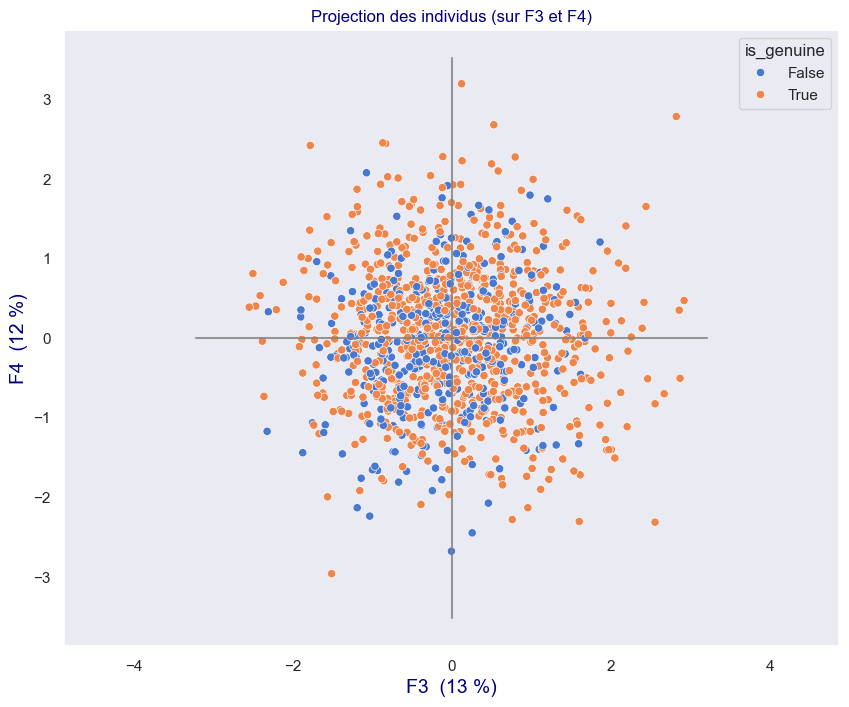

In [880]:
x_y = [2,3] #pour F2 et F3 :
display_factorial_planes(X_train_proj, x_y, pca=pca_KM_A,clusters=y_train.astype(bool))

**OBSERVATION :**  
On s'apperçoit que l'axe F1 à lui tout seul permet globalement de distinguer les vrais et faux billets !!!

##### <font color='blue'>**PROJECTIONS 3D sur les AXES PRINCIPAUX :**</font>

In [881]:
df_temp = df_X_train_proj

Text(0.5, 0, 'F3')

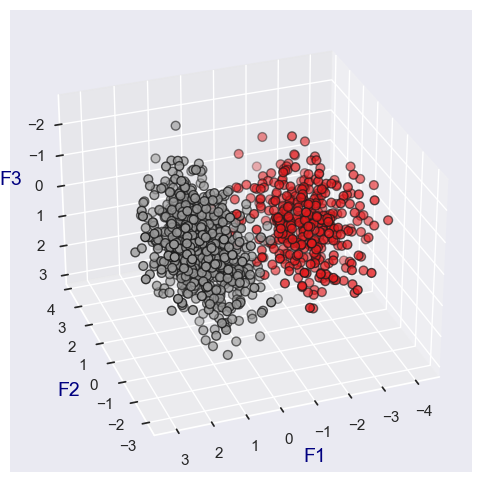

In [882]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

# On affiche nos points : 
ax.scatter(
    df_temp.iloc[:, 0],
    df_temp.iloc[:, 1],
    df_temp.iloc[:, 2],
    c=y_train.astype(bool), cmap="Set1", edgecolor="k", s=40)

# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

In [883]:
# Conversion des labels en couleurs
couleurs_points = y_train.astype(bool).map(palette_fixe_genuine)

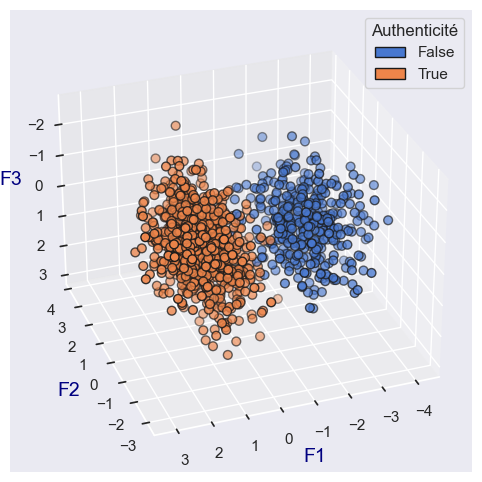

In [884]:
from matplotlib.patches import Patch

# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

# On affiche nos points : 
ax.scatter(
    df_temp.iloc[:, 0],
    df_temp.iloc[:, 1],
    df_temp.iloc[:, 2],
    c=couleurs_points, 
    edgecolor="k", 
    s=40)

# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")

# Légende
legend_elements = [
    Patch(facecolor=palette_fixe_genuine[val], edgecolor='k', label=str(val))
    for val in Ordre_genuine
]
ax.legend(handles=legend_elements, title="Authenticité", loc='upper right')

plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.1.9 -Réduction de l'Etude aux 3 premières composantes F1, F2, F3 (73% de la variance)  </h4>
</div>

##### **BILAN CHOIX DES AXES PRINCIPAUX :**
Selon le Critère de Kaiser, seul F1 et F2 sont suffisamment représentatifs.  

Selon la Variance totale portée, il faut aller jusqu'à F4 poru avoir 85% de la variance.  

Selon les observations, F1 seul semble déjà expliqué une séparation entre les Faux et Vrai billets !

En allant jusqu'à F3, nous avons 73% de la variance expliquée, ce qui est déjà une quantité raisonnable. 

**=> Conservons les axes F1, F2, F3 qui portent 73% de la variance**

In [885]:
df_X_train_proj.head()

,F1,F2,F3,F4,F5,F6
382,0.363786,1.616641,1.700346,-0.498472,0.230060,0.065563
538,1.414972,0.252611,2.125743,-0.681731,-0.630675,0.006554
1493,-2.253164,-0.532470,0.694874,1.299742,0.726782,0.150473
1112,-2.469631,0.505167,-0.034281,0.333643,-0.677086,0.253207
324,1.099501,0.798475,1.538564,-0.554779,-0.556101,0.019275


In [886]:
df_X_train_proj.shape

(1200, 6)

<u>**SELECTIONS DE COMPONENTS :**</u>  
Pour la suite ne gardons que F1, F2, F3 

In [887]:
nb_components_KM_A_selec =3

In [888]:
x_list_num_axes_tot

range(1, 7)

In [889]:
x_list_num_axes_KM_A_selec = range(1,nb_components_KM_A_selec+1)
print(x_list_num_axes_KM_A_selec)

range(1, 4)


In [890]:
list_Fi_tot

['F1', 'F2', 'F3', 'F4', 'F5', 'F6']

In [891]:
list_Fi_KM_A_selec = list_Fi_tot[:nb_components_KM_A_selec]
list_Fi_KM_A_selec

['F1', 'F2', 'F3']

In [892]:
df_X_train_proj_selec_PCA = df_X_train_proj.loc[:,list_Fi_KM_A_selec].copy(deep=True)
df_X_train_proj_selec_PCA

,F1,F2,F3
382,0.363786,1.616641,1.700346
538,1.414972,0.252611,2.125743
1493,-2.253164,-0.532470,0.694874
1112,-2.469631,0.505167,-0.034281
324,1.099501,0.798475,1.538564
...,...,...,...
1130,-2.045035,-0.969804,0.431405
1294,-1.390822,1.586250,-0.080572
860,0.552522,-1.883257,0.204322
1459,-2.668571,-0.607617,0.165111


In [893]:
df_X_train_proj_selec_PCA

,F1,F2,F3
382,0.363786,1.616641,1.700346
538,1.414972,0.252611,2.125743
1493,-2.253164,-0.532470,0.694874
1112,-2.469631,0.505167,-0.034281
324,1.099501,0.798475,1.538564
...,...,...,...
1130,-2.045035,-0.969804,0.431405
1294,-1.390822,1.586250,-0.080572
860,0.552522,-1.883257,0.204322
1459,-2.668571,-0.607617,0.165111


In [894]:
Description_Fichier_Tableau_avc_ValBlanches_V2_1(df_X_train_proj_selec_PCA)

,Type,Nb lignes,Valeurs non-vides,Valeurs vides,Valeurs distinctes,Valeurs blanches
F1,float64,1200,1200,0,1200,NaN
F2,float64,1200,1200,0,1200,NaN
F3,float64,1200,1200,0,1200,NaN


In [895]:
df_X_test_proj

,F1,F2,F3,F4,F5,F6
1116,-1.793960,0.701947,-1.450894,-0.226913,-0.018975,-0.495603
1368,-2.254273,-0.641924,0.664608,0.772769,-0.422359,0.863345
422,1.524684,-1.845766,-0.665741,0.030776,-0.357951,-0.541951
413,1.431738,0.577108,-1.257303,-0.928265,-0.009544,-0.154974
451,1.991199,0.366974,-0.263770,-0.207431,-1.075711,-0.434174
...,...,...,...,...,...,...
983,2.024448,0.849352,-0.899688,-0.240710,0.372139,0.119240
799,0.940304,1.659739,-0.171588,-0.049551,-0.854522,-0.383049
1265,-2.860232,1.556215,0.182282,-0.958926,-0.701301,0.408991
1150,-1.933008,0.393115,2.436894,0.626194,-0.256420,1.159802


In [896]:
df_X_test_proj_selec_PCA = df_X_test_proj.loc[:,list_Fi_KM_A_selec].copy(deep=True)
df_X_test_proj_selec_PCA

,F1,F2,F3
1116,-1.793960,0.701947,-1.450894
1368,-2.254273,-0.641924,0.664608
422,1.524684,-1.845766,-0.665741
413,1.431738,0.577108,-1.257303
451,1.991199,0.366974,-0.263770
...,...,...,...
983,2.024448,0.849352,-0.899688
799,0.940304,1.659739,-0.171588
1265,-2.860232,1.556215,0.182282
1150,-1.933008,0.393115,2.436894


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.1.10 - Etude des outliers </h4>
</div>

Déjà vu au niveau global. pas d'outliers importants voir première PCA d'analyse.

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">10.2test - PRELIMINAIRES : K-means sur les données X_train post ACP : df_X_train_proj_selec_PCA </h3>
</div>

**les données utilisées :**  
`df_X_train_proj_selec_PCA` : les données X_train centrées réduites projetées  
`df_X_test_proj_selec_PCA` : les données X_test centrées réduites projetées  

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.2test.1 - Préliminaires</h4>
</div>

In [897]:
df_X_train_proj_KM = df_X_train_proj_selec_PCA.copy(deep=True)

In [898]:
df_X_train_proj_KM.head()

,F1,F2,F3
382,0.363786,1.616641,1.700346
538,1.414972,0.252611,2.125743
1493,-2.253164,-0.532470,0.694874
1112,-2.469631,0.505167,-0.034281
324,1.099501,0.798475,1.538564


In [899]:
df_X_train_proj_KM.shape

(1200, 3)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.2test.2 - Test avc nb predefini de cluster  :</h4>
</div>

Testons tout d'abord avec un nombre défini de clusters.

On instancie notre estimateur:

In [900]:
n_clusters=6

In [901]:
kmeans = KMeans(n_clusters=n_clusters)

In [902]:
kmeans.fit(df_X_train_proj_KM)

,n_clusters,6
,init,'k-means++'
,n_init,'auto'
,max_iter,300
,tol,0.0001
,verbose,0
,random_state,None
,copy_x,True
,algorithm,'lloyd'


On peut calculer son inertie : (PM l'inertie totale somme des inertie des groupes)

In [903]:
kmeans.inertia_

1415.971450274689

C'est l'inertie intraclasse.  
Plus l’inertia est faible, plus les points sont proches de leur centroïde → les clusters sont compacts.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.2test.3 - Choix du Nbr de clusters  : </h4>
</div>

##### **MEHTODE DU COUDE**

Text(0.5, 1.0, 'Méthode du coude- Inertie intra-classe')

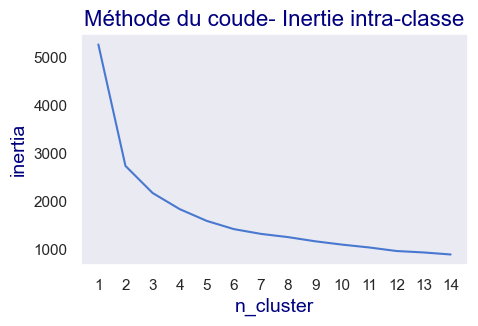

In [904]:
#On défini d'abord une liste vide pour stocker nos inerties: 
inertia = []

#On défini ensuite la liste du nombre de clusters que l'on veut tester:
k_list = range(1, 15)
list(k_list)

#on effecture k K-Means et on relève l'inertie dans la liste d'inertie
for i in k_list :
  kmeans = KMeans(n_clusters=i,random_state=42)
  kmeans.fit(df_X_train_proj_KM) 
  inertia.append(kmeans.inertia_)

#Nous obtenons une liste d'inerties intracluster que nous souhaitons minimale sans avroi trop de groupes : inertia

#Affichage du résultat :
fig, ax = plt.subplots(1,1,figsize=(5,3))

ax.set_ylabel("inertia")
ax.set_xlabel("n_cluster")
ax = plt.plot(k_list, inertia)
plt.xticks(k_list)
plt.title("Méthode du coude- Inertie intra-classe",size=16)

ATTENTION :  
LE Résultat n'est pas toujours le même sachant que le K-means n'est pas déterministe.    
Le résultat est relativement stable : 2, 3, voire  4 ou  5,...  
**coude récurrent : 2, 3**

##### **Methode de la silhouette :**

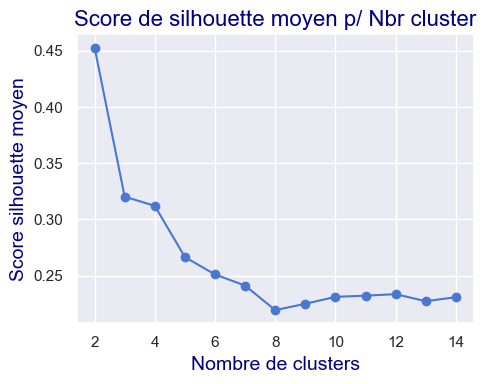

In [905]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Données déjà transformées (par exemple PCA)
X_temp = df_X_train_proj_KM.copy()

# Liste pour stocker les scores
silhouette_scores = []

# Plage du nombre de clusters à tester
range_nb_clust = range(2, 15)

# Boucle pour calculer les scores
for nb_clust in range_nb_clust:
    kmeans = KMeans(n_clusters=nb_clust, random_state=42)
    labels = kmeans.fit_predict(X_temp)
    score = silhouette_score(X_temp, labels)
    silhouette_scores.append(score)

# Affichage de la courbe
plt.figure(figsize=(5, 4))
plt.plot(list(range_nb_clust), silhouette_scores, marker='o')
plt.title("Score de silhouette moyen p/ Nbr cluster",size=16)
plt.xlabel("Nombre de clusters")
plt.ylabel("Score silhouette moyen")
plt.grid(True)
plt.tight_layout()
plt.show()


Moyenne des scores de silhouette (silhouette_avg)

C’est le score moyen sur tous les points → une mesure globale de la cohérence des clusters.

▸ Interprétation :  
Valeur	Qualité du clustering  

'> 0.7	Très bon  
0.5 – 0.7	Correct  
0.25 – 0.5	Moyennement structuré  
< 0.25	Faible ou non structuré  

Plus le score moyen est élevé, meilleur est le regroupement.

Le résultat est plus stable.  
**2 est clairement le nombre de cluster le meilleur, avec un score de silhouette de 0.45**  
cohérent avec le K-means

##### **CHOIX PAR L'OBJECTIF DU CLUSTERING :**

Nous souhaitons trier les billets en Faux et Vrai.   
Notre but est donc de trier les billets en 2 groupes.   
Un choix de 2 clusters s'impose par l'objectif.  
La consultation du score de silhouette et méthode du coude ne font confirmer que c'est le bon choix. Et que l'on a pas une 3 ème catégorie ou 4 ème catégorie claire : 
du type les Faux billets bien faits, les Faux billets malfaits !!!

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">10.2 - PRELIMINAIRES : K-means à 2 clusters / randoms_state=42 : sur les données X_train post ACP : df_X_train_proj_selec_PCA </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.2.1 - K-means et clusters sur X_train</h4>
</div>

**K_Means à 2 clusters et entrainement**

Nous devons d'abord ré-entrainer un estimateur:

In [906]:
n_clusters=2

In [907]:
#déjà fait
#df_X_train_proj_KM = df_X_train_proj_selec_PCA.copy(deep=True)

In [908]:
df_X_train_proj_KM_N_temp = df_X_train_proj_selec_PCA.copy(deep=True)

In [909]:
clf_kmeans = KMeans(n_clusters=n_clusters,random_state=42)

**ENTRAINEMENT SUR LE JEU DE DONNEES TRAIN :**

In [910]:
clf_kmeans.fit(df_X_train_proj_KM_N_temp  )

,n_clusters,2
,init,'k-means++'
,n_init,'auto'
,max_iter,300
,tol,0.0001
,verbose,0
,random_state,42
,copy_x,True
,algorithm,'lloyd'


**RECUPERATION DES CLUSTERS DES DONNEES TRAIN**

In [911]:
# Affectation des clusters aux observations d'entraînement
train_cluster = clf_kmeans.predict(df_X_train_proj_KM_N_temp)
train_cluster

array([1, 1, 0, ..., 1, 0, 0])

In [912]:
y_train

382     1
538     1
1493    0
1112    0
324     1
       ..
1130    0
1294    0
860     1
1459    0
1126    0
Name: is_genuine, Length: 1200, dtype: int32

In [913]:
# Conversion en DataFrame pour faciliter la manipulation
df_cluster_train = pd.DataFrame({'cluster': train_cluster, 'is_genuine': y_train})
df_cluster_train.head(5)

,cluster,is_genuine
382,1,1
538,1,1
1493,0,0
1112,0,0
324,1,1


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.2.2 - Dictionnaire de correspondance CLUSTER-PREDICTION</h4>
</div>

**DICTIONNAIRE DE CORRESPONDANCE CLUSTER-PREDICTION**

In [914]:
# Association de chaque cluster à la classe majoritaire d'Authenticité(=Prediction)
cluster_to_class = (
    df_cluster_train.groupby('cluster')['is_genuine']
    .agg(lambda x: x.mode()[0])
    .to_dict()
)
cluster_to_class

{0: 0, 1: 1}

In [915]:
# Mapping explicite
print("Correspondance cluster → Prédiction :")
for k, v in cluster_to_class.items():
    print(f"Cluster {k} → Prédiction {v}")

Correspondance cluster → Prédiction :
Cluster 0 → Prédiction 0
Cluster 1 → Prédiction 1


**Remarque :**  
Dans le cadre d'un modèle, il n'y a pas besoin de calculer la prédiction sur X_train (df_X_train_proj_KM_N_temp) .  
En effet, X_train ne sert qu'à entrainer le modèle.  
Ici X_train permet de créer les 2 clusters, avec leurs centroides, qui permettront d'affecter les X_tests.  

Remarque pour moi on aurait aussi pu calculer un vrai centre de gravité, en partitionnant nos données sur la base de y_train. Ca me parait plus pertinent mais ce n'est pas ce qui a été demandé!

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.2.3 - Illustrations visuelles des clusters de X_train et Centroides</h4>
</div>

Voici les clusters : 

In [916]:
df_X_train_proj_KM_N_graph = df_X_train_proj_KM_N_temp.copy(deep=True)
df_X_train_proj_KM_N_graph.head()

,F1,F2,F3
382,0.363786,1.616641,1.700346
538,1.414972,0.252611,2.125743
1493,-2.253164,-0.532470,0.694874
1112,-2.469631,0.505167,-0.034281
324,1.099501,0.798475,1.538564


In [917]:
clf_kmeans.labels_

array([1, 1, 0, ..., 1, 0, 0])

**Remarque** pour obtenir les labels on aurait pu aussi faire :
**kmeans.predict(df_X_train_proj_KM_N_graph)**

kmeans.predict(df) marche sur toutes les données y compris celles non vues, pour dire de quelles données elles sont les plus proches.  

**kmeans.labels_** ne donne les labels que pour les données d'entrainement du kmeans.fit(df_X_train_proj_KM_N_graph  )

In [918]:
pd.Series(clf_kmeans.labels_).value_counts()

1    816
0    384
Name: count, dtype: int64

In [919]:
pd.Series(clf_kmeans.predict(df_X_train_proj_KM_N_graph)).value_counts()

1    816
0    384
Name: count, dtype: int64

Ajoutons nos labels à `df_X_train_proj_KM_N_graph`

In [920]:
df_X_train_proj_KM_N_graph  ["labels"] = clf_kmeans.labels_
#df_X_train_proj_KM_N_graph  ["labels"] = kmeans.predict(df_X_train_proj_KM_N_graph)
df_X_train_proj_KM_N_graph  

,F1,F2,F3,labels
382,0.363786,1.616641,1.700346,1
538,1.414972,0.252611,2.125743,1
1493,-2.253164,-0.532470,0.694874,0
1112,-2.469631,0.505167,-0.034281,0
324,1.099501,0.798475,1.538564,1
...,...,...,...,...
1130,-2.045035,-0.969804,0.431405,0
1294,-1.390822,1.586250,-0.080572,0
860,0.552522,-1.883257,0.204322,1
1459,-2.668571,-0.607617,0.165111,0


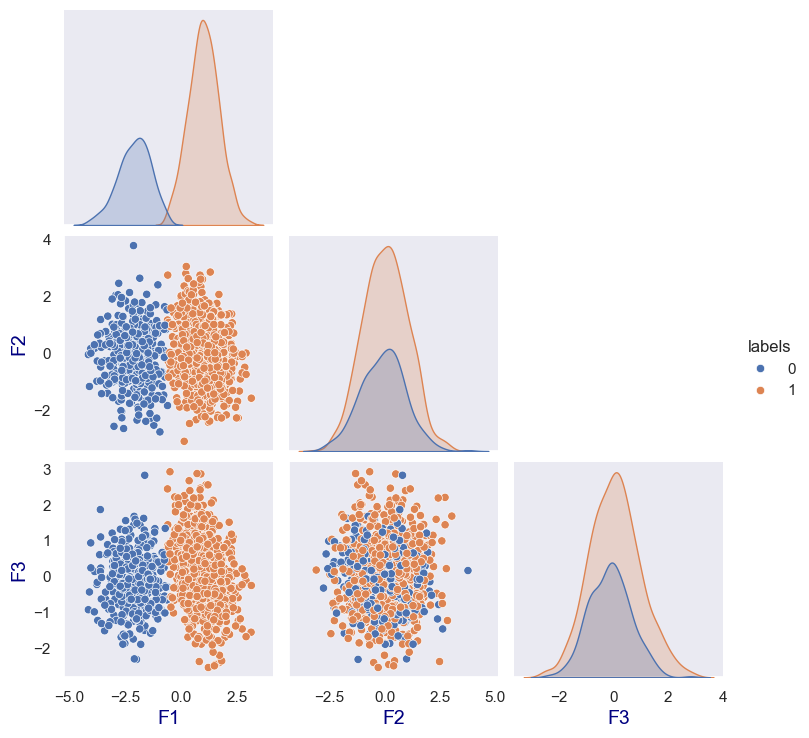

In [921]:
sns.pairplot(df_X_train_proj_KM_N_graph  , 
             hue="labels",
             corner=True,
             palette =palette_fixe_cluster_labels ,
             hue_order=Ordre_cluster_labels)

##### **Centroides**

Les données labéllisées en cluster

In [922]:
df_X_train_proj_KM_N_graph.head(3)

,F1,F2,F3,labels
382,0.363786,1.616641,1.700346,1
538,1.414972,0.252611,2.125743,1
1493,-2.253164,-0.532470,0.694874,0


CENTRE DE GRAVITE :

In [923]:
df_X_train_proj_KM_N_graph_grouped = (df_X_train_proj_KM_N_graph.groupby(by=['labels'])).mean()
df_X_train_proj_KM_N_graph_grouped.index.name = 'cluster'
display(df_X_train_proj_KM_N_graph_grouped)

,F1,F2,F3
cluster,,,
0,-2.112342,-0.084562,-0.129636
1,0.994043,0.039794,0.061005


LES CENTROIDES :

In [924]:
# On peut stocker nos centroids dans une variable : 
centroids = kmeans.cluster_centers_
centroids

array([[-2.73701511, -0.43080178, -0.63053096],
       [ 0.93511642,  0.53349085,  0.38254083],
       [ 0.07242871, -0.41823051,  0.48338839],
       [ 0.9226099 , -0.2498289 , -0.93363676],
       [-1.81038208, -1.3387395 ,  0.16523116],
       [ 0.4949599 ,  1.52375185, -0.10078657],
       [-2.08313416,  0.3269828 ,  0.4859544 ],
       [ 1.79055409, -0.36795428,  0.18164714],
       [ 1.39673206,  0.8584544 , -0.99756262],
       [ 1.89318932, -1.30865522, -0.92698365],
       [ 0.88188877, -1.46175047,  0.12214207],
       [-1.93254933,  0.99994901, -0.72567038],
       [ 0.66429687, -0.39612905,  1.7825735 ],
       [ 0.44671374,  1.51037072,  1.3173372 ]])

**CENTROIDES du K-means= BARYCENTRE**  
les centroides calculés par le K-means sont bien les centre de gravité despoints du cluster

##### **VISUALISATIONS**

In [925]:
df_temp = df_X_train_proj_KM_N_graph  .copy()
df_temp

,F1,F2,F3,labels
382,0.363786,1.616641,1.700346,1
538,1.414972,0.252611,2.125743,1
1493,-2.253164,-0.532470,0.694874,0
1112,-2.469631,0.505167,-0.034281,0
324,1.099501,0.798475,1.538564,1
...,...,...,...,...
1130,-2.045035,-0.969804,0.431405,0
1294,-1.390822,1.586250,-0.080572,0
860,0.552522,-1.883257,0.204322,1
1459,-2.668571,-0.607617,0.165111,0


In [926]:
df_temp_grouped =df_X_train_proj_KM_N_graph_grouped.copy()
df_temp_grouped

,F1,F2,F3
cluster,,,
0,-2.112342,-0.084562,-0.129636
1,0.994043,0.039794,0.061005


##### **Liste des billets**

##### **HEATMAP**

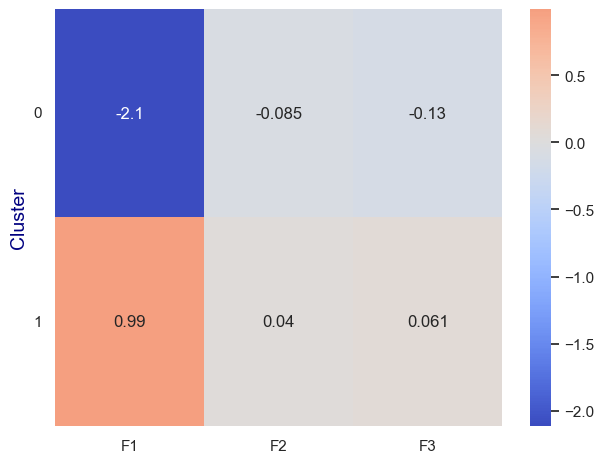

In [927]:
sns.heatmap(data=df_temp_grouped, 
            annot=True,
            cmap='coolwarm',
            center =0 
           )
plt.yticks(rotation=0)  # 0 pour horizontal, 90 pour vertical, etc.
plt.ylabel("Cluster")
plt.tight_layout()
plt.show()

##### **RADAR**

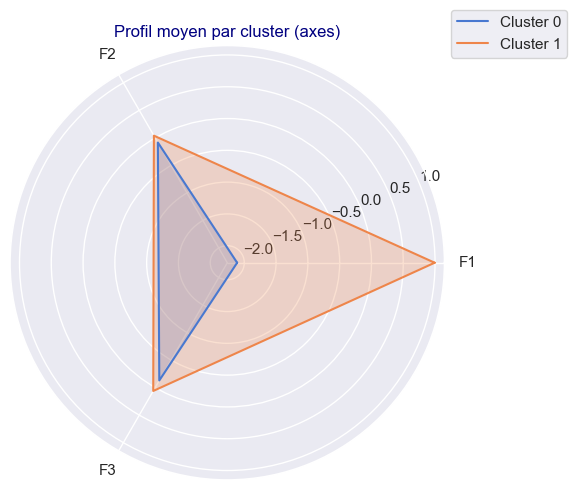

In [928]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 1. Moyenne par cluster
#df_temp_grouped = df_temp_grouped.copy() #le df à utiliser pour les visualisations

# 2. Préparation des données
features_temp = df_temp_grouped.columns
n_clusters_temp = df_temp_grouped.shape[0] #déjà défini
angles = np.linspace(0, 2 * np.pi, len(features_temp), endpoint=False).tolist()
angles += angles[:1]  # fermeture du radar

# 3. Création du radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

for i in range(n_clusters_temp):
    values = df_temp_grouped.iloc[i].values.tolist()
    values += values[:1]  # fermer la courbe
    ax.plot(angles, values, label=f"Cluster {i}")
    ax.fill(angles, values, alpha=0.25)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(features_temp)
plt.title("Profil moyen par cluster (axes)")
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


##### Boxplot

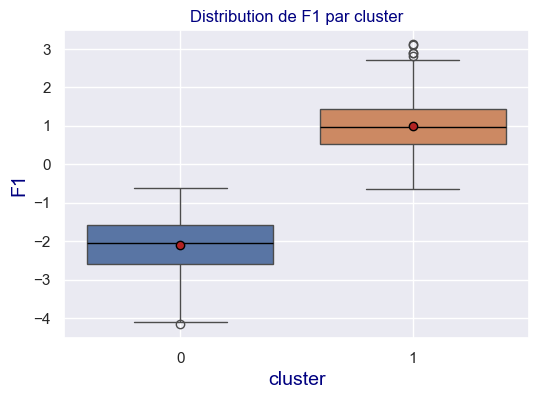

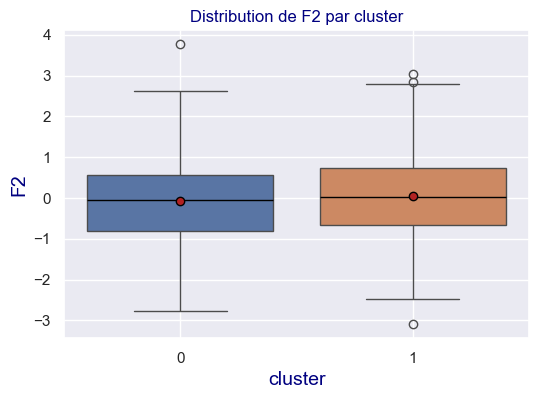

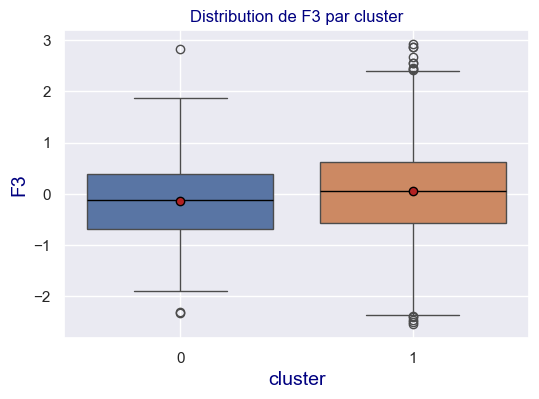

In [929]:
#Boxplots

# 1. Moyenne par cluster
#df_means = df_temp_grouped.copy() #le df à utiliser pour les visualisations

for col in df_temp.columns.drop("labels", errors='ignore')  :
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                medianprops = {'color':"black"},#caract de l'indice de la médiane
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},#caract de l'indice de la moyenne
                showmeans =True, #c'est ce qui permet de faire apparaitre la moyenne,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
               legend=False)
    plt.xlabel('cluster')
    #plt.legend(title = "cluster")
    plt.title(f"Distribution de {col} par cluster")
    plt.grid(True)
    plt.show()

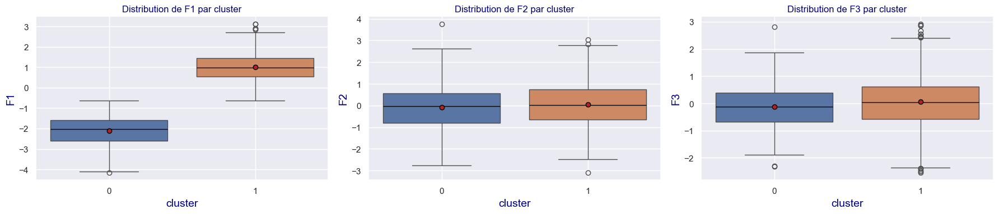

In [930]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Liste des variables à afficher (hors "labels")
variables = df_temp.columns.drop("labels", errors='ignore')
n = len(variables)

# Définir le nombre de lignes et de colonnes
n_cols = 3
n_rows = math.ceil(n / n_cols)

# Créer la figure
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 4))
axes = axes.flatten()  # pour indexer facilement

for i, col in enumerate(variables):
    ax = axes[i]
    sns.boxplot(data=df_temp,
                x='labels', 
                y=col,
                hue='labels',
                ax=ax,
                medianprops = {'color':"black"},
                meanprops = {'marker':'o', 'markeredgecolor':'black','markerfacecolor':'firebrick'},
                showmeans =True,
                palette = palette_fixe_cluster_labels,
                hue_order = Ordre_cluster_labels,
                legend=False)
    ax.set_title(f"Distribution de {col} par cluster")
    ax.set_xlabel("cluster")
    ax.grid(True)

# Supprimer les axes vides s’il y a moins de 4 variables
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

##### **PROJECTIONS**

Nosu avons déjà des données projetées

In [931]:
X_proj_temp = df_temp.copy()
X_proj_temp.head(2)

,F1,F2,F3,labels
382,0.363786,1.616641,1.700346,1
538,1.414972,0.252611,2.125743,1


In [932]:
centroids_proj_temp =df_temp_grouped.copy()
display(centroids_proj_temp)

,F1,F2,F3
cluster,,,
0,-2.112342,-0.084562,-0.129636
1,0.994043,0.039794,0.061005


In [933]:
centroids_proj_temp['labels']=centroids_proj_temp.index
display(centroids_proj_temp)

,F1,F2,F3,labels
cluster,,,,
0,-2.112342,-0.084562,-0.129636,0
1,0.994043,0.039794,0.061005,1


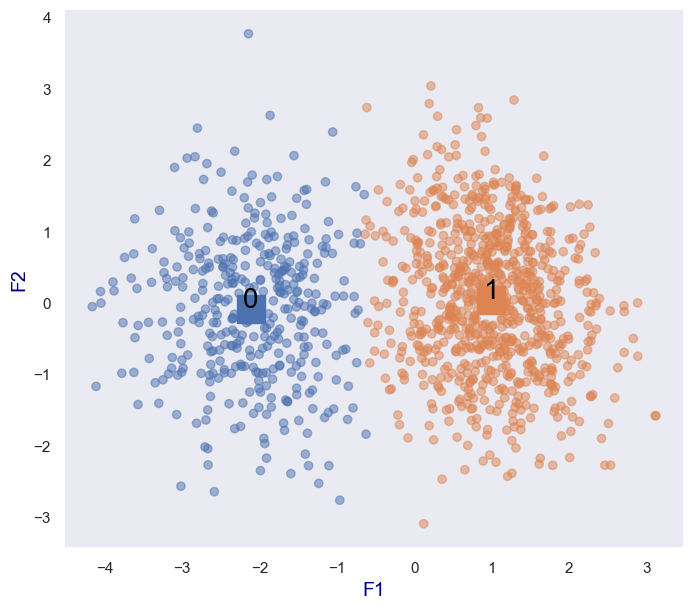

In [934]:
# On définit notre figure et son axe : 
fig, ax = plt.subplots(1, 1, figsize=(8, 7))

# ➕ Générer les couleurs pour chaque point selon le label
colors_individus = X_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➕ Générer les couleurs pour les centroïdes
colors_centroids = centroids_proj_temp['labels'].map(palette_fixe_cluster_labels)

# ➤ Affichage des individus avec la palette personnalisée
ax.scatter(
    X_proj_temp.iloc[:, 0], 
    X_proj_temp.iloc[:, 1], 
    c=colors_individus,
    alpha=0.5
)

# ➤ Affichage des centroïdes
ax.scatter(
    centroids_proj_temp.iloc[:, 0], 
    centroids_proj_temp.iloc[:, 1], 
    marker="s", 
    c=colors_centroids,
    s=400
)

# ➤ Ajout des étiquettes de cluster sur les centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1] + 0.02,
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=20, 
        color='black', 
        ha='center'
    )

# ➤ Titre des axes
ax.set_xlabel("F1")
ax.set_ylabel("F2")
plt.show()


On peut faire des graphiques à 3 dimensions :

Text(0.5, 0, 'F3')

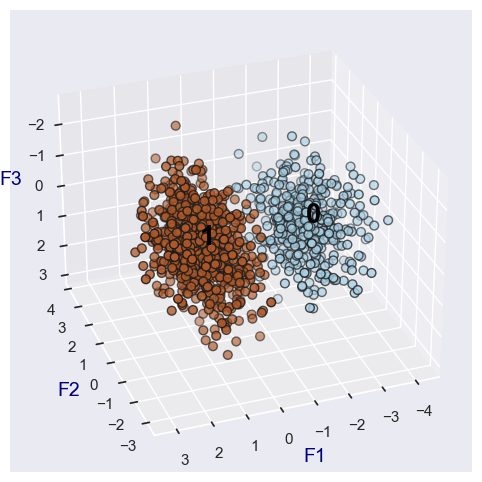

In [935]:
# On définit notre figure et notre axe différemment : 
fig= plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


# On affiche nos points : 
ax.scatter(
    X_proj_temp.iloc[:, 0],
    X_proj_temp.iloc[:, 1],
    X_proj_temp.iloc[:, 2],
    c=X_proj_temp['labels'], cmap="Paired", edgecolor="k", s=40)


# On affiche nos centroides, avec une couleur noire (c="black") et une frome de carré (marker="c") : 
ax.scatter(centroids_proj_temp.iloc[:, 0], 
           centroids_proj_temp.iloc[:, 1],  
           centroids_proj_temp.iloc[:, 2],  
           c=centroids_proj_temp['labels'],cmap="Paired", s=400,  marker="s",depthshade=False )

# Ajout des labels des centroïdes
for i in range(len(centroids_proj_temp)):
    ax.text(
        centroids_proj_temp.iloc[i, 0], 
        centroids_proj_temp.iloc[i, 1], 
        centroids_proj_temp.iloc[i, 2], 
        str(centroids_proj_temp['labels'].iloc[i]),
        fontsize=20, color='black', weight='bold'
    )


# On spécifie le nom des axes : 
ax.set_xlabel("F1")
ax.set_ylabel("F2")
ax.set_zlabel("F3")


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.2.4 - Prédictions sus le jeu de Test et Pseudo Probabilité</h4>
</div>

**PREDICTION SUR LE JEU DE TEST :**

In [936]:
#les données X_test transformées par Standardscaler puis PCA
df_X_test_proj_KM_N_temp = df_X_test_proj_selec_PCA.copy(deep=True)

In [937]:
# Attribution des clusters au jeu de test
test_clusters = clf_kmeans.predict(df_X_test_proj_KM_N_temp)

In [938]:
test_clusters

array([0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1,
       0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1,
       0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1,
       0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1,
       0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1,
       0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1,
       1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1])

In [939]:
y_test_pred = np.array([cluster_to_class[c] for c in test_clusters])
y_test_pred

array([0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1,
       0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1,
       0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1,
       0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1,
       0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1,
       0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1,
       1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1])

**DISTANCE AUX CENTROIDES COMME PROBABILITE INVERSEE pour la classe 1**

Si on veut produire une « pseudo » probabilité (non calibrée) pour la classe 1, on peut faire ceci :

In [940]:
from scipy.spatial.distance import cdist

# Distance aux deux centroïdes
distances = cdist(df_X_test_proj_KM_N_temp, clf_kmeans.cluster_centers_)  # shape: (n_samples, 2)

#Pour avoir le cluster qui représente la classe 1-Vrai Billet :
idx_class_1 = list(cluster_to_class.values()).index(1)
#Pour récupérer la colonne de distance au cluster associé à la calsse 1VraiBillet :
dist_to_class_1 = distances[:, idx_class_1]

# Convertir en score (plus proche = score plus élevé)
y_test_proba = 1 / (1 + dist_to_class_1)

Ces scores ne sont pas des probabilités calibrées, (cela ne correspond pas vraiment au pourcentage d'être dans la catégorie  ou 0). On peut avoir un socre de 0.4 et être dans la classe 1)
mais on pourra les exploiter pour des seuils ou une courbe ROC comparative.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.2.5 - Observations des pseudo probas pas très parlantes Probas</h4>
</div>

Text(0.5, 1.0, 'Répartitions des probas de valoir 1 sur le jeu de test')

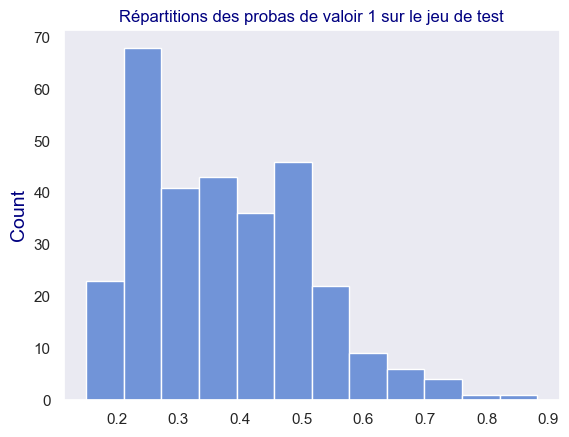

In [941]:
#Répartitions des probas de valoir 1 sur le jeu de test

sns.histplot(y_test_proba)
plt.title("Répartitions des probas de valoir 1 sur le jeu de test")

ATTENTION ICI Il s'agit de pseudo proba:
En effet on peut-être loin du centrpoide de classe 1 et avoir une valeur faible et être encore plus loin du centroide de classe 2.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.2.6 - Score de performance : Exactitude(accuracy) </h4>
</div>

from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_auc_score, roc_curve

Le plus simple pour mesurer la performance d'une classification est de regarder  
L'**exactitude(accuracy)**, c'est la proportion d'échantillons bien classé :  
exactitude = (échantillons bien classés)/échantillons au total

In [942]:
from sklearn.metrics import accuracy_score
print("Score d'Exactitude-accuracy sur le jeu test = ",accuracy_score(y_test, y_test_pred))

Score d'Exactitude-accuracy sur le jeu test =  0.9866666666666667


**OBSERVATION :**  
98,7% d'échantilons bien classés sur le jeu test, très bonne performance

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.2.7 - Matrice de confusion </h4>
</div>

In [943]:
from sklearn.metrics import confusion_matrix

Attention la matrice de confusion pour scikit-learn est :  
TN | FP  
FN | TP  

In [944]:
confusion_matrix(y_test, y_test_pred)

array([[108,   2],
       [  2, 188]], dtype=int64)

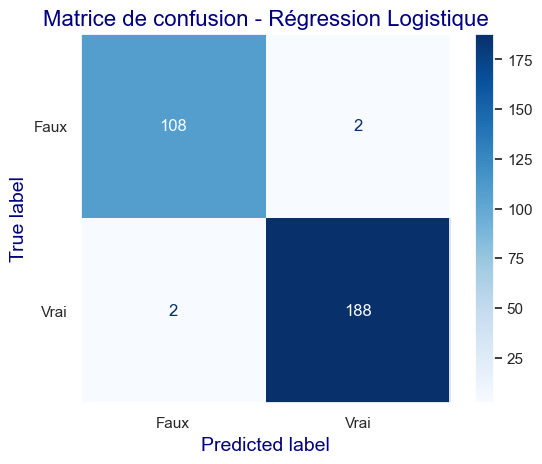

In [945]:
ConfusionMatrixDisplay.from_predictions(
    y_test, y_test_pred, display_labels=['Faux', 'Vrai'], cmap='Blues'
)
plt.title("Matrice de confusion - Régression Logistique",size=16)
plt.show()

In [946]:
# Matrice de confusion
tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred).ravel()

# Calculs
TPR = tp / (tp + fn) if (tp + fn) != 0 else 0
FPR = fp / (fp + tn) if (fp + tn) != 0 else 0

# Affichage
print(f"TPR (Recall / Sensibilité) : {TPR:.3f}")
print(f"FPR (Taux de faux positifs) : {FPR:.3f}")

TPR (Recall / Sensibilité) : 0.989
FPR (Taux de faux positifs) : 0.018


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.2.8 -  Autres metriques de classification : </h4>
</div>

In [947]:
from sklearn.metrics import precision_score, recall_score, roc_auc_score

<u>**Le Rappel-recall ou TPR(True Positive Rate):**</u>  
Rappel = TP/(TP+FN)  
= Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  
Compris entre 0 et 1.  
Plus il augmente plus cela minimise les Faux négatifs.  
(plus FN augmente, plus Rappel baisse)  
Plus on diminue le seuil de détection des positifs, plus on diminuera FN, plus on augmentera le Rappel.  

<u>**La Précision :**</u>  
Précision = TP/(TP+FP)  
= Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
Compris entre 0 et 1.  
plus il augmente, plus cela minimise lse Faux positifs.  
(plus FP augmente, plus la précision baisse)  
Plus on augmente le seuil de détection des positifs,  
plus on diminuera les FP,  plus on augmentera La Précision.  



**TPR(True Positive Rate)=Recall**  
TPR= TP / (TP + FN) (Taux de Positifs détectés parmi les positifs réels)
Plus TPR est haut, mieux c'est.  

**FPR(False Positive Rate)**  
FPR=  FP / (FP+TN)   (Taux de Faux positifs parmis les négatifs réels)
Plus FPR, est bas, mieux c'est.  

**Courbe ROC (Receiver Operating Characteristic) ou encore fonction d’efficacité du récepteur**  
TPR en fonction de FPR

<u>**ROC_AUC : Area under the ROC ou surface sous la courbe ROC**</u>  
Compris entre 0 et 1.  

Plus elle est proche de 1 mieux c'est :   
- Cela signifie que l'on peut trouver un TPR élevé pour un FPR bas.

Pour une courbe plus basse (0.5 ou au dessous) :
- avoir un TPR élevé se fait au prix d’un FPR élevé   ;
 
-avoir une FPR bas se fait au prix d’un TPR bas.


In [948]:
print("Recall : ",recall_score(y_test, y_test_pred))
print("Precision : ",precision_score(y_test, y_test_pred))
print("ROC-AUC pseudo proba: ", roc_auc_score(y_test, y_test_proba))

Recall :  0.9894736842105263
Precision :  0.9894736842105263
ROC-AUC pseudo proba:  0.9780861244019139


In [949]:

print("ROC-AUC pseudo proba: ", roc_auc_score(y_test, y_test_proba))
# Score ROC AUC : approximation en binaire
print("ROC-AUC approx binaire : ", roc_auc_score(y_test, y_test_pred))

ROC-AUC pseudo proba:  0.9780861244019139
ROC-AUC approx binaire :  0.985645933014354


**ATTENTION :** pour ROC : pseudo-proba  

**OBSERVATION :**  
- bon Recall (proche de 1)  
(TPR)(Proportion de Vrai positifs détectés(TP) parmis tous les positifs réels(TP+FN)  )   
- bonne Précision (proche de 1)  
Proportion de vrais positifs(TP) parmis tous les positifs détectés(TP+FP)  
- bon ROC (proche de 1)  
on peut trouver un TPR((True Positive Rate) élevé pour un FPR(False Positive Rate) bas.

**Courbe ROC :**

In [950]:
from sklearn.metrics import roc_curve

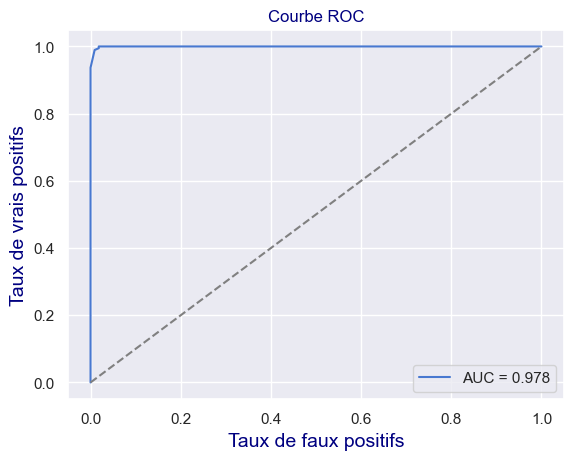

In [951]:
#La Courbe ROC-AUC

#y_test_proba = model.predict_proba(X_test_scaled)[:,1])

fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test_scaled)[:,1])

plt.plot(fpr, tpr, label=f"AUC = {roc_auc_score(y_test, y_test_proba ):.3f}")
plt.plot([0,1], [0,1], linestyle='--', color='gray')
plt.xlabel("Taux de faux positifs")
plt.ylabel("Taux de vrais positifs")
plt.title("Courbe ROC")
plt.legend()
plt.grid()
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.2.9 - Rapport de classification : </h4>
</div>

In [952]:
from sklearn.metrics import classification_report

In [953]:
print(classification_report(y_test, y_test_pred, digits=3))

              precision    recall  f1-score   support

           0      0.982     0.982     0.982       110
           1      0.989     0.989     0.989       190

    accuracy                          0.987       300
   macro avg      0.986     0.986     0.986       300
weighted avg      0.987     0.987     0.987       300



<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.2.10 - PAS DE Coefficients: </h4>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">10.3 - PAS DE VERIFICATION DE PERFORMANCE SUPPLEMENTAIRE ET AMELIORATION POUR K-MEANS  </h3>
</div>

J'ai déjà fait un K-means qui donne de bon résultats .  
Regardons si elle est stable et  peut être améliorer ?

Le K-Means n'est pas compatible avec la méthode Cross_validate.  
Ce qui ne le rend pas éligible aux validation croisées.  
Le K-means n'est pas compatible Avec GridSearch,
Il ne fournit pas de coeff et ne donne pas de proba.  

De plus sa structure avec une étpae intermédiaire le rend incompatible avec ces méthodes et complique son traitement.

**=> Nous ne pouvons pas faire de recherche d'amélioration de performance comme pour les autres Modèles.

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.3.1 - KO-VALIDATION CROISEE 1:Robustesse au jeu de données</h4>
</div>

**Validation croisée**

Objectif : s’assurer que la performance n’est pas liée à un seul split train/test  

**LA METHODE cross_validate n'est pas compatible avec le K-means**  

De plsu il faudrati adapter car en fait le K-means ne donne pas un résultat directement il faut une 2èeme transformation derrière

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.3.2 - KO- VALIDATION CROISEE 2 :Robustesse au random state de LogisticRegression</h4>
</div>

**LA METHODE cross_validate n'est pas compatible avec le K-means**

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.3.3 -  Sélection de variable : PAS DE SELECTION de VARIABLE Pour comparaison </h4>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 10.3.4 KO GridSearchCV Non compatible avec KMEANS </h4>
</div>

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 11 - Comparaison des modèles supervisés </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">11.1 -Rappel des données et des modèles optimisés </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 11.1.1 -  Préparation des données : </h4>
</div>

In [954]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

#listes des variables prédictives pour le modèle RL_final : toutes les var quantitatives
var_pred = ['diagonal',
            'height_left', 'height_right', 
            'margin_low','margin_up', 
            'length']
#la variable cible :
var_cible = 'is_genuine'

#le jeu de données prédictif complet:
X = (df_billets_analyse_1_2_copy[var_pred]).copy(deep=True)

#le jeu de données cible réel en convertissant les False en 0 et les True en 1
y = (df_billets_analyse_1_2_copy[var_cible]).copy(deep=True)
y = y.astype(int) #conversion des False / True en 0 /1


# split train, test
# proportion du jeu test : 0.2
#random_state : 42 pour pouvoir reproduire (une fois testé avec différent random_state)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

scaler_final = StandardScaler()

X_train_scaled = scaler_final.fit_transform(X_train)
X_test_scaled = scaler_final.transform(X_test)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 11.1.2 -  La Régression Logistique optimisé : </h4>
</div>

In [955]:
from sklearn.linear_model import LogisticRegression

# initialisation et entraînement en une ligne
clf_RL_final = LogisticRegression(C=0.1, max_iter=100, penalty='l2', random_state=42)

#Entrainement
clf_RL_final.fit(X_train_scaled, y_train)

,penalty,'l2'
,dual,False
,tol,0.0001
,C,0.1
,fit_intercept,True
,intercept_scaling,1
,class_weight,None
,random_state,42
,solver,'lbfgs'
,max_iter,100
,multi_class,'deprecated'


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 11.1.3 - Le Random Forest optimisé  : </h4>
</div>

In [956]:
from sklearn.ensemble import RandomForestClassifier

clf_RF_final = RandomForestClassifier(
    n_estimators=500,
    max_depth=10,
    max_features=2,
    min_samples_split=2,
    criterion='entropy',
    random_state=42
)

clf_RF_final.fit(X_train_scaled, y_train)

,n_estimators,500
,criterion,'entropy'
,max_depth,10
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,2
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,bootstrap,True
,oob_score,False


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 11.1.4 - Le KNN optimisé : </h4>
</div>

In [957]:
from sklearn.neighbors import KNeighborsClassifier

clf_KNN_final = KNeighborsClassifier(
    n_neighbors=9,
    weights='uniform',
    metric='minkowski',
    p=1
)

clf_KNN_final.fit(X_train_scaled, y_train)

,n_neighbors,9
,weights,'uniform'
,algorithm,'auto'
,leaf_size,30
,p,1
,metric,'minkowski'
,metric_params,None
,n_jobs,None


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">11.2 -Analyse et comparaison </h3>
</div>

**Rappel de bibliothèques utiles :**

In [958]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

from sklearn.metrics import (
    confusion_matrix, ConfusionMatrixDisplay,
    precision_score, recall_score, roc_auc_score,
    roc_curve
)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 11.2.1 -  Prédictions & Probabilités : </h4>
</div>

In [959]:
# Prédictions
y_test_pred_RL_final = clf_RL_final.predict(X_test_scaled)
y_test_pred_RF_final = clf_RF_final.predict(X_test_scaled)
y_test_pred_KNN_final = clf_KNN_final.predict(X_test_scaled)

# Probabilités (classe 1)
y_test_proba_RL_final = clf_RL_final.predict_proba(X_test_scaled)[:, 1]
y_test_proba_RF_final = clf_RF_final.predict_proba(X_test_scaled)[:, 1]
y_test_proba_KNN_final = clf_KNN_final.predict_proba(X_test_scaled)[:, 1]

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 11.2.2 Matrices de confusions  : </h4>
</div>

Attention la matrice de confusion pour scikit-learn est :  
TN | FP  
FN | TP  

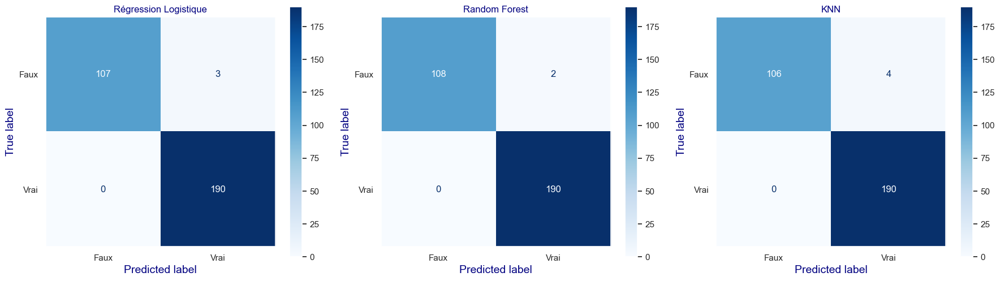

In [960]:
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

models_preds = [
    ("Régression Logistique", y_test_pred_RL_final),
    ("Random Forest", y_test_pred_RF_final),
    ("KNN", y_test_pred_KNN_final)
]

for ax, (title, y_pred) in zip(axes, models_preds):
    ConfusionMatrixDisplay.from_predictions(
        y_test, y_pred,
        display_labels=["Faux", "Vrai"],
        cmap="Blues",
        ax=ax
    )
    ax.set_title(title)

plt.tight_layout()
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 11.2.3 Les Scores  : </h4>
</div>

In [961]:
def compute_scores(y_true, y_pred, y_proba):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    return {
        "Accuracy": (tp + tn) / (tp + tn + fp + fn),
        "Precision": precision_score(y_true, y_pred),
        "Recall (TPR)": recall_score(y_true, y_pred),
        "FPR": fp / (fp + tn),
        "ROC-AUC": roc_auc_score(y_true, y_proba)
    }

scores_df = pd.DataFrame({
    "Régression Logistique": compute_scores(y_test, y_test_pred_RL_final, y_test_proba_RL_final),
    "Random Forest": compute_scores(y_test, y_test_pred_RF_final, y_test_proba_RF_final),
    "KNN": compute_scores(y_test, y_test_pred_KNN_final, y_test_proba_KNN_final)
}).T

display(scores_df.round(3))


,Accuracy,Precision,Recall (TPR),FPR,ROC-AUC
Régression Logistique,0.990,0.984,1.0,0.027,1.0
Random Forest,0.993,0.990,1.0,0.018,1.0
KNN,0.987,0.979,1.0,0.036,1.0


<u>**RAPPEL INTERPRETATION :**</u>  

**ACCURACY**
= (tp + tn) / (tp + tn + fp + fn)  
Proportion d'échantillons bien classés, sur l'ensemble des échantillons.  

**PRECISION**  
=TP/(TP+FP)  
Proportion de Vrais Billets parmis tous les positifs.  
Plus il ya de FP plus la précision baisse.  

**RECALL(TPR)**  
=TP / (TP + FN)  
Proportion de Vrai billets positifs parmis tous les Vrais billets.  
Plus il y a fe FN plus le Recall baisse.
(Taux d'erreur sur les Vrais Billets)  

**FPR**  
=FP /(FP + TN)  
Proportion de Faux Billets non détectés parmis les Faux Billets  
(Taux d'erreur sur les Faux billets)  

**SCORE ROC-AUC :**  
compris entre 0(contre intuitif), 0,5(aléatoire) et 1(bon)  
Combine le TPR et le FPR 
(est-ce qu'il y a une bonne séparation, et que la plupart des seuils permettent un FPR bas et un TPR elevé).

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 11.2.3 - Radar chart des performances : </h4>
</div>

##### **TEST**

- Standardisation min-max par indicateur pour chaque score entre 0 et 1.
- Inversion du score FPR (car plus il est bas, mieux c'est) → on affiche (1 - FPR) dans le radar.
- Affichage plus clair et labels corrigés.

##### **FIN TEST**

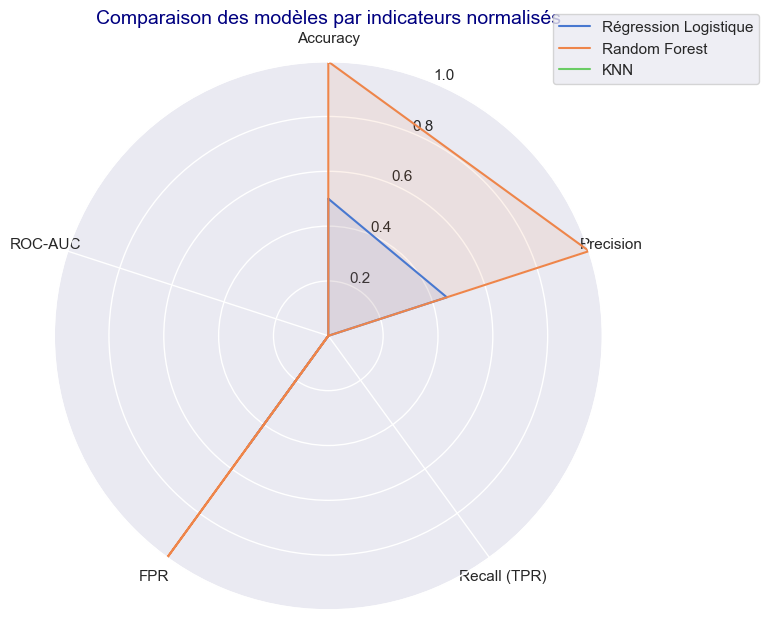

In [962]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

# Données brutes de performance
performance_data = {
    'Régression Logistique': {
        'Accuracy': 0.990,
        'Precision': 0.984,
        'Recall (TPR)': 1.0,
        'FPR': 0.027,
        'ROC-AUC': 1.0
    },
    'Random Forest': {
        'Accuracy': 0.993,
        'Precision': 0.990,
        'Recall (TPR)': 1.0,
        'FPR': 0.018,
        'ROC-AUC': 1.0
    },
    'KNN': {
        'Accuracy': 0.987,
        'Precision': 0.979,
        'Recall (TPR)': 1.0,
        'FPR': 0.036,
        'ROC-AUC': 1.0
    }
}

# Création DataFrame
df_scores = pd.DataFrame(performance_data).T

# Inversion du FPR pour l'interpréter en "meilleur si plus grand"
df_scores['FPR'] = 1 - df_scores['FPR']

# Normalisation des scores pour le radar chart
scaler_MM = MinMaxScaler()
df_scores_normalized = pd.DataFrame(
    scaler_MM.fit_transform(df_scores),
    columns=df_scores.columns,
    index=df_scores.index
)

# Préparation du radar chart
labels = df_scores.columns.tolist()
num_vars = len(labels)

# Calcul des angles
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1]  # Pour fermer le cercle

# Création du radar chart
fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))

for model_name, row in df_scores_normalized.iterrows():
    values = row.tolist()
    values += values[:1]  # Répéter le 1er pour fermer le graphe
    ax.plot(angles, values, label=model_name)
    ax.fill(angles, values, alpha=0.1)

# Paramètres esthétiques
ax.set_theta_offset(np.pi / 2)
ax.set_theta_direction(-1)
ax.set_thetagrids(np.degrees(angles[:-1]), labels)

# Limites
ax.set_ylim(0, 1)

# Titre & légende
plt.title("Comparaison des modèles par indicateurs normalisés", size=14)
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 11.2.5 Répartition des probabilités : </h4>
</div>

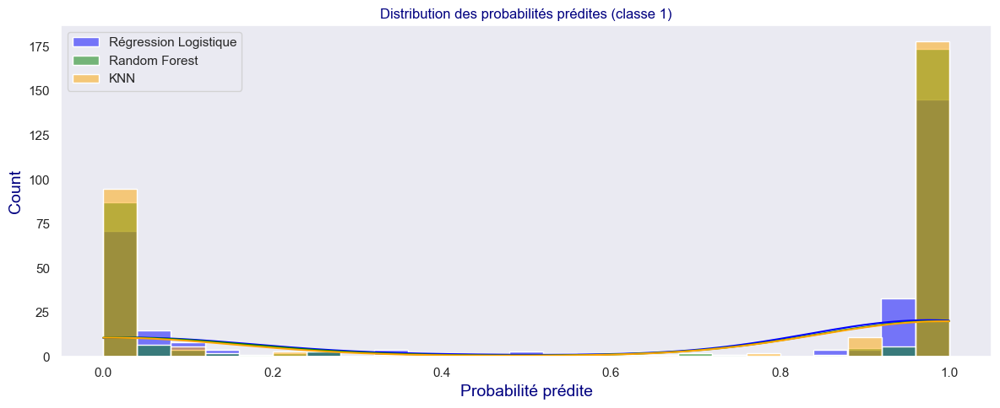

In [963]:
plt.figure(figsize=(12, 5))
sns.histplot(y_test_proba_RL_final, label="Régression Logistique", kde=True, color="blue", bins=25)
sns.histplot(y_test_proba_RF_final, label="Random Forest", kde=True, color="green", bins=25)
sns.histplot(y_test_proba_KNN_final, label="KNN", kde=True, color="orange", bins=25)
plt.title("Distribution des probabilités prédites (classe 1)")
plt.xlabel("Probabilité prédite")
plt.legend()
plt.tight_layout()
plt.show()

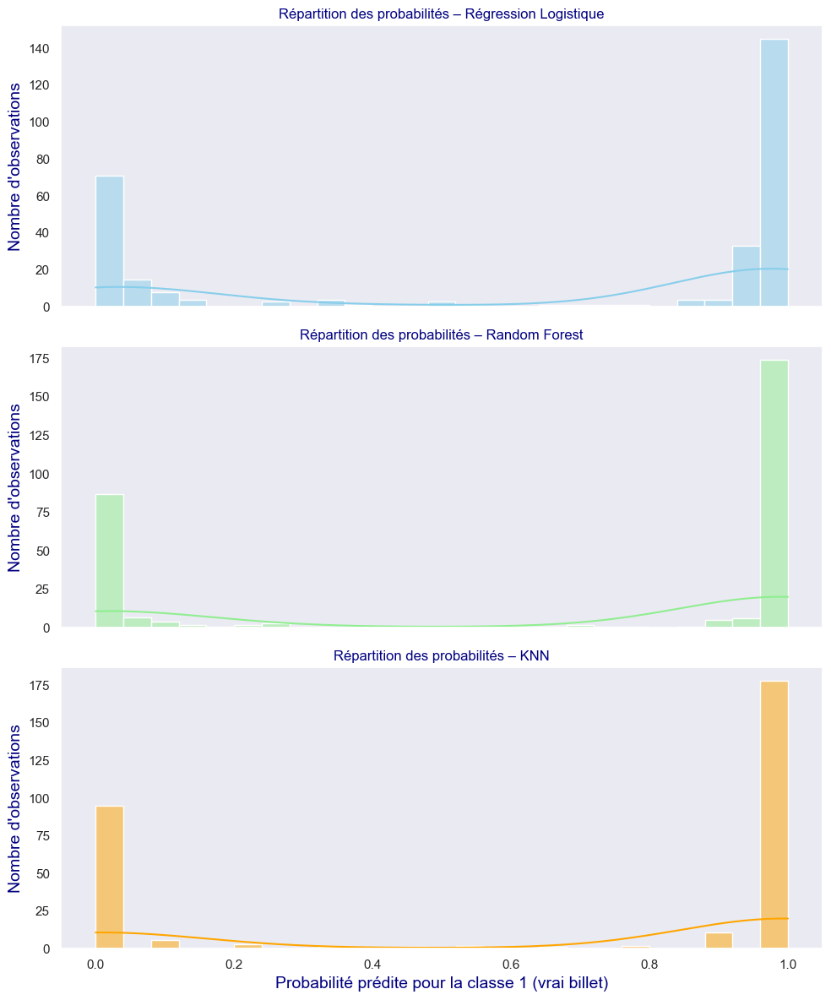

In [964]:
fig, axes = plt.subplots(3, 1, figsize=(10, 12), sharex=True)

sns.histplot(y_test_proba_RL_final, kde=True, color="skyblue", bins=25, ax=axes[0])
axes[0].set_title("Répartition des probabilités – Régression Logistique")
axes[0].set_ylabel("Nombre d'observations")

sns.histplot(y_test_proba_RF_final, kde=True, color="lightgreen", bins=25, ax=axes[1])
axes[1].set_title("Répartition des probabilités – Random Forest")
axes[1].set_ylabel("Nombre d'observations")

sns.histplot(y_test_proba_KNN_final, kde=True, color="orange", bins=25, ax=axes[2])
axes[2].set_title("Répartition des probabilités – KNN")
axes[2].set_xlabel("Probabilité prédite pour la classe 1 (vrai billet)")
axes[2].set_ylabel("Nombre d'observations")

plt.tight_layout()
plt.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 11.2.6 Courbes ROC des trois modèles : </h4>
</div>

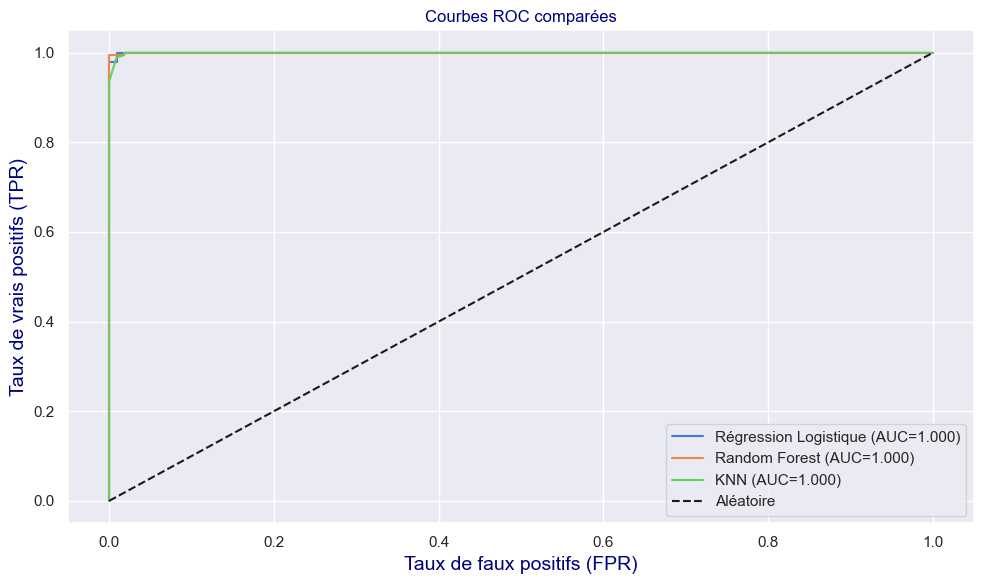

In [965]:
fpr_rl, tpr_rl, _ = roc_curve(y_test, y_test_proba_RL_final)
fpr_rf, tpr_rf, _ = roc_curve(y_test, y_test_proba_RF_final)
fpr_knn, tpr_knn, _ = roc_curve(y_test, y_test_proba_KNN_final)

plt.figure(figsize=(10, 6))
plt.plot(fpr_rl, tpr_rl, label=f"Régression Logistique (AUC={roc_auc_score(y_test, y_test_proba_RL_final):.3f})")
plt.plot(fpr_rf, tpr_rf, label=f"Random Forest (AUC={roc_auc_score(y_test, y_test_proba_RF_final):.3f})")
plt.plot(fpr_knn, tpr_knn, label=f"KNN (AUC={roc_auc_score(y_test, y_test_proba_KNN_final):.3f})")

plt.plot([0, 1], [0, 1], 'k--', label="Aléatoire")
plt.xlabel("Taux de faux positifs (FPR)")
plt.ylabel("Taux de vrais positifs (TPR)")
plt.title("Courbes ROC comparées")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">12.3 -Eleemnts d'Analyse Finale </h3>
</div>

###### Objectif :

Comparer les performances finales des trois modèles entraînés sur les mêmes données scalées :
- Régression Logistique (`clf_RL_final`)
- Random Forest (`clf_RF_final`)
- K-Nearest Neighbors (`clf_KNN_final`)

---

##### 1. Résumé des performances

| Modèle                  | Accuracy | Precision | Recall (TPR) | FPR   | ROC-AUC |
|-------------------------|----------|-----------|--------------|-------|---------|
| Régression Logistique   | 0.990    | 0.984     | 1.000        | 0.027 | 1.000   |
| Random Forest           | 0.993    | 0.990     | 1.000        | 0.018 | 1.000   |
| K-Nearest Neighbors     | 0.987    | 0.979     | 1.000        | 0.036 | 1.000   |

- Tous les modèles atteignent un **Recall de 1.0** : tous les vrais billets sont correctement identifiés.
- Le **Random Forest** obtient les meilleures performances globales, avec le plus faible taux de faux positifs (FPR = 0.018).
- La **Régression Logistique** reste très performante tout en étant plus simple à interpréter.
- Le **KNN** a une précision légèrement inférieure, mais conserve un rappel maximal.

---

##### 2. Analyses visuelles

######   Matrices de confusion
- Confirment un très bon niveau de performance pour tous les modèles.
- Seuls quelques faux positifs subsistent (moins de 4% dans tous les cas).(
######  Répartition des probabilités
- La régression logistique et la forêt aléatoire génèrent des scores de confiance répartis de manière continue.
- Le KNN, basé sur la majorité locale, donne des probabilités plus concentrées et moins granuleuses.

######  Courbes ROC
- Les trois modèles atteignent un AUC de **1.0**, ce qui témoigne de leur excellente capacité discriminante.

######  Radar comparatif
- Visualisation standardisée des scores (entre 0 et 1).
- Le Random Forest domine légèrement sur les métriques combinées.

---

#####  3. Conclusion

- **Tous les modèles** sont très performants et permettent de détecter l’ensemble des vrais billets (rappel = 1.0).
- Le **Random Forest** offre la meilleure combinaison de précision, AUC, et faible taux de faux positifs.
- La **Régression Logistique** reste un bon choix pour un modèle plus explicable.
- Le **KNN** reste pertinent mais légèrement en retrait en termes de précision.

=> Le **choix du modèle final** pourra se faire selon les **contraintes métiers** : besoin de transparence, rapidité de prédiction, ou tolérance au faux positif.



<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 12 - Comparaison des modèles avec modèle non supervisé </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">12.1 -Rappel des données et des modèles optimisés </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 12.1.1 -  Préparation des données : </h4>
</div>

In [966]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

#listes des variables prédictives pour le modèle RL_final : toutes les var quantitatives
var_pred = ['diagonal',
            'height_left', 'height_right', 
            'margin_low','margin_up', 
            'length']
#la variable cible :
var_cible = 'is_genuine'

#le jeu de données prédictif complet:
X = (df_billets_analyse_1_2_copy[var_pred]).copy(deep=True)

#le jeu de données cible réel en convertissant les False en 0 et les True en 1
y = (df_billets_analyse_1_2_copy[var_cible]).copy(deep=True)
y = y.astype(int) #conversion des False / True en 0 /1


# split train, test
# proportion du jeu test : 0.2
#random_state : 42 pour pouvoir reproduire (une fois testé avec différent random_state)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

scaler_final = StandardScaler()

X_train_scaled = scaler_final.fit_transform(X_train)
X_test_scaled = scaler_final.transform(X_test)

**Complement PCA pour le K-means**

In [967]:
nb_components_final = 3

In [968]:
pca_final = PCA(n_components=nb_components_final)
pca_final.fit(X_train_scaled)

,n_components,3
,copy,True
,whiten,False
,svd_solver,'auto'
,tol,0.0
,iterated_power,'auto'
,n_oversamples,10
,power_iteration_normalizer,'auto'
,random_state,None


In [969]:
X_train_proj = pca_final.transform(X_train_scaled)
X_test_proj = pca_final.transform(X_test_scaled)

In [970]:
list_Fi_tot = ['F1', 'F2', 'F3', 'F4', 'F5', 'F6']
list_Fi_final = list_Fi_tot[:nb_components_final]
list_Fi_final

['F1', 'F2', 'F3']

In [971]:
#un DF de X_train_proj les données centrées réduites projetées sur nos axes principaux
df_X_train_proj = pd.DataFrame(X_train_proj) #les données centrées réduites projetées sur nos axes principaux
df_X_train_proj.columns = list_Fi_final
df_X_train_proj.index = X_train.index
#df_X_train_proj.head() #les données centrées réduites projetées

In [972]:
# un DF de X_test_proj les données centrées réduites projetées sur nos axes principaux
df_X_test_proj = pd.DataFrame(X_test_proj) #les données centrées réduites projetées sur nos axes principaux
df_X_test_proj.columns = list_Fi_final
df_X_test_proj.index = X_test.index
#df_X_test_proj.head() #les données centrées réduites projetées

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 12.1.2 -  La Régression Logistique optimisé : </h4>
</div>

In [973]:
from sklearn.linear_model import LogisticRegression

# initialisation et entraînement en une ligne
clf_RL_final = LogisticRegression(C=0.1, max_iter=100, penalty='l2', random_state=42)

#Entrainement
clf_RL_final.fit(X_train_scaled, y_train)

,penalty,'l2'
,dual,False
,tol,0.0001
,C,0.1
,fit_intercept,True
,intercept_scaling,1
,class_weight,None
,random_state,42
,solver,'lbfgs'
,max_iter,100
,multi_class,'deprecated'


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 12.1.3 - Le Random Forest optimisé  : </h4>
</div>

In [974]:
from sklearn.ensemble import RandomForestClassifier

clf_RF_final = RandomForestClassifier(
    n_estimators=500,
    max_depth=10,
    max_features=2,
    min_samples_split=2,
    criterion='entropy',
    random_state=42
)

clf_RF_final.fit(X_train_scaled, y_train)

,n_estimators,500
,criterion,'entropy'
,max_depth,10
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,2
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,bootstrap,True
,oob_score,False


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 12.1.4 - Le KNN optimisé : </h4>
</div>

In [975]:
from sklearn.neighbors import KNeighborsClassifier

clf_KNN_final = KNeighborsClassifier(
    n_neighbors=9,
    weights='uniform',
    metric='minkowski',
    p=1
)

clf_KNN_final.fit(X_train_scaled, y_train)

,n_neighbors,9
,weights,'uniform'
,algorithm,'auto'
,leaf_size,30
,p,1
,metric,'minkowski'
,metric_params,None
,n_jobs,None


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 12.1.5 - modèle issu du K_means : </h4>
</div>

In [976]:
from sklearn.cluster import KMeans

clf_KM_final = KMeans(n_clusters=2,random_state=42)

clf_KM_final.fit(df_X_train_proj  )

# les libellés de clusters des données d'entraînement
train_cluster = clf_KM_final.predict(df_X_train_proj)

# DataFrame regoupant libellés et authenticité
df_cluster_train = pd.DataFrame({'cluster': train_cluster, 'is_genuine': y_train})

#Dictionnaire de correspondance Cluster->Prediction; ex : {0: 0, 1: 1}
cluster_to_class = (
    df_cluster_train.groupby('cluster')['is_genuine']
    .agg(lambda x: x.mode()[0])
    .to_dict()
)

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">12.2 -Analyse et comparaison </h3>
</div>

**Rappel de bibliothèques utiles :**

In [977]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

from sklearn.metrics import (
    confusion_matrix, ConfusionMatrixDisplay,
    precision_score, recall_score, roc_auc_score,
    roc_curve
)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 12.2.1 -  Prédictions & Probabilités : </h4>
</div>

In [978]:
# Prédictions
y_test_pred_RL_final = clf_RL_final.predict(X_test_scaled)
y_test_pred_RF_final = clf_RF_final.predict(X_test_scaled)
y_test_pred_KNN_final = clf_KNN_final.predict(X_test_scaled)

# Probabilités (classe 1)
y_test_proba_RL_final = clf_RL_final.predict_proba(X_test_scaled)[:, 1]
y_test_proba_RF_final = clf_RF_final.predict_proba(X_test_scaled)[:, 1]
y_test_proba_KNN_final = clf_KNN_final.predict_proba(X_test_scaled)[:, 1]

In [979]:
#Pour le K-means :Prédiction

#Prédiction
# Attribution des clusters au jeu de test
test_clusters =clf_KM_final.predict(df_X_test_proj)
#Traduction en Prédiction 0/1 authenticité via le dictionnaire Cluster-Prédiction
y_test_pred_KM_final = np.array([cluster_to_class[c] for c in test_clusters])

In [980]:
#Pour le K-means : Pseudo-proba
from scipy.spatial.distance import cdist

# Distance aux deux centroïdes
distances = cdist(df_X_test_proj, clf_KM_final.cluster_centers_)  # shape: (n_samples, 2)

#Pour avoir le numero de cluster qui représente la classe 1-Vrai Billet :
idx_class_1 = list(cluster_to_class.values()).index(1)
#Pour récupérer la colonne de distance au cluster associé à la calsse 1VraiBillet :
dist_to_class_1 = distances[:, idx_class_1]

# Convertir en score (plus proche = score plus élevé)
y_test_proba_KM_final = 1 / (1 + dist_to_class_1)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 12.2.2 Matrices de confusions  : </h4>
</div>

Attention la matrice de confusion pour scikit-learn est :  
TN | FP  
FN | TP  

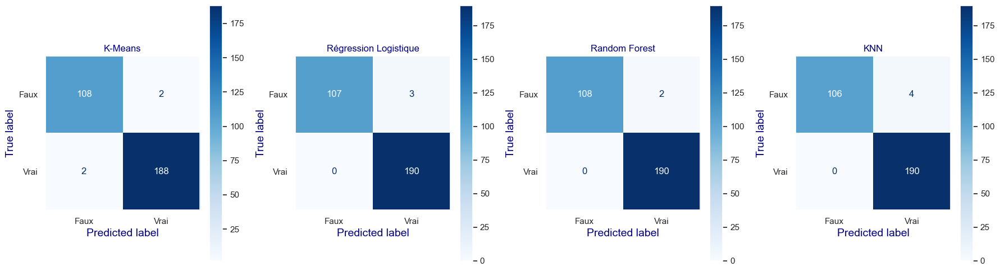

In [981]:
fig, axes = plt.subplots(1, 4, figsize=(18, 5))

models_preds = [
    ("K-Means", y_test_pred_KM_final),
    ("Régression Logistique", y_test_pred_RL_final),
    ("Random Forest", y_test_pred_RF_final),
    ("KNN", y_test_pred_KNN_final)
]

for ax, (title, y_pred) in zip(axes, models_preds):
    ConfusionMatrixDisplay.from_predictions(
        y_test, y_pred,
        display_labels=["Faux", "Vrai"],
        cmap="Blues",
        ax=ax
    )
    ax.set_title(title)

plt.tight_layout()
plt.show()

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 12.2.3 Les Scores  : </h4>
</div>

In [982]:
print("tn, fp, fn, tp")
print( confusion_matrix(y_test, y_test_pred_KM_final).ravel() )
print( confusion_matrix(y_test, y_test_pred_RL_final).ravel() )
print( confusion_matrix(y_test, y_test_pred_RF_final).ravel() )
print( confusion_matrix(y_test, y_test_pred_KNN_final).ravel() )

tn, fp, fn, tp
[108   2   2 188]
[107   3   0 190]
[108   2   0 190]
[106   4   0 190]


In [983]:
def compute_scores(y_true, y_pred, y_proba):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    return {
        "Accuracy": (tp + tn) / (tp + tn + fp + fn),
        "Precision": precision_score(y_true, y_pred),
        "Recall (TPR)": recall_score(y_true, y_pred),
        "FPR": fp / (fp + tn),
        "ROC-AUC": roc_auc_score(y_true, y_proba)
    }

scores_df = pd.DataFrame({
    "K-means": compute_scores(y_test, y_test_pred_KM_final, y_test_proba_KM_final),
    "Régression Logistique": compute_scores(y_test, y_test_pred_RL_final, y_test_proba_RL_final),
    "Random Forest": compute_scores(y_test, y_test_pred_RF_final, y_test_proba_RF_final),
    "KNN": compute_scores(y_test, y_test_pred_KNN_final, y_test_proba_KNN_final)
}).T

display(scores_df.round(3))


,Accuracy,Precision,Recall (TPR),FPR,ROC-AUC
K-means,0.987,0.989,0.989,0.018,0.978
Régression Logistique,0.990,0.984,1.000,0.027,1.000
Random Forest,0.993,0.990,1.000,0.018,1.000
KNN,0.987,0.979,1.000,0.036,1.000


<u>**RAPPEL INTERPRETATION :**</u>  

**ACCURACY**
= (tp + tn) / (tp + tn + fp + fn)  
Proportion d'échantillons bien classés, sur l'ensemble des échantillons.  

**PRECISION**  
=TP/(TP+FP)  
Proportion de Vrais Billets parmis tous les positifs.  
Plus il ya de FP plus la précision baisse.  

**RECALL(TPR)**  
=TP / (TP + FN)  
Proportion de Vrai billets positifs parmis tous les Vrais billets.  
Plus il y a fe FN plus le Recall baisse.
(Taux d'erreur sur les Vrais Billets)  

**FPR**  
=FP /(FP + TN)  
Proportion de Faux Billets non détectés parmis les Faux Billets  
(Taux d'erreur sur les Faux billets)  

**SCORE ROC-AUC :**  
compris entre 0(contre intuitif), 0,5(aléatoire) et 1(bon)  
Combine le TPR et le FPR 
(est-ce qu'il y a une bonne séparation, et que la plupart des seuils permettent un FPR bas et un TPR elevé).

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 12.2.3 - Radar chart des performances : </h4>
</div>

##### **TEST**

- Standardisation min-max par indicateur pour chaque score entre 0 et 1.
- Inversion du score FPR (car plus il est bas, mieux c'est) → on affiche (1 - FPR) dans le radar.
- Affichage plus clair et labels corrigés.

##### **FIN TEST**

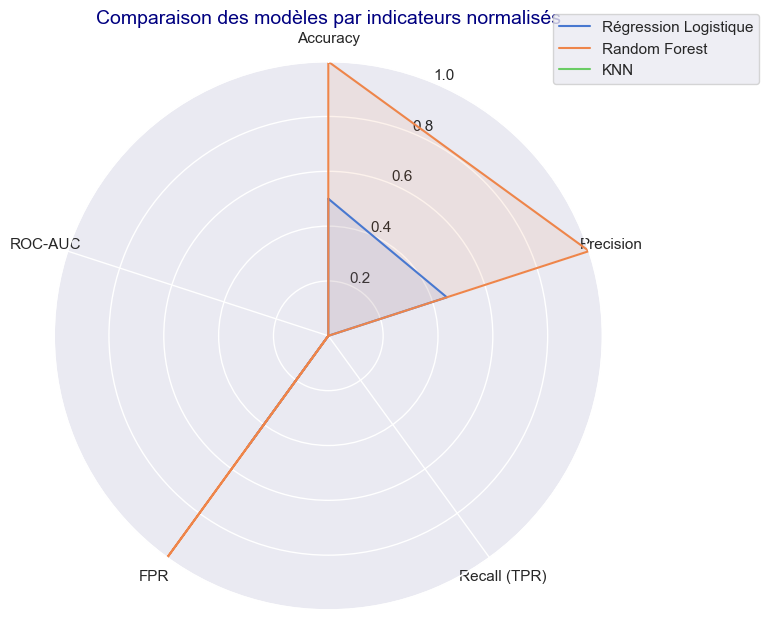

In [984]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

# Données brutes de performance
performance_data = {
    'Régression Logistique': {
        'Accuracy': 0.990,
        'Precision': 0.984,
        'Recall (TPR)': 1.0,
        'FPR': 0.027,
        'ROC-AUC': 1.0
    },
    'Random Forest': {
        'Accuracy': 0.993,
        'Precision': 0.990,
        'Recall (TPR)': 1.0,
        'FPR': 0.018,
        'ROC-AUC': 1.0
    },
    'KNN': {
        'Accuracy': 0.987,
        'Precision': 0.979,
        'Recall (TPR)': 1.0,
        'FPR': 0.036,
        'ROC-AUC': 1.0
    }
}

# Création DataFrame
df_scores = pd.DataFrame(performance_data).T

# Inversion du FPR pour l'interpréter en "meilleur si plus grand"
df_scores['FPR'] = 1 - df_scores['FPR']

# Normalisation des scores pour le radar chart
scaler_MM = MinMaxScaler()
df_scores_normalized = pd.DataFrame(
    scaler_MM.fit_transform(df_scores),
    columns=df_scores.columns,
    index=df_scores.index
)

# Préparation du radar chart
labels = df_scores.columns.tolist()
num_vars = len(labels)

# Calcul des angles
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1]  # Pour fermer le cercle

# Création du radar chart
fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))

for model_name, row in df_scores_normalized.iterrows():
    values = row.tolist()
    values += values[:1]  # Répéter le 1er pour fermer le graphe
    ax.plot(angles, values, label=model_name)
    ax.fill(angles, values, alpha=0.1)

# Paramètres esthétiques
ax.set_theta_offset(np.pi / 2)
ax.set_theta_direction(-1)
ax.set_thetagrids(np.degrees(angles[:-1]), labels)

# Limites
ax.set_ylim(0, 1)

# Titre & légende
plt.title("Comparaison des modèles par indicateurs normalisés", size=14)
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 12.2.5 Répartition des probabilités : </h4>
</div>

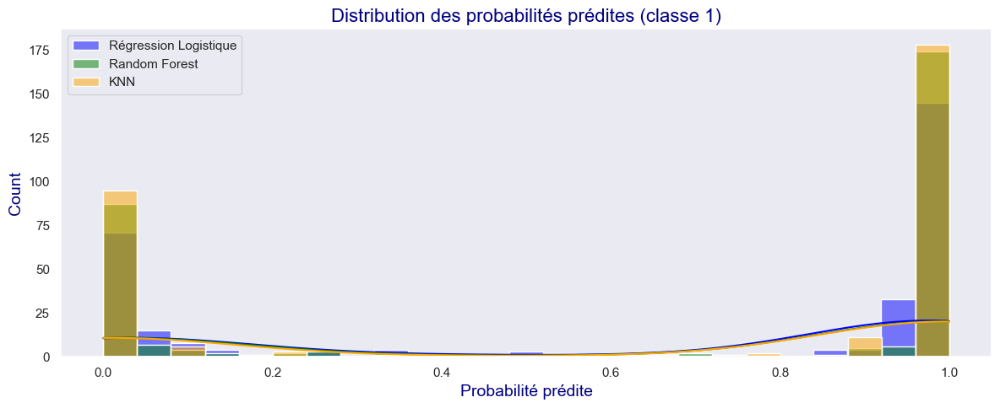

In [985]:
plt.figure(figsize=(12, 5))
sns.histplot(y_test_proba_RL_final, label="Régression Logistique", kde=True, color="blue", bins=25)
sns.histplot(y_test_proba_RF_final, label="Random Forest", kde=True, color="green", bins=25)
sns.histplot(y_test_proba_KNN_final, label="KNN", kde=True, color="orange", bins=25)
plt.title("Distribution des probabilités prédites (classe 1)",size=16)
plt.xlabel("Probabilité prédite")
plt.legend()
plt.tight_layout()
plt.show()

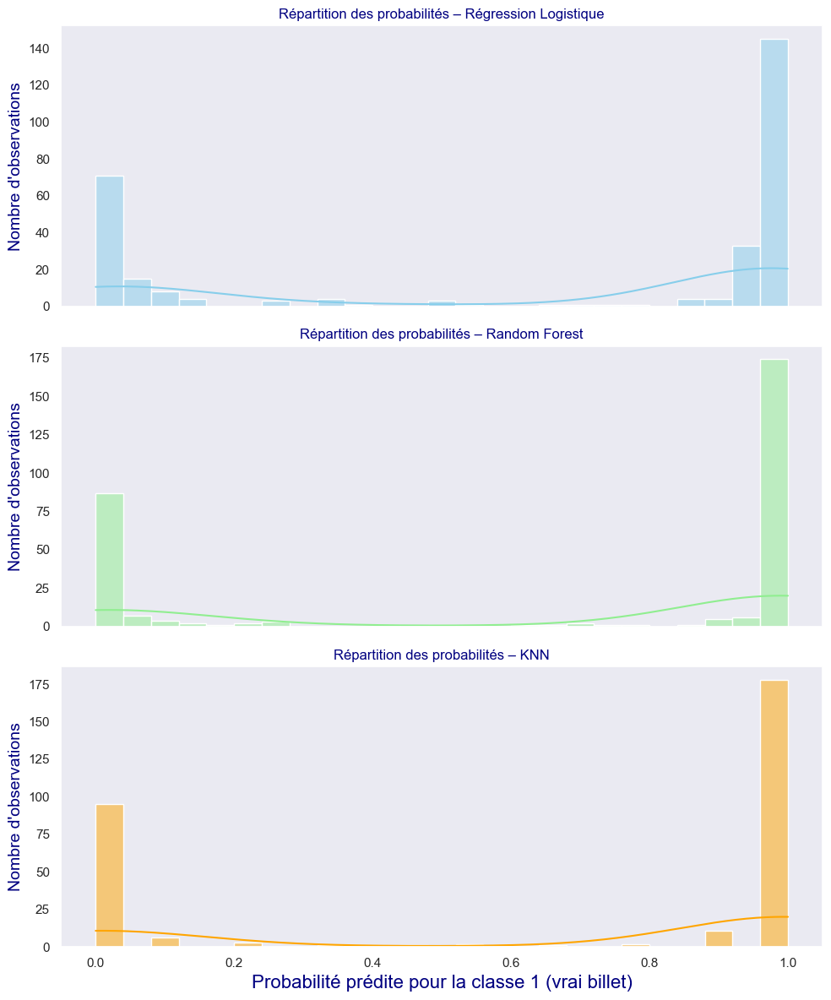

In [986]:
fig, axes = plt.subplots(3, 1, figsize=(10, 12), sharex=True)

sns.histplot(y_test_proba_RL_final, kde=True, color="skyblue", bins=25, ax=axes[0])
axes[0].set_title("Répartition des probabilités – Régression Logistique")
axes[0].set_ylabel("Nombre d'observations")

sns.histplot(y_test_proba_RF_final, kde=True, color="lightgreen", bins=25, ax=axes[1])
axes[1].set_title("Répartition des probabilités – Random Forest")
axes[1].set_ylabel("Nombre d'observations")

sns.histplot(y_test_proba_KNN_final, kde=True, color="orange", bins=25, ax=axes[2])
axes[2].set_title("Répartition des probabilités – KNN")
axes[2].set_xlabel("Probabilité prédite pour la classe 1 (vrai billet)",size=16)
axes[2].set_ylabel("Nombre d'observations")

plt.tight_layout()
plt.show()


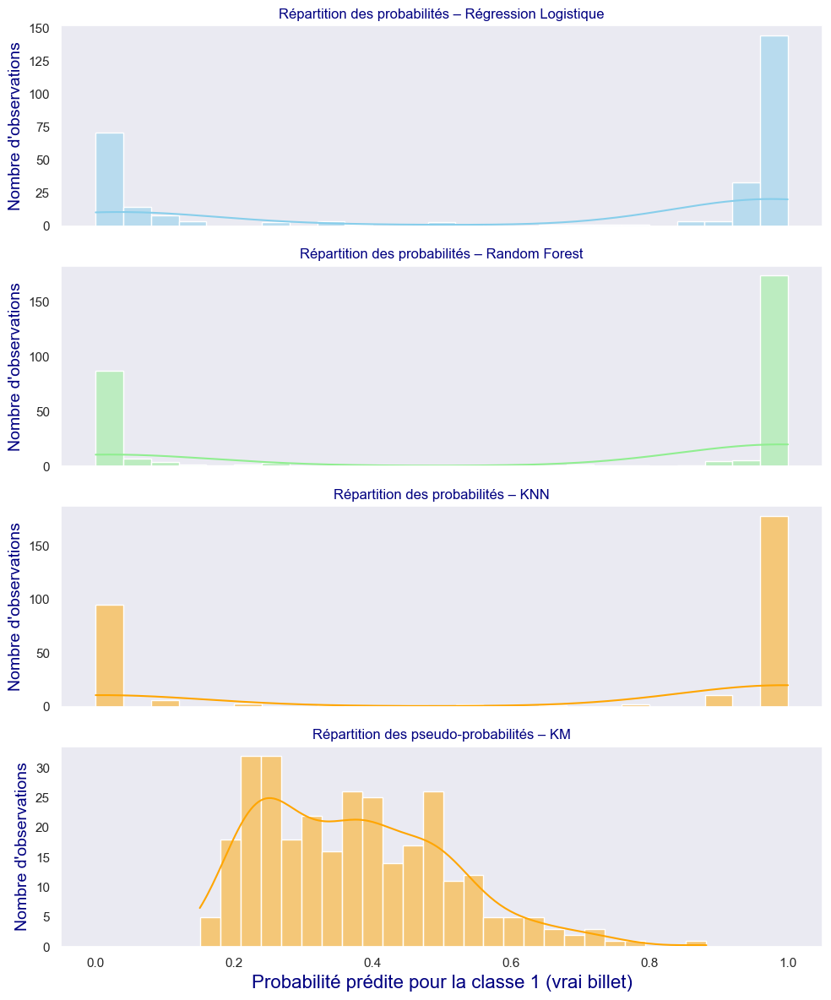

In [987]:
fig, axes = plt.subplots(4, 1, figsize=(10, 12), sharex=True)

sns.histplot(y_test_proba_RL_final, kde=True, color="skyblue", bins=25, ax=axes[0])
axes[0].set_title("Répartition des probabilités – Régression Logistique")
axes[0].set_ylabel("Nombre d'observations")

sns.histplot(y_test_proba_RF_final, kde=True, color="lightgreen", bins=25, ax=axes[1])
axes[1].set_title("Répartition des probabilités – Random Forest")
axes[1].set_ylabel("Nombre d'observations")

sns.histplot(y_test_proba_KNN_final, kde=True, color="orange", bins=25, ax=axes[2])
axes[2].set_title("Répartition des probabilités – KNN")
axes[2].set_xlabel("Probabilité prédite pour la classe 1 (vrai billet)")
axes[2].set_ylabel("Nombre d'observations")

sns.histplot(y_test_proba_KM_final, kde=True, color="orange", bins=25, ax=axes[3])
axes[3].set_title("Répartition des pseudo-probabilités – KM")
axes[3].set_xlabel("Probabilité prédite pour la classe 1 (vrai billet)",size=16)
axes[3].set_ylabel("Nombre d'observations")

plt.tight_layout()
plt.show()


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 12.2.6 Courbes ROC des trois modèles : </h4>
</div>

In [988]:
print("fpr, tpr ")
print( roc_curve(y_test, y_test_proba_KM_final) )
print( roc_curve(y_test, y_test_proba_RL_final) )
print( roc_curve(y_test, y_test_proba_RF_final) )
print( roc_curve(y_test, y_test_proba_KNN_final) )

fpr, tpr 
(array([0.        , 0.        , 0.        , 0.00909091, 0.00909091,
       0.01818182, 0.01818182, 0.02727273, 0.02727273, 0.03636364,
       0.03636364, 0.05454545, 0.05454545, 0.06363636, 0.06363636,
       0.07272727, 0.07272727, 0.09090909, 0.09090909, 0.14545455,
       0.14545455, 0.15454545, 0.15454545, 0.17272727, 0.17272727,
       0.22727273, 0.22727273, 0.23636364, 0.23636364, 0.51818182,
       0.51818182, 1.        ]), array([0.        , 0.00526316, 0.7       , 0.7       , 0.75263158,
       0.75263158, 0.76842105, 0.76842105, 0.81578947, 0.81578947,
       0.83684211, 0.83684211, 0.87894737, 0.87894737, 0.92105263,
       0.92105263, 0.92631579, 0.92631579, 0.95263158, 0.95263158,
       0.95789474, 0.95789474, 0.96315789, 0.96315789, 0.96842105,
       0.96842105, 0.97894737, 0.97894737, 0.99473684, 0.99473684,
       1.        , 1.        ]), array([       inf, 0.88218543, 0.38266423, 0.38210044, 0.37583676,
       0.37208354, 0.36626949, 0.36606106, 0.3543351

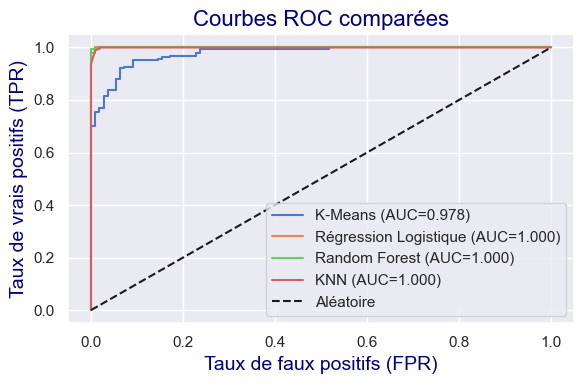

In [989]:
fpr_km, tpr_km, _ = roc_curve(y_test, y_test_proba_KM_final)
fpr_rl, tpr_rl, _ = roc_curve(y_test, y_test_proba_RL_final)
fpr_rf, tpr_rf, _ = roc_curve(y_test, y_test_proba_RF_final)
fpr_knn, tpr_knn, _ = roc_curve(y_test, y_test_proba_KNN_final)

plt.figure(figsize=(6, 4))
plt.plot(fpr_km, tpr_km, label=f"K-Means (AUC={roc_auc_score(y_test, y_test_proba_KM_final):.3f})")
plt.plot(fpr_rl, tpr_rl, label=f"Régression Logistique (AUC={roc_auc_score(y_test, y_test_proba_RL_final):.3f})")
plt.plot(fpr_rf, tpr_rf, label=f"Random Forest (AUC={roc_auc_score(y_test, y_test_proba_RF_final):.3f})")
plt.plot(fpr_knn, tpr_knn, label=f"KNN (AUC={roc_auc_score(y_test, y_test_proba_KNN_final):.3f})")

plt.plot([0, 1], [0, 1], 'k--', label="Aléatoire")
plt.xlabel("Taux de faux positifs (FPR)")
plt.ylabel("Taux de vrais positifs (TPR)")
plt.title("Courbes ROC comparées",size=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">12.3 -Elements d'Analyse Final </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 12.3.1 - Justification de l'utilisation de l'ACP uniquement pour le K-means</h4>
</div>

#####  Justification de l'utilisation de l'ACP uniquement pour le K-means

L’Analyse en Composantes Principales (ACP) a été appliquée **uniquement** dans le cadre du modèle **K-means**, et cela pour des raisons méthodologiques liées à la nature non supervisée et géométrique de cet algorithme.

---

######  Pourquoi une ACP pour le K-means ?
- Le K-means repose sur une logique de **proximité géométrique** (distance euclidienne entre points et centroïdes).
- Il est donc **très sensible** :
  - à la **corrélation** entre variables (les dimensions doivent être indépendantes),
  - à la **redondance d’information**,
  - et à la **malédiction de la dimension** (effet négatif d’un grand nombre de variables).

<u>=>L’ACP permet alors :</u>
- de **décorréler les variables**,
- de **réduire la dimensionnalité** en conservant l'essentiel de la variance,
- et de **renforcer la robustesse** du clustering.

---

###### Pourquoi ne pas appliquer l’ACP aux autres modèles ?
- Les **modèles supervisés** (Régression Logistique, Random Forest, KNN) sont **moins sensibles** à la corrélation :
  - La **Random Forest** est insensible car elle effectue des découpages binaires par variable.
  - La **Régression Logistique** peut gérer la corrélation, tant que celle-ci ne conduit pas à une colinéarité excessive.
  - Le **KNN** est parfois sensible aux échelles et aux distances, mais bénéficie déjà de la standardisation, ce qui limite les risques.

=>Une ACP **n’est donc pas nécessaire** dans ces cas-là, et pourrait même faire perdre une partie de l’interprétabilité ou de l’efficacité des modèles.

---

###### En résumé

Chaque modèle a été intégré dans un pipeline de traitement **adapté à ses spécificités** :

| Modèle                | Standardisation | ACP         | Justification                          |
|------------------------|------------------|-------------|----------------------------------------|
| K-means                | ✅ Oui            | ✅ Oui       | Algorithme géométrique très sensible   |
| Régression Logistique  | ✅ Oui            | ❌ Non       | Modèle linéaire tolérant               |
| Random Forest          | ✅ Oui            | ❌ Non       | Arbres indépendants des distances      |
| KNN                    | ✅ Oui            | ❌ Non       | Standardisation suffisante             |

L’ACP est ainsi un **choix méthodologique pertinent** pour améliorer la performance du K-means, sans nuire à l’équité de la comparaison globale entre modèles.

Par ailleurs le K-means ne pouvait pas posséder d'amélioration de type GridSearchCV contrairement aux auters modèles

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 12.3.2 - Elements d'analyse</h4>
</div>

###### Objectif :

Comparer les performances finales des **quatre modèles** entraînés et testés sur les mêmes données scalées :

- Régression Logistique (`clf_RL_final`)
- Random Forest (`clf_RF_final`)
- K-Nearest Neighbors (`clf_KNN_final`)
- K(`clf_KM_final`)-means (modèle non supervisé à 2 clusters, transformé pour prédiction)

--
##### 📊 1. Résumé des performances

| Modèle                  | Accuracy | Precision | Recall (TPR) | FPR   | ROC-AUC |
|-------------------------|----------|-----------|--------------|-------|---------|
| K-means                 | 0.987    | 0.989     | 0.989        | 0.018 | 0.978   |
| Régression Logistique   | 0.990    | 0.984     | 1.000        | 0.027 | 1.000   |
| Random Forest           | 0.993    | 0.990     | 1.000        | 0.018 | 1.000   |
| K-Nearest Neighbors     | 0.987    | 0.979     | 1.000        | 0.036 | 1.000   |

- Le **K-means**, bien que non supervisé, obtient des performances solides, proches des modèles supervisés.
- Le **Random Forest** conserve sa position de leader en combinant **précision, recall parfait** et **faible FPR**.
- La **Régression Logistique** atteint également un **recall et un AUC parfaits**, avec une **légère baisse de précision**.
- Le **KNN** est en léger retrait en précision et en FPR, mais conserve un **recall fait**.

---

##### 🧮 2. Anase des résultats

###### ✅ Matrices de confusion :
- Tous les modèles supervisés identifient parfaitement les vrais billets (`Recall = 1.0`).
- Le **Random Forest** minimise le nombre de faux positifs (seulement 2).
- Le **K-means**, bien qu'entraîné sans étiquette, classe très efficacement les billets, avec 2 faux négat et 2 faux positifs.

###### 📈 Courbes ROC :
- Les trois modèles supervisés affichent une **AUC = 1.0**, illustrant une séparation parfaite entre les classes.
- Le **K-means** obtient une AUC de **0.978**, ce qui reste remarquable pour modèle non supervisé.

---

##### 🧠 3. Conclusion

- Les **modèles supervisés** (Régression Logistique, Random Forest, KNN) offrent une détection quasi parfaite des billets authentiques et contrefaits.
- Le **Random Forest** reste le modèle le plus robuste et équilibré, avec la meilleure précision et le FPR le plus faible.
- La **Régression Logistique** reste un excellent compromis pour les contextes nécessitant **transparence et interprétabilité**.
- Le **KNN** montre de très bonnes performances mais est plus sensible aux faux positifs.
- Le **K-means**, bien qu’en retrait, démontre qu’une structure naturelle **non supervisée** permet déjà de bien séparer les billets. Il reste un bon outil en phase exploratoirou en absence de données étiquetées.

---

🎯 **Choix du modèle final :**  
Le **Random Forest** est retenu pour la mise en production, en raison de ses performances optimales, tout en maintenant une bonne stabilité et faible sensibilité aux erreurs.


**Remarque :**  
Si on priorise la réduction des faux positifs (i.e., éviter d'accepter des faux billets )  

- On veutveux minimiser les faux positifs (FP) = réduire le FPR (False Positive Rate),
car chaque faux positif = un faux billet qui passe entre les mailles du filet.  

- Le rappel (Recall / TPR) est aussi important, mais moins critique que le FPR dans ce contexte.

**OBSERVATIONS :**  
Dans notre cas d’usage, le faux positif représente l’erreur la plus risquée, car il correspond à un faux billet accepté comme authentique.  

Ainsi, notre objectif principal est de minimiser le taux de faux positifs (FPR), tout en maintenant un bon niveau de détection globale (Recall / TPR).  

Le Random Forest se distingue comme le meilleur compromis, avec :  
- Un FPR très faible (1,8%)  
- Un Recall de 100% (aucun vrai billet refusé)  
- Une précision et un score AUC excellents.
  
=> Il est donc le modèle recommandé dans une logique de contrôle qualité, pour minimiser le risque d’acceptation de faux billets.

##### Objectif métier  
Comparer les performances des **quatre modèles** entraînés sur les mêmes données scalées :

- Régression Logistique (`clf_RL_final`)
- Random Forest (`clf_RF_final`)
- K-Nearest Neighbors (`clf_KNN_final`)
- K-means (`clf_KM_final` basé sur la distance au centroïde)

Contexte métier :
> Dans notre cas, l'erreur la plus critique est le **faux positif** :  
> un **faux billet** classé **à tort comme authentique**.  
> Cela revient à **accepter un billet frauduleux**.  
>  
> L’indicateur prioritaire devient donc le **FPR (False Positive Rate)**.

---

##### 1. Résumé des performances

| Modèle                  | Accuracy | Precision | Recall (TPR) | **FPR (Faux billets non détectés)** | ROC-AUC |
|-------------------------|----------|-----------|--------------|-------------------------------------|---------|
| **K-means**             | 0.987    | 0.989     | 0.989        | **0.018**                         | 0.978   |
| **Régression Logistique** | 0.990    | 0.984     | 1.000        | **0.027**                         | 1.000   |
| **Random Forest**       | 0.993    | 0.990     | 1.000        | **0.018**                         | 1.000   |
| **K-Nearest Neighbors** | 0.987    | 0.979     | 1.000        | *0.036**                         | 1.000   |

---

##### 2. Analyse ciblée

- Tous les modèles atteignent un **Recall de 1.0**, sauf le **K-means** (0.989).
- Le **FPR (faux billets mal détectés)** est la métrique métier clé :
  - **Random Forest** et **K-means** ont le **FPR le plus faible** (1.8%).
  - La **Régression Logistique** reste très bonne (2.7%).
  - Le **KNN** est plus à risque : 3.6% de faux billets acceptés.

---

##### 3. Interprétation des courbes ROC

- Tous les modèles supervisés (RL, RF, KNN) ont un **AUC parfait de 1.0**.
- Le **K-means** reste très compétitif pour un modèle non supervisé avec **AUC = 0.978**.

---

##### 4. Conclusion métier

- Le **Random Forest** est le modèle **le plus fiable** :
  - Très faible FPR (1.8%)
  - Aucun rejet de vrai billet (Recall = 1.0)
  - AUC parfait (1.0)
- Le **K-means** offre une alternative simple et robuste, même sans supervision.
- La **Régression Logistique** est explicable mais légèrement plus risquée en FPR.
- Le **KNN** reste performant, mais son FPR le rend moins adapté ici.

> **Choix recommandé :** Random Forest si priorité à la sécurité et performance.  
> K-means possible en back-up ou en screening non supervisé.

| Modèle                    | Accuracy | Recall (TPR) | ❗FPR         | ROC-AUC |
| ------------------------- | -------- | ------------ | ------------ | ------- |
| **Random Forest**         | ✅ 0.993  | ✅ 1.00       | 🟢 **0.018** | ⭐ 1.000 |
| **Régression Logistique** | 0.990    | ✅ 1.00       | 🔴 0.027     | ⭐ 1.000 |
| **KNN**                   | 0.987    | ✅ 1.00       | 🔴 0.036     | ⭐ 1.000 |
| **K-means** (non sup.)    | 0.987    | 0.989        | 🟢 **0.018** | 0.978   |


**Recommandation :**  
- Random Forest = Meilleur compromis performance / sécurité  
- K-means = Bon backup non supervisé  
- Régression Logistique = plus explicable  
- KNN = performant, mais plus risqué (FPR ↑)

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 13. - Export des modeles </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">13.1 - Export du Standard Scaler et du modèle supervisé </h3>
</div>

In [990]:
import joblib

In [991]:
# Export du scaler_final entrainé sur X_train
joblib.dump(scaler_final, r"D:\BDD\OCR\P12\P12_Sorties\standard_scaler_prefit_X_train.pkl")

['D:\\BDD\\OCR\\P12\\P12_Sorties\\standard_scaler_prefit_X_train.pkl']

In [992]:
# Export du modèle clf_RL_final dans un fichier .pkl : La meilleure Regression Logisitque
joblib.dump(clf_RL_final, r"D:\BDD\OCR\P12\P12_Sorties\regression_Logistique_model.pkl")

['D:\\BDD\\OCR\\P12\\P12_Sorties\\regression_Logistique_model.pkl']

In [993]:
# Export du modèle clf_RF_final dans un fichier .pkl : Le meilleur Random Forest
joblib.dump(clf_RF_final, r"D:\BDD\OCR\P12\P12_Sorties\random_forest_model.pkl")

['D:\\BDD\\OCR\\P12\\P12_Sorties\\random_forest_model.pkl']

In [994]:
# Export du modèle clf_KNN_final dans un fichier .pkl : Le meilleur KNN
joblib.dump(clf_KNN_final, r"D:\BDD\OCR\P12\P12_Sorties\k_nearest_neighbours_model.pkl")

['D:\\BDD\\OCR\\P12\\P12_Sorties\\k_nearest_neighbours_model.pkl']

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">13.2 - Annexe : Construction pour export du K-means en Pipeline </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 13.2.1 - Création d'une classe personnalisée pour inclure le mapping Cluster-Prédiction (cluster_to_class)</h4>
</div>

Comme le KMeans n'est pas un classificateur supervisé, il ne gère pas nativement la prédiction de labels 0/1. On va encapsuler le K-means + le mapping dans un objet personnalisable.

In [995]:
from sklearn.base import BaseEstimator, ClassifierMixin

class KMeansClassifier(BaseEstimator, ClassifierMixin):
    def __init__(self, n_clusters=2, random_state=42):
        self.n_clusters = n_clusters
        self.random_state = random_state
        self.kmeans = KMeans(n_clusters=n_clusters, random_state=random_state)
        self.cluster_to_class = {}

    def fit(self, X, y=None):
        self.kmeans.fit(X)
        if y is not None:
            cluster_labels = self.kmeans.predict(X)
            # mapping des clusters à la classe majoritaire
            self.cluster_to_class = (
                pd.DataFrame({'cluster': cluster_labels, 'is_genuine': y})
                .groupby('cluster')['is_genuine']
                .agg(lambda x: x.mode()[0])
                .to_dict()
            )
        return self

    def predict(self, X):
        clusters = self.kmeans.predict(X)
        return np.array([self.cluster_to_class[c] for c in clusters])

    def predict_proba(self, X):
        from scipy.spatial.distance import cdist
        distances = cdist(X, self.kmeans.cluster_centers_)
        # suppose que cluster_to_class a une classe 1
        idx_class_1 = list(self.cluster_to_class.values()).index(1)
        dist_to_class_1 = distances[:, idx_class_1]
        proba_class_1 = 1 / (1 + dist_to_class_1)
        return np.vstack([1 - proba_class_1, proba_class_1]).T


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 13.2.2 - Construction du Pipeline complet</h4>
</div>

In [996]:
from sklearn.pipeline import Pipeline

pipeline_KM_final = Pipeline(steps=[
    ('scaler', StandardScaler()),
    ('pca', PCA(n_components=3)),
    ('kmeans_classifier', KMeansClassifier(n_clusters=2, random_state=42))
])

#fit du Pipeline
pipeline_KM_final.fit(X_train, y_train)  # X_train brut, y_train en 0/1


,steps,"[('scaler', ...), ('pca', ...), ...]"
,transform_input,None
,memory,None
,verbose,False
,copy,True
,with_mean,True
,with_std,True
,n_components,3
,copy,True
,whiten,False
,svd_solver,'auto'


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 13.2.3 - Export du Pipeline au format .pkl</h4>
</div>

In [997]:
joblib.dump(pipeline_KM_final, r"D:\BDD\OCR\P12\P12_Sorties\pipeline_kmeans_model.pkl")

['D:\\BDD\\OCR\\P12\\P12_Sorties\\pipeline_kmeans_model.pkl']

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 13.2.4 - Exemple d’utilisation dans une application (à l’import)</h4>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">13.3 - Annexe : Export des modèles supervisés en Pipeline complet</h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 13.3.1 - Construction des Pipelines </h4>
</div>

**Pipeline pour la Régression Logistique**

In [998]:
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler

pipeline_RL_final = Pipeline(steps=[
    ('scaler', StandardScaler()),
    ('log_reg', LogisticRegression(C=0.1, max_iter=100, penalty='l2', random_state=42))
])

#fit du Pipeline
pipeline_RL_final.fit(X_train, y_train)


,steps,"[('scaler', ...), ('log_reg', ...)]"
,transform_input,None
,memory,None
,verbose,False
,copy,True
,with_mean,True
,with_std,True
,penalty,'l2'
,dual,False
,tol,0.0001
,C,0.1


**Pipeline pour le Random Forest**

In [999]:
from sklearn.ensemble import RandomForestClassifier

pipeline_RF_final = Pipeline(steps=[
    ('scaler', StandardScaler()),
    ('random_forest', RandomForestClassifier(
        n_estimators=500,
        max_depth=10,
        max_features=2,
        min_samples_split=2,
        criterion='entropy',
        random_state=42
    ))
])

pipeline_RF_final.fit(X_train, y_train)


,steps,"[('scaler', ...), ('random_forest', ...)]"
,transform_input,None
,memory,None
,verbose,False
,copy,True
,with_mean,True
,with_std,True
,n_estimators,500
,criterion,'entropy'
,max_depth,10
,min_samples_split,2


**Pipeline pour le KNN**

In [1000]:
from sklearn.neighbors import KNeighborsClassifier

pipeline_KNN_final = Pipeline(steps=[
    ('scaler', StandardScaler()),
    ('knn', KNeighborsClassifier(
        n_neighbors=9,
        weights='uniform',
        metric='minkowski',
        p=1
    ))
])

pipeline_KNN_final.fit(X_train, y_train)


,steps,"[('scaler', ...), ('knn', ...)]"
,transform_input,None
,memory,None
,verbose,False
,copy,True
,with_mean,True
,with_std,True
,n_neighbors,9
,weights,'uniform'
,algorithm,'auto'
,leaf_size,30


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 13.3.3 - Export des Pipelines au format .pkl</h4>
</div>

In [1001]:
joblib.dump(pipeline_RL_final, r"D:\BDD\OCR\P12\P12_Sorties\pipeline_logistic_regression.pkl")
joblib.dump(pipeline_RF_final, r"D:\BDD\OCR\P12\P12_Sorties\pipeline_random_forest.pkl")
joblib.dump(pipeline_KNN_final, r"D:\BDD\OCR\P12\P12_Sorties\pipeline_knn.pkl")


['D:\\BDD\\OCR\\P12\\P12_Sorties\\pipeline_knn.pkl']

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> 13.3.4 - Exemple d’utilisation en production</h4>
</div>

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape E -  </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">E.1 -  </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> E.1.1 - </h4>
</div>

# <font color='red'>REPERE</font>

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; "> Etape Y - COMPLEMENTS </h2>
</div>

In [1002]:
#EXPORT UTILE :
#EXPORT de ---df_A_extraire---

#df_A_extraire = 
#df_A_extraire.to_csv("Nom_Fichier_Sortie.csv",index=False)
#df_A_extraire.to_excel("Nom_Fichier_Sortie.xlsx",index=False)

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Y.2 - NETTOYAGE PYTHON:</h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> Y.2.1 - REMETTRE EN PLACE LES WARNINGS, SI WARNINGS DESACTIVE:</h4>
</div>

In [1003]:
#Restore the warning behaviour to default : Show all warnings (even those ignored by default)
#warnings.filterwarnings('ignore')

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> Y.2.2 - RAMASSE MIETTE PYTHON :</h4>
</div>

In [1004]:
#NETTOYAGE DE MEMOIRE

gc.collect()  # force le nettoyage de la mémoire

70309

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; "> Etape Z - COMPLEMENTS PERSOS </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Z.1 - RECHERCHES PYTHON </h3>
</div>

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> Z.2.1 - COPY </h4>
</div>

**ATTENTION AUX SHALLOW COPY et DEEP COPY :  
Une shallow copy crée un nouvel objet mais qui poionte vers les même données que le premier=> une modification sur l'une modifie l'autre.
Il faut faire un DEEP COPY si on veut que les données soient indépendantes également**  

source : https://medium.com/@mathieuvdp/attention-au-deep-copy-de-pandas-8ebbdd5b0b92  

Bien_2 = Bien_1.copy(deep=False) =>shallow copy  
Bien_2 = Bien_1.copy(deep=True) => deep_copy

**Faire attention aux copy(deep=True)**  
**NE PAS EN ABUSER**, surtout sur des fichiers lourds.  
Au pire daire des copy(deep=True) dans le travail d'exploration.  
Puis les remplacer par des cop(deep=False), une fois que le travail est validé.  
Ou travailler sur le fichier en cours de modif quitte à relancer le Kernel si erreur.

<u>Remarque : Source utile pours la réalisation des tests statistique :</u>  
 le tableau récapitulatif d’XLSTA :  
https://help.xlstat.com/fr/6443-which-statistical-test-should-you-use 


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> Z.2.2 SUPPRESSION DE LIGNES VIDES / source Nettoyage CNAM : </h4>
</div>

<u>**SUPPRESSION DE LIGNES VIDES / source Nettoyage CNAM :**</u>  

https://jhub.cnam.fr/doc/notebooks/Nettoyage_de_donnees_Python_Pandas.html  

Dans un premier temps, il peut être souhaitable de filtrer/retirer les valeurs manquantes dans le dataframe.  

Pour cela on utilise la fonction dropna().  
Cette fonction possède plusieurs arguments, permettant de moduler le niveau de filtrage des valeurs manquantes :  

axis= (0 ou 1) : filtrage des valeurs manquantes selon les lignes (axis = 0) ou les colonnes (axis=1). Valeur par défaut : axis=0.
how=all : argument permettant de ne retirer que les lignes (pour axis=0) ou toutes les colonnes (pour axis=1) du dataframe pour lequelles toutes les valeurs sont manquantes.  

Attention : si cet argument n'est pas spécifié, chaque ligne (resp. chaque colonne) contenant au moins une donnée manquante sera supprimée !  

inplace=True : applique directement la modification dans le dataframe (sans créer un autre dataframe).  
thresh= (nombre entier n) : permet de ne conserver que les lignes (resp. les colonnes) contenant au moins n valeurs non manquantes.


<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> Z.2.3 Reordonner des colonnes : </h4>
</div>

**CNAM (même source que pour les lignes vides) :**  


pour REORDONNER DES COLONNES, on peut utiliser df_exemple.reindex :  

ordre_colonnes = ["country", "year", "sex", "age", "cases"]  
tub = tub.reindex(columns=ordre_colonnes    


Après Lecture de la documentation, et essais,  
Cela n'a pas l'air d'être mieux que mon classique :
tub = tub[['D','B','C','A']]  
(ou A, B C D sont les colonnes d'origines).  

En effet il semble que reindex fait également un nouvel objet.)

<div style="border: 1px solid RGB(88, 132, 241);" >
<h4 style="margin: auto; padding: 20px; color: RGB(88, 132, 241); "> Z.2.6 Division par zéro :</h4>
</div>

**Lors d'une division avec pandas (/),**  
aucun bug ne sera levé automatiquement si le dénominateur contient des zéros.  
Pandas renverra :  
. `NaN` si l’un des deux opérandes est `NaN`  
. `inf` ou `-inf` si le numérateur est non nul et le dénominateur est zéro  
. `NaN` si le numérateur et le dénominateur sont tous les deux zéro  
  
**Il n'y aura pas d’erreur Python levée,  
mais il pourrait y avoir des valeurs inf ou -inf,  
ce qui peut poser problème plus tard (dans des calculs ou exports).**

##### Option 1 : Remplacer les zéros par NaN avant la division

##### Option 2 : Utiliser np.where pour contrôler explicitement le résultat

##### Vérification après calcul :

##### **Résumé :**
- Pas de crash avec / dans pandas, mais attention aux inf
- Préférer replace(0, np.nan) ou np.where(...)
- Nettoyer ensuite les valeurs infinies si besoin

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Z.3 - DOCUMENTATIONS DU THEME</h3>
</div>